# Conference on the Future of Europe Dataset
## Hierarchical clustering and polarisation evaluation in bimodal networks
### Use case 2: Application
#### Adrián Fernández Cid


In this notebook I present an analysis of data from the Conference on the Future of Europe [1] following the proposal of my master thesis. Such an analysis draws on the methods illustrated in **SouthernWomen.ipynb**, applied here to current and (to the best of my knowledge) yet unstudied data.

The Conference on the Future of Europe is a project of the European Union lead by the European Parliament, the Council and the European Commission to engage European citizens and more widely the European civil society in democratic deliberation on EU policies through the making and evaluation of concrete proposals and the organisation of and participation in events. By the end of the Conference (expected in the spring of 2022) the organisers commit to capture the proposals and discussions of the whole process into concrete policy recommendations.

Parcipants may be European citizens; European, national, regional or local authorities; or civil society organisations. They can engage through the multilingual platform of the Conference (featuring the 24 official languages of the EU), which is an instance of the *Decidim* application for mass deliberation [3]. It allows users to propose and vote "ideas" (that one can follow or endorse), organise and attend events ("meetings"), or leave comments on any of the two, among other things.

The digital platform was launched in mid-April 2021 and is foreseen to remain accessible until spring 2022, when the Conference is expected to reach conclusions [2]. At the time the data was collected for this project, the 20th October 2021 at 03∶16∶54 (GMT+1), there were a total of about 9 000 proposals, 10 000 endorsers (users that gave their support to at least one proposal) and 45 000 proposal endorsements. The data, which include information on proposals, meetings and their respective comments, present the opportunity to reproduce the polarisation analysis performed in **SouthernWomen.ipynb** on a current process of mass deliberation: the bimodal network is here composed of proposals and endorsers (instead of of women and events).

**References**

[1] Data from https://futureu.europa.eu/?locale=en. Download link: https://futureu.europa.eu/open-data/download.

[2] Conference timeline: https://futureu.europa.eu/uploads/decidim/attachment/file/14587/CoFoE_Timeline__3_.jpg.

[3] See https://decidim.org/.

[4] Esteban, J., & Ray, D. (1994). "On the Measurement of
            Polarization". Econometrica, 62(4), 819- 851.

[5] Daniel Mullner (2011), "Modern hierarchical, agglomerative clustering algorithms". arXiv:`1109.2378v1`.

[6] Gallagher, Ryan. J., Morgan R. Frank, Lewis Mitchell, Aaron J. Schwartz, Andrew J. Reagan, Christopher M. Danforth, and Peter Sheridan Dodds. “Generalized Word Shift Graphs: A Method for Visualizing and Explaining Pairwise Comparisons Between Texts.” EPJ Data Science 10, no. 4 (2021).

[7] https://shifterator.readthedocs.io/en/latest/.



In [1]:
## !jt -t chesterish  # set given theme
#!jt -r # reset default theme
#current setting:
#!jt -t monokai -f fira -fs 10 -nf ptsans -nfs 11 -N -kl -cursw 2 -cursc r -cellw 95% -T

## Outline
### 1. Data
### 2. Function definitions
#### 2.1. Graph representation
#### 2.2. Clustering
#### 2.3. Evaluation
#### 2.4. Evolution with $\alpha$
### 3. Pipeline
#### 3.1. Analysis by topic
#### 3.2. Global analysis

## 1. Data

Let us load and check the data. As mentioned above, the data includes information on proposals, meetings and comments to either of them:

**Proposals.** Each row is a proposal with names of endorsers, number of followers and of supports and many other columns, most of them multilingual versions.

**Meetings.** Same as proposals but with meetings (with some different columns).

**Proposal comments.** Contains textual user comments on some proposals.

**Meeting comments.** Contains textual user comments on some meetings. 

Here, we're only interested in the proposal information.

The proposal data seen below seem quite complete. Although we will only need the id, title, body, category and endorsers of each proposal, we will do a little exploration.

In [2]:
import pandas as pd
file = "proposals"#proposals, meetings, proposal_comments, meeting_comments
df = pd.read_csv("../data/CFE/futureu.europa.eu-open-data-"+
                 file+".csv", low_memory=False
                , sep=";")
print(df.shape)
df.head(3)

(9261, 213)


,id,category/id,category/name/bg,category/name/cs,category/name/da,category/name/de,category/name/el,category/name/en,category/name/es,category/name/et,...,body/lv,title/bg,body/bg,title/hr,body/hr,title/ga,body/ga,category/name/machine_translations/fr,category/name/machine_translations/pt,category/name/machine_translations/en
0,1705,7.0,Ефективно използване на ресурсите за кръгова и...,Účinné využívání zdrojů pro oběhové hospodářství,Effektiv anvendelse af ressourcer til en cirku...,Ressourceneffizienz für eine Kreislaufwirtschaft,Αποδοτική χρήση των πόρων,Using resources efficiently for a circular eco...,Utilizar los recursos de manera eficiente para...,Ressursside tõhus kasutamine puhta ringmajandu...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1481,4.0,Осигуряване на справедлив и приобщаващ преход,Zajištění spravedlivé a inkluzivní transformace,Sikring af en retfærdig og inklusiv omstilling,Sicherstellung eines gerechten und inklusiven ...,Εξασφάλιση δίκαιης και χωρίς αποκλεισμούς μετά...,Ensuring a fair and inclusive transition,Garantizar una transición justa e inclusiva,Õiglane ja kaasav jätkusuutlikkusele üleminek,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,30661,4.0,Осигуряване на справедлив и приобщаващ преход,Zajištění spravedlivé a inkluzivní transformace,Sikring af en retfærdig og inklusiv omstilling,Sicherstellung eines gerechten und inklusiven ...,Εξασφάλιση δίκαιης και χωρίς αποκλεισμούς μετά...,Ensuring a fair and inclusive transition,Garantizar una transición justa e inclusiva,Õiglane ja kaasav jätkusuutlikkusele üleminek,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


As expected from an EU platform, the proposals may be in any language of a member state. They are also optionally translated so that every user can vote and comment on every proposal, and the translations are included in the data. However, we are not interested here in text in languages other than English, so we will remove all non-English text columns:

In [3]:
print(df.shape)
multilingual_cols = ["category/name/",
"scope/name/",
"title/machine_translations/",
"body/machine_translations/",
"answer/",
"title/",
"body/",
"category/name/machine_translations/"]

count = 0
for col in df.columns:
    for m_col in multilingual_cols:
        if (m_col in col) and not("/en" in col) :
            #print(col)
            df.drop(columns=col, inplace=True)
            count += 1
            break #exit inner loop
print(df.columns)
print(count, df.shape)

(9261, 213)
Index(['id', 'category/id', 'category/name/en', 'scope/id', 'scope/name/en',
       'participatory_space/id', 'participatory_space/url', 'component/id',
       'title/machine_translations/en', 'body/machine_translations/en',
       'state', 'reference', 'answer/en', 'supports',
       'endorsements/total_count', 'endorsements/user_endorsements',
       'comments', 'attachments', 'followers', 'published_at', 'url',
       'meeting_urls', 'related_proposals', 'is_amend',
       'original_proposal/title', 'original_proposal/url', 'title/en',
       'body/en', 'category/name/machine_translations/en'],
      dtype='object')
184 (9261, 29)


An important reduction. Besides, some of the remaining columns only have missing values:

In [4]:
#drop columns that only have nans
df.dropna(axis=1, how="all", inplace=True)
print(df.shape)
df.columns

(9261, 23)


Index(['id', 'category/id', 'category/name/en', 'participatory_space/id',
       'participatory_space/url', 'component/id',
       'title/machine_translations/en', 'body/machine_translations/en',
       'state', 'reference', 'supports', 'endorsements/total_count',
       'endorsements/user_endorsements', 'comments', 'attachments',
       'followers', 'published_at', 'url', 'meeting_urls', 'is_amend',
       'title/en', 'body/en', 'category/name/machine_translations/en'],
      dtype='object')

In [5]:
#for col in df.columns:
    #print(f"======{col}======")
    #print(df[col].unique())

In [6]:
pd.set_option('display.max_columns', None)
df.head(3)

,id,category/id,category/name/en,participatory_space/id,participatory_space/url,component/id,title/machine_translations/en,body/machine_translations/en,state,reference,supports,endorsements/total_count,endorsements/user_endorsements,comments,attachments,followers,published_at,url,meeting_urls,is_amend,title/en,body/en,category/name/machine_translations/en
0,1705,7.0,Using resources efficiently for a circular eco...,2,http://futureu.europa.eu/processes/GreenDeal?p...,1,Reducing climate impact through a security arc...,One of the European Union’s problems is that i...,NaN,cofe-PROP-2021-04-1705,0,1,Felix Thomas Mendner-Mattes,1,2,742,2021-04-30 15:39:57 UTC,http://futureu.europa.eu/processes/GreenDeal/f...,NaN,False,NaN,NaN,NaN
1,1481,4.0,Ensuring a fair and inclusive transition,2,http://futureu.europa.eu/processes/GreenDeal?p...,1,"Eolien vs NUCLEAIRE, for a real European taxon...","At present, the EU refuses to take nuclear ene...",NaN,cofe-PROP-2021-04-1481,0,8,"F R, Leo Prada, Simon Schmidt, Jean MELOT, Han...",23,0,746,2021-04-27 08:42:14 UTC,http://futureu.europa.eu/processes/GreenDeal/f...,NaN,False,NaN,NaN,NaN
2,30661,4.0,Ensuring a fair and inclusive transition,2,http://futureu.europa.eu/processes/GreenDeal?p...,1,NaN,NaN,NaN,cofe-PROP-2021-06-30661,0,3,"Chiara Margaretha Przybilla, David Haverlant, ...",1,0,744,2021-06-17 10:45:22 UTC,http://futureu.europa.eu/processes/GreenDeal/f...,http://futureu.europa.eu/processes/GreenDeal/f...,False,"Better Define what is Green, Social or Sustain...","There should be strong ESG\n(environmental, so...",NaN


In [7]:
df["endorsements/user_endorsements"][2], df["followers"][2], df["supports"][5]

('Chiara Margaretha Przybilla, David Haverlant, Bernadette Lauro', 744, 0)

Let us look at the available topics:

In [8]:
topics = df["category/name/en"].unique()
topics = topics[~ pd.isna(topics)]
topics

array(['Using resources efficiently for a circular economy ',
       'Ensuring a fair and inclusive transition',
       'Restoring biodiversity and cutting pollution',
       'Promoting healthy lifestyles', 'Coronavirus', 'Healthcare',
       'Disinformation', 'Have your say on European Union policies',
       'Protecting our democracies', 'Media',
       'Boosting jobs, growth and investment',
       'A more inclusive and fairer economy', 'Coronavirus recovery',
       'European rights and values', 'Security', 'Consumer rights',
       'Technology for people', 'Digital economy',
       'A sustainable digital society', 'Security and defence',
       'Development cooperation', 'Foreign policy',
       'Neighbourhood policy and enlarging the European Union',
       'Trade policy', 'Humanitarian aid and civil protection',
       'Legal migration and integration', 'Integrated Border Management',
       'Asylum and Migration', 'Deepening international cooperation',
       'Culture', 'Educat

We will pass each one of these through the analysis pipeline.

Let us check how many available proposals we have for each topic, namely with the condition of being originally posted in English. This is to make sure there are no spurious distance or polarisation effects due to language:

In [9]:
tot_props = 0
for t in topics:
    subdf = df[(df["category/name/en"]==t)
            & (df["endorsements/user_endorsements"].notna()) 
              #& (df["reference"].notna())
               & (df["title/en"].notna())
              ] 
    tot_props += subdf.shape[0]
    print(f"{subdf.shape[0]} proposals in {t}")
print(f"And there are a total of {tot_props} valid proposals")

53 proposals in Using resources efficiently for a circular economy 
46 proposals in Ensuring a fair and inclusive transition
79 proposals in Restoring biodiversity and cutting pollution
15 proposals in Promoting healthy lifestyles
15 proposals in Coronavirus
45 proposals in Healthcare
5 proposals in Disinformation
135 proposals in Have your say on European Union policies
101 proposals in Protecting our democracies
13 proposals in Media
63 proposals in Boosting jobs, growth and investment
104 proposals in A more inclusive and fairer economy
9 proposals in Coronavirus recovery
78 proposals in European rights and values
20 proposals in Security
6 proposals in Consumer rights
60 proposals in Technology for people
29 proposals in Digital economy
27 proposals in A sustainable digital society
35 proposals in Security and defence
18 proposals in Development cooperation
60 proposals in Foreign policy
28 proposals in Neighbourhood policy and enlarging the European Union
10 proposals in Trade pol

We do not want amends to avoid spurious endorser overlap, but none of the proposals seems to be an amend, so we're ok:

In [10]:
df["is_amend"].unique()

array([False])

## 2. Function definitions

### 2.1. Graph representation

Function to create a subdf with a given topic:


In [11]:
cols_to_keep = ['id','body/en', 
           'body/machine_translations/en',
            'title/machine_translations/en',
           'state', 'reference', #'answer/en', 
                'supports',
           'endorsements/total_count', 'endorsements/user_endorsements',
            'followers',# 'related_proposals', 
                'is_amend', 'title/en']
def df_by_topic(topic, cols_to_keep):
    subdf = df[(df["category/name/en"]==topic)  
               & (df["endorsements/user_endorsements"].notna()) 
              & (df["reference"].notna())
              & (df["title/en"].notna())
              ].copy()
    subdf = subdf[cols_to_keep]
    return subdf
#print(subdf.columns)

In [12]:
subdf = df_by_topic("Security", cols_to_keep)
subdf.head(2)

,id,body/en,body/machine_translations/en,title/machine_translations/en,state,reference,supports,endorsements/total_count,endorsements/user_endorsements,followers,is_amend,title/en
5819,994,The criminal justice is currently ruled by 27 ...,NaN,NaN,NaN,cofe-PROP-2021-04-994,0,13,"Benoît Michau, Joris Lijssens, Felicia S, Samu...",574,False,Unify European crime justice and scale up Europol
5858,189,"In 2007, at the Munich conference, V. Putin an...",NaN,NaN,NaN,cofe-PROP-2021-04-189,0,2,"Lara Goeree,",575,False,International impeachment


In [13]:
#uncomment if you want to take a look at some proposals (some are amusing)
#for t, b in zip(subdf['title/en'],subdf["body/en"]):
    #print(f"============{t}==========")
    #print (b)

Function to retrieve the nodes (and the two dictionaries relevant for buiding the net) from a given df. *prop2end* contains all endorsers linked to every proposal, while *prop2vect* contains a binary feature vector per proposal, the vector corresponding to the linking value (yes: 1, no: 0) of the proposal to every endorser. 

In [14]:
import numpy as np
def get_nodes(subdf):
    proposals = list(subdf["id"])
    endorsers = []
    prop_endorsers = subdf["endorsements/user_endorsements"]
    prop2end = {i:j for i, j in zip(proposals, prop_endorsers)}
    for prop in prop_endorsers:
        for user in prop.split(", "):
            endorsers.append(user)
    print(f"Total number of endorsers: {len(endorsers)}")
    endorsers = np.unique(endorsers)
    print(f"Number of unique endorsers: {len(endorsers)}")
    print(f"Number of proposals: {len(proposals)}")

    ny = len(endorsers)
    prop2vect = {p:[0]*ny for p in proposals}
    for p in proposals:
        for i, e in enumerate(endorsers):
            if e in prop2end[p]:
                prop2vect[p][i] = 1
    #print(x2vect[x[0]])
    return proposals, endorsers, prop2vect, prop2end

In [15]:
props, ends, prop2vect, prop2end = get_nodes(subdf)

Total number of endorsers: 195
Number of unique endorsers: 134
Number of proposals: 20


Although it seems more intuitive to cluster on endorsers rather than on proposals, it is a technical constraint that the number of the former is usually much larger than that of the latter. Additionally, performing the analysis on proposals allows to make qualitative sense of the results by actually reading and evaluating them, which cannot be done with anonymous endorsers, and any appreciative polarisation in the system should be present for both proposals and endorsers anyway (albeit with a relation that is not self-evident).

Function to build the bimodal network:

In [16]:
import networkx as nx
import matplotlib.pyplot as plt

def bimodal_net(x, y, x2y, fname2save=None, labelx="x", labely="y"):
    B = nx.Graph()
    # Add nodes with the node attribute "bipartite"
    B.add_nodes_from(x, bipartite=1)
    B.add_nodes_from(y, bipartite=0)

    #add edges
    for xi in x: 
        for yi in x2y[xi]:
            B.add_edge(xi, yi)

    #pos = nx.fruchterman_reingold_layout(B);
    pos = nx.drawing.layout.bipartite_layout(B, x);
    #pos = nx.drawing.layout.circular_layout(B);#ugly
    #pos = nx.drawing.layout.kamada_kawai_layout(B);#ugly

    plt.figure(figsize=(8,8));
    plt.axis("off");
    nx.draw_networkx_nodes(x, pos, node_size=30, node_color="green", label=labelx);
    nx.draw_networkx_nodes(y, pos, node_size=30, node_color="blue", label=labely);
    nx.draw_networkx_edges(B, pos, alpha=0.500);
    plt.legend(scatterpoints = 1) 
    #nx.draw_networkx_labels(B, pos, font_color="white");
    if fname2save != None:
        plt.savefig(fname2save)
        print(f"Plot saved to {fname2save}!")
    plt.show()

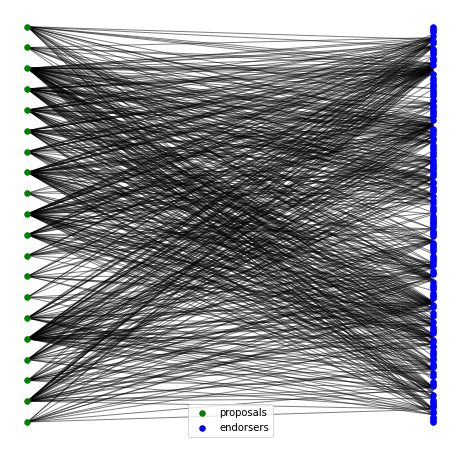

In [17]:
bimodal_net(props, ends, prop2end, labelx="proposals", labely="endorsers")

### 2.2. Clustering

As with the Southern Women dataset, we define the distance matrix between nodes through their pairwise $\phi$-correlation, later turned into a Euclidean distance.

We define a function to implement the method in the pipeline:

In [18]:
#compute phi correlation of two list binary (0s and 1s) vectors 
def phi_corr(v1, v2):
    N = len(v1)
    v1 = np.array(v1)
    v2 = np.array(v2)
    n1p = np.sum(v1)
    n2p = np.sum(v2)
    s = (v1+v2)/2
    n11 = np.sum(s[s==1])
    #print(n1p, n11, N)
    return (n11*N-n1p*n2p)/np.sqrt(n1p*n2p*(N-n1p)*(N-n2p))

#build normalised condensed distance matrix
def cond_dist_matrix(x, x2vect):
    phi = []
    nx = len(x)
    for i, xi in enumerate(x):
        vec_xi = x2vect[xi]
        for j in range(i+1, nx):
            vec_xj = x2vect[x[j]]  
            phi.append(phi_corr(vec_xi, vec_xj))
    #print(min(phi), max(phi))
    #check the length of phi is what we expect,  n(n-1)/2
    if len(phi) != nx*(nx-1)/2:
        raise ValueError("The dimensions of the condensed distance matrix are wrong.")
    #turn correlations to Euclidean distances (the phi are somewhat like the cosine)
    d = np.sqrt(2*(1-np.array(phi)))
    #normalise d to 1
    d /= max(d)
    return d

And another to do the clustering and plot the resulting tree:

In [19]:
#for importing from parent directory
import os,sys,inspect
currentdir = os.path.dirname(os.path.abspath(inspect.getfile(inspect.currentframe())))
parentdir = os.path.dirname(currentdir)
sys.path.insert(0, parentdir) 

In [20]:
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import linkage
from utils.clustering import agglomerative_clustering
import seaborn as sns

def tree_and_plot(d, d_df, method, verbose=0, fname2save=None):
    
    algo = "nn_chain" if method == "ward" else "generic"
    z, p = agglomerative_clustering(d, method=method,
                                        verbose=verbose, algorithm=algo)
    print(f"Final polarisation is {round(p[-1], 2)}")
    if method in ["ward", "centroid"]:
        z_sc = linkage(d, method)
        if np.isclose(z, z_sc).all() == False:
            print(f"Warning: result for method {method} differs from that of Scipy.")
    #heatmap -> remove the ticks because they are not informative (proposal ids)
    g = sns.clustermap(d_df, row_linkage=z, col_linkage=z, yticklabels = False
                      , xticklabels = False)
    if fname2save != None:
        plt.savefig(fname2save)
        print(f"Plot saved to {fname2save}!")
    plt.show()
    return z, p

In [21]:
from scipy.spatial.distance import squareform

d = cond_dist_matrix(props, prop2vect)
d_sq = squareform(d)
d_df = pd.DataFrame(d_sq, index=props, columns=props)

Iteration 18/18...
Final polarisation is 0.35
Plot saved to ../plots/CFE/CFE_Security_TreeWard.png!


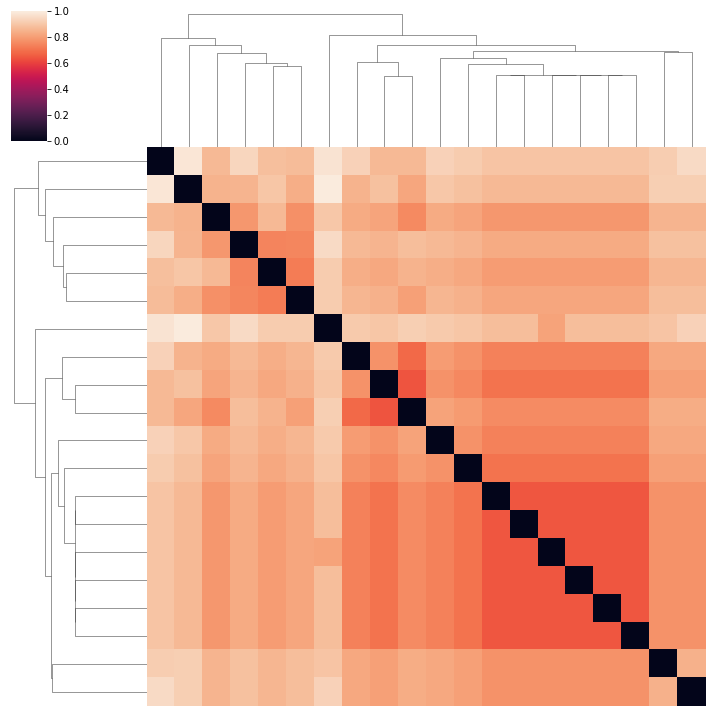

In [22]:
fname2save = "../plots/CFE/CFE_Security_TreeWard.png"
z, p = tree_and_plot(d, d_df, method="ward", fname2save=fname2save)

### 2.3. Evaluation

This is the only part that differs from the analysis in *SouthernWomen.ipynb*. Since now we are working with current, unstudied data, we don't have a reference to compare our results with. However, given that we are working with text (the titles and bodies of the proposals), we can qualitatively evaluate the final state through such text. Note that this would not be possible, or at least not directly, if we were doing the analysis on endorsers.

There are a number of ways to go about this. The most obvious (and cumbersome) is to read all the proposals (more than $10^3$) and apply some predefined labelling criterion that allows to evaluate the final partition. But since one would rather have at least a quantitative component and reduce subjectivity as much as possible, and given that this is not a master's thesis on sociometrics but on data science, we may leverage the power of natural language processing methods. One of such methods is *word shifts*, as those implemented in the *shifterator* package [4, 5].

Word shifts are a tool for pairwise comparisons between texts that captures which words contribute to their difference and how. The contributions of the most relevant words are then visualized through horizontal bar charts called *word shift graphs*.

Shifterator's main input is the bag-of-words (BOW) representation of each of the two text to be compared, in the form of a dictionary whose keys are word types and whose values are the frequence of the corresponding word in the given text. The package provides several text comparison measures, which include relative frequency, Shannon entropy, Tsallis entropy, the Kullback-Leibler divergence, and the Jensen-Shannon divergence.

The approach for evaluation will thus be: i) retrieve the total text of each cluster of a final partition; ii) build their respective BOW representations; iii) obtain their word shift graph; iv) analyse the graph.

**NB.** The BOW representation (steo 2) may be improved by ignoring words that are deemed irrelevant for the subsequent analysis, known as *stop words* (prepositions, determiners, etc.). However, whether a given word is irrelevant depends highly on the application, so these must be handled with care. Below (in the function *bow_dict*), I use a predefined minimal list of stop words provided by the *nltk* package that I checked previously, to which I add some extra stop words found in the word shift plots. There are also some stop words candidates I found for which was not quite sure, so I leave as an option whether to apply them or not (the default applies only the nltk list + the clear stop words found).

We therefore define a function to obtain the cluster configuration at a given clustering step (by default, the last), another to get the total text corresponding to the proposals of a given cluster, one more to build the BOW of a given text and a last one to perform and plot the word shift:

In [23]:
def z_to_config(z, x, step=None):
    clusters = x
    idx2x = {i:[xi] for i, xi in enumerate(clusters)}
    n = z.shape[0] + 1
    i = 0
    if step == None:
        step = n
    while i < step - 1:
        clus_x = int(z[i,0])
        clus_y = int(z[i,1])
        new_clus = idx2x[clus_x] + idx2x[clus_y]
        idx2x[int(i+n)] = new_clus
        del idx2x[clus_x]
        del idx2x[clus_y]
#        print(f"****Clusters at step {i}****")
 #       for val in idx2x.values():
  #          print(f"{val}")
        i += 1
    return list(idx2x.values())

def get_proposals(cluster):
    text = ""
    for id in cluster:
        title = df[df["id"] == id]["title/en"].values[0]
        body = df[df["id"] == id]["body/en"].values[0]
        #print(id, title,"******\n", body)
        text += " " + title.strip() 
        if pd.isna(body) == False:
            text += ". " + body.strip()
    return text

from sklearn.feature_extraction.text import CountVectorizer
#import nltk
#nltk.download('stopwords')
from nltk.corpus import stopwords
found_sw = ['com', 'org', 'https', 'also', 'www'
            , 'oder', 'werden', 'und', 'von', 'unter'
           , 'vor', 'der', 'per', 'etc', 'de', 'les'
           , 'la', 'et', 'un', 'pour', 'en', 'une'
           , 'ceux', 'ne', 'qui', 'sont', 'és', 'pdf']
possible_sw = ['maybe', '03', '06', '27', '100', 'eu'
              , 'many', 'among', '50', 'would', 'could'
              , 'though', '13', '000', '55', 'co', 'die'
              , '70', '130', '20', 'get', '16', '529'
               , '11']

def bow_dict(text, complete_stop_words=False):
    #add stop words (prepositions, determiners, and other
    #uninteresting words)
    sw = stopwords.words("english")
    sw = sw + found_sw
    if complete_stop_words:
        sw = sw + possible_sw
    count_vec = CountVectorizer(stop_words=sw)
    text = count_vec.fit_transform([text])
    w2pos = count_vec.vocabulary_    
    return {w: text[0, w2pos[w]] for w in w2pos.keys()}

import shifterator as sh

def wordshift_graph(z, x, title=None, fname2save=None
                    , complete_stop_words=False):
    clusters = z_to_config(z, x, len(x)-1)
    
    text1 = get_proposals(clusters[0])
    text2 = get_proposals(clusters[1])  

    bow1 = bow_dict(text1, complete_stop_words)
    bow2 = bow_dict(text2, complete_stop_words)
    
    jsd_shift = sh.JSDivergenceShift(type2freq_1=bow1,
                                     type2freq_2=bow2,
                                     weight_1=0.5,
                                     weight_2=0.5,
                                     base=2,
                                     alpha=1)
    jsd_shift.get_shift_graph(system_names = ['Cluster 1', 'Cluster 2'],
                              title=title)
    if fname2save != None:
        plt.savefig(fname2save)
        print(f"Plot saved to {fname2save}!")
    plt.show()

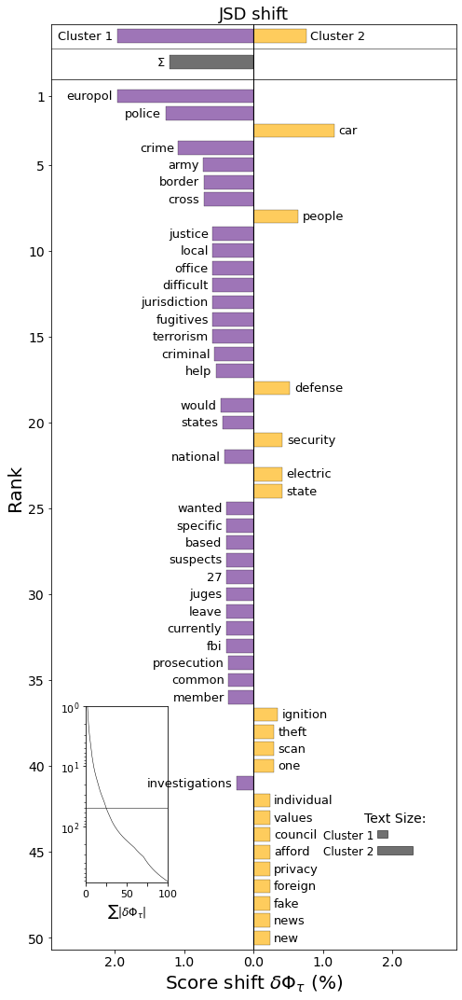

Plot saved to ../plots/CFE/CFE_Security_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

In [24]:
fname2save = "../plots/CFE/CFE_Security_WordshiftWard.png"
title = "JSD shift"
wordshift_graph(z, props, title, fname2save=fname2save)

The top of the plot shows the bars corresponding to the total JSD of each text relative to one another, while the below bar with the $\Sigma$ shows the direction of their difference. By the title and Σ, we see that Cluster 1 has a JSD of about 3x that of cluster 2.

The subplot to the left is the cumulative contribution plot, which traces how the total JSD shift changes as we add more words according to their rank. The horizontal line shows the cutoff of the contributions of the top 50 words plotted versus those that are not, which means that in this case about 25% of the overall difference is explained by the top 50 words.

We can also see the relative size (in number of word occurrences, including repeated ones) of the texts belonging to each cluster at the right, showing that Cluste 1 is (excluding stop words) less than half the size of Cluster 2.

### 2.4. Evolution with $\alpha$

Function for obtaining and plotting the evolution of the polarisation throughout the clustering for different $\alpha$:

In [25]:
def pol_vs_alpha(d, topic=None, alphas=np.arange(0.1, 1.7, 0.2)):
    for method in ["poldist", "centroid", "ward"]:
        algo = "nn_chain" if method == "ward" else "generic"
        for alpha in alphas:
            _, p = agglomerative_clustering(d, method=method
                                            , alpha=alpha, algorithm=algo)
            plt.plot(p, "-", label="alpha="+str(round(alpha,1)))
        m_name = method[0].upper() + method[1:]
        plt.title(m_name)
        plt.xlabel("Clustering step")
        plt.ylabel("P")
        plt.legend()
        fname2save = "../plots/CFE/CFE_" + topic + "_Polarisation" + m_name + ".png"
        plt.savefig(fname2save)
        print(f"Plot saved to {fname2save}!")
        plt.show()

Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Plot saved to ../plots/CFE/CFE_Security_PolarisationPoldist.png!


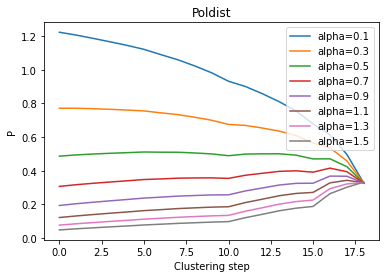

Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Plot saved to ../plots/CFE/CFE_Security_PolarisationCentroid.png!


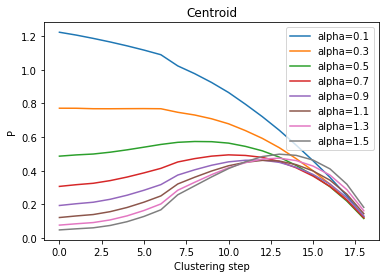

Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Plot saved to ../plots/CFE/CFE_Security_PolarisationWard.png!


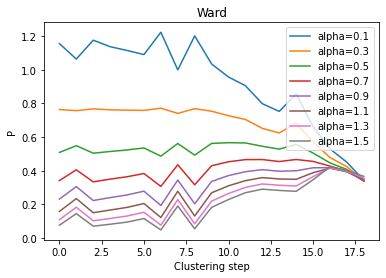

In [26]:
pol_vs_alpha(d, "Security")

Functions to check the RF distance between the Ward, poldist and centroid trees. As in **SouthernWomen.ipynb**, I use the library *dendropy*:

In [27]:
#!pip install dendropy

In [28]:
import dendropy
from dendropy.calculate import treecompare
from utils.clustering import agglomerative_clustering
from matplotlib.ticker import MaxNLocator

#produce tree string in Newick format from a linkage matrix z
def z_to_tree_str_newick(z, x):
    tree_str = ""
    clusters = x
    idx2x = {i:str(xi) for i, xi in enumerate(x)}#str(xi) when using id as x
    x2idx = {str(xi):i for i, xi in enumerate(x)}
    n = z.shape[0] + 1
    for i in range(n-1):
        new_clus = "(" + idx2x[int(z[i,0])] + "," + idx2x[int(z[i,1])] + ")"
        idx2x[int(i+n)] = new_clus
    #the "[&R]" specifies that the tree is rooted
    idx2x[int(2*n-2)] = "[&R] " + idx2x[int(2*n-2)] + ";"
    return idx2x[int(2*n-2)]

#compute the unweighted Robinson-Foulds distance between two 
#trees given their strings in Newick format
def RF_dist(tree_str1, tree_str2):
    # trees need to have the same TaxonNamespace for RF distance
    tns = dendropy.TaxonNamespace()
    tree1 = dendropy.Tree.get_from_string(tree_str1, "newick",
            taxon_namespace=tns)
    tree2 = dendropy.Tree.get_from_string(tree_str2, "newick",
            taxon_namespace=tns)
    #have to compute bipàrtitions of both trees 
    #before calling symmetric_difference
    tree1.encode_bipartitions()
    tree2.encode_bipartitions()
    #return unweighted RF distance
    return treecompare.symmetric_difference(tree1, tree2)

#produce and save plot of RF distances vs alpha
def tree_dists(d, x, alphas=np.logspace(-1, 1, 20)#from 1e-1 to 1e1
               , title=None, fname2save=None):
    dist_p2c = []
    dist_p2w = []
    dist_p2p0 = []

    z_pld0, _ = agglomerative_clustering(d, method='poldist'
                                              , alpha=0)
    tp0_str = z_to_tree_str_newick(z_pld0, x)

    for alpha in alphas:
        print(f"***** alpha={round(alpha, 2)} *****")
        z_pld, _ = agglomerative_clustering(d, method='poldist'
                                              , alpha=alpha)
        z_ctr, _ = agglomerative_clustering(d, method='centroid')
        z_wrd, _ = agglomerative_clustering(d, method='ward', algorithm="nn_chain")

        tp_str = z_to_tree_str_newick(z_pld, x)
        tc_str = z_to_tree_str_newick(z_ctr, x)
        tw_str = z_to_tree_str_newick(z_wrd, x)

        dist_p2c.append(RF_dist(tp_str, tc_str))
        dist_p2w.append(RF_dist(tp_str, tw_str))
        dist_p2p0.append(RF_dist(tp0_str, tp_str))

    ax = plt.figure().gca()
    ax.plot(alphas, dist_p2c, "-d", label="p2c")
    ax.plot(alphas, dist_p2w, "*-", label="p2w")
    ax.plot(alphas, dist_p2p0, ".-", label="p2p0")
    plt.xscale("log")
    maxd = np.max([dist_p2p0, dist_p2c, dist_p2w])
    plt.vlines(1.6, 0, maxd*1.1, colors='k', linestyles='dashed')
    plt.fill_betweenx([0, maxd*1.1]
                      , 1.6, np.max(alphas), alpha=0.5
                      , color="gray")

    ax.yaxis.set_major_locator(MaxNLocator(integer=True))
    if title == None:
        plt.title(r"Topological tree distance ($D_{RF}$) vs $\alpha$")
    plt.xlabel(r"$\alpha$")
    plt.ylabel(r"$D_{RF}$")
    plt.legend()
    if fname2save != None:
        plt.savefig(fname2save)
        print(f"Plot saved to {fname2save}!")
    plt.show()

Iteration 18/18...
***** alpha=0.1 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=0.13 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=0.16 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=0.21 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=0.26 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=0.34 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=0.43 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=0.55 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=0.7 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=0.89 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=1.13 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=1.44 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=1.83 *****


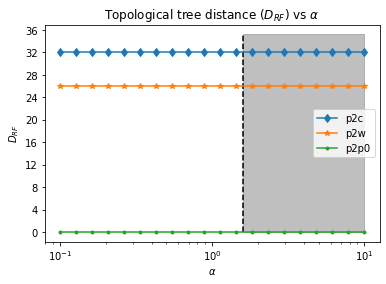

In [29]:
#alphas = np.logspace(-1, 3, 20)
fname2save = "../plots/CFE/CFE_Security_RFdistVsAlpha.png"
tree_dists(d, props#, alphas=alphas
           , fname2save=fname2save)

We're done with function definitions, let us apply the pipeline!

## 3. Pipeline

### 3.1. Analysis by topic

Now we can pass all topics through the whole pipeline:

====== Using resources efficiently for a circular economy  ======
Total number of endorsers: 561
Number of unique endorsers: 335
Number of proposals: 53
Plot saved to ../plots/CFE/CFE_Using_resources_efficiently_for_a_circular_economy_Net.png!


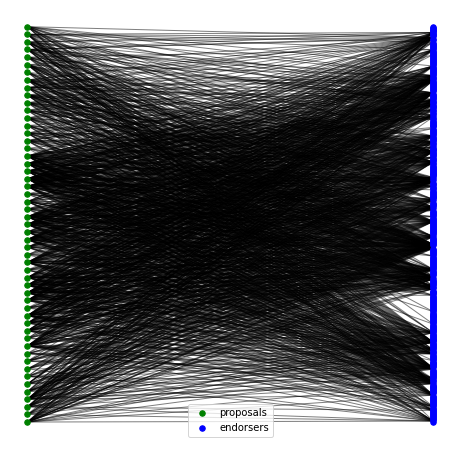

****** WARD ******
Iteration 51/51...
Final polarisation is 0.27
Plot saved to ../plots/CFE/CFE_Using_resources_efficiently_for_a_circular_economy_TreeWard.png!


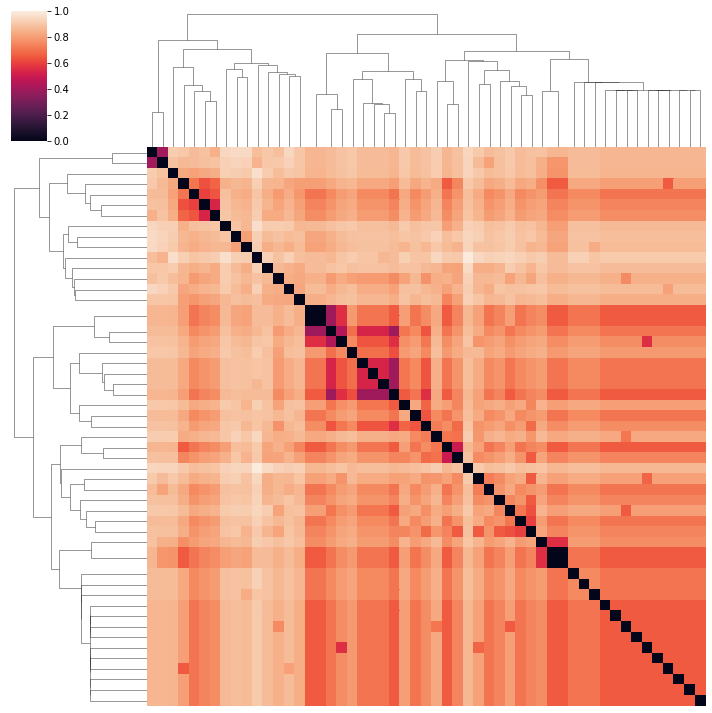

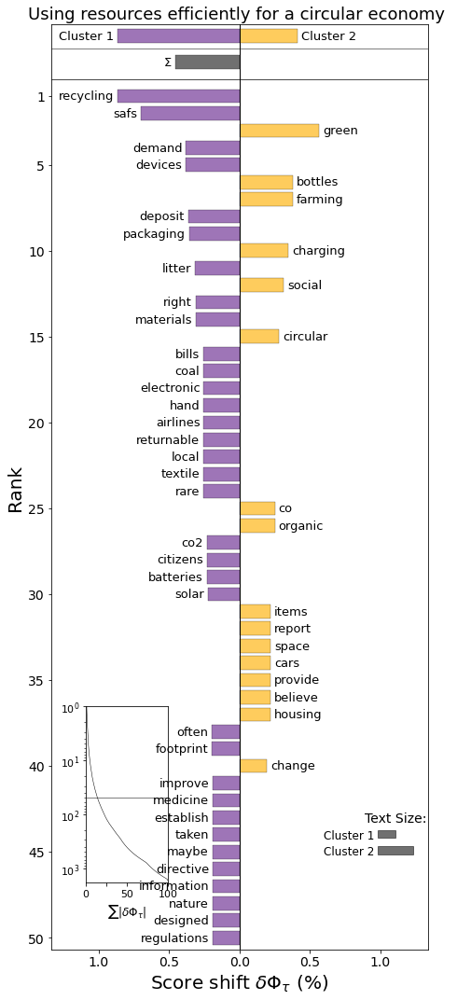

Plot saved to ../plots/CFE/CFE_Using_resources_efficiently_for_a_circular_economy_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 51/51...
Final polarisation is 0.05
Plot saved to ../plots/CFE/CFE_Using_resources_efficiently_for_a_circular_economy_TreeCentroid.png!


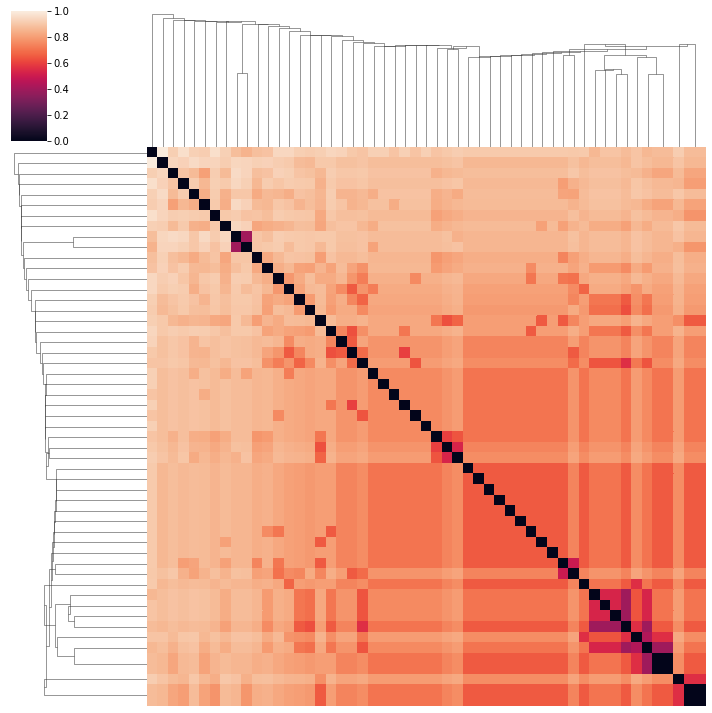

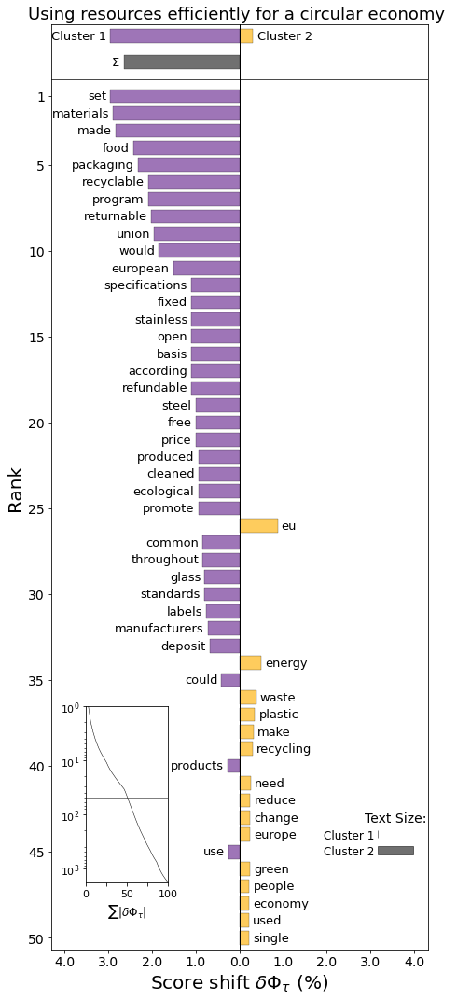

Plot saved to ../plots/CFE/CFE_Using_resources_efficiently_for_a_circular_economy_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 51/51...
Final polarisation is 0.28
Plot saved to ../plots/CFE/CFE_Using_resources_efficiently_for_a_circular_economy_TreePoldist.png!


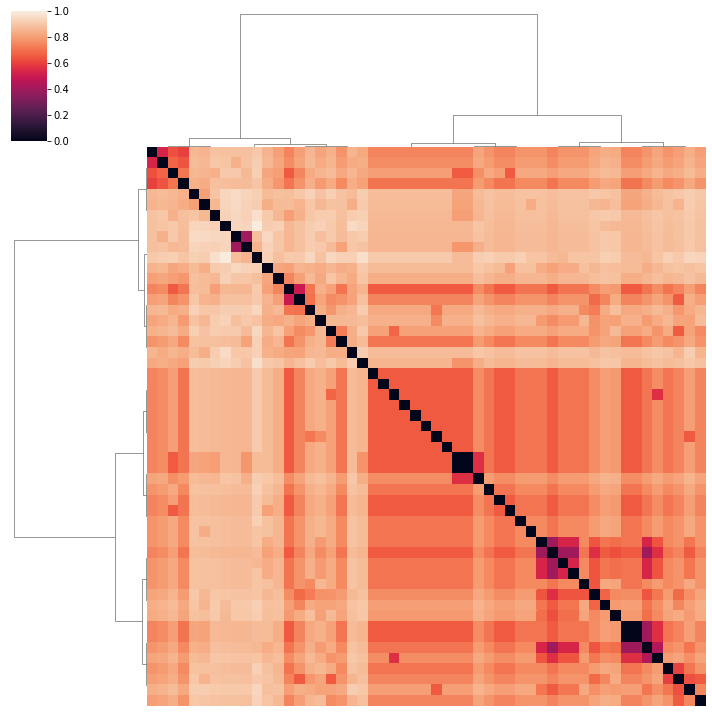

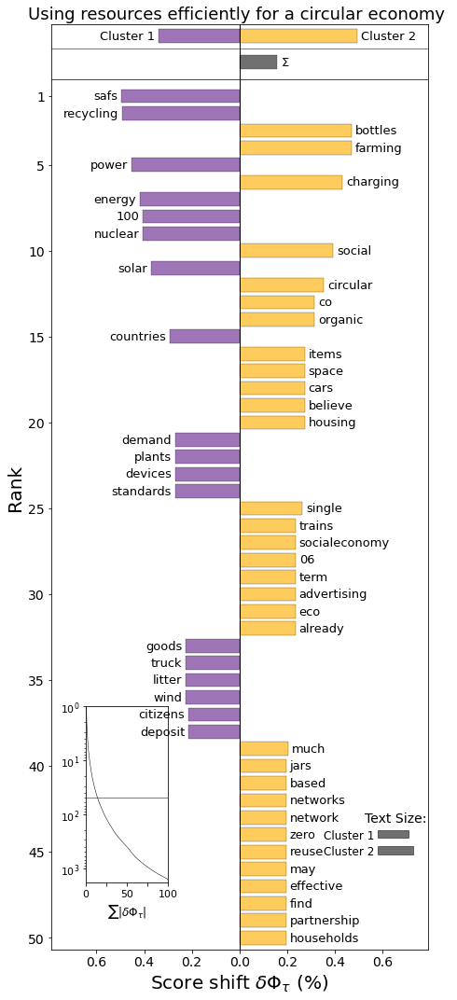

Plot saved to ../plots/CFE/CFE_Using_resources_efficiently_for_a_circular_economy_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
Plot saved to ../plots/CFE/CFE_Using_resources_efficiently_for_a_circular_economy_PolarisationPoldist.png!


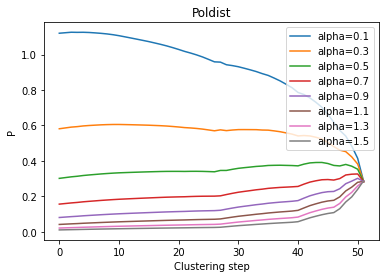

Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
Plot saved to ../plots/CFE/CFE_Using_resources_efficiently_for_a_circular_economy_PolarisationCentroid.png!


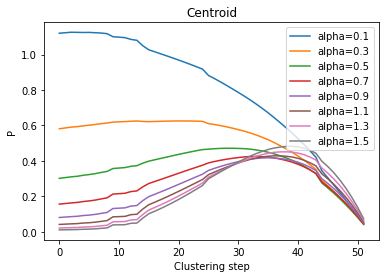

Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
Plot saved to ../plots/CFE/CFE_Using_resources_efficiently_for_a_circular_economy_PolarisationWard.png!


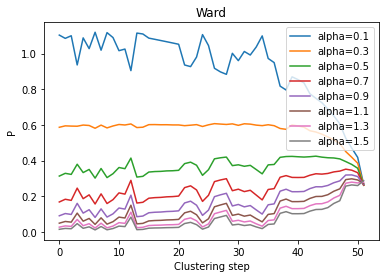

Iteration 51/51...
***** alpha=0.1 *****
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
***** alpha=0.13 *****
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
***** alpha=0.16 *****
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
***** alpha=0.21 *****
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
***** alpha=0.26 *****
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
***** alpha=0.34 *****
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
***** alpha=0.43 *****
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
***** alpha=0.55 *****
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
***** alpha=0.7 *****
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
***** alpha=0.89 *****
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
***** alpha=1.13 *****
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
***** alpha=1.44 *****
Iteration 51/51...
Iteration 51/51...
Iteration 51/51...
***** alpha=1.83 *****


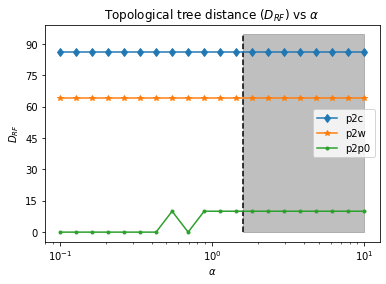

====== Ensuring a fair and inclusive transition ======
Total number of endorsers: 791
Number of unique endorsers: 673
Number of proposals: 46
Plot saved to ../plots/CFE/CFE_Ensuring_a_fair_and_inclusive_transition_Net.png!


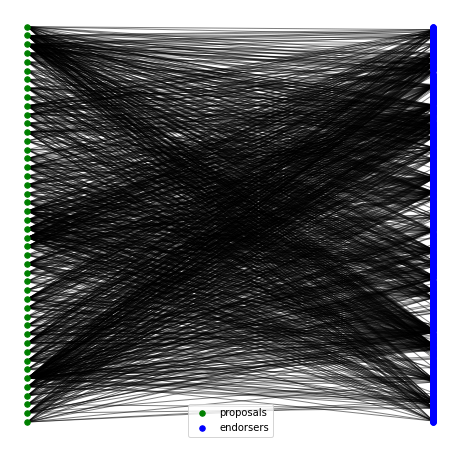

****** WARD ******
Iteration 44/44...
Final polarisation is 0.29
Plot saved to ../plots/CFE/CFE_Ensuring_a_fair_and_inclusive_transition_TreeWard.png!


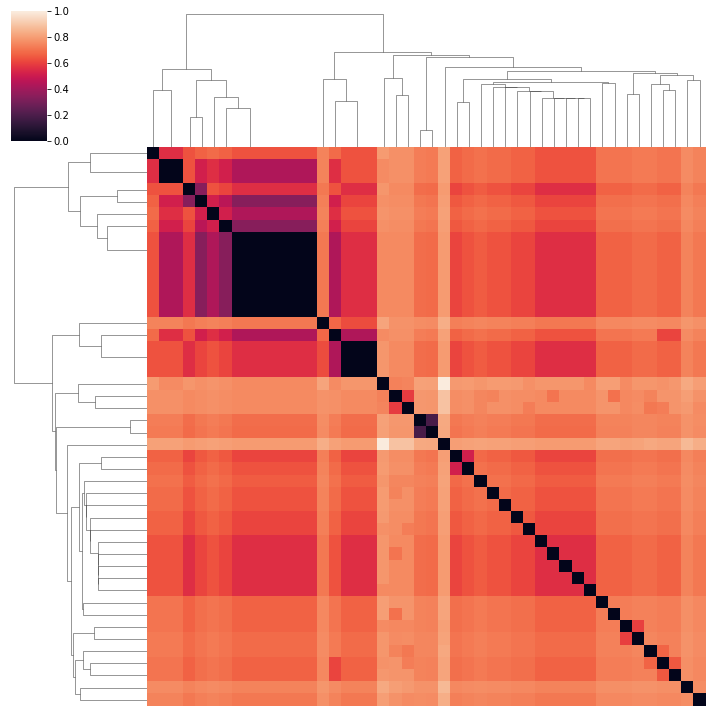

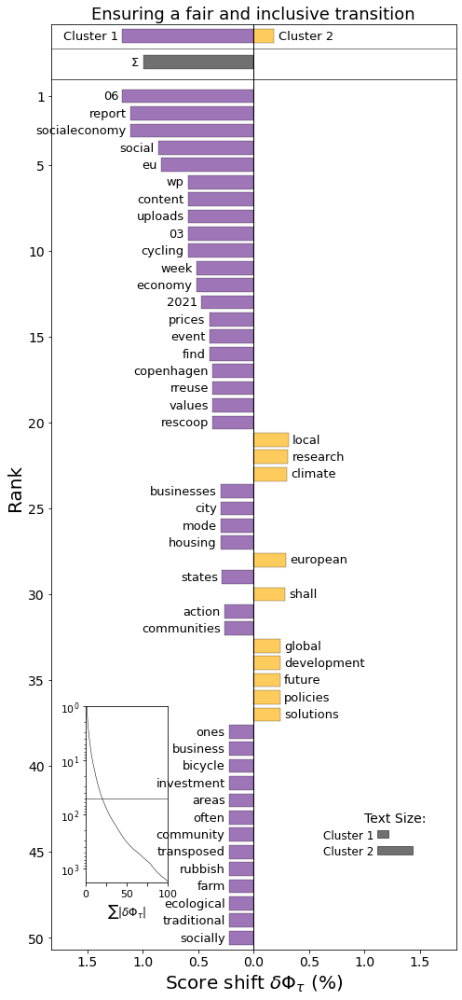

Plot saved to ../plots/CFE/CFE_Ensuring_a_fair_and_inclusive_transition_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 44/44...
Final polarisation is 0.06
Plot saved to ../plots/CFE/CFE_Ensuring_a_fair_and_inclusive_transition_TreeCentroid.png!


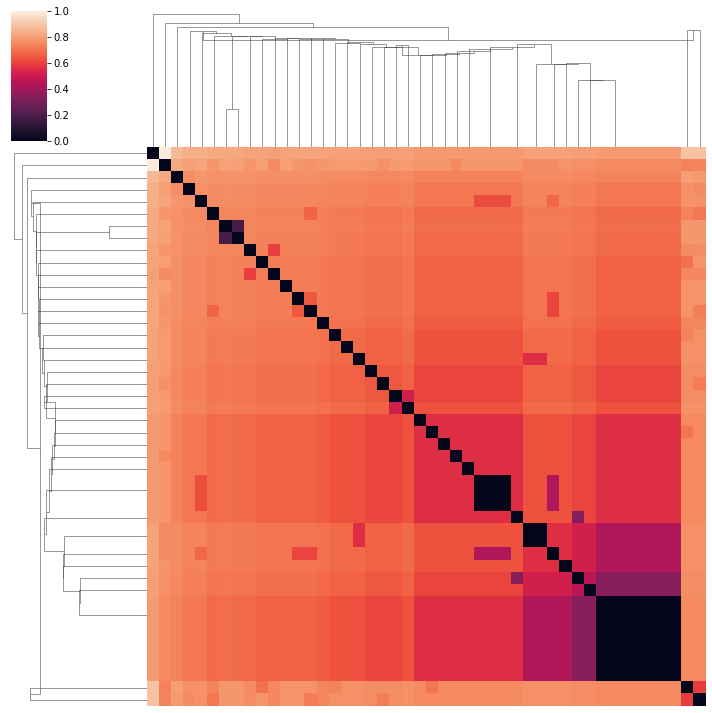

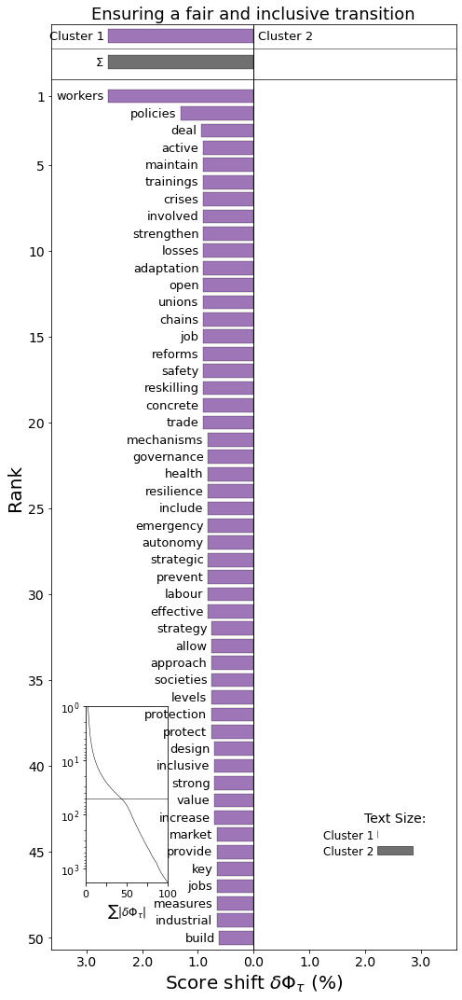

Plot saved to ../plots/CFE/CFE_Ensuring_a_fair_and_inclusive_transition_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 44/44...
Final polarisation is 0.3
Plot saved to ../plots/CFE/CFE_Ensuring_a_fair_and_inclusive_transition_TreePoldist.png!


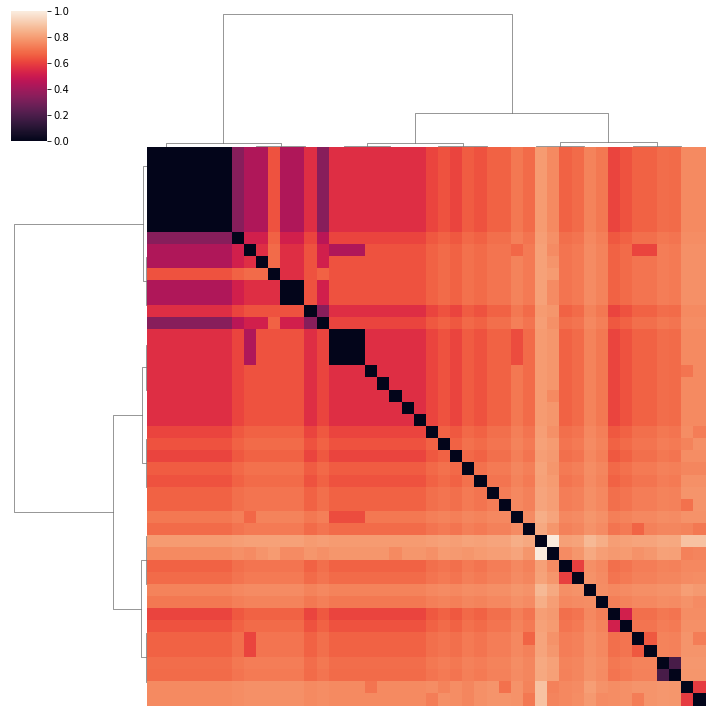

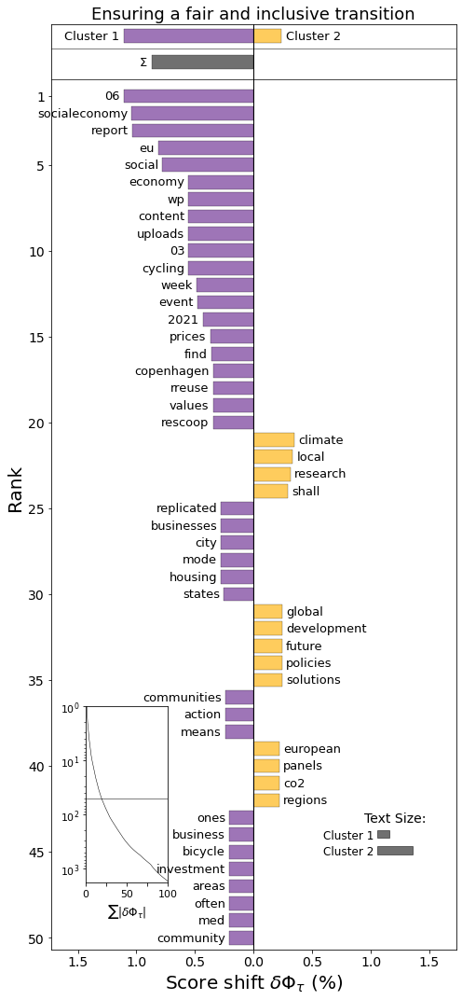

Plot saved to ../plots/CFE/CFE_Ensuring_a_fair_and_inclusive_transition_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
Plot saved to ../plots/CFE/CFE_Ensuring_a_fair_and_inclusive_transition_PolarisationPoldist.png!


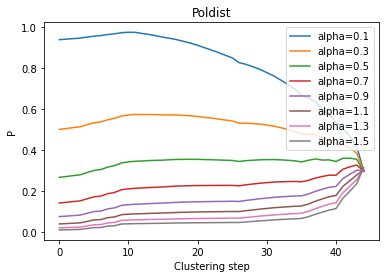

Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
Plot saved to ../plots/CFE/CFE_Ensuring_a_fair_and_inclusive_transition_PolarisationCentroid.png!


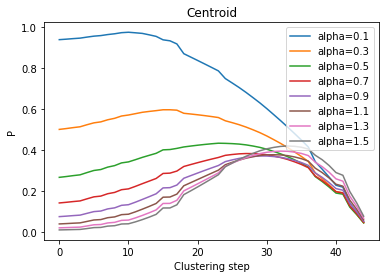

Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
Plot saved to ../plots/CFE/CFE_Ensuring_a_fair_and_inclusive_transition_PolarisationWard.png!


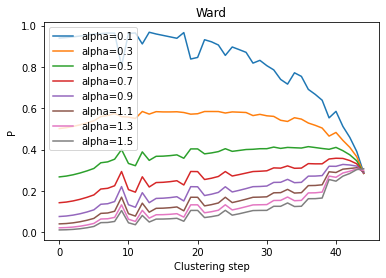

Iteration 44/44...
***** alpha=0.1 *****
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
***** alpha=0.13 *****
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
***** alpha=0.16 *****
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
***** alpha=0.21 *****
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
***** alpha=0.26 *****
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
***** alpha=0.34 *****
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
***** alpha=0.43 *****
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
***** alpha=0.55 *****
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
***** alpha=0.7 *****
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
***** alpha=0.89 *****
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
***** alpha=1.13 *****
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
***** alpha=1.44 *****
Iteration 44/44...
Iteration 44/44...
Iteration 44/44...
***** alpha=1.83 *****


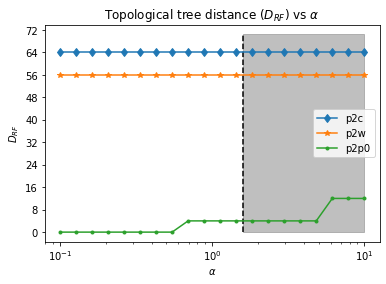

====== Restoring biodiversity and cutting pollution ======
Total number of endorsers: 786
Number of unique endorsers: 461
Number of proposals: 79
Plot saved to ../plots/CFE/CFE_Restoring_biodiversity_and_cutting_pollution_Net.png!


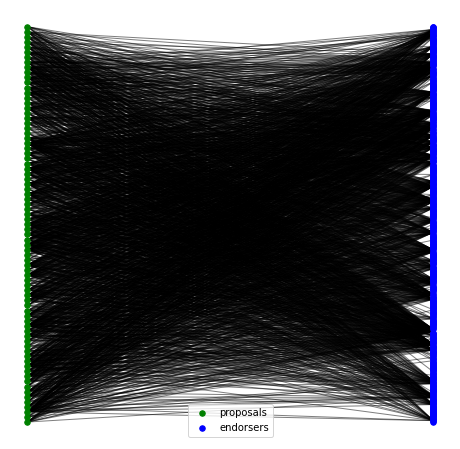

****** WARD ******
Iteration 77/77...
Final polarisation is 0.18
Plot saved to ../plots/CFE/CFE_Restoring_biodiversity_and_cutting_pollution_TreeWard.png!


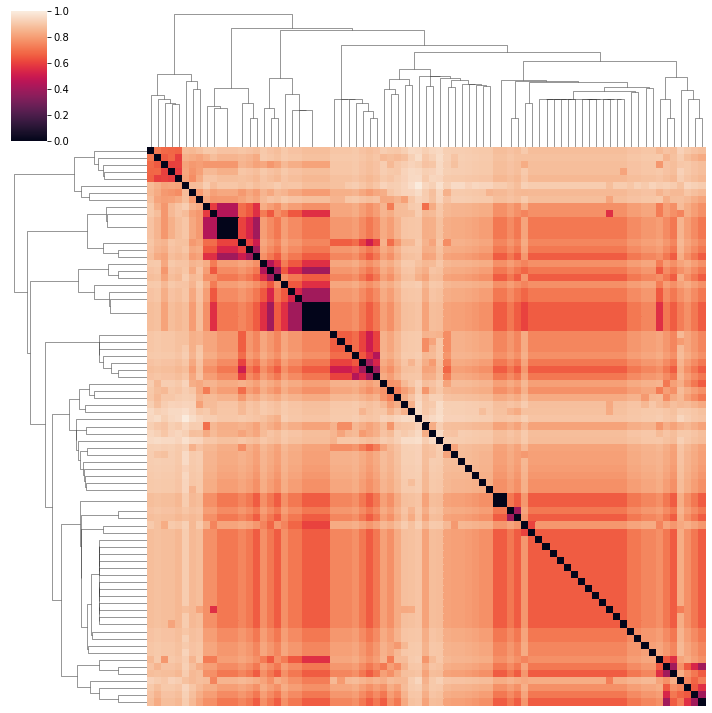

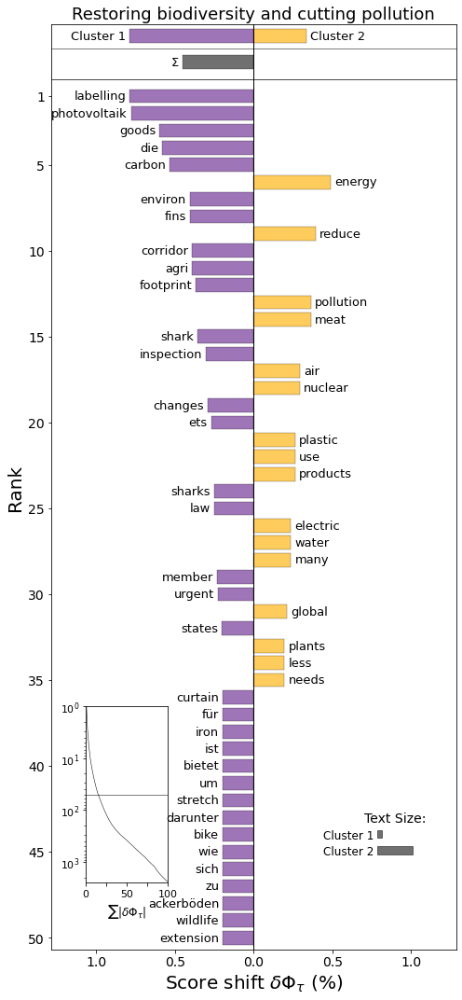

Plot saved to ../plots/CFE/CFE_Restoring_biodiversity_and_cutting_pollution_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 77/77...
Final polarisation is 0.04
Plot saved to ../plots/CFE/CFE_Restoring_biodiversity_and_cutting_pollution_TreeCentroid.png!


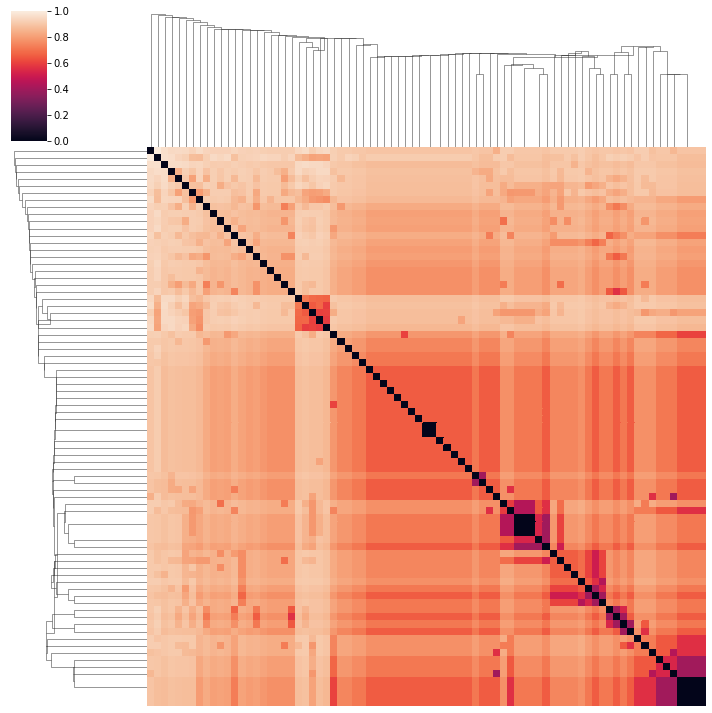

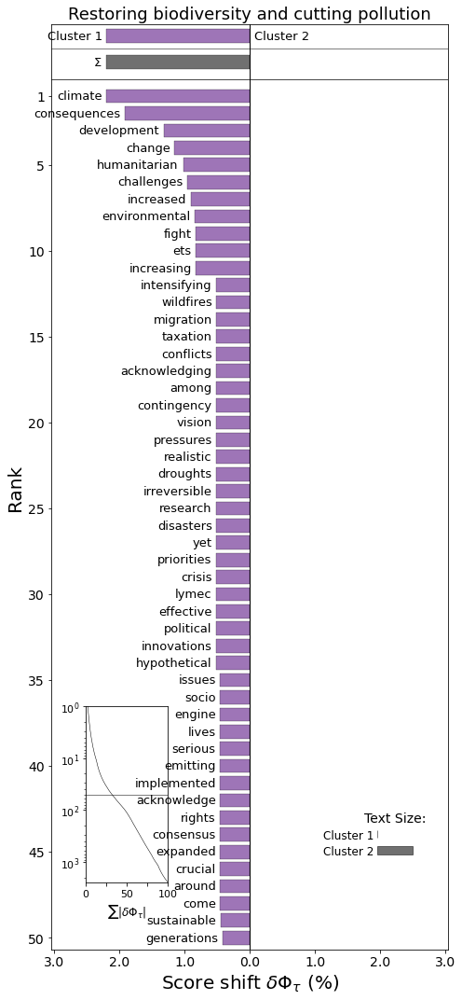

Plot saved to ../plots/CFE/CFE_Restoring_biodiversity_and_cutting_pollution_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 77/77...
Final polarisation is 0.18
Plot saved to ../plots/CFE/CFE_Restoring_biodiversity_and_cutting_pollution_TreePoldist.png!


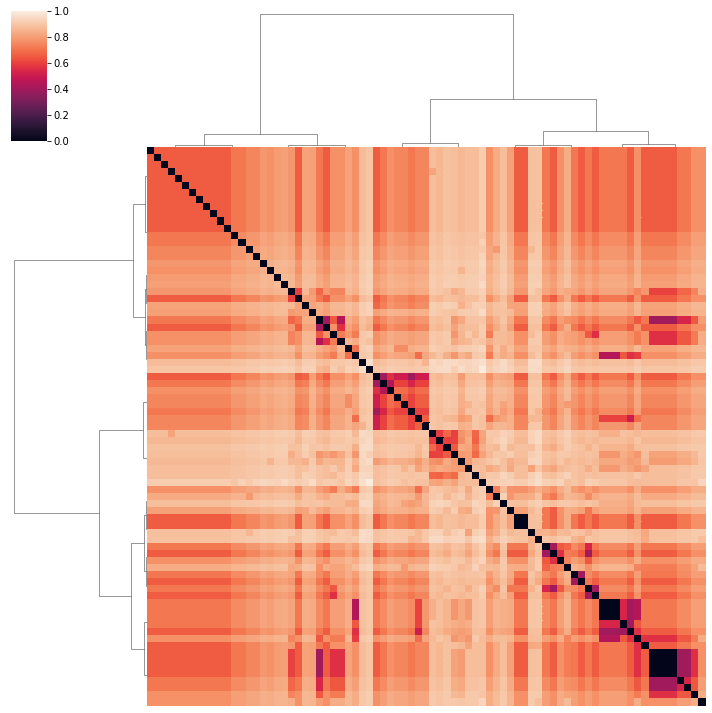

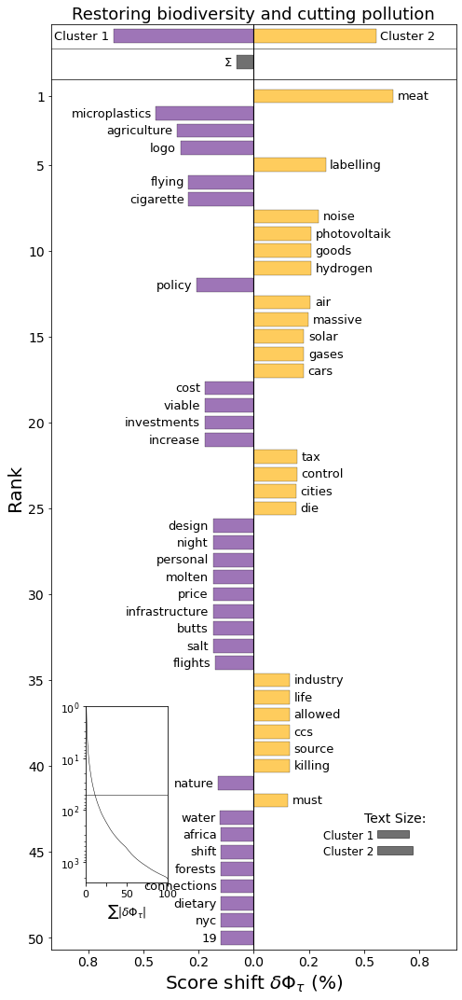

Plot saved to ../plots/CFE/CFE_Restoring_biodiversity_and_cutting_pollution_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
Plot saved to ../plots/CFE/CFE_Restoring_biodiversity_and_cutting_pollution_PolarisationPoldist.png!


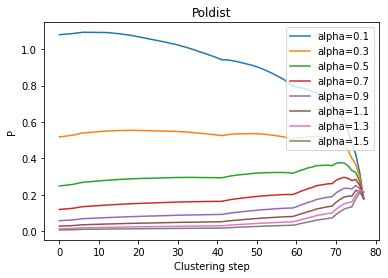

Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
Plot saved to ../plots/CFE/CFE_Restoring_biodiversity_and_cutting_pollution_PolarisationCentroid.png!


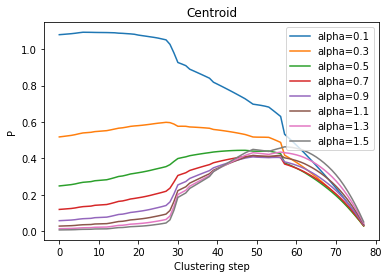

Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
Plot saved to ../plots/CFE/CFE_Restoring_biodiversity_and_cutting_pollution_PolarisationWard.png!


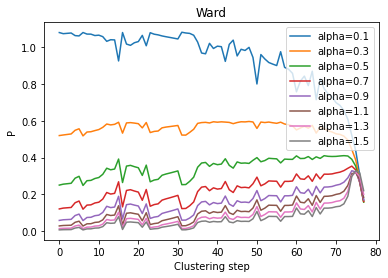

Iteration 77/77...
***** alpha=0.1 *****
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
***** alpha=0.13 *****
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
***** alpha=0.16 *****
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
***** alpha=0.21 *****
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
***** alpha=0.26 *****
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
***** alpha=0.34 *****
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
***** alpha=0.43 *****
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
***** alpha=0.55 *****
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
***** alpha=0.7 *****
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
***** alpha=0.89 *****
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
***** alpha=1.13 *****
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
***** alpha=1.44 *****
Iteration 77/77...
Iteration 77/77...
Iteration 77/77...
***** alpha=1.83 *****


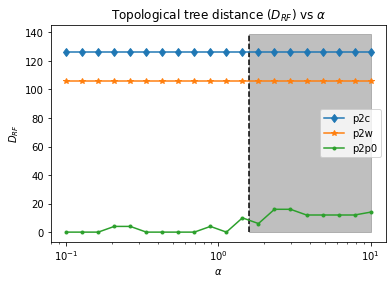

====== Promoting healthy lifestyles ======
Total number of endorsers: 91
Number of unique endorsers: 75
Number of proposals: 15
Plot saved to ../plots/CFE/CFE_Promoting_healthy_lifestyles_Net.png!


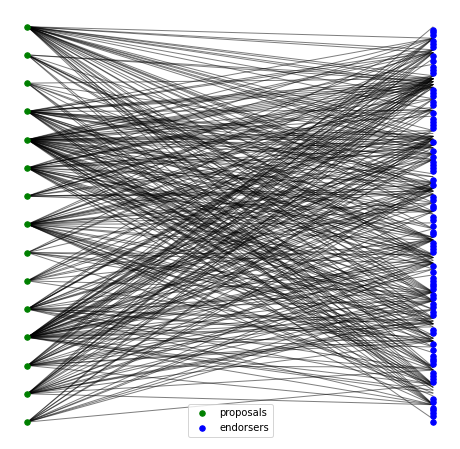

****** WARD ******
Iteration 13/13...
Final polarisation is 0.18
Plot saved to ../plots/CFE/CFE_Promoting_healthy_lifestyles_TreeWard.png!


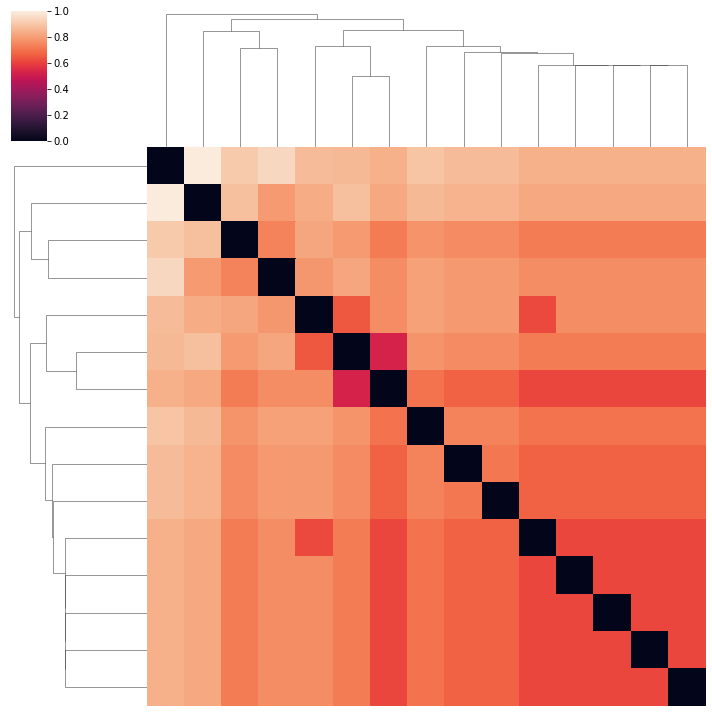

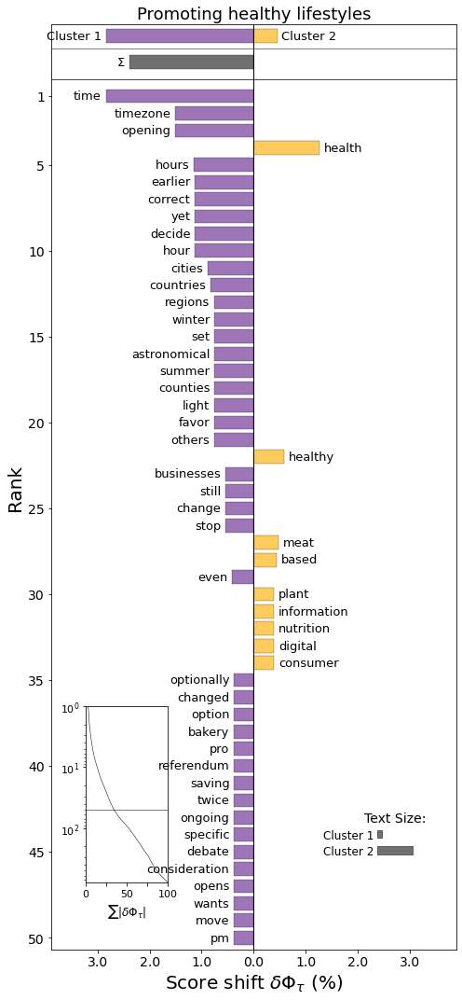

Plot saved to ../plots/CFE/CFE_Promoting_healthy_lifestyles_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 13/13...
Final polarisation is 0.18
Plot saved to ../plots/CFE/CFE_Promoting_healthy_lifestyles_TreeCentroid.png!


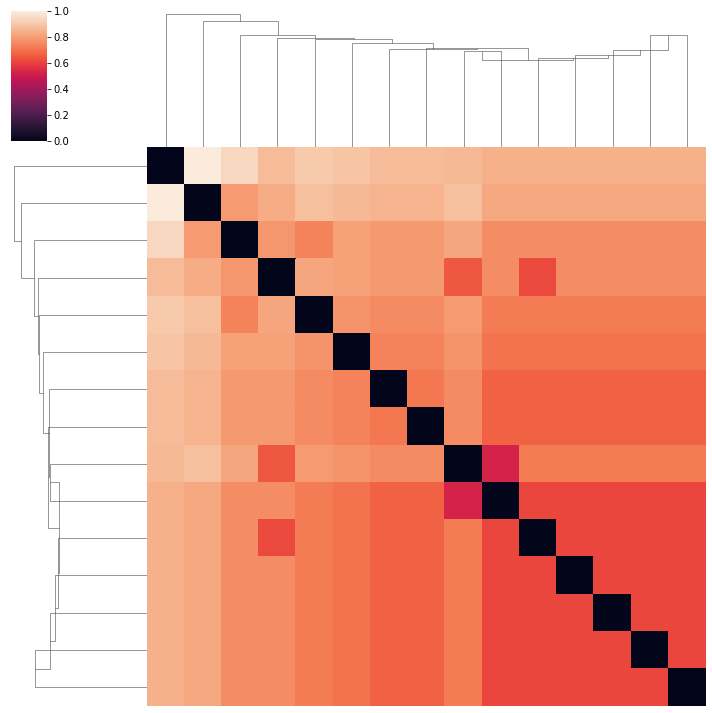

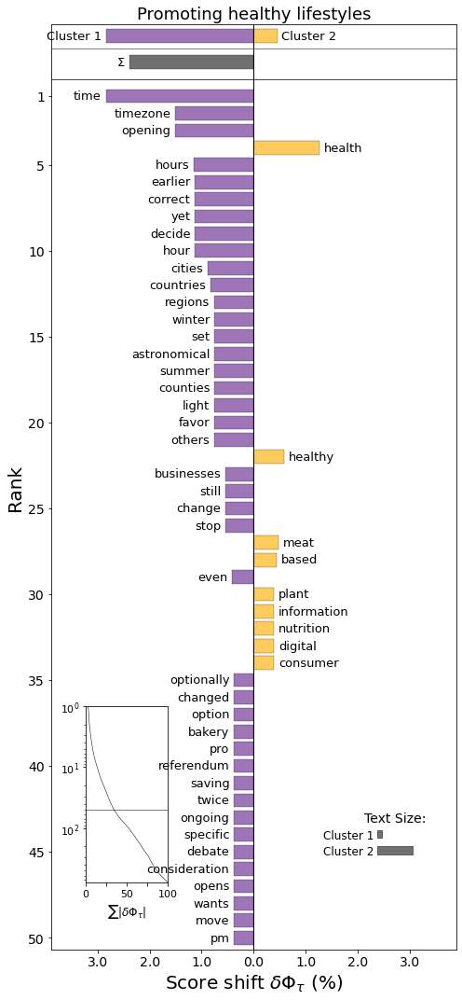

Plot saved to ../plots/CFE/CFE_Promoting_healthy_lifestyles_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 13/13...
Final polarisation is 0.31
Plot saved to ../plots/CFE/CFE_Promoting_healthy_lifestyles_TreePoldist.png!


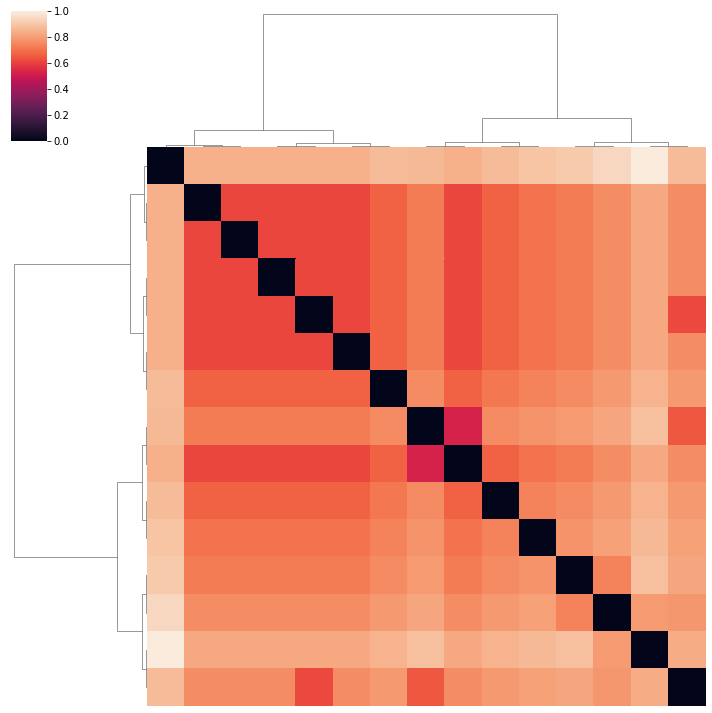

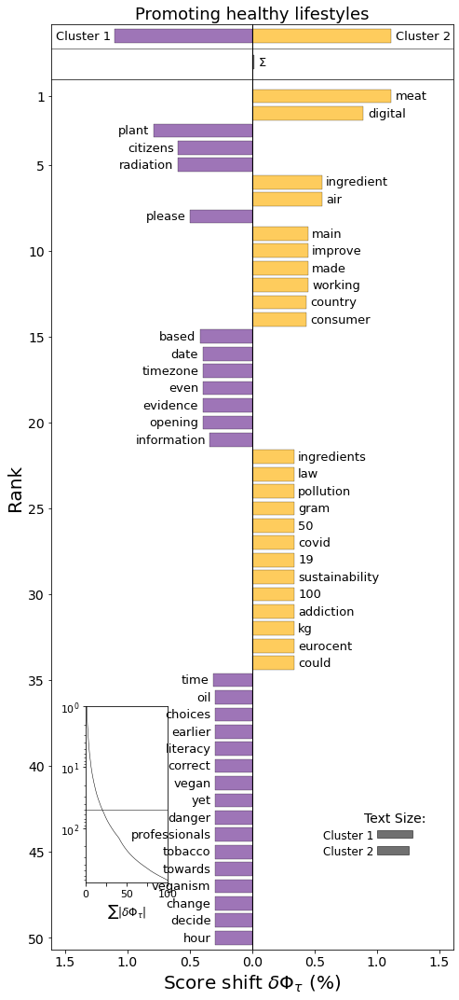

Plot saved to ../plots/CFE/CFE_Promoting_healthy_lifestyles_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Plot saved to ../plots/CFE/CFE_Promoting_healthy_lifestyles_PolarisationPoldist.png!


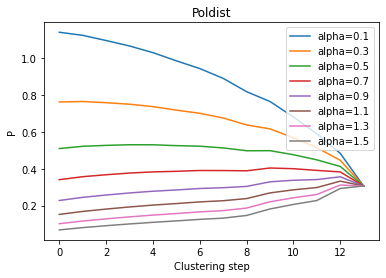

Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Plot saved to ../plots/CFE/CFE_Promoting_healthy_lifestyles_PolarisationCentroid.png!


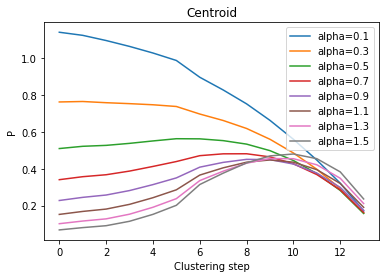

Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Plot saved to ../plots/CFE/CFE_Promoting_healthy_lifestyles_PolarisationWard.png!


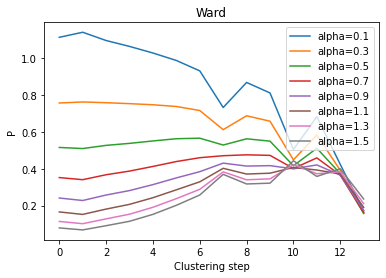

Iteration 13/13...
***** alpha=0.1 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=0.13 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=0.16 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=0.21 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=0.26 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=0.34 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=0.43 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=0.55 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=0.7 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=0.89 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=1.13 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=1.44 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=1.83 *****


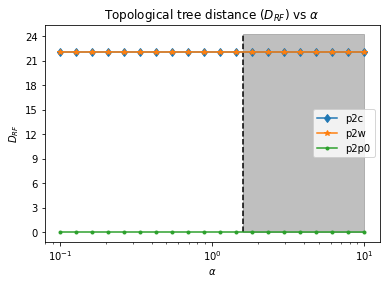

====== Coronavirus ======
Total number of endorsers: 54
Number of unique endorsers: 45
Number of proposals: 15
Plot saved to ../plots/CFE/CFE_Coronavirus_Net.png!


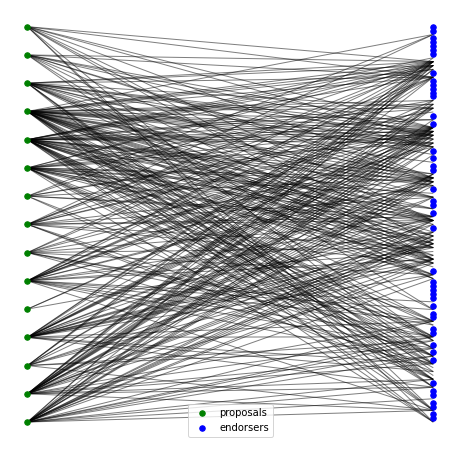

****** WARD ******
Iteration 13/13...
Final polarisation is 0.34
Plot saved to ../plots/CFE/CFE_Coronavirus_TreeWard.png!


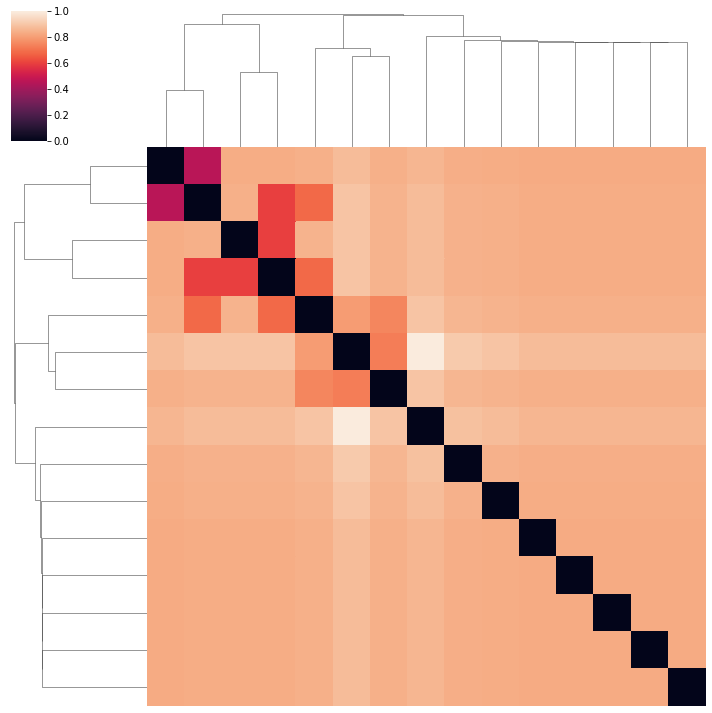

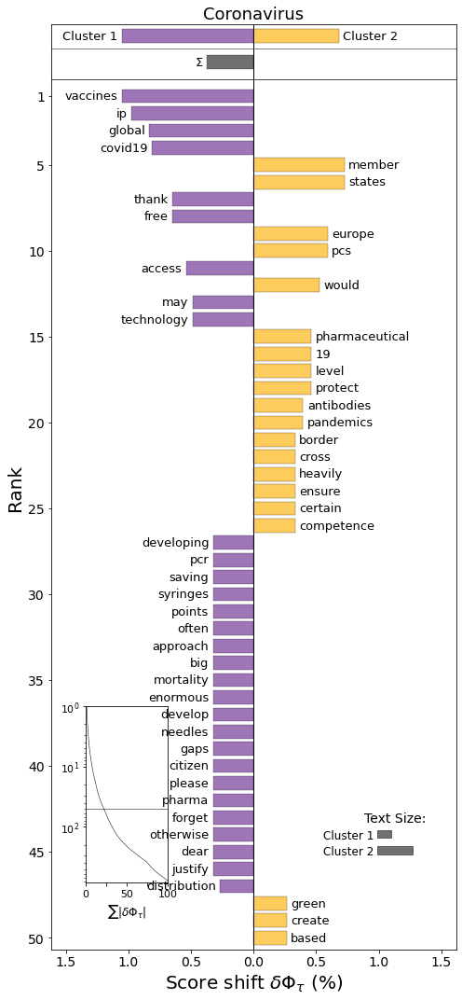

Plot saved to ../plots/CFE/CFE_Coronavirus_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 13/13...
Final polarisation is 0.17
Plot saved to ../plots/CFE/CFE_Coronavirus_TreeCentroid.png!


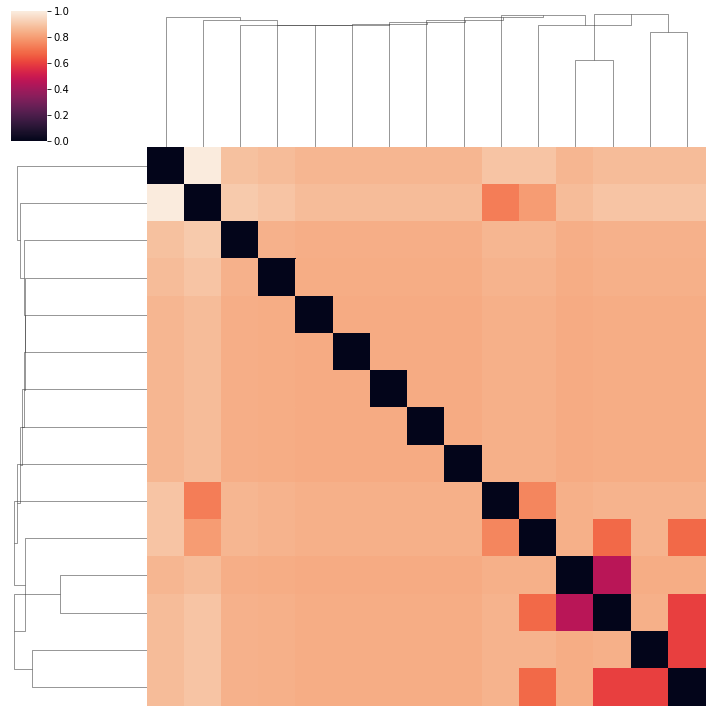

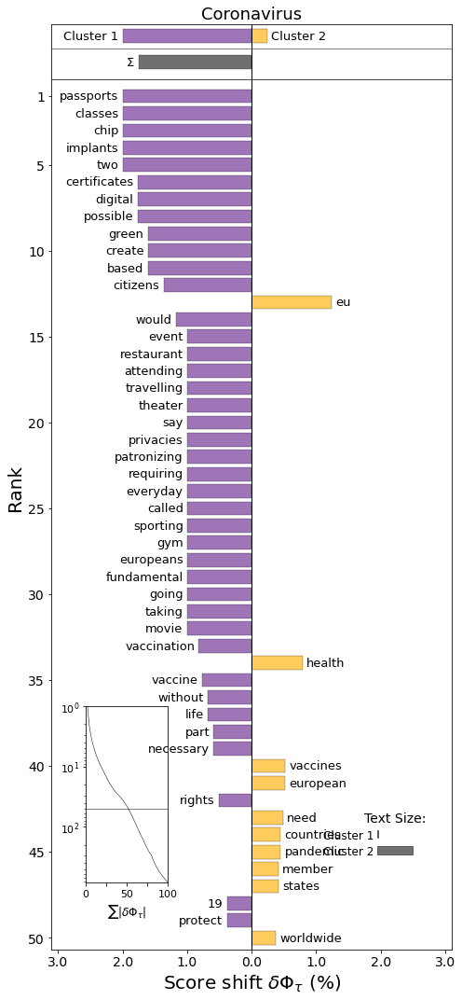

Plot saved to ../plots/CFE/CFE_Coronavirus_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 13/13...
Final polarisation is 0.37
Plot saved to ../plots/CFE/CFE_Coronavirus_TreePoldist.png!


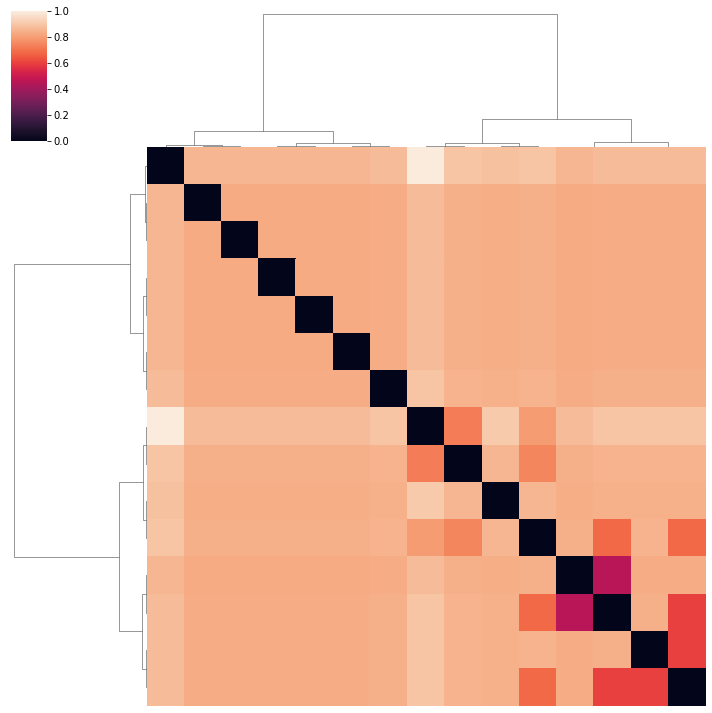

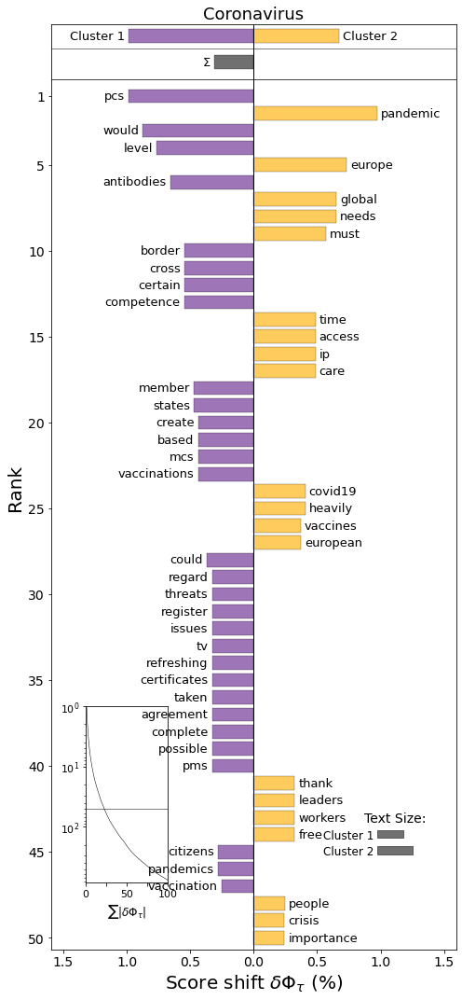

Plot saved to ../plots/CFE/CFE_Coronavirus_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Plot saved to ../plots/CFE/CFE_Coronavirus_PolarisationPoldist.png!


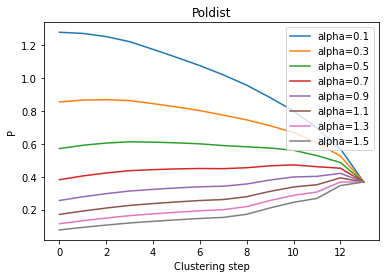

Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Plot saved to ../plots/CFE/CFE_Coronavirus_PolarisationCentroid.png!


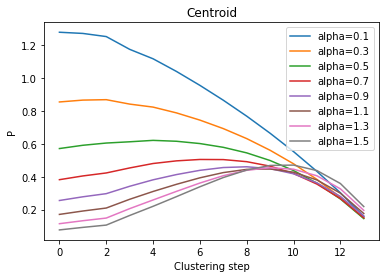

Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
Plot saved to ../plots/CFE/CFE_Coronavirus_PolarisationWard.png!


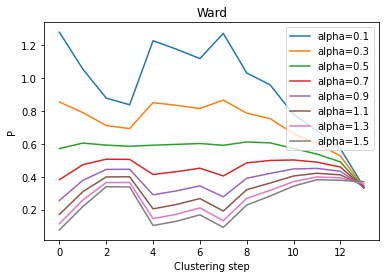

Iteration 13/13...
***** alpha=0.1 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=0.13 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=0.16 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=0.21 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=0.26 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=0.34 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=0.43 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=0.55 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=0.7 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=0.89 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=1.13 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=1.44 *****
Iteration 13/13...
Iteration 13/13...
Iteration 13/13...
***** alpha=1.83 *****


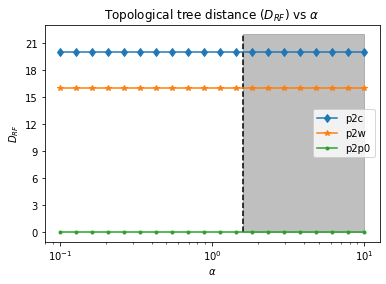

====== Healthcare ======
Total number of endorsers: 1162
Number of unique endorsers: 875
Number of proposals: 45
Plot saved to ../plots/CFE/CFE_Healthcare_Net.png!


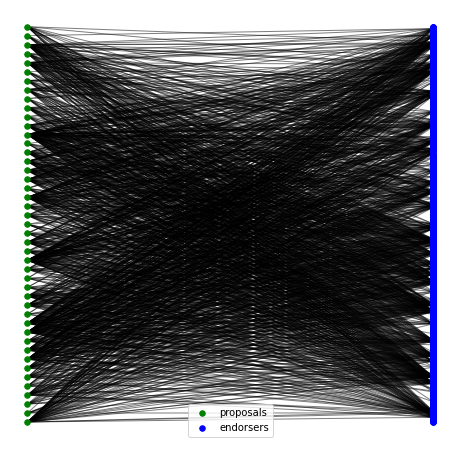

****** WARD ******
Iteration 43/43...
Final polarisation is 0.27
Plot saved to ../plots/CFE/CFE_Healthcare_TreeWard.png!


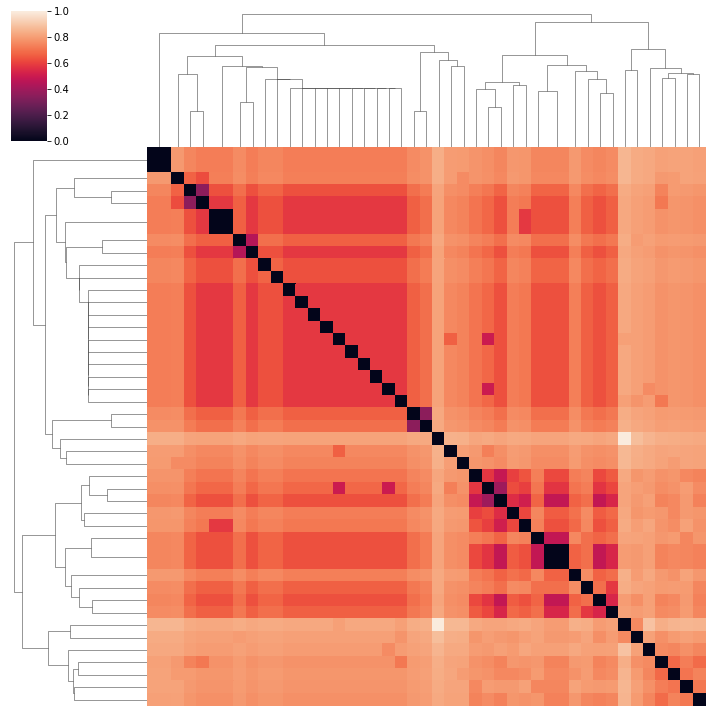

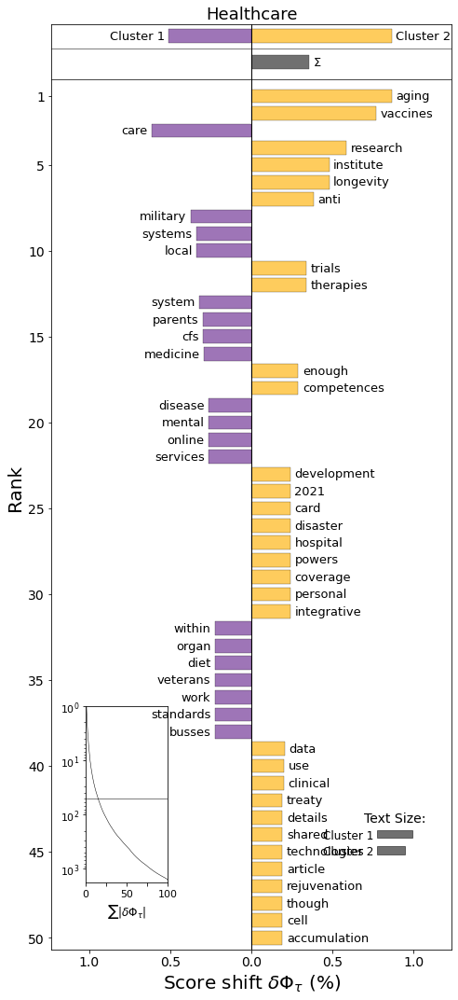

Plot saved to ../plots/CFE/CFE_Healthcare_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 43/43...
Final polarisation is 0.06
Plot saved to ../plots/CFE/CFE_Healthcare_TreeCentroid.png!


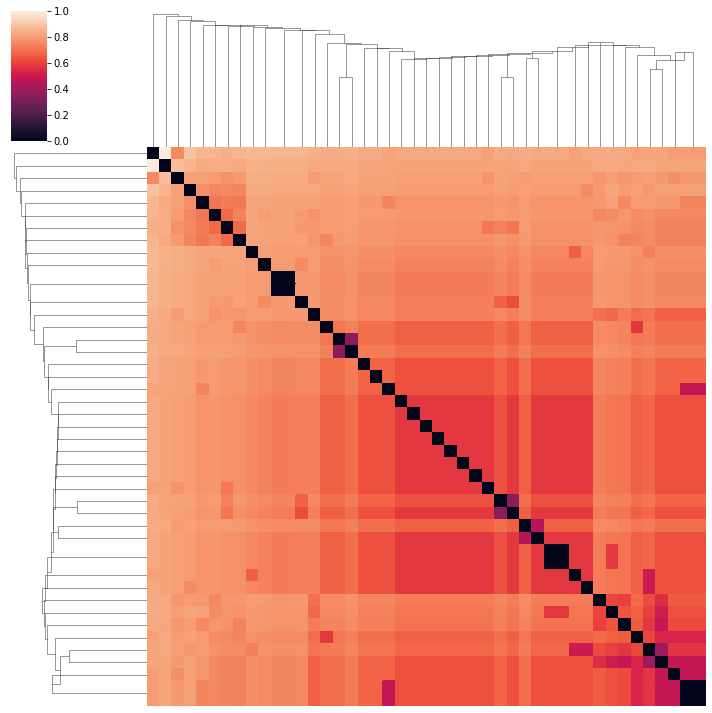

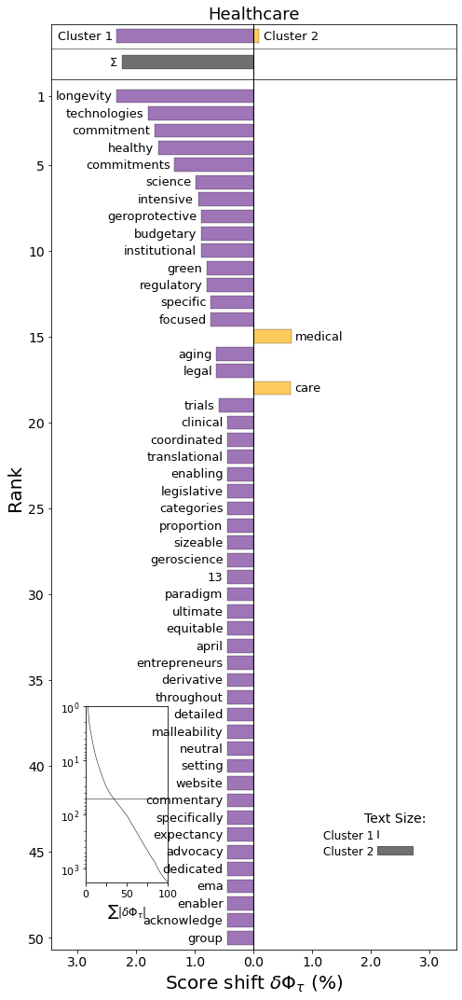

Plot saved to ../plots/CFE/CFE_Healthcare_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 43/43...
Final polarisation is 0.24
Plot saved to ../plots/CFE/CFE_Healthcare_TreePoldist.png!


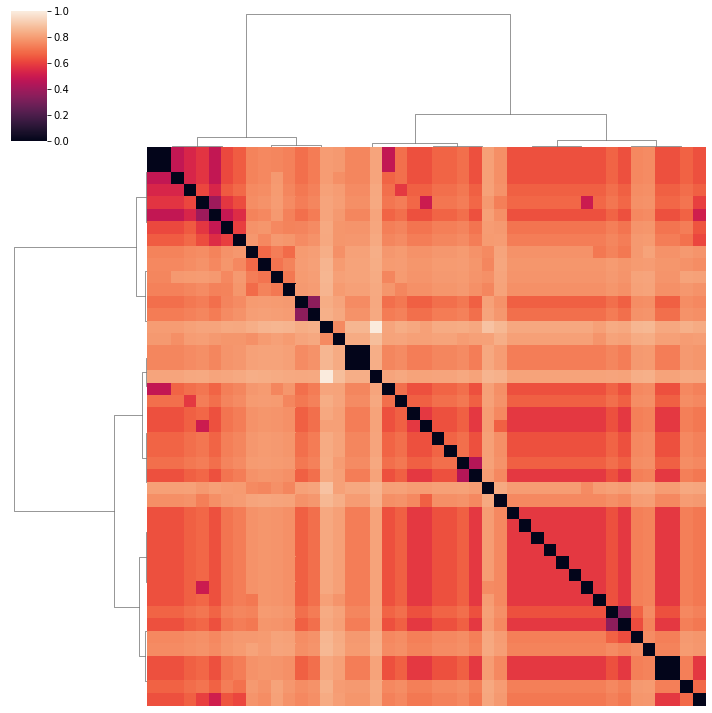

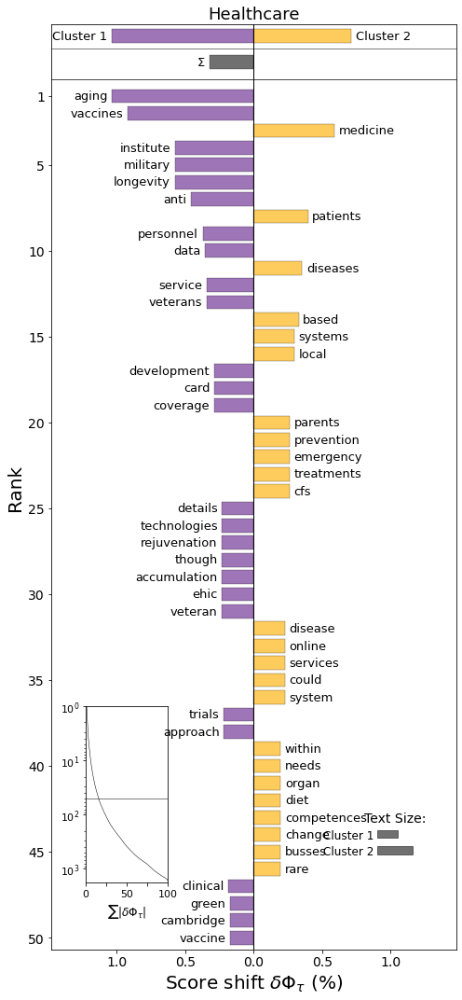

Plot saved to ../plots/CFE/CFE_Healthcare_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
Plot saved to ../plots/CFE/CFE_Healthcare_PolarisationPoldist.png!


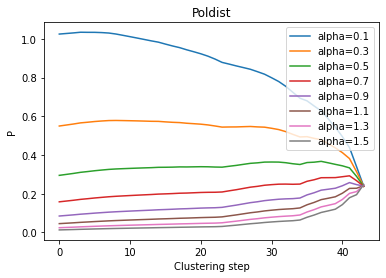

Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
Plot saved to ../plots/CFE/CFE_Healthcare_PolarisationCentroid.png!


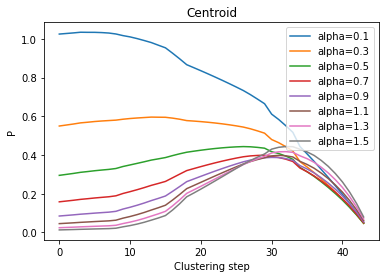

Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
Plot saved to ../plots/CFE/CFE_Healthcare_PolarisationWard.png!


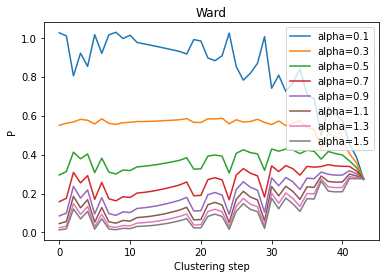

Iteration 43/43...
***** alpha=0.1 *****
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
***** alpha=0.13 *****
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
***** alpha=0.16 *****
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
***** alpha=0.21 *****
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
***** alpha=0.26 *****
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
***** alpha=0.34 *****
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
***** alpha=0.43 *****
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
***** alpha=0.55 *****
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
***** alpha=0.7 *****
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
***** alpha=0.89 *****
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
***** alpha=1.13 *****
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
***** alpha=1.44 *****
Iteration 43/43...
Iteration 43/43...
Iteration 43/43...
***** alpha=1.83 *****


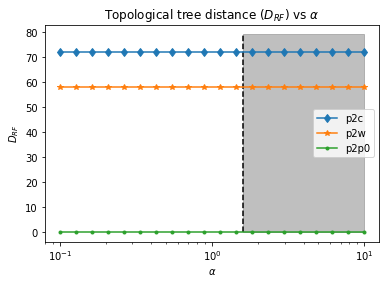

====== Disinformation ======
Total number of endorsers: 18
Number of unique endorsers: 18
Number of proposals: 5
Plot saved to ../plots/CFE/CFE_Disinformation_Net.png!


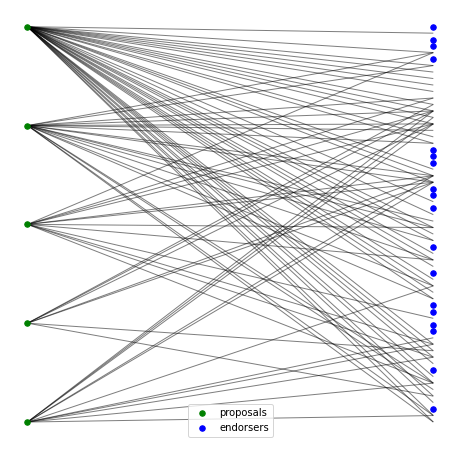

****** WARD ******
Iteration 3/3...
Final polarisation is 0.5
Plot saved to ../plots/CFE/CFE_Disinformation_TreeWard.png!


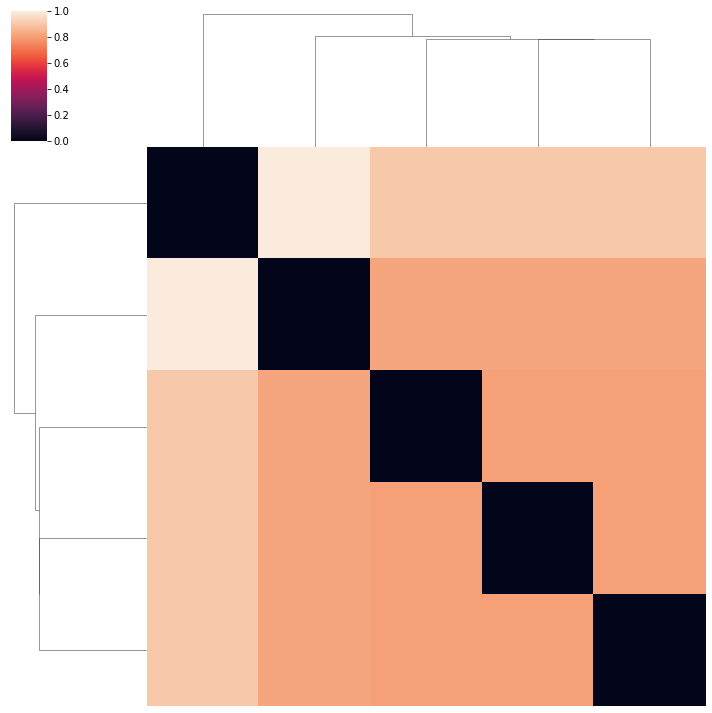

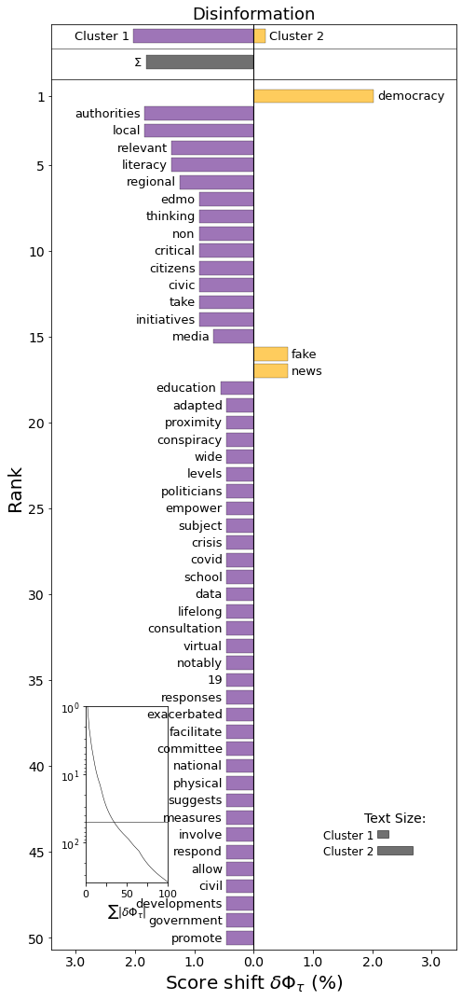

Plot saved to ../plots/CFE/CFE_Disinformation_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 3/3...
Final polarisation is 0.5
Plot saved to ../plots/CFE/CFE_Disinformation_TreeCentroid.png!


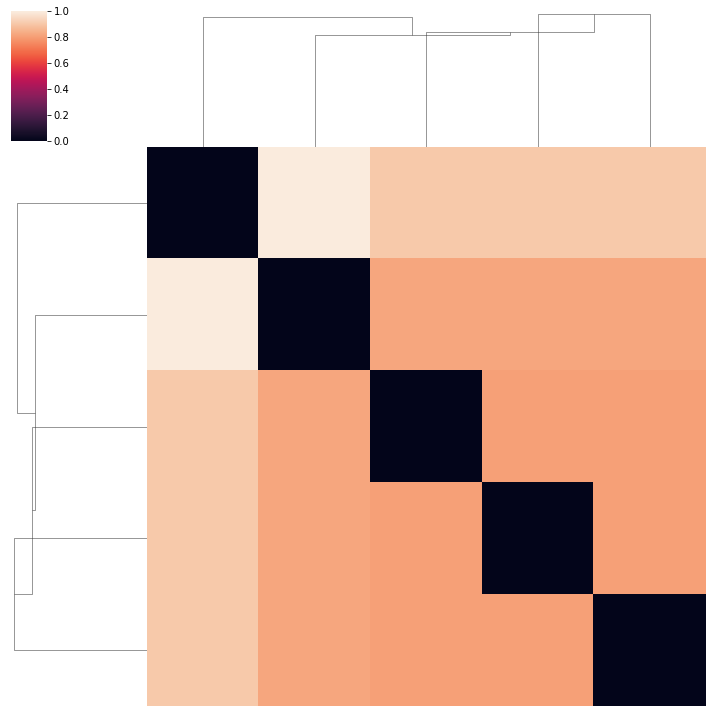

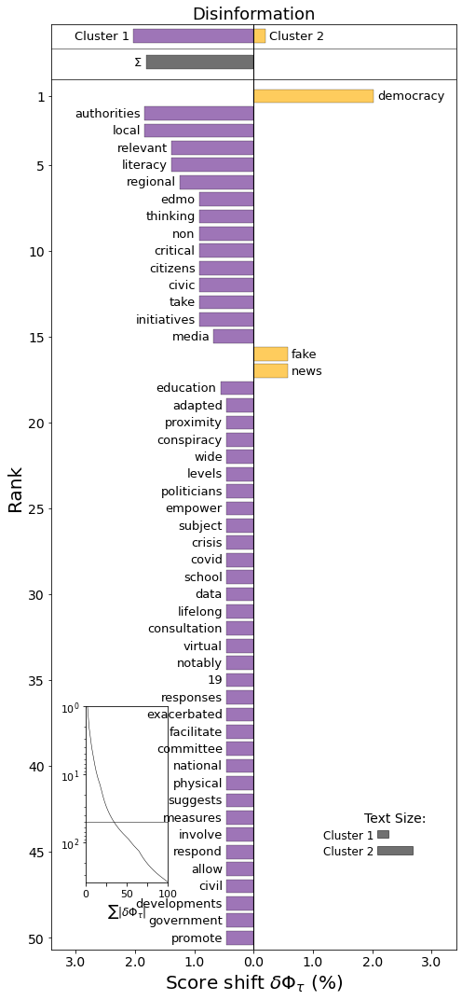

Plot saved to ../plots/CFE/CFE_Disinformation_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 3/3...
Final polarisation is 0.54
Plot saved to ../plots/CFE/CFE_Disinformation_TreePoldist.png!


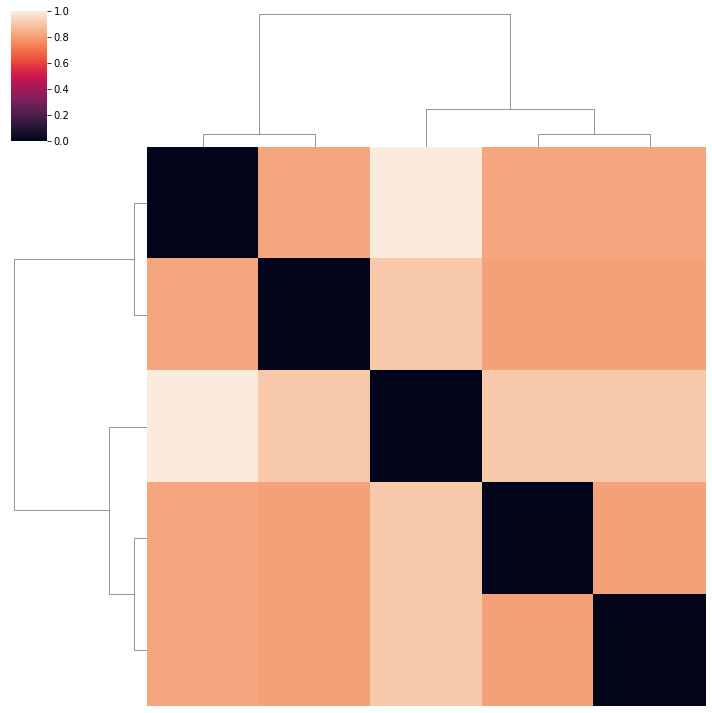

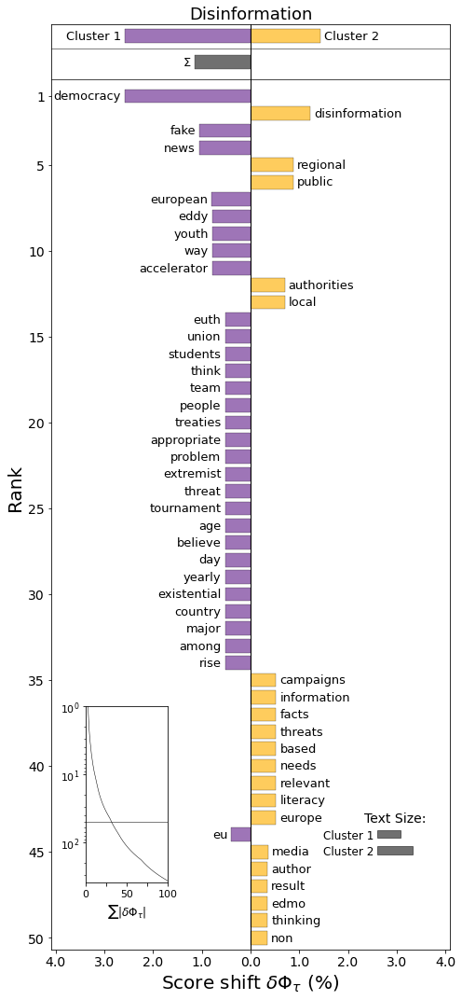

Plot saved to ../plots/CFE/CFE_Disinformation_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
Plot saved to ../plots/CFE/CFE_Disinformation_PolarisationPoldist.png!


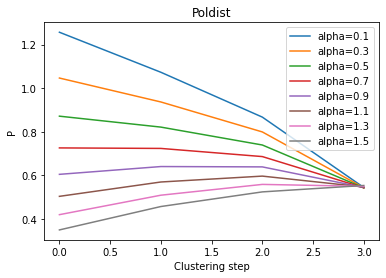

Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
Plot saved to ../plots/CFE/CFE_Disinformation_PolarisationCentroid.png!


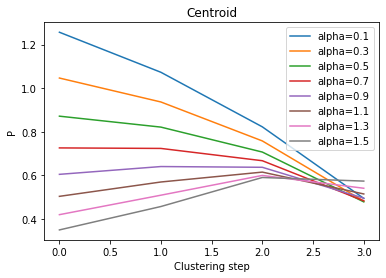

Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
Plot saved to ../plots/CFE/CFE_Disinformation_PolarisationWard.png!


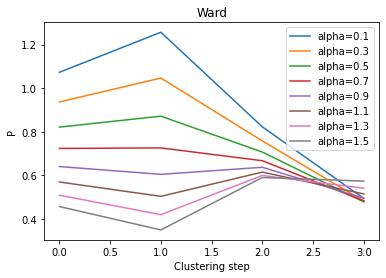

Iteration 3/3...
***** alpha=0.1 *****
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
***** alpha=0.13 *****
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
***** alpha=0.16 *****
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
***** alpha=0.21 *****
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
***** alpha=0.26 *****
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
***** alpha=0.34 *****
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
***** alpha=0.43 *****
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
***** alpha=0.55 *****
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
***** alpha=0.7 *****
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
***** alpha=0.89 *****
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
***** alpha=1.13 *****
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
***** alpha=1.44 *****
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
***** alpha=1.83 *****
Iteration 3/3...
Iteration 3/3...
Iteration 3/3...
***** alpha=2.34 *****


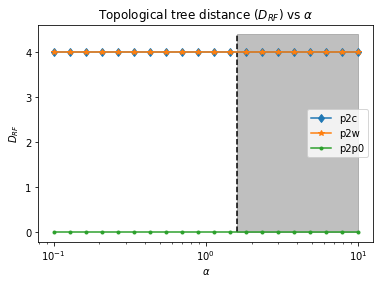

====== Have your say on European Union policies ======
Total number of endorsers: 3327
Number of unique endorsers: 1817
Number of proposals: 135
Plot saved to ../plots/CFE/CFE_Have_your_say_on_European_Union_policies_Net.png!


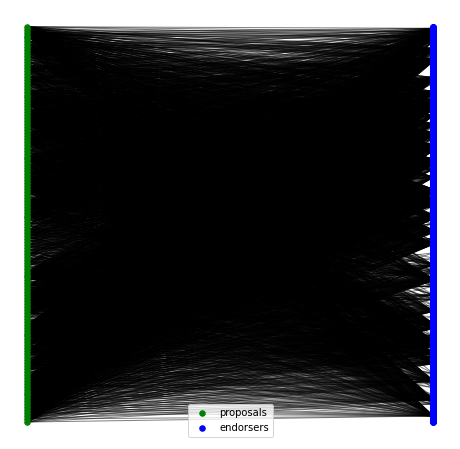

****** WARD ******
Iteration 133/133...
Final polarisation is 0.22
Plot saved to ../plots/CFE/CFE_Have_your_say_on_European_Union_policies_TreeWard.png!


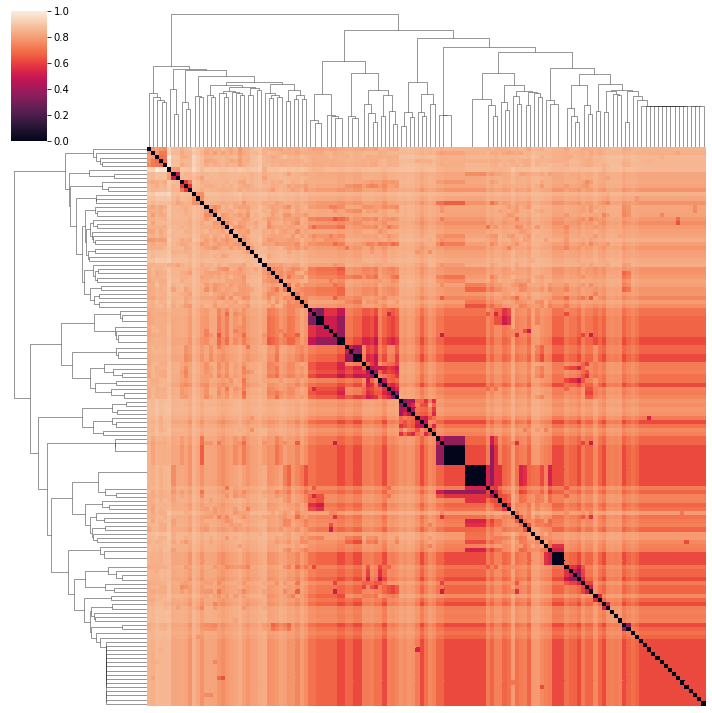

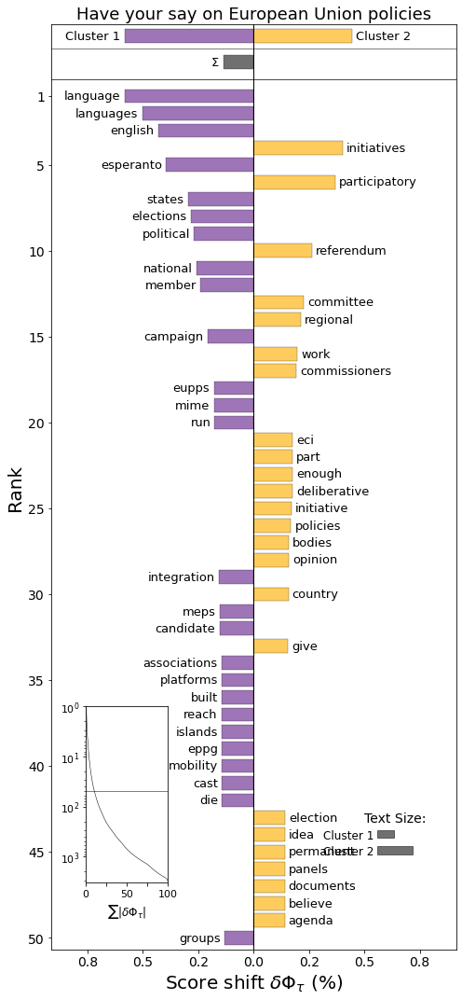

Plot saved to ../plots/CFE/CFE_Have_your_say_on_European_Union_policies_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 133/133...
Final polarisation is 0.02
Plot saved to ../plots/CFE/CFE_Have_your_say_on_European_Union_policies_TreeCentroid.png!


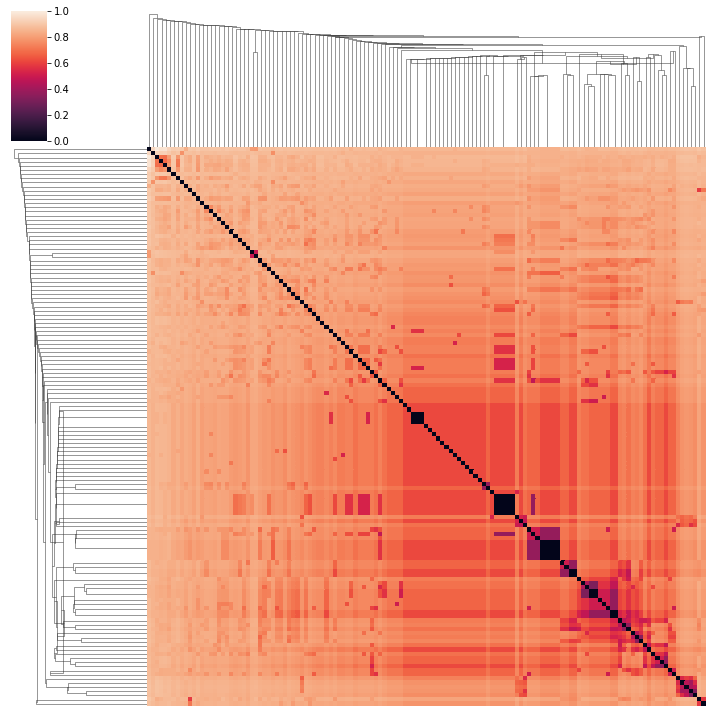

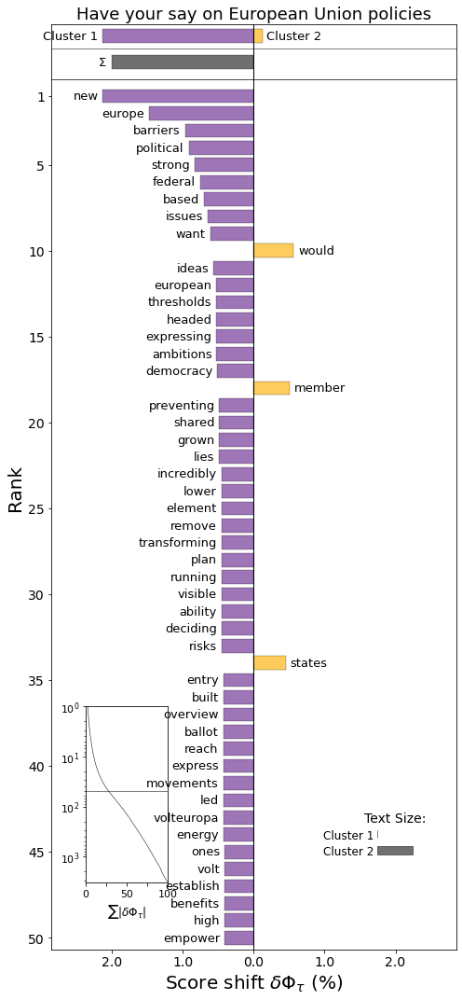

Plot saved to ../plots/CFE/CFE_Have_your_say_on_European_Union_policies_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 133/133...
Final polarisation is 0.18
Plot saved to ../plots/CFE/CFE_Have_your_say_on_European_Union_policies_TreePoldist.png!


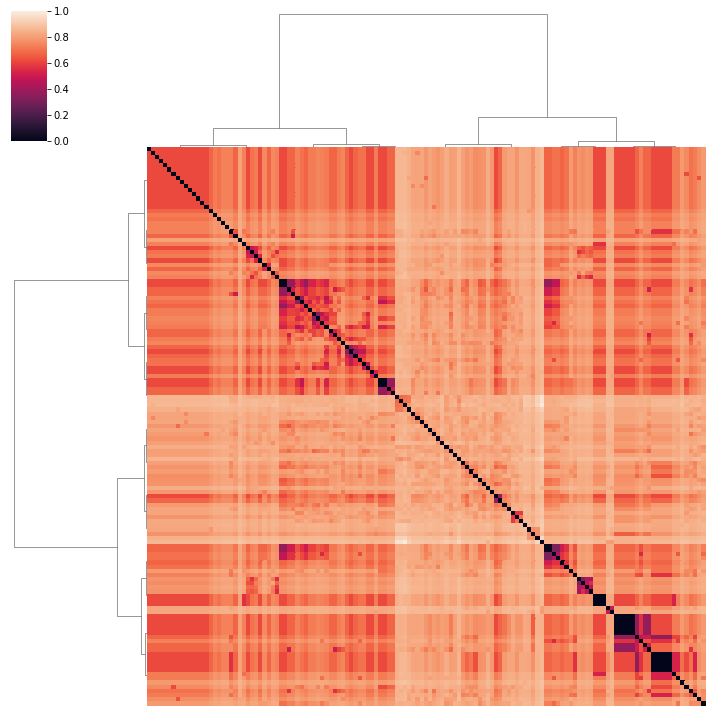

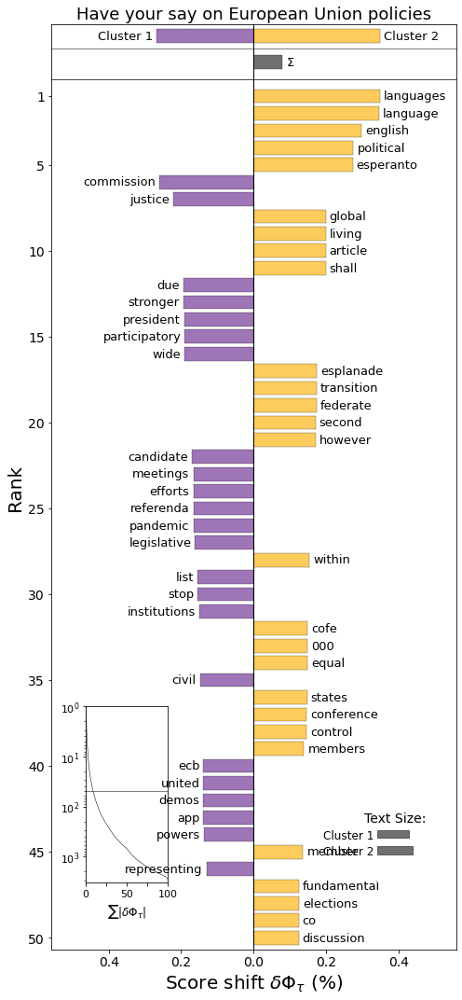

Plot saved to ../plots/CFE/CFE_Have_your_say_on_European_Union_policies_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
Plot saved to ../plots/CFE/CFE_Have_your_say_on_European_Union_policies_PolarisationPoldist.png!


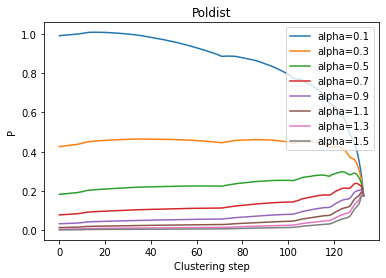

Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
Plot saved to ../plots/CFE/CFE_Have_your_say_on_European_Union_policies_PolarisationCentroid.png!


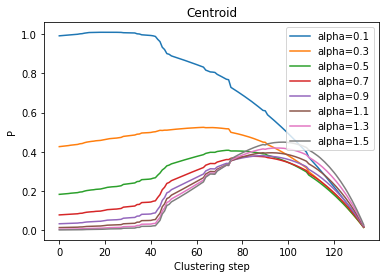

Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
Plot saved to ../plots/CFE/CFE_Have_your_say_on_European_Union_policies_PolarisationWard.png!


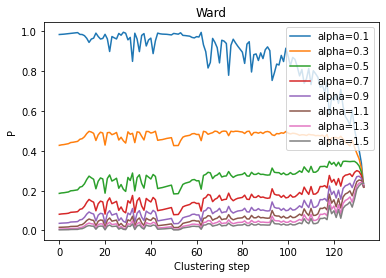

Iteration 133/133...
***** alpha=0.1 *****
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
***** alpha=0.13 *****
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
***** alpha=0.16 *****
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
***** alpha=0.21 *****
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
***** alpha=0.26 *****
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
***** alpha=0.34 *****
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
***** alpha=0.43 *****
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
***** alpha=0.55 *****
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
***** alpha=0.7 *****
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
***** alpha=0.89 *****
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
***** alpha=1.13 *****
Iteration 133/133...
Iteration 133/133...
Iteration 133/133...
***** alpha=1.44 *****
Iteration 13

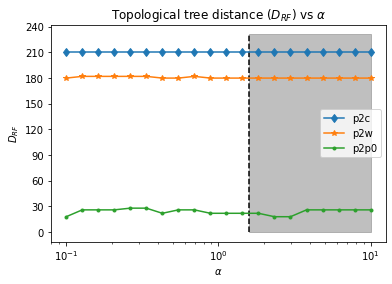

====== Protecting our democracies ======
Total number of endorsers: 1006
Number of unique endorsers: 579
Number of proposals: 101
Plot saved to ../plots/CFE/CFE_Protecting_our_democracies_Net.png!


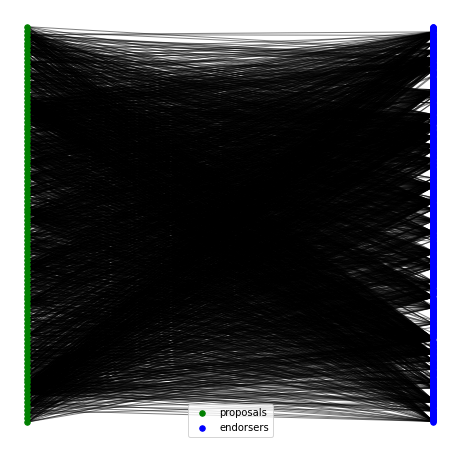

****** WARD ******
Iteration 99/99...
Final polarisation is 0.13
Plot saved to ../plots/CFE/CFE_Protecting_our_democracies_TreeWard.png!


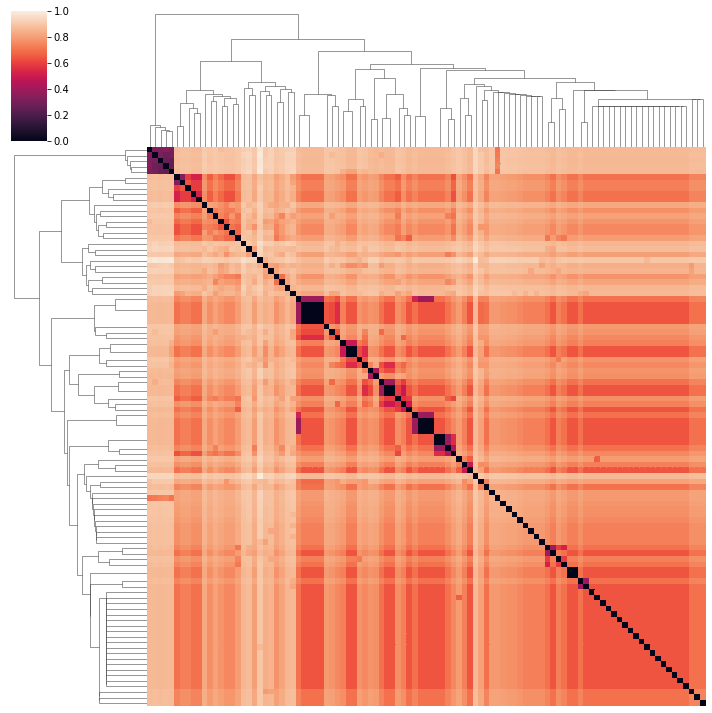

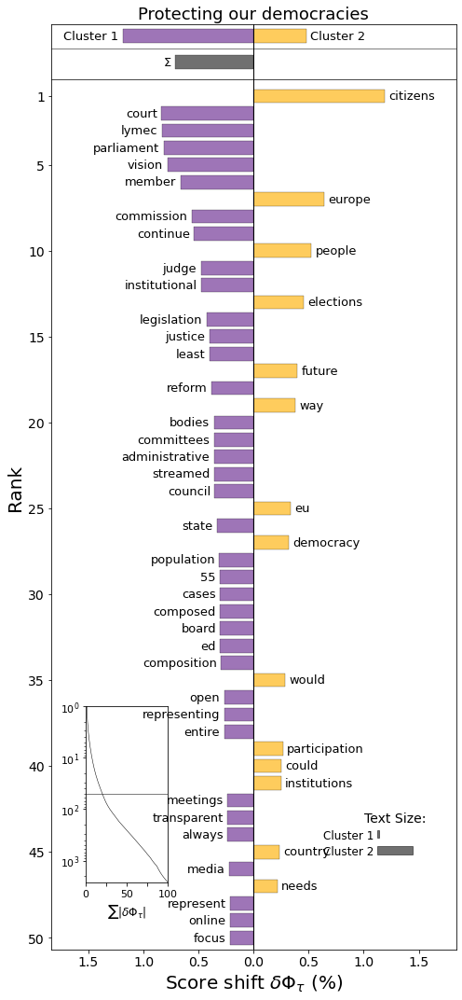

Plot saved to ../plots/CFE/CFE_Protecting_our_democracies_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 99/99...
Final polarisation is 0.03
Plot saved to ../plots/CFE/CFE_Protecting_our_democracies_TreeCentroid.png!


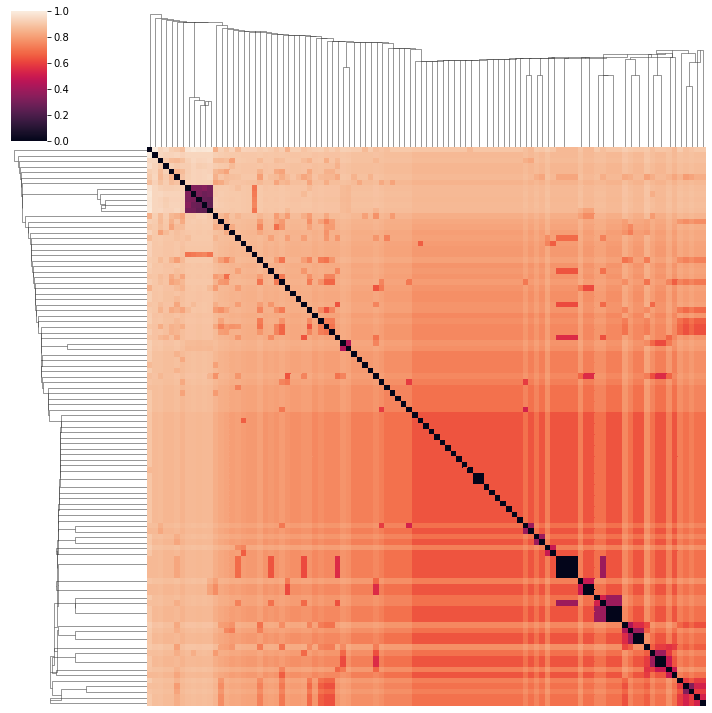

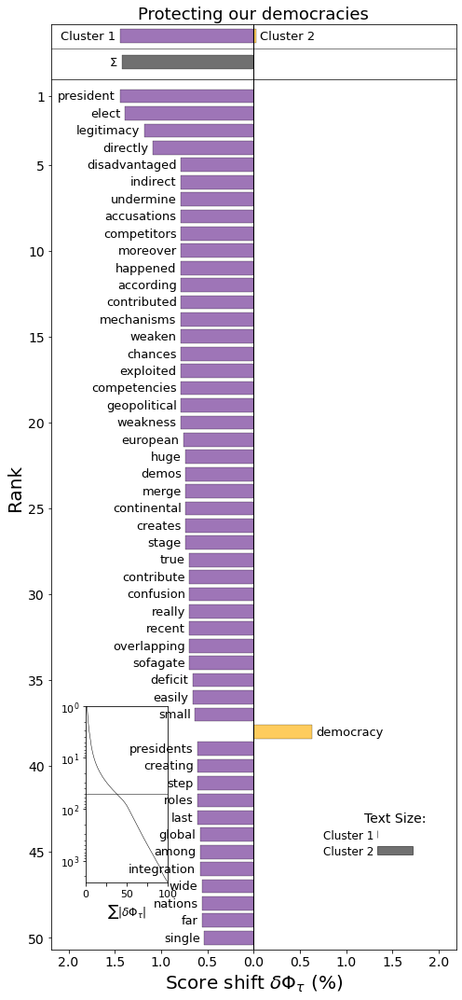

Plot saved to ../plots/CFE/CFE_Protecting_our_democracies_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 99/99...
Final polarisation is 0.17
Plot saved to ../plots/CFE/CFE_Protecting_our_democracies_TreePoldist.png!


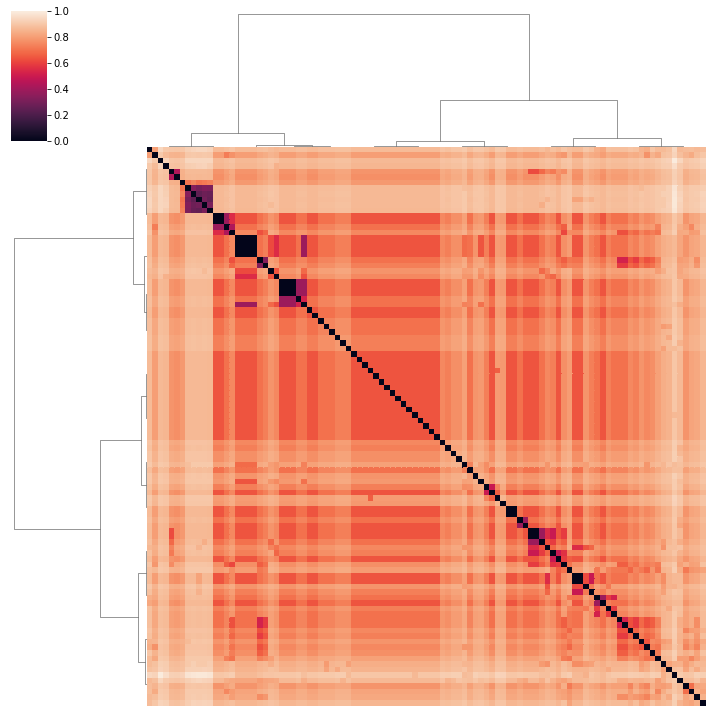

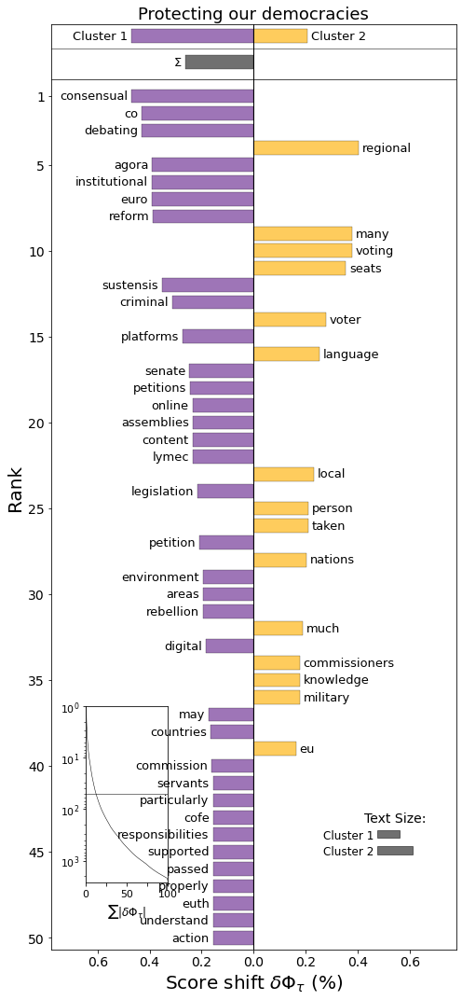

Plot saved to ../plots/CFE/CFE_Protecting_our_democracies_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
Plot saved to ../plots/CFE/CFE_Protecting_our_democracies_PolarisationPoldist.png!


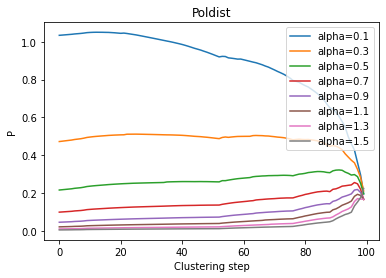

Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
Plot saved to ../plots/CFE/CFE_Protecting_our_democracies_PolarisationCentroid.png!


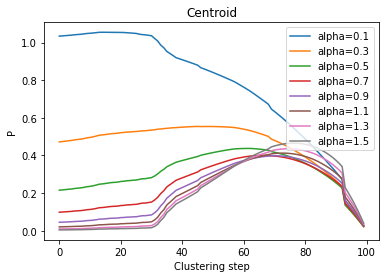

Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
Plot saved to ../plots/CFE/CFE_Protecting_our_democracies_PolarisationWard.png!


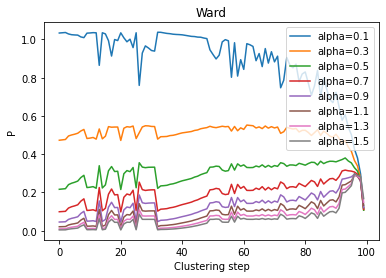

Iteration 99/99...
***** alpha=0.1 *****
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
***** alpha=0.13 *****
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
***** alpha=0.16 *****
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
***** alpha=0.21 *****
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
***** alpha=0.26 *****
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
***** alpha=0.34 *****
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
***** alpha=0.43 *****
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
***** alpha=0.55 *****
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
***** alpha=0.7 *****
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
***** alpha=0.89 *****
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
***** alpha=1.13 *****
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
***** alpha=1.44 *****
Iteration 99/99...
Iteration 99/99...
Iteration 99/99...
***** alpha=1.83 *****


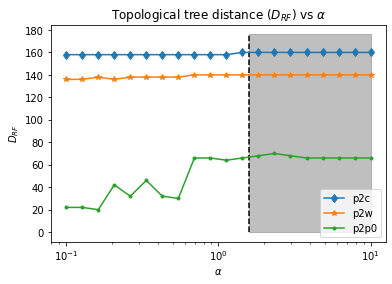

====== Media ======
Total number of endorsers: 59
Number of unique endorsers: 50
Number of proposals: 13
Plot saved to ../plots/CFE/CFE_Media_Net.png!


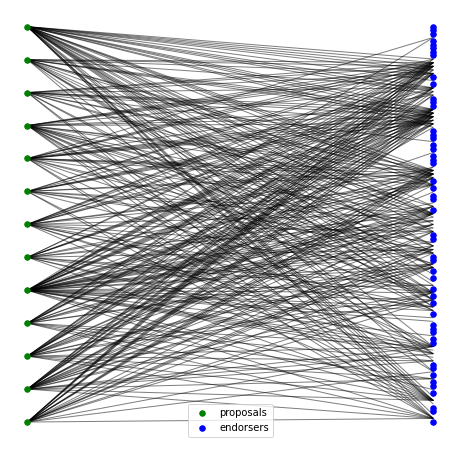

****** WARD ******
Iteration 11/11...
Final polarisation is 0.38
Plot saved to ../plots/CFE/CFE_Media_TreeWard.png!


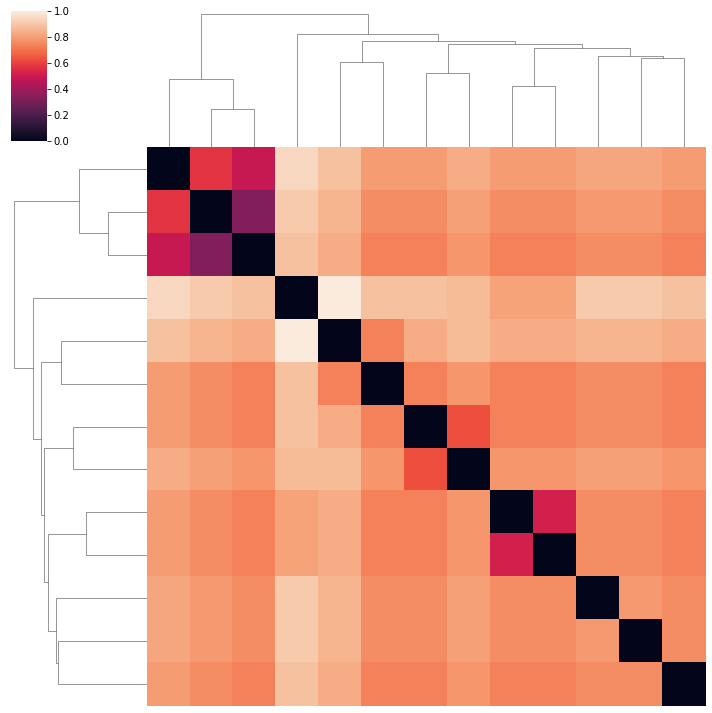

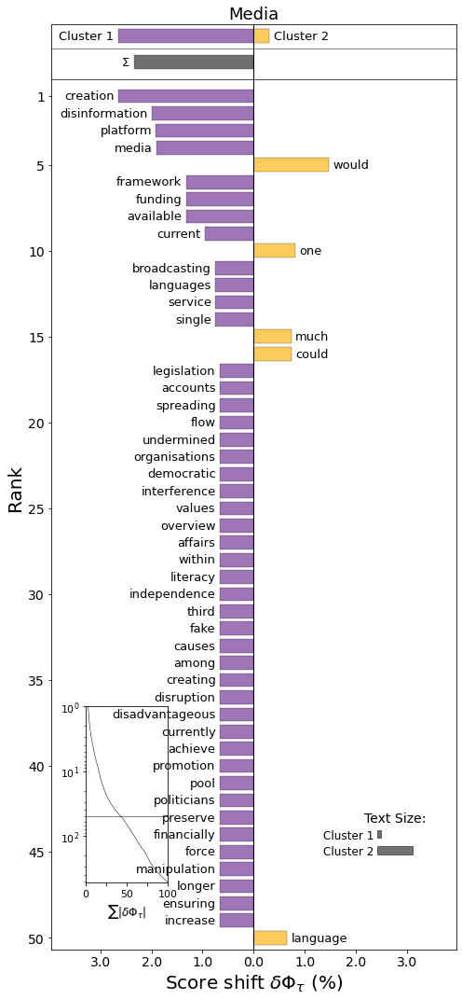

Plot saved to ../plots/CFE/CFE_Media_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 11/11...
Final polarisation is 0.21
Plot saved to ../plots/CFE/CFE_Media_TreeCentroid.png!


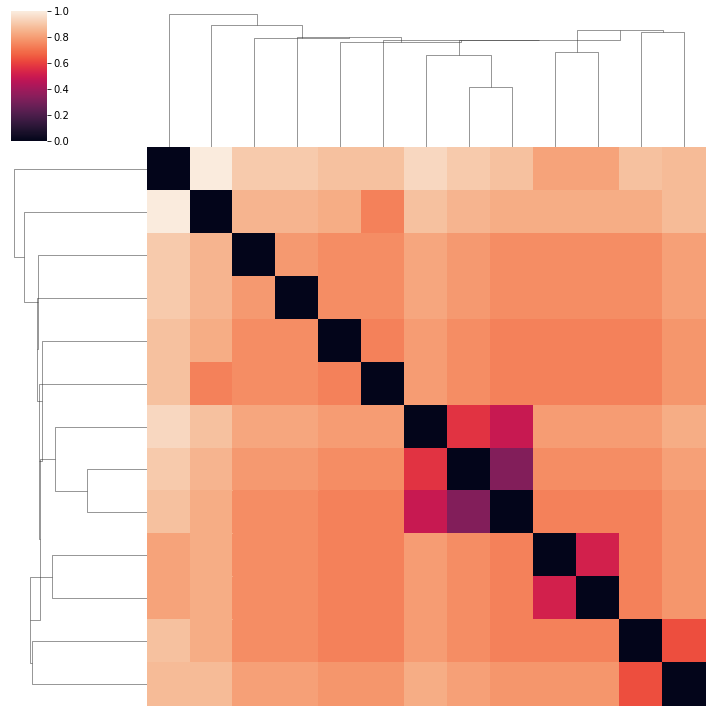

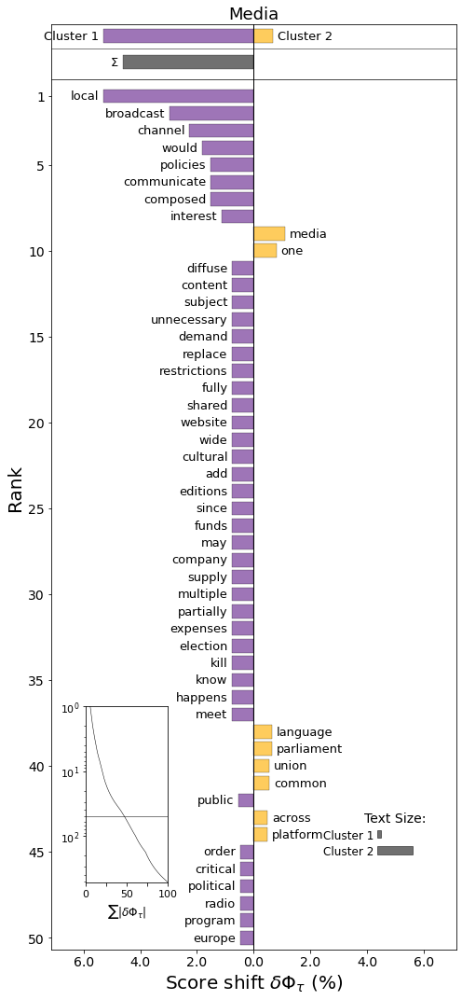

Plot saved to ../plots/CFE/CFE_Media_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 11/11...
Final polarisation is 0.37
Plot saved to ../plots/CFE/CFE_Media_TreePoldist.png!


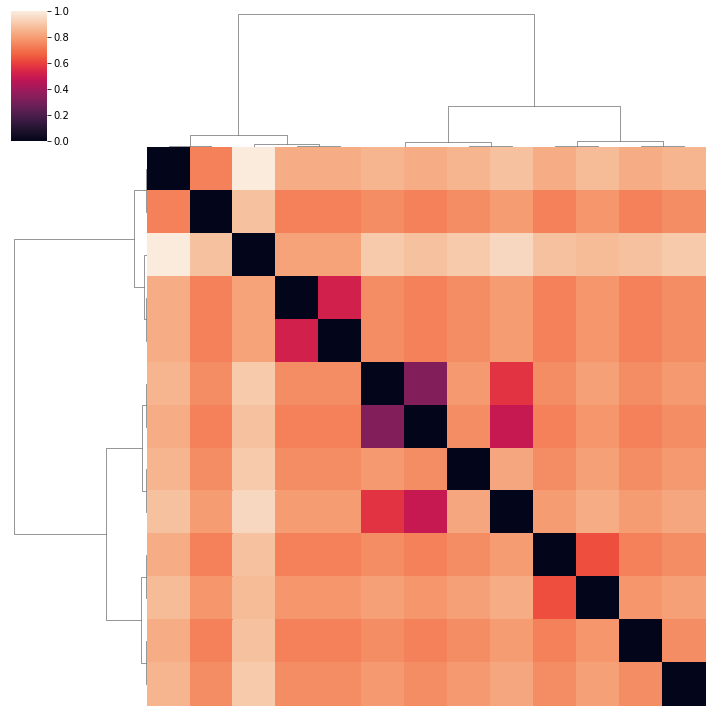

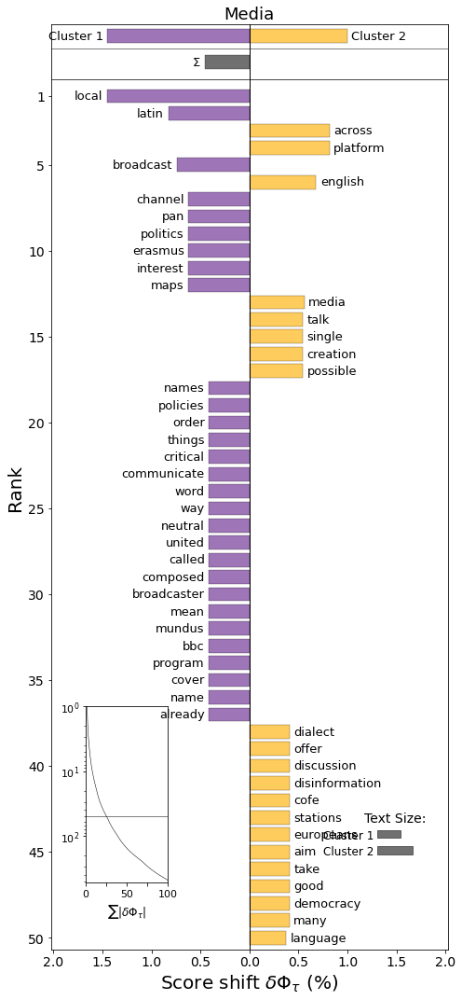

Plot saved to ../plots/CFE/CFE_Media_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
Plot saved to ../plots/CFE/CFE_Media_PolarisationPoldist.png!


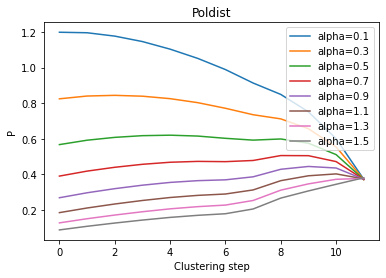

Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
Plot saved to ../plots/CFE/CFE_Media_PolarisationCentroid.png!


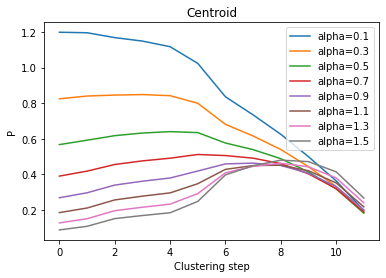

Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
Plot saved to ../plots/CFE/CFE_Media_PolarisationWard.png!


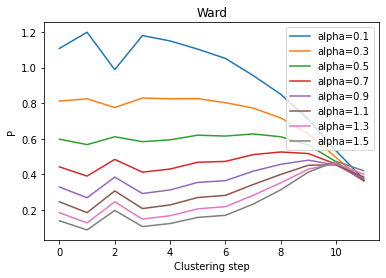

Iteration 11/11...
***** alpha=0.1 *****
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
***** alpha=0.13 *****
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
***** alpha=0.16 *****
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
***** alpha=0.21 *****
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
***** alpha=0.26 *****
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
***** alpha=0.34 *****
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
***** alpha=0.43 *****
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
***** alpha=0.55 *****
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
***** alpha=0.7 *****
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
***** alpha=0.89 *****
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
***** alpha=1.13 *****
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
***** alpha=1.44 *****
Iteration 11/11...
Iteration 11/11...
Iteration 11/11...
***** alpha=1.83 *****


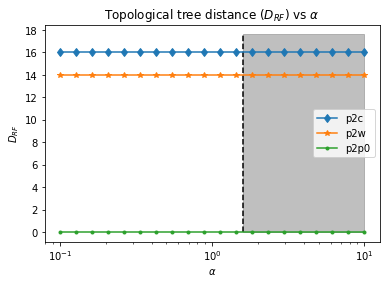

====== Boosting jobs, growth and investment ======
Total number of endorsers: 685
Number of unique endorsers: 507
Number of proposals: 63
Plot saved to ../plots/CFE/CFE_Boosting_jobs,_growth_and_investment_Net.png!


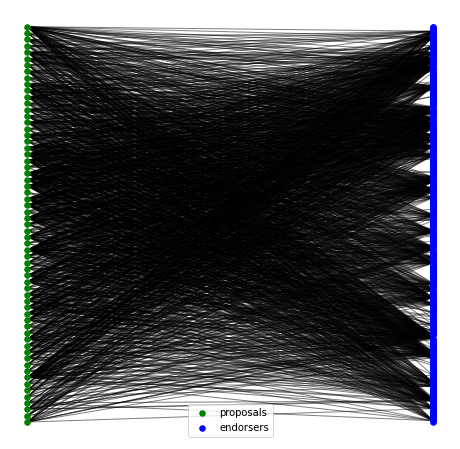

****** WARD ******
Iteration 61/61...
Final polarisation is 0.29
Plot saved to ../plots/CFE/CFE_Boosting_jobs,_growth_and_investment_TreeWard.png!


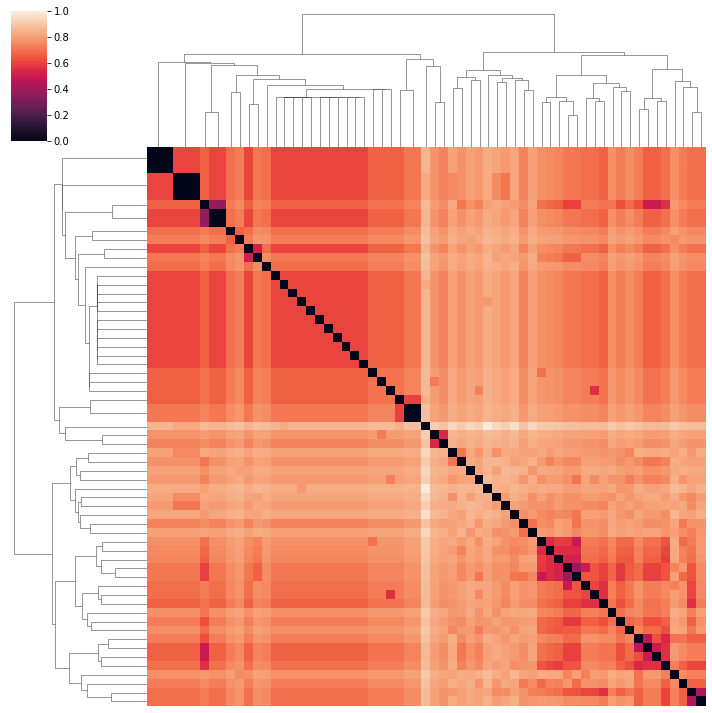

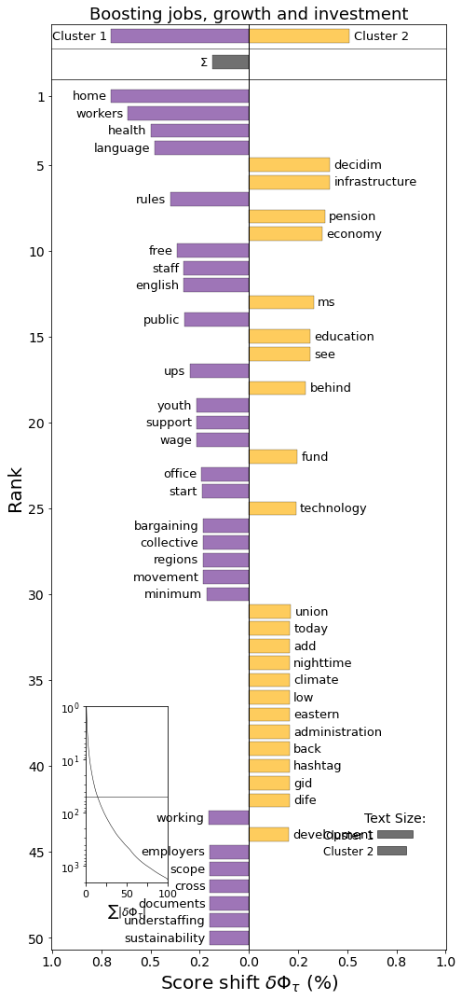

Plot saved to ../plots/CFE/CFE_Boosting_jobs,_growth_and_investment_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 61/61...
Final polarisation is 0.04
Plot saved to ../plots/CFE/CFE_Boosting_jobs,_growth_and_investment_TreeCentroid.png!


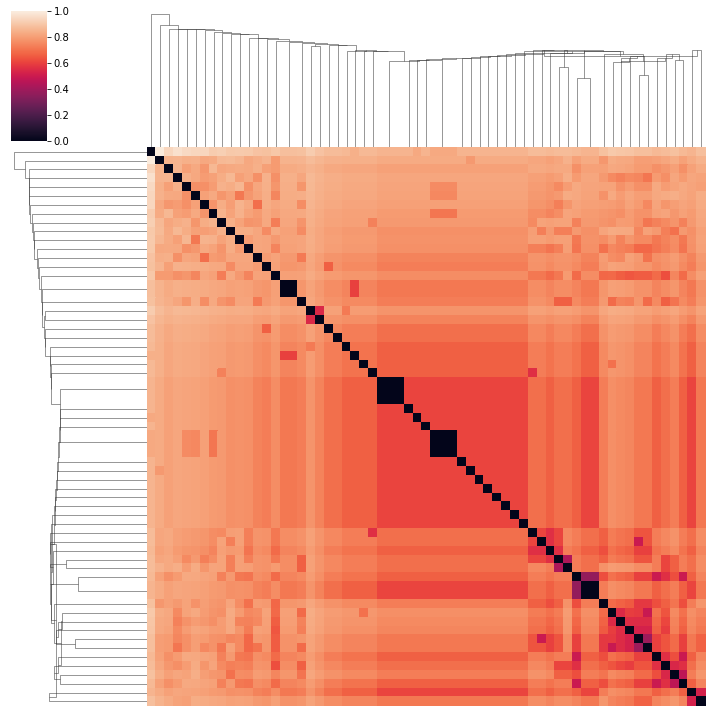

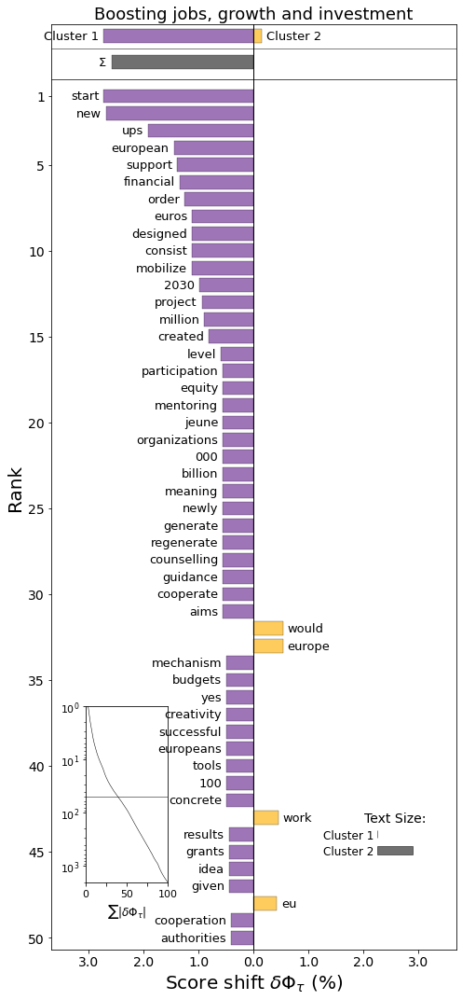

Plot saved to ../plots/CFE/CFE_Boosting_jobs,_growth_and_investment_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 61/61...
Final polarisation is 0.26
Plot saved to ../plots/CFE/CFE_Boosting_jobs,_growth_and_investment_TreePoldist.png!


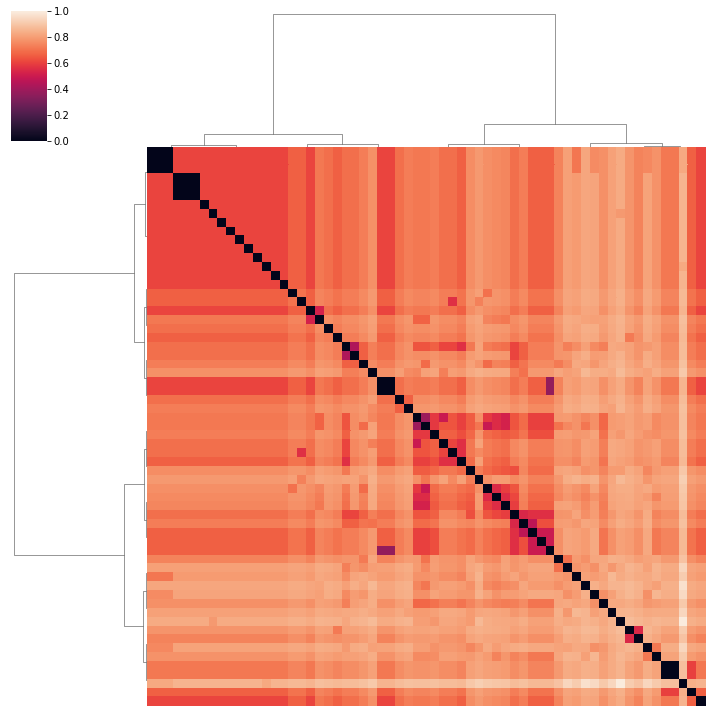

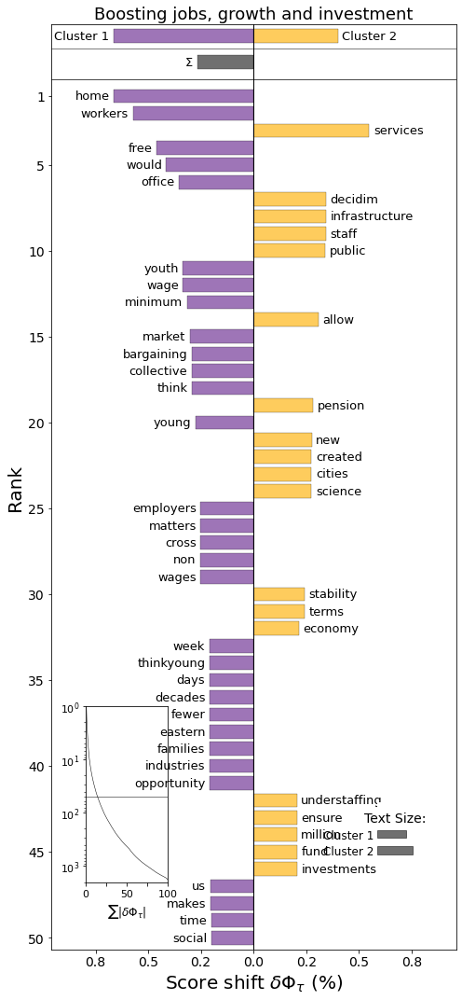

Plot saved to ../plots/CFE/CFE_Boosting_jobs,_growth_and_investment_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
Plot saved to ../plots/CFE/CFE_Boosting_jobs,_growth_and_investment_PolarisationPoldist.png!


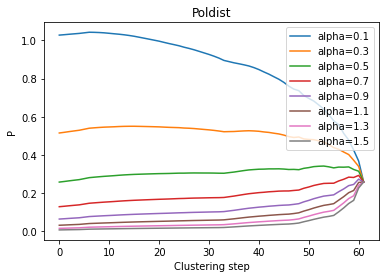

Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
Plot saved to ../plots/CFE/CFE_Boosting_jobs,_growth_and_investment_PolarisationCentroid.png!


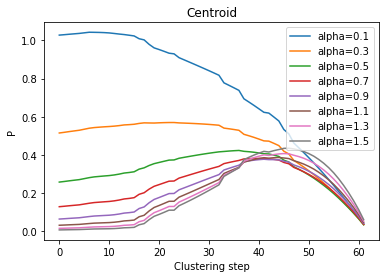

Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
Plot saved to ../plots/CFE/CFE_Boosting_jobs,_growth_and_investment_PolarisationWard.png!


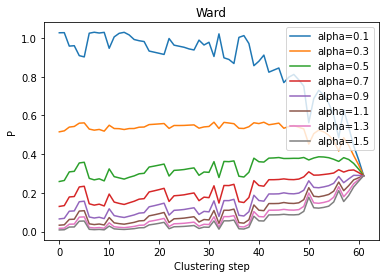

Iteration 61/61...
***** alpha=0.1 *****
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
***** alpha=0.13 *****
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
***** alpha=0.16 *****
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
***** alpha=0.21 *****
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
***** alpha=0.26 *****
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
***** alpha=0.34 *****
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
***** alpha=0.43 *****
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
***** alpha=0.55 *****
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
***** alpha=0.7 *****
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
***** alpha=0.89 *****
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
***** alpha=1.13 *****
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
***** alpha=1.44 *****
Iteration 61/61...
Iteration 61/61...
Iteration 61/61...
***** alpha=1.83 *****


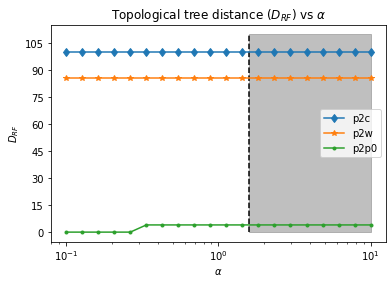

====== A more inclusive and fairer economy ======
Total number of endorsers: 892
Number of unique endorsers: 513
Number of proposals: 104
Plot saved to ../plots/CFE/CFE_A_more_inclusive_and_fairer_economy_Net.png!


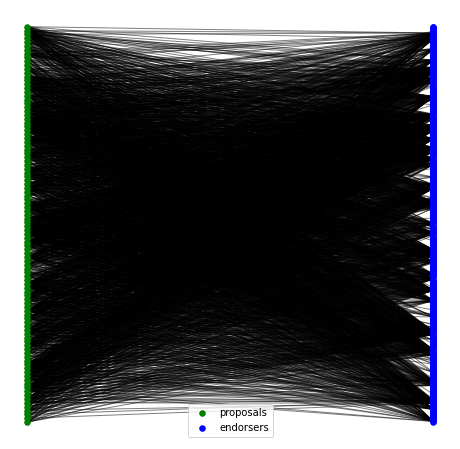

****** WARD ******
Iteration 102/102...
Final polarisation is 0.25
Plot saved to ../plots/CFE/CFE_A_more_inclusive_and_fairer_economy_TreeWard.png!


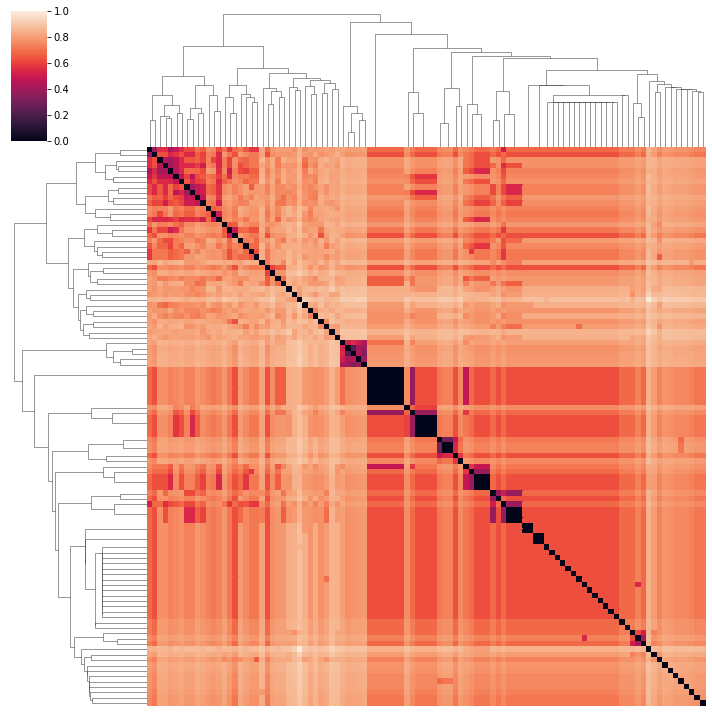

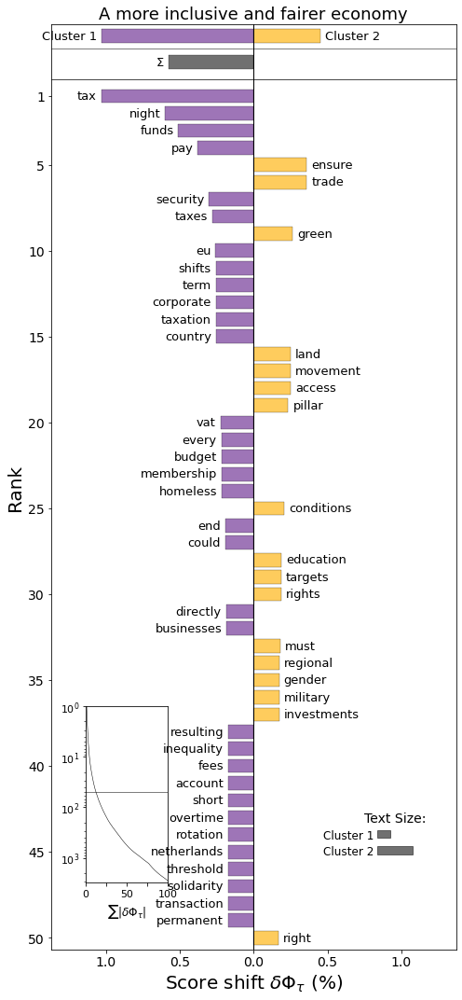

Plot saved to ../plots/CFE/CFE_A_more_inclusive_and_fairer_economy_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 102/102...
Final polarisation is 0.03
Plot saved to ../plots/CFE/CFE_A_more_inclusive_and_fairer_economy_TreeCentroid.png!


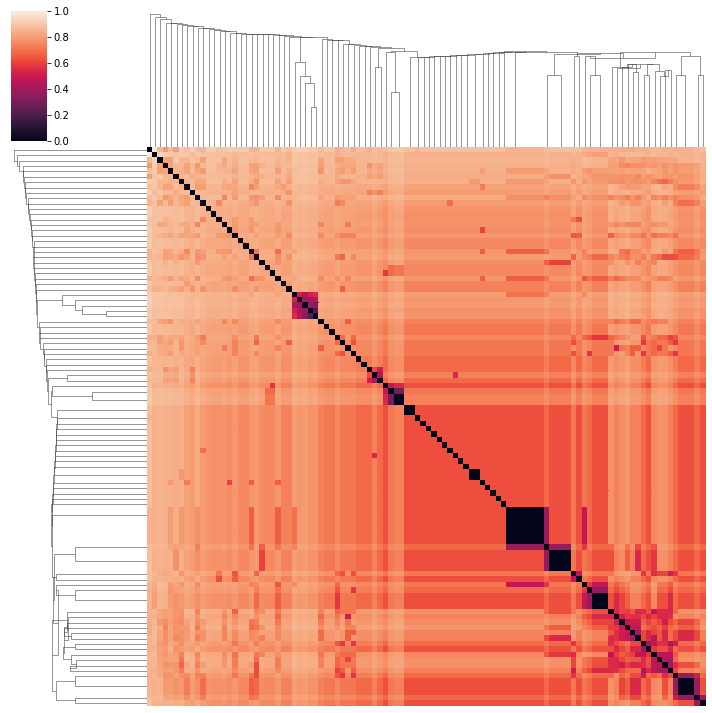

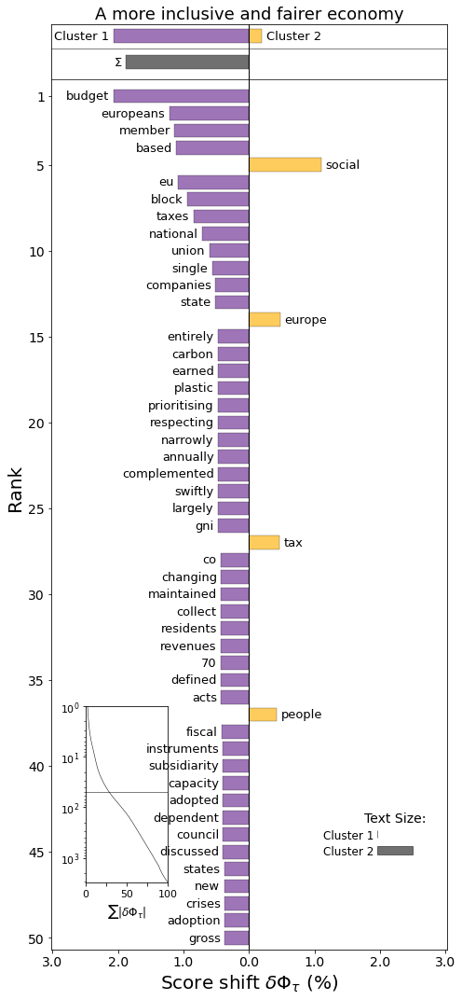

Plot saved to ../plots/CFE/CFE_A_more_inclusive_and_fairer_economy_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 102/102...
Final polarisation is 0.17
Plot saved to ../plots/CFE/CFE_A_more_inclusive_and_fairer_economy_TreePoldist.png!


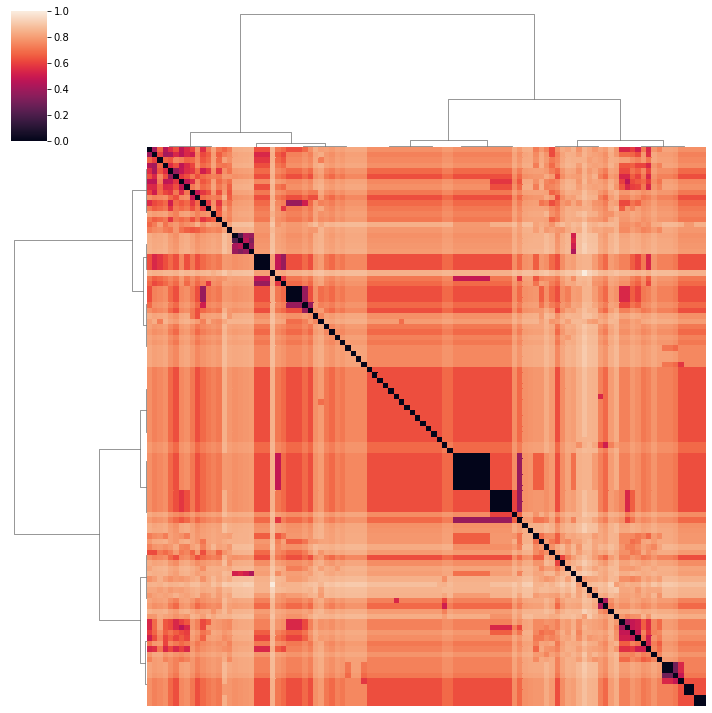

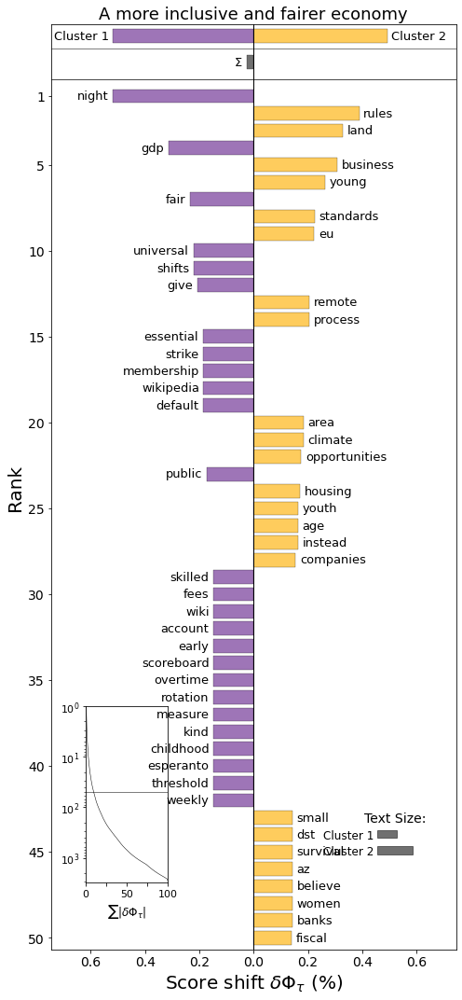

Plot saved to ../plots/CFE/CFE_A_more_inclusive_and_fairer_economy_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
Plot saved to ../plots/CFE/CFE_A_more_inclusive_and_fairer_economy_PolarisationPoldist.png!


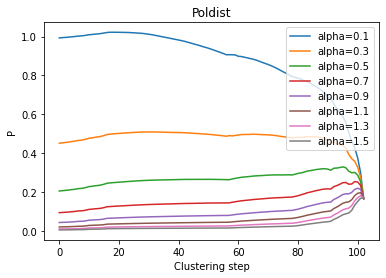

Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
Plot saved to ../plots/CFE/CFE_A_more_inclusive_and_fairer_economy_PolarisationCentroid.png!


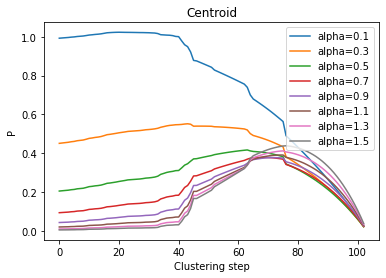

Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
Plot saved to ../plots/CFE/CFE_A_more_inclusive_and_fairer_economy_PolarisationWard.png!


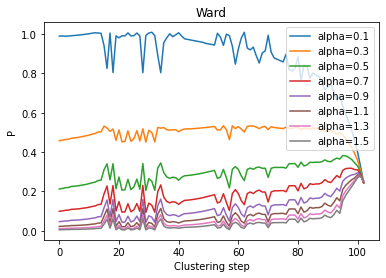

Iteration 102/102...
***** alpha=0.1 *****
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
***** alpha=0.13 *****
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
***** alpha=0.16 *****
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
***** alpha=0.21 *****
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
***** alpha=0.26 *****
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
***** alpha=0.34 *****
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
***** alpha=0.43 *****
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
***** alpha=0.55 *****
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
***** alpha=0.7 *****
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
***** alpha=0.89 *****
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
***** alpha=1.13 *****
Iteration 102/102...
Iteration 102/102...
Iteration 102/102...
***** alpha=1.44 *****
Iteration 10

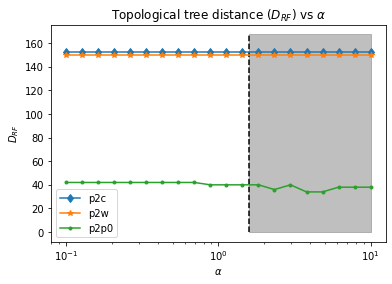

====== Coronavirus recovery ======
Total number of endorsers: 141
Number of unique endorsers: 128
Number of proposals: 9
Plot saved to ../plots/CFE/CFE_Coronavirus_recovery_Net.png!


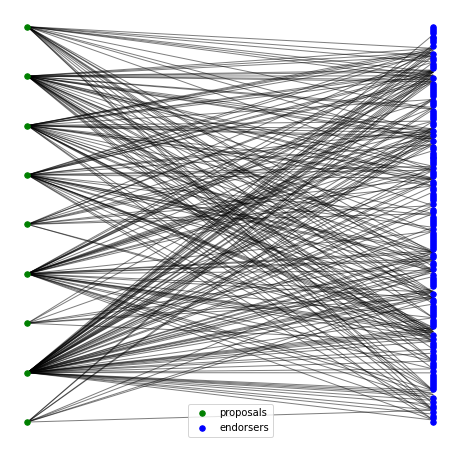

****** WARD ******
Iteration 7/7...
Final polarisation is 0.3
Plot saved to ../plots/CFE/CFE_Coronavirus_recovery_TreeWard.png!


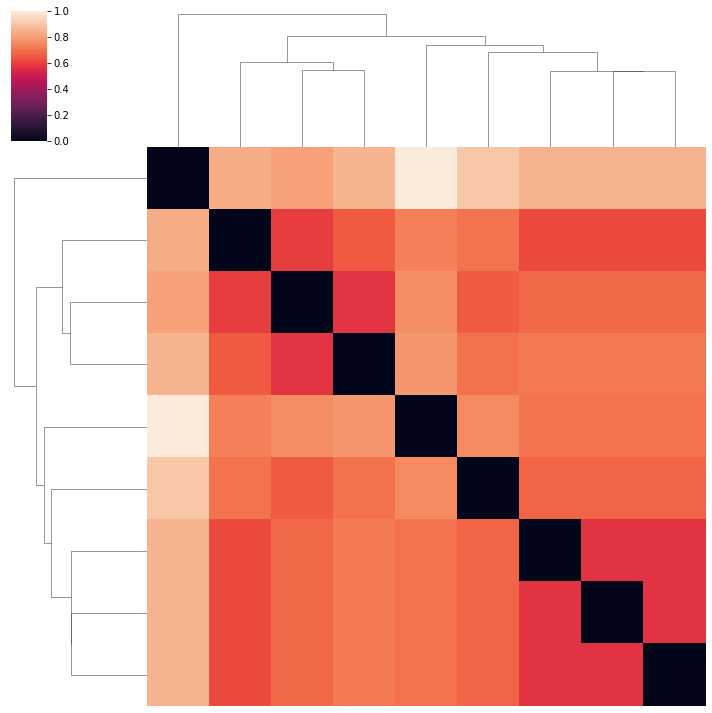

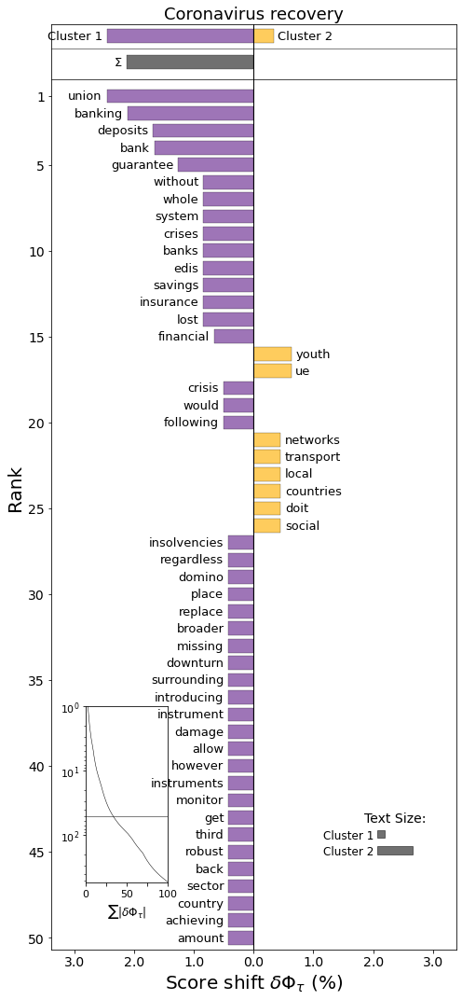

Plot saved to ../plots/CFE/CFE_Coronavirus_recovery_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 7/7...
Final polarisation is 0.3
Plot saved to ../plots/CFE/CFE_Coronavirus_recovery_TreeCentroid.png!


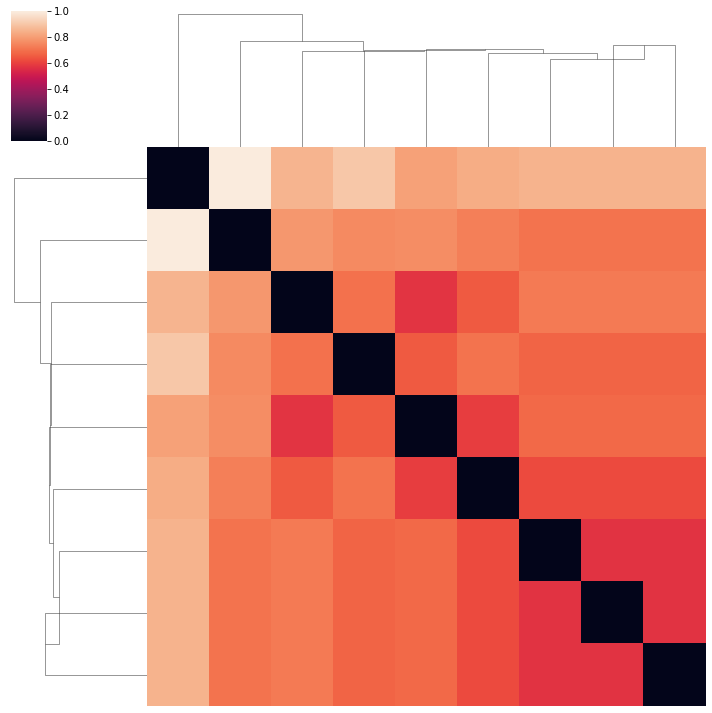

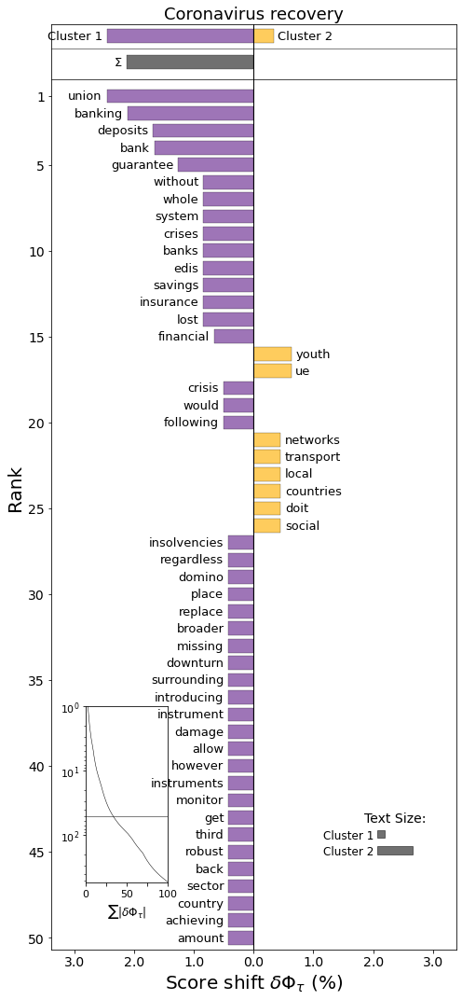

Plot saved to ../plots/CFE/CFE_Coronavirus_recovery_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 7/7...
Final polarisation is 0.37
Plot saved to ../plots/CFE/CFE_Coronavirus_recovery_TreePoldist.png!


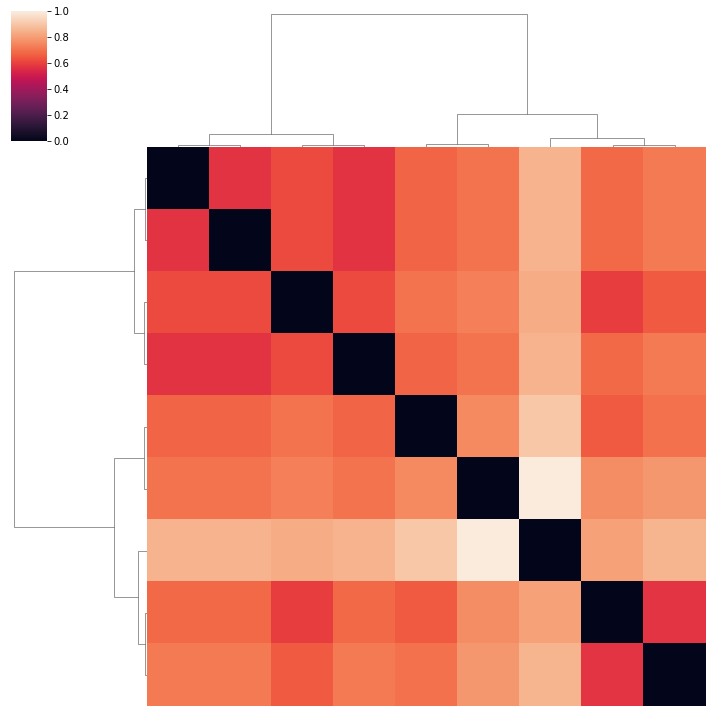

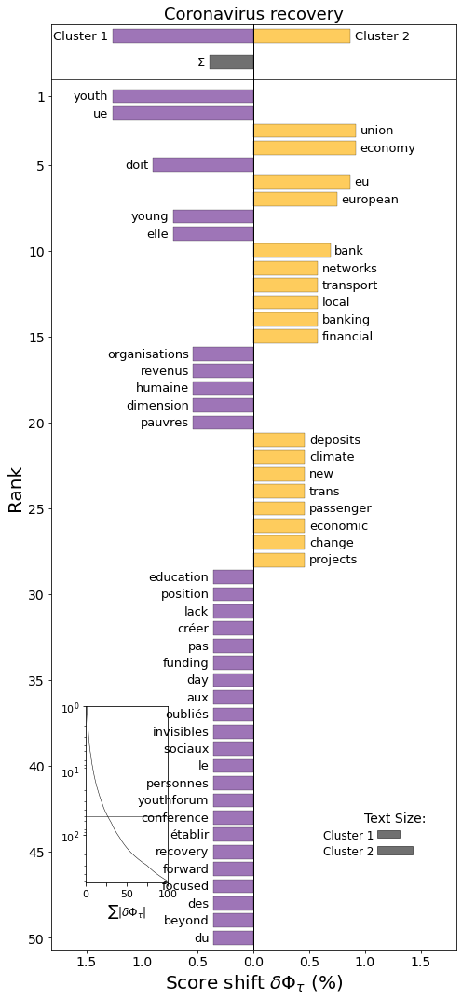

Plot saved to ../plots/CFE/CFE_Coronavirus_recovery_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
Plot saved to ../plots/CFE/CFE_Coronavirus_recovery_PolarisationPoldist.png!


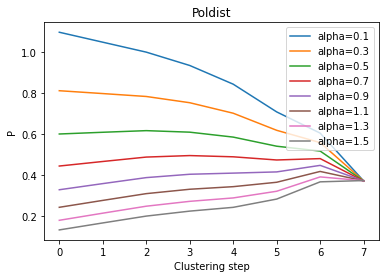

Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
Plot saved to ../plots/CFE/CFE_Coronavirus_recovery_PolarisationCentroid.png!


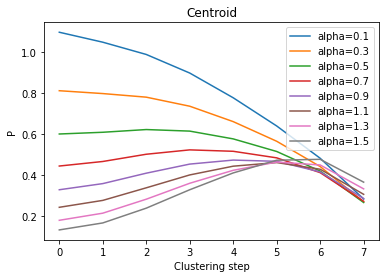

Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
Plot saved to ../plots/CFE/CFE_Coronavirus_recovery_PolarisationWard.png!


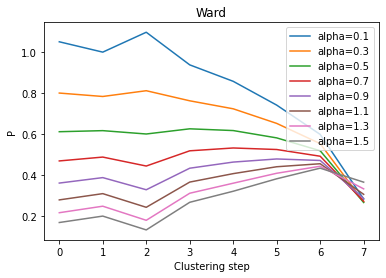

Iteration 7/7...
***** alpha=0.1 *****
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
***** alpha=0.13 *****
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
***** alpha=0.16 *****
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
***** alpha=0.21 *****
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
***** alpha=0.26 *****
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
***** alpha=0.34 *****
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
***** alpha=0.43 *****
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
***** alpha=0.55 *****
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
***** alpha=0.7 *****
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
***** alpha=0.89 *****
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
***** alpha=1.13 *****
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
***** alpha=1.44 *****
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
***** alpha=1.83 *****
Iteration 7/7...
Iteration 7/7...
Iteration 7/7...
***** alpha=2.34 *****


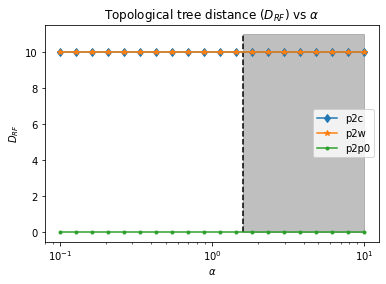

====== European rights and values ======
Total number of endorsers: 747
Number of unique endorsers: 536
Number of proposals: 78
Plot saved to ../plots/CFE/CFE_European_rights_and_values_Net.png!


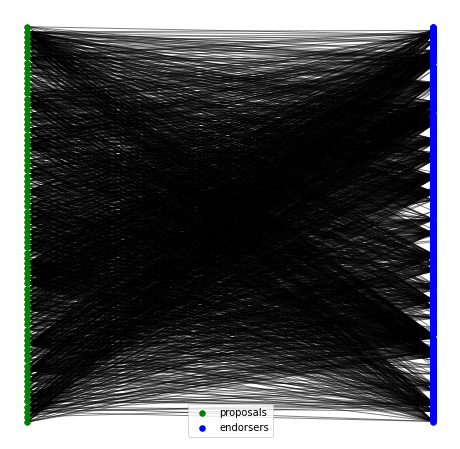

****** WARD ******
Iteration 76/76...
Final polarisation is 0.17
Plot saved to ../plots/CFE/CFE_European_rights_and_values_TreeWard.png!


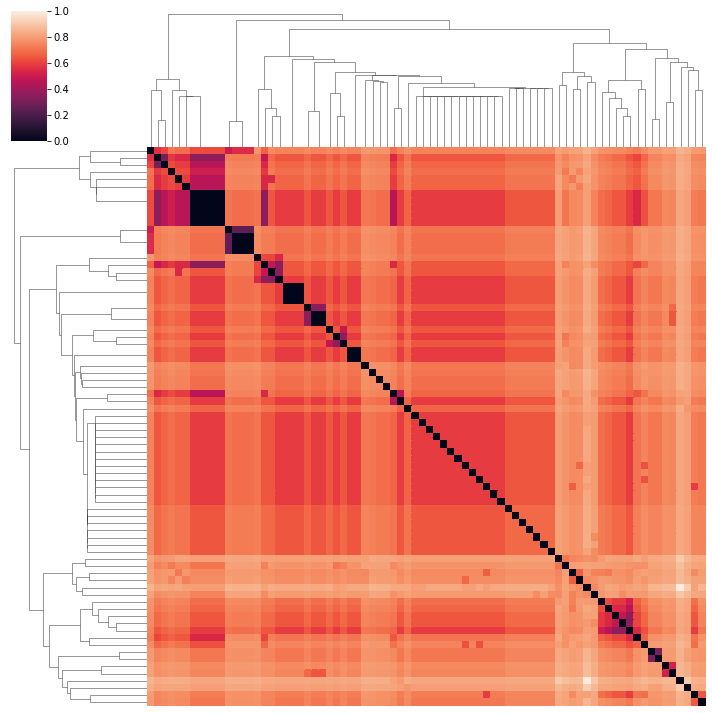

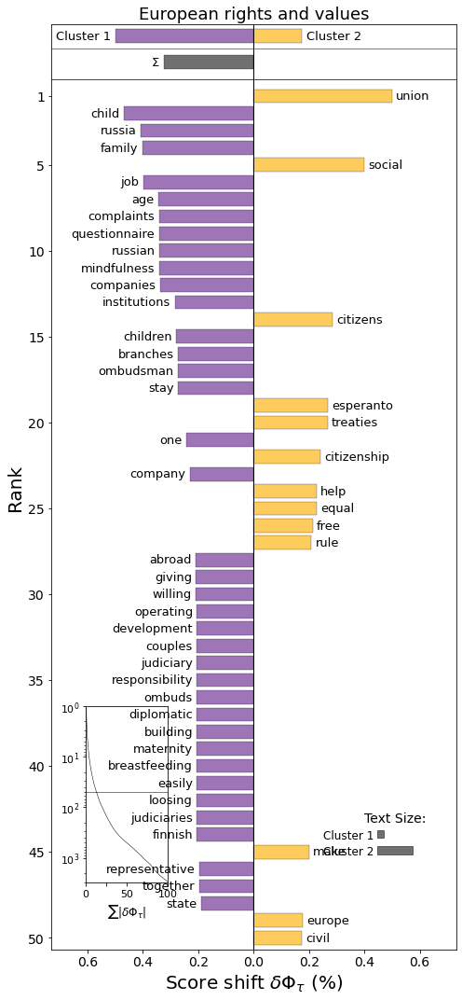

Plot saved to ../plots/CFE/CFE_European_rights_and_values_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 76/76...
Final polarisation is 0.03
Plot saved to ../plots/CFE/CFE_European_rights_and_values_TreeCentroid.png!


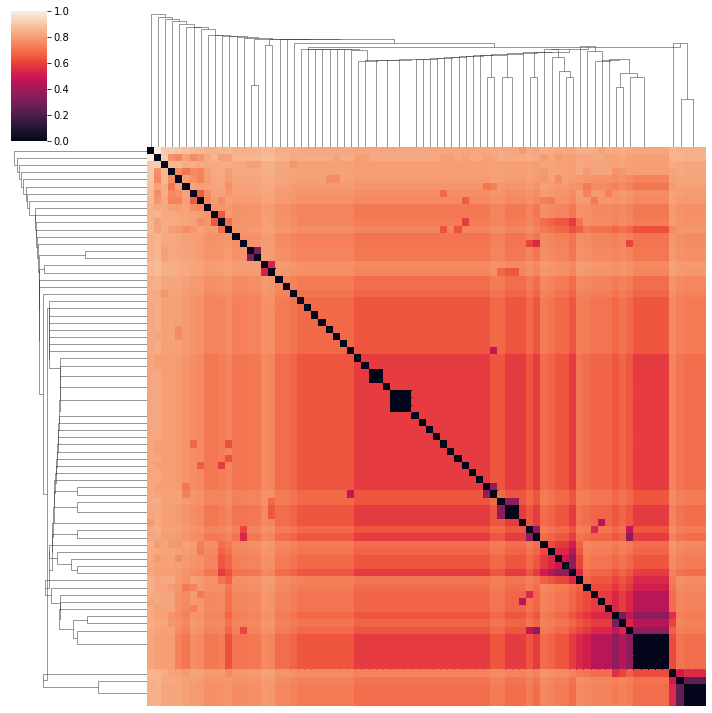

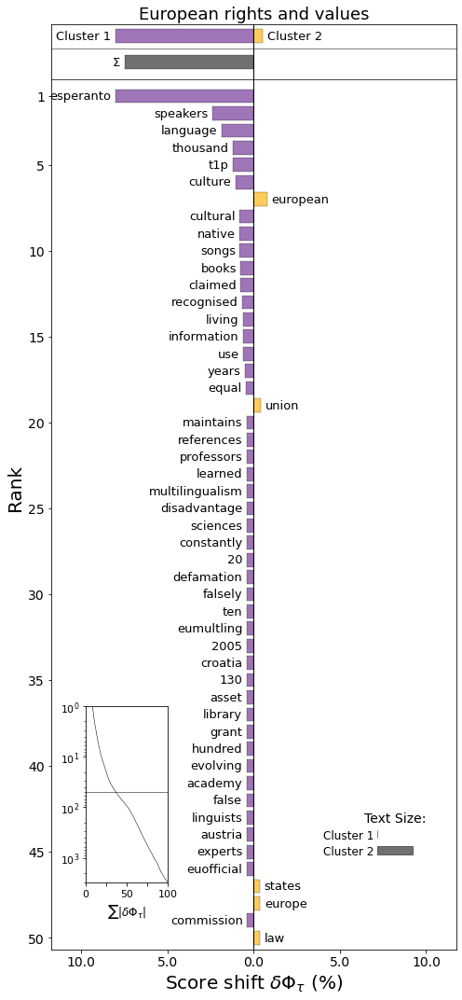

Plot saved to ../plots/CFE/CFE_European_rights_and_values_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 76/76...
Final polarisation is 0.18
Plot saved to ../plots/CFE/CFE_European_rights_and_values_TreePoldist.png!


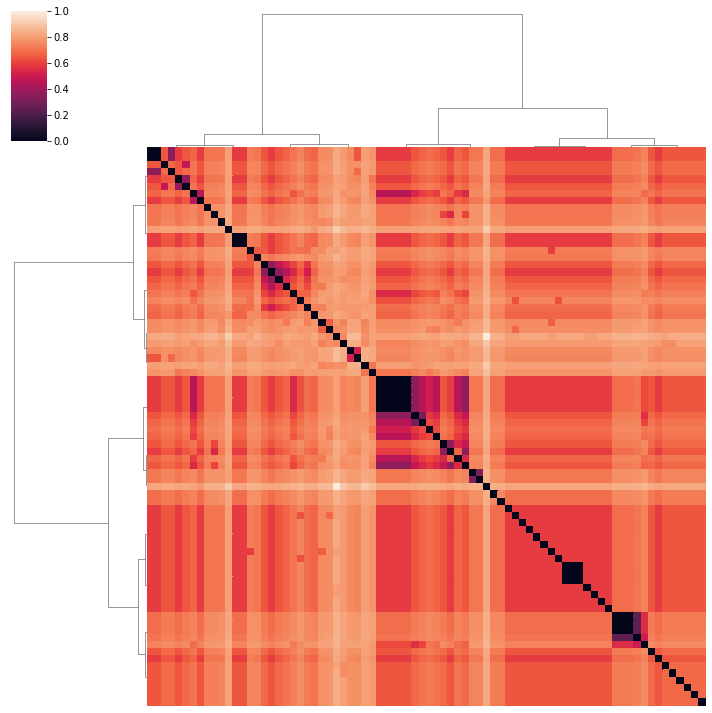

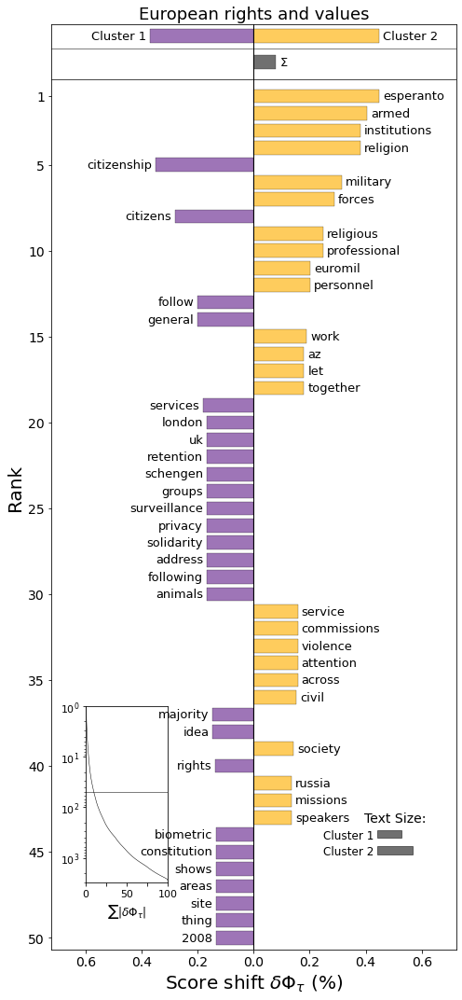

Plot saved to ../plots/CFE/CFE_European_rights_and_values_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
Plot saved to ../plots/CFE/CFE_European_rights_and_values_PolarisationPoldist.png!


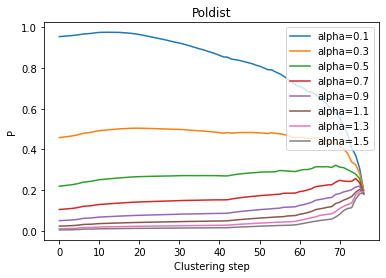

Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
Plot saved to ../plots/CFE/CFE_European_rights_and_values_PolarisationCentroid.png!


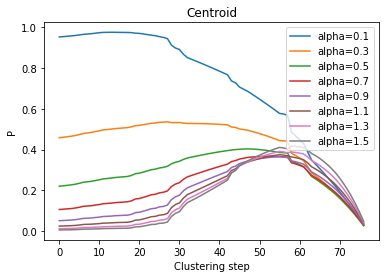

Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
Plot saved to ../plots/CFE/CFE_European_rights_and_values_PolarisationWard.png!


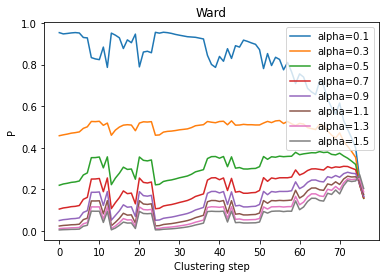

Iteration 76/76...
***** alpha=0.1 *****
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
***** alpha=0.13 *****
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
***** alpha=0.16 *****
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
***** alpha=0.21 *****
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
***** alpha=0.26 *****
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
***** alpha=0.34 *****
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
***** alpha=0.43 *****
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
***** alpha=0.55 *****
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
***** alpha=0.7 *****
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
***** alpha=0.89 *****
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
***** alpha=1.13 *****
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
***** alpha=1.44 *****
Iteration 76/76...
Iteration 76/76...
Iteration 76/76...
***** alpha=1.83 *****


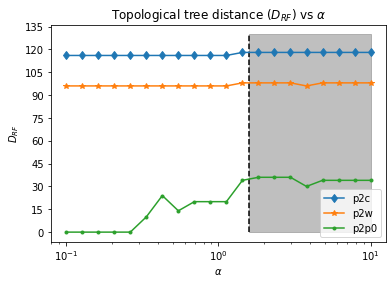

====== Security ======
Total number of endorsers: 195
Number of unique endorsers: 134
Number of proposals: 20
Plot saved to ../plots/CFE/CFE_Security_Net.png!


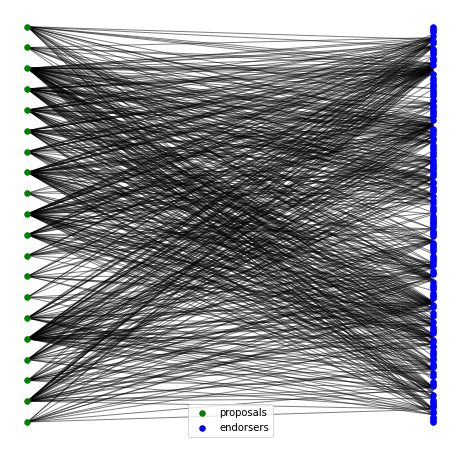

****** WARD ******
Iteration 18/18...
Final polarisation is 0.35
Plot saved to ../plots/CFE/CFE_Security_TreeWard.png!


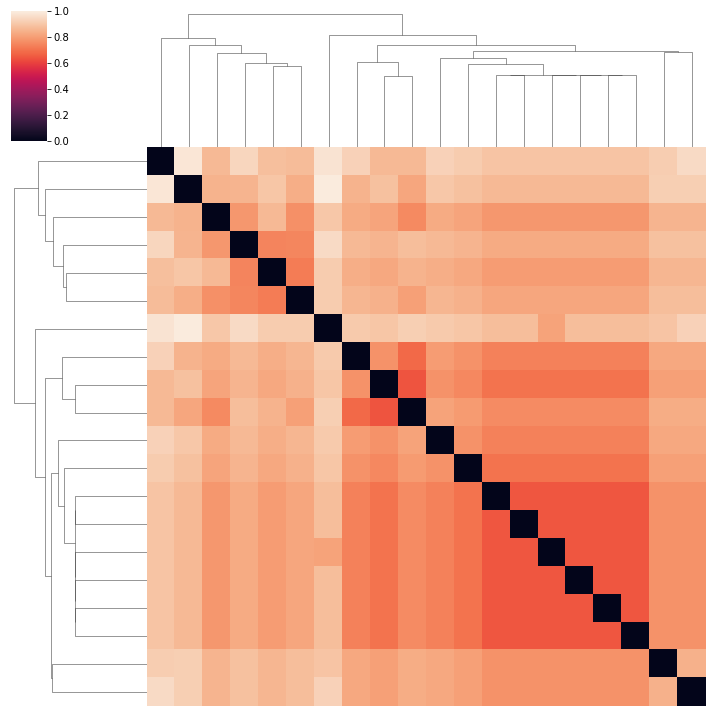

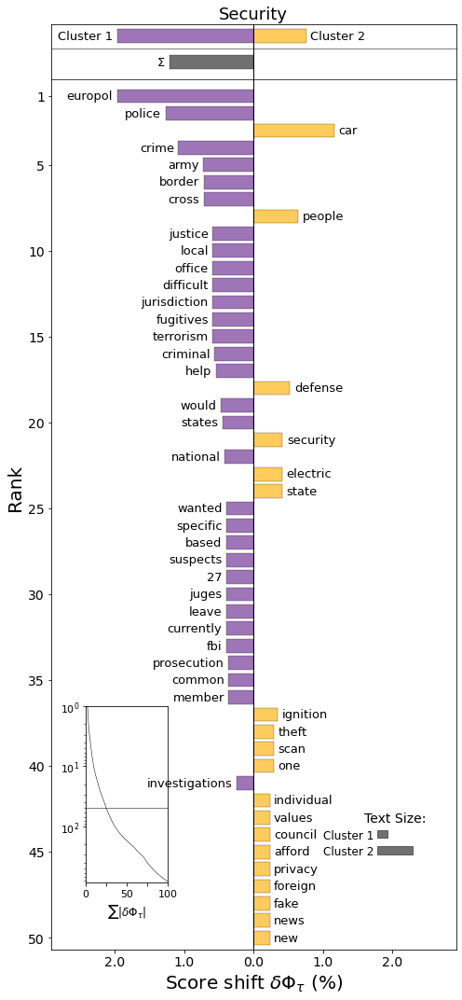

Plot saved to ../plots/CFE/CFE_Security_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 18/18...
Final polarisation is 0.14
Plot saved to ../plots/CFE/CFE_Security_TreeCentroid.png!


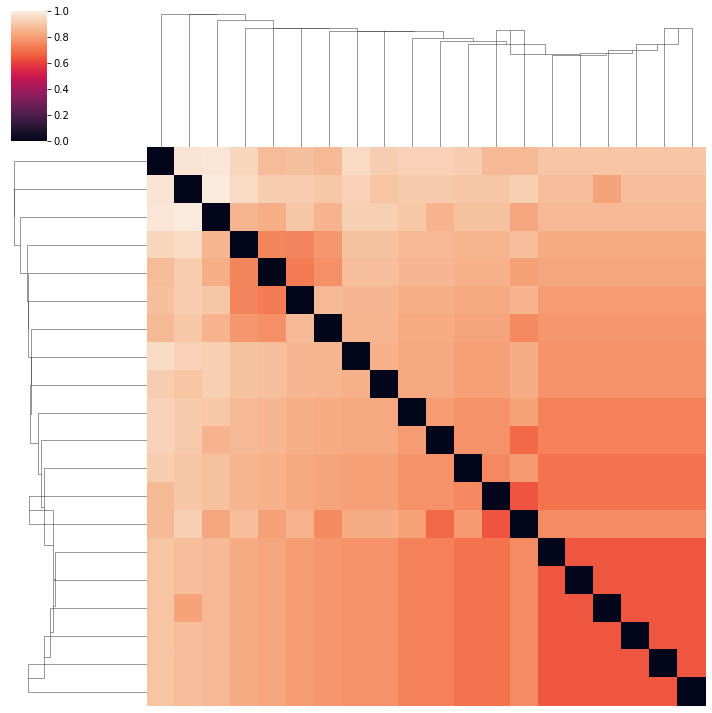

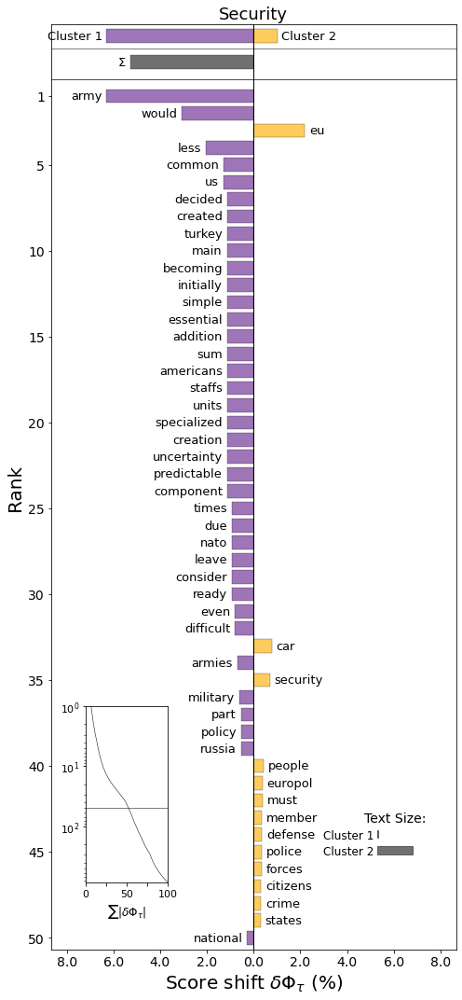

Plot saved to ../plots/CFE/CFE_Security_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 18/18...
Final polarisation is 0.33
Plot saved to ../plots/CFE/CFE_Security_TreePoldist.png!


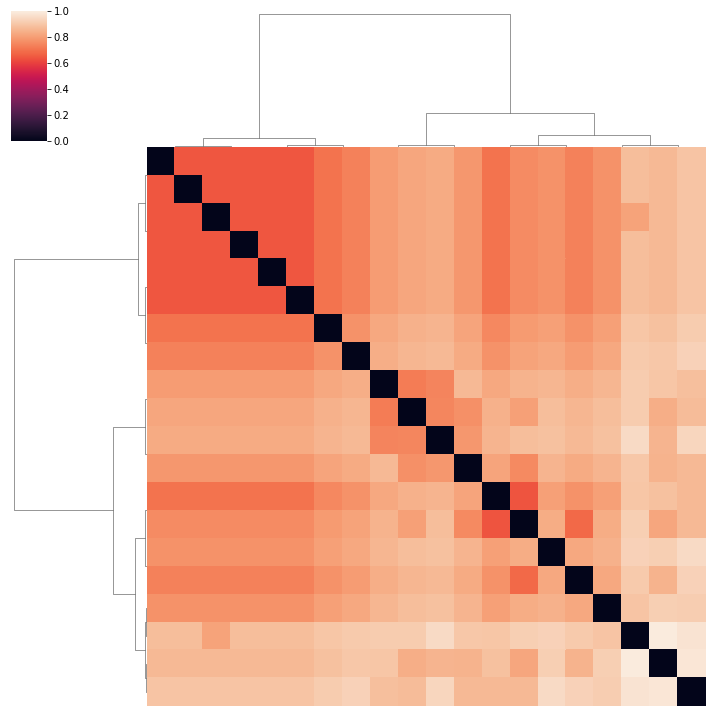

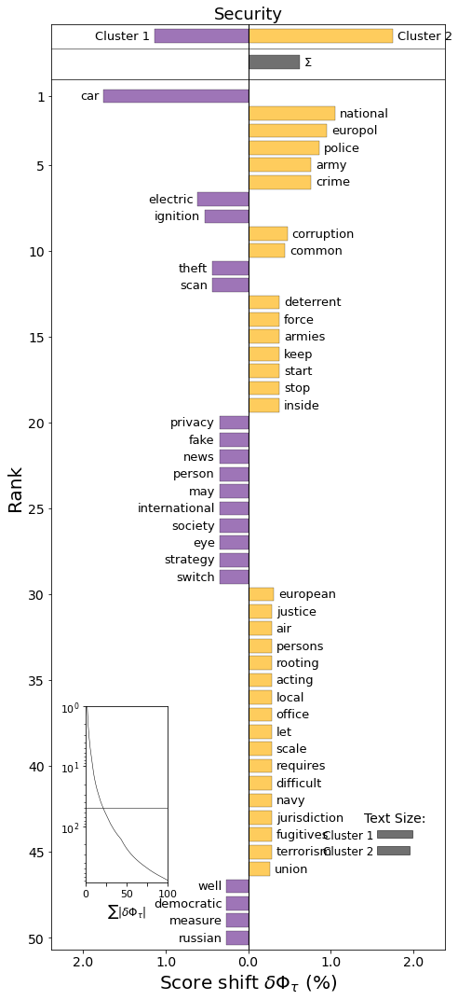

Plot saved to ../plots/CFE/CFE_Security_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Plot saved to ../plots/CFE/CFE_Security_PolarisationPoldist.png!


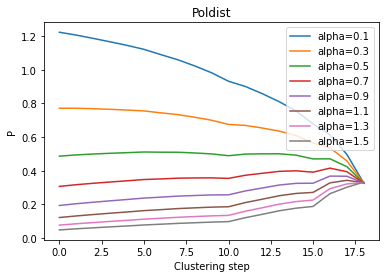

Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Plot saved to ../plots/CFE/CFE_Security_PolarisationCentroid.png!


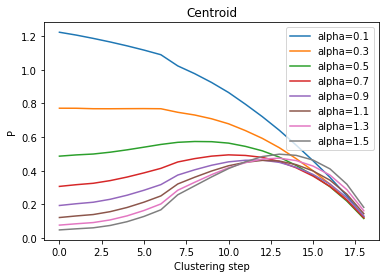

Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
Plot saved to ../plots/CFE/CFE_Security_PolarisationWard.png!


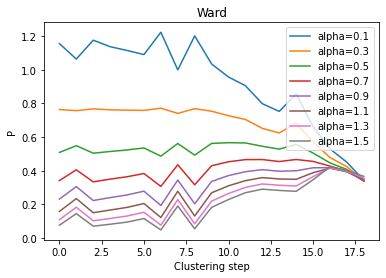

Iteration 18/18...
***** alpha=0.1 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=0.13 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=0.16 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=0.21 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=0.26 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=0.34 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=0.43 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=0.55 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=0.7 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=0.89 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=1.13 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=1.44 *****
Iteration 18/18...
Iteration 18/18...
Iteration 18/18...
***** alpha=1.83 *****


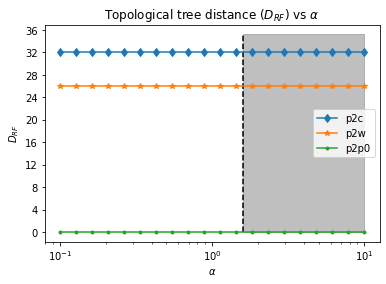

====== Consumer rights ======
Total number of endorsers: 47
Number of unique endorsers: 47
Number of proposals: 6
Plot saved to ../plots/CFE/CFE_Consumer_rights_Net.png!


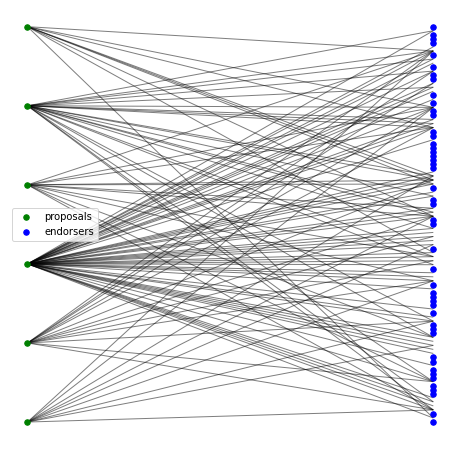

****** WARD ******
Iteration 4/4...
Final polarisation is 0.46
Plot saved to ../plots/CFE/CFE_Consumer_rights_TreeWard.png!


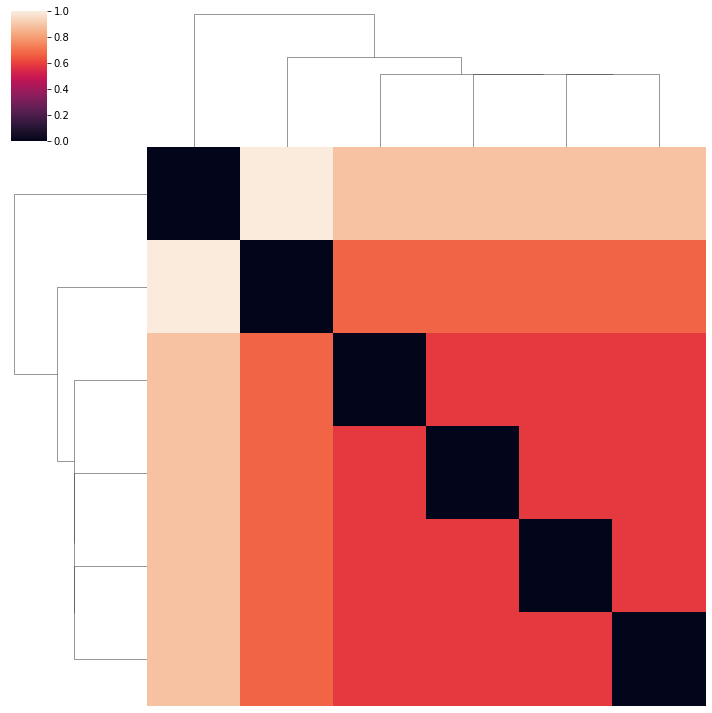

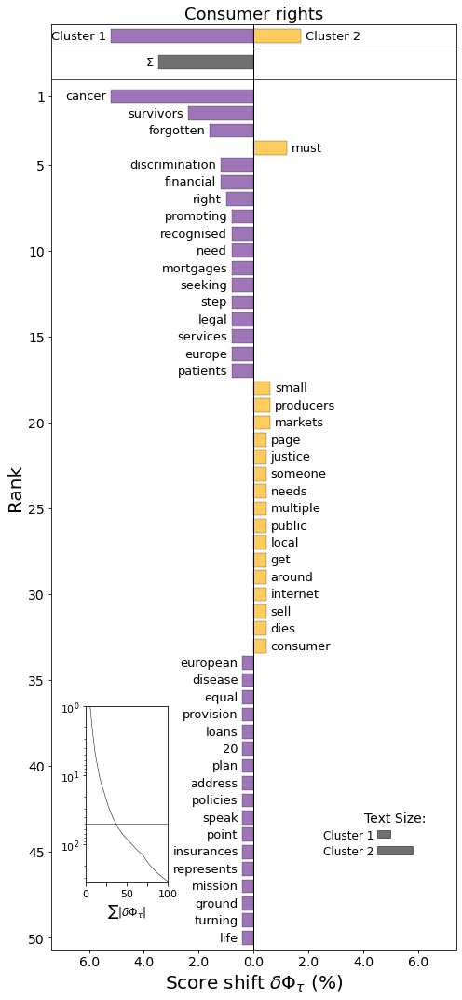

Plot saved to ../plots/CFE/CFE_Consumer_rights_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 4/4...
Final polarisation is 0.46
Plot saved to ../plots/CFE/CFE_Consumer_rights_TreeCentroid.png!


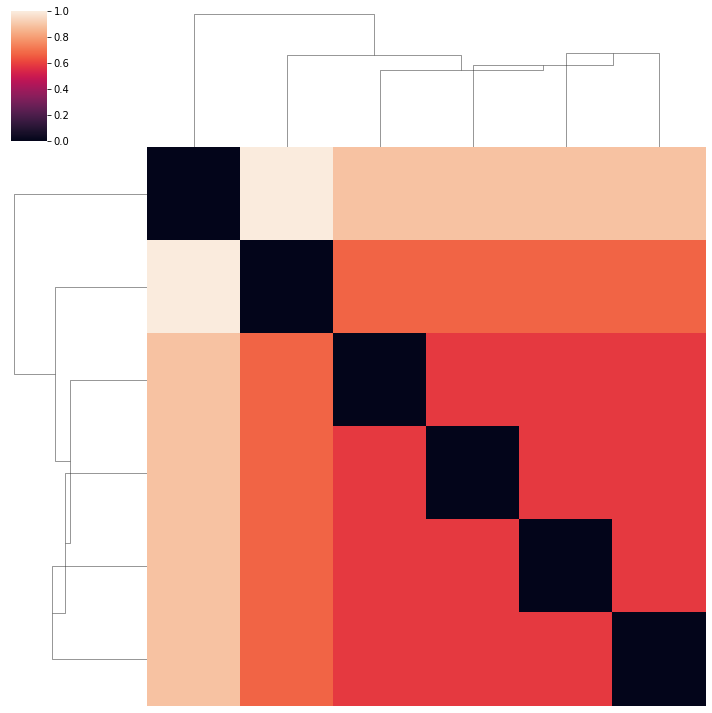

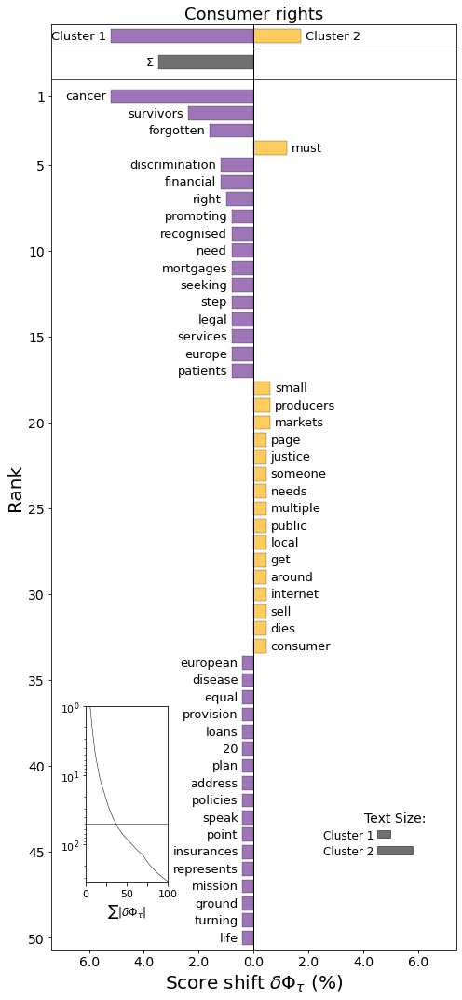

Plot saved to ../plots/CFE/CFE_Consumer_rights_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 4/4...
Final polarisation is 0.44
Plot saved to ../plots/CFE/CFE_Consumer_rights_TreePoldist.png!


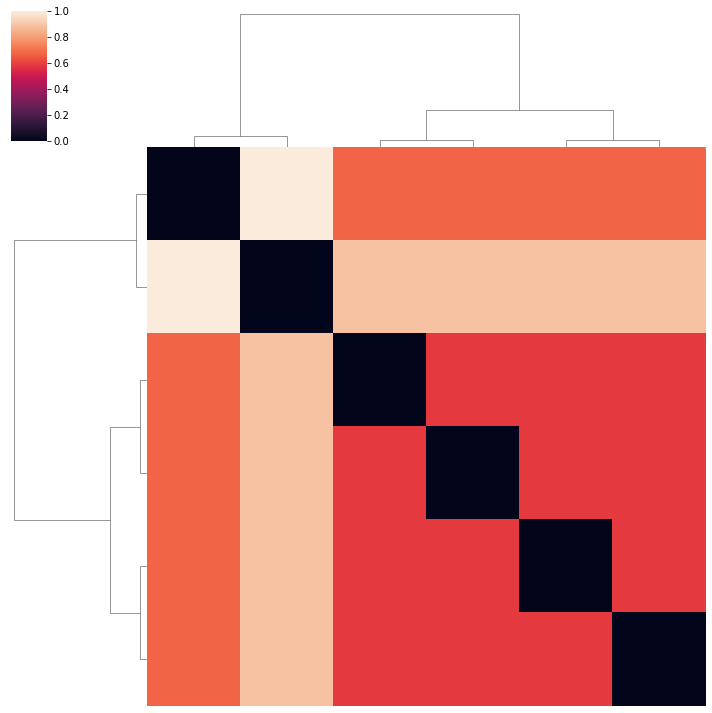

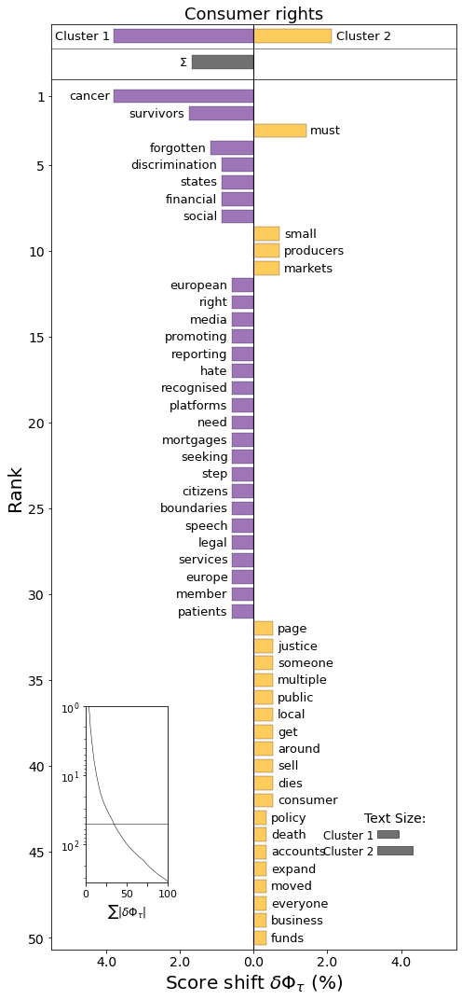

Plot saved to ../plots/CFE/CFE_Consumer_rights_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
Plot saved to ../plots/CFE/CFE_Consumer_rights_PolarisationPoldist.png!


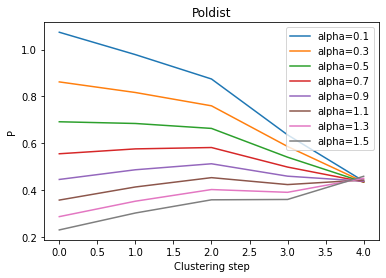

Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
Plot saved to ../plots/CFE/CFE_Consumer_rights_PolarisationCentroid.png!


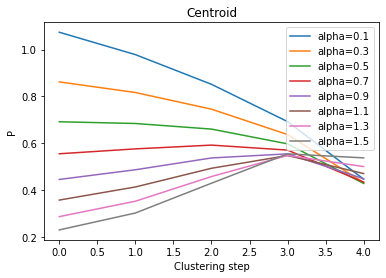

Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
Plot saved to ../plots/CFE/CFE_Consumer_rights_PolarisationWard.png!


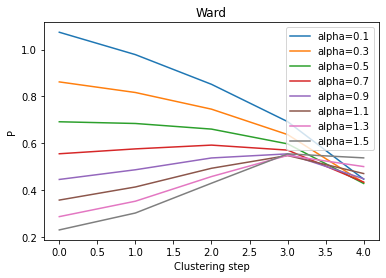

Iteration 4/4...
***** alpha=0.1 *****
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
***** alpha=0.13 *****
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
***** alpha=0.16 *****
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
***** alpha=0.21 *****
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
***** alpha=0.26 *****
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
***** alpha=0.34 *****
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
***** alpha=0.43 *****
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
***** alpha=0.55 *****
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
***** alpha=0.7 *****
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
***** alpha=0.89 *****
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
***** alpha=1.13 *****
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
***** alpha=1.44 *****
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
***** alpha=1.83 *****
Iteration 4/4...
Iteration 4/4...
Iteration 4/4...
***** alpha=2.34 *****


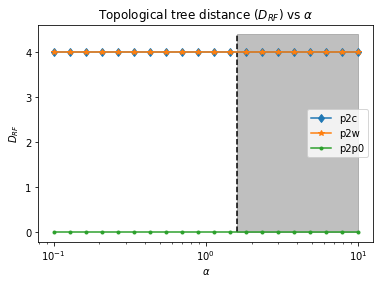

====== Technology for people ======
Total number of endorsers: 493
Number of unique endorsers: 269
Number of proposals: 60
Plot saved to ../plots/CFE/CFE_Technology_for_people_Net.png!


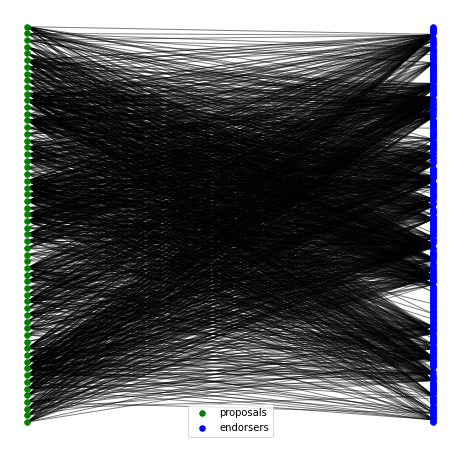

****** WARD ******
Iteration 58/58...
Final polarisation is 0.21
Plot saved to ../plots/CFE/CFE_Technology_for_people_TreeWard.png!


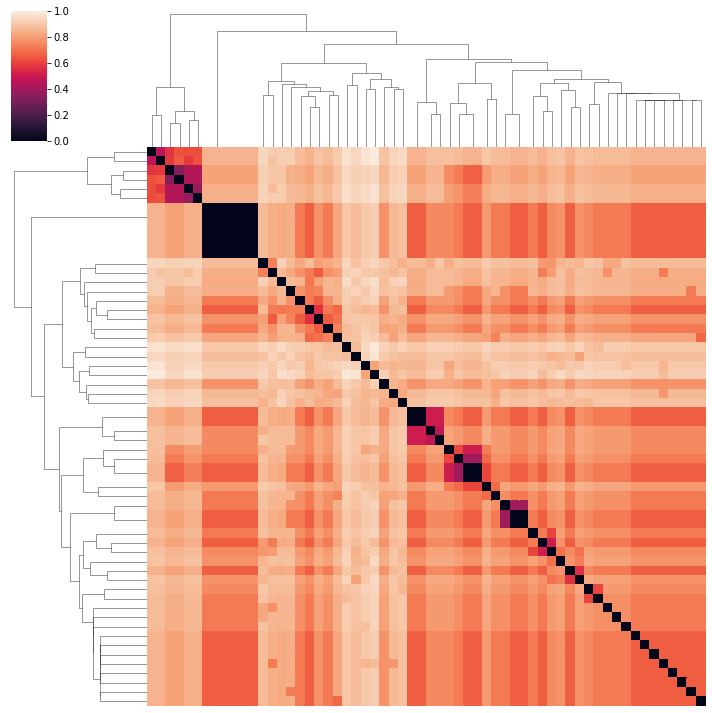

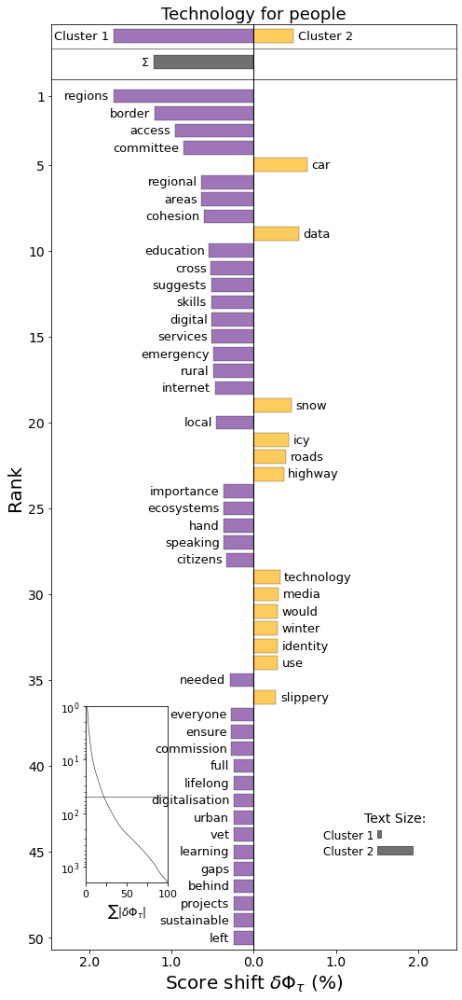

Plot saved to ../plots/CFE/CFE_Technology_for_people_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 58/58...
Final polarisation is 0.05
Plot saved to ../plots/CFE/CFE_Technology_for_people_TreeCentroid.png!


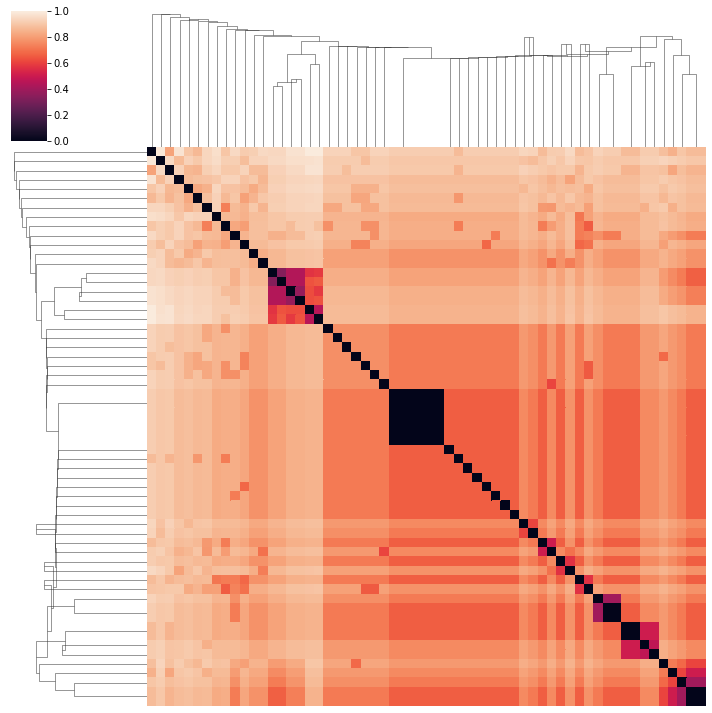

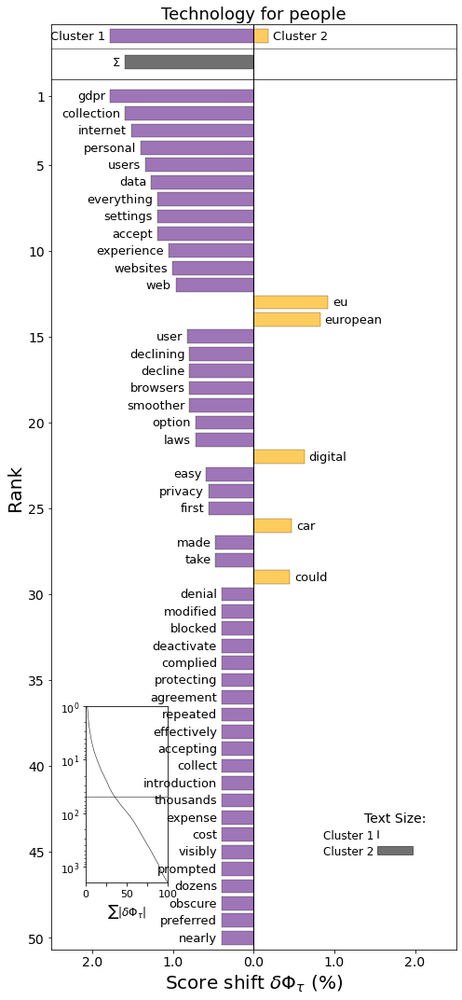

Plot saved to ../plots/CFE/CFE_Technology_for_people_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 58/58...
Final polarisation is 0.24
Plot saved to ../plots/CFE/CFE_Technology_for_people_TreePoldist.png!


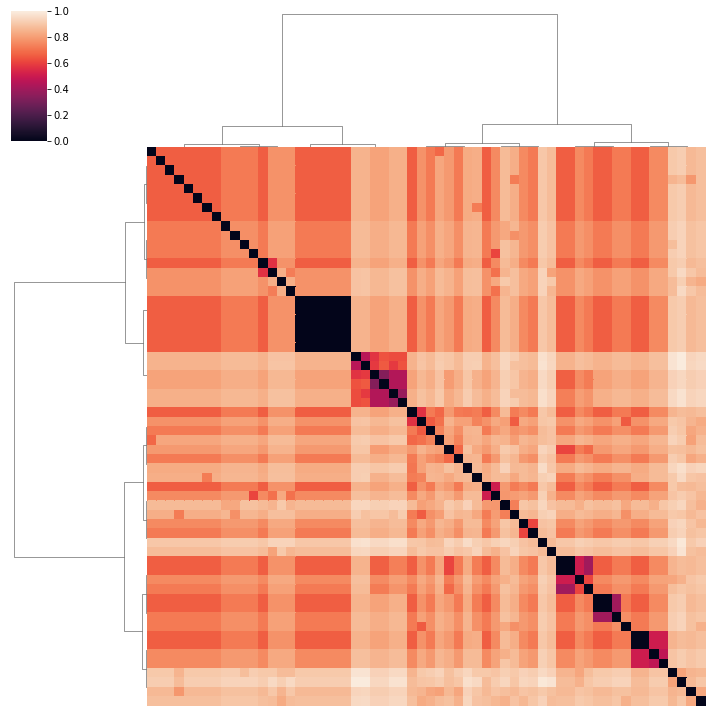

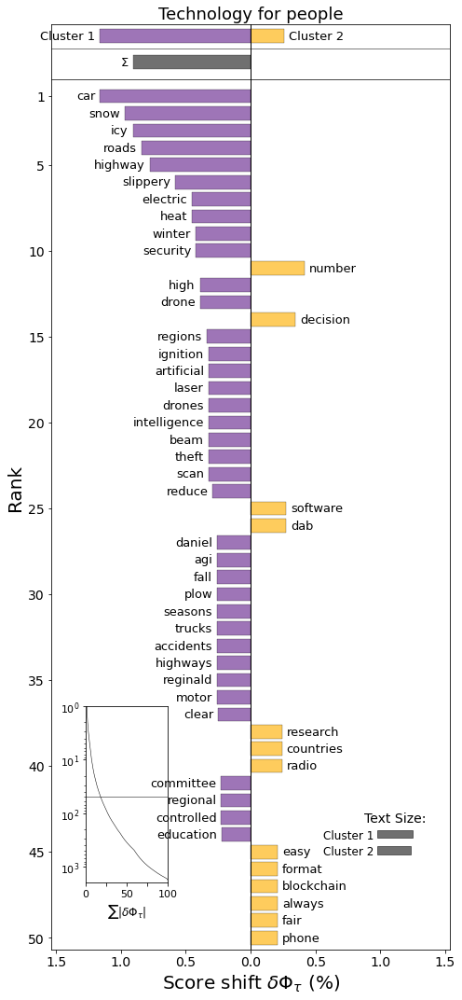

Plot saved to ../plots/CFE/CFE_Technology_for_people_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Plot saved to ../plots/CFE/CFE_Technology_for_people_PolarisationPoldist.png!


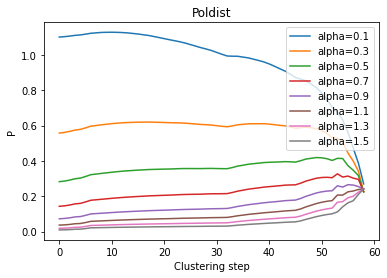

Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Plot saved to ../plots/CFE/CFE_Technology_for_people_PolarisationCentroid.png!


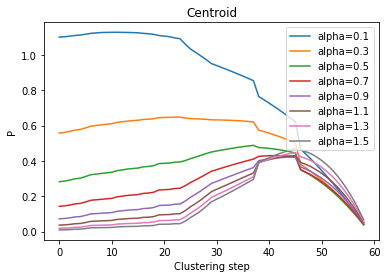

Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Plot saved to ../plots/CFE/CFE_Technology_for_people_PolarisationWard.png!


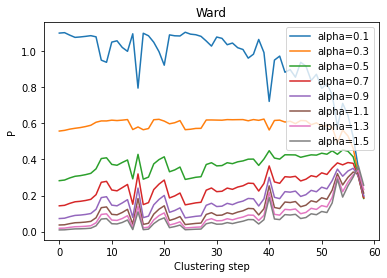

Iteration 58/58...
***** alpha=0.1 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=0.13 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=0.16 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=0.21 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=0.26 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=0.34 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=0.43 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=0.55 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=0.7 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=0.89 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=1.13 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=1.44 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=1.83 *****


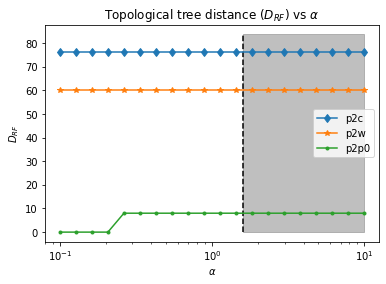

====== Digital economy ======
Total number of endorsers: 329
Number of unique endorsers: 229
Number of proposals: 29
Plot saved to ../plots/CFE/CFE_Digital_economy_Net.png!


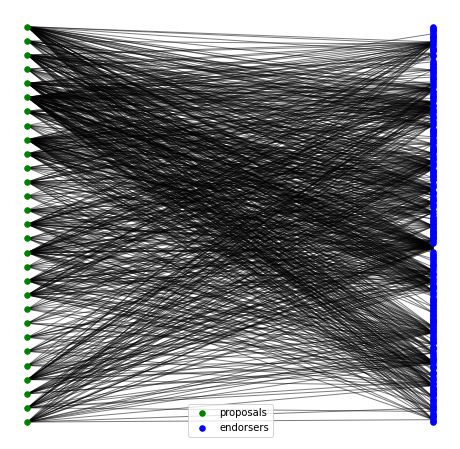

****** WARD ******
Iteration 27/27...
Final polarisation is 0.33
Plot saved to ../plots/CFE/CFE_Digital_economy_TreeWard.png!


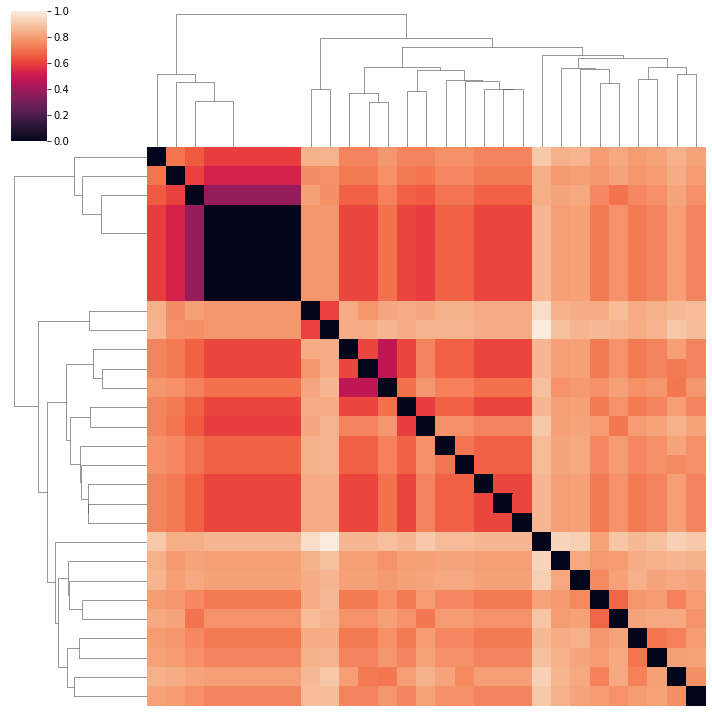

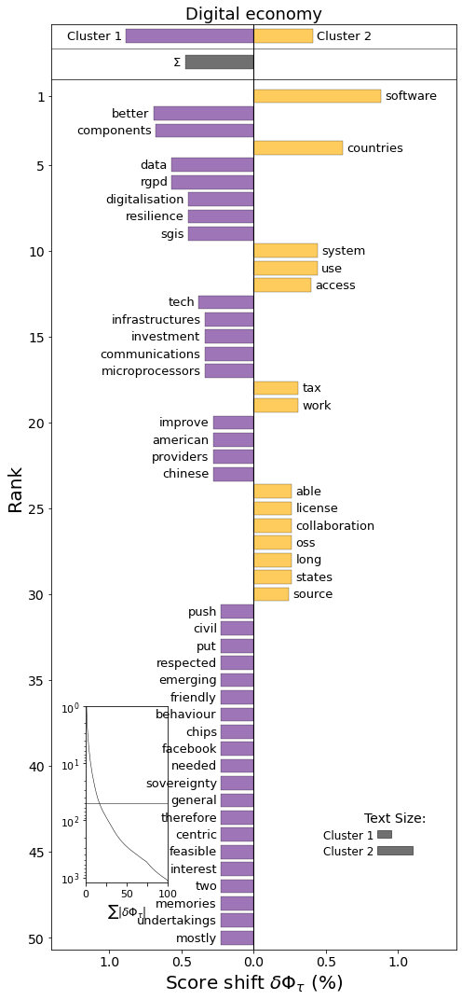

Plot saved to ../plots/CFE/CFE_Digital_economy_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 27/27...
Final polarisation is 0.1
Plot saved to ../plots/CFE/CFE_Digital_economy_TreeCentroid.png!


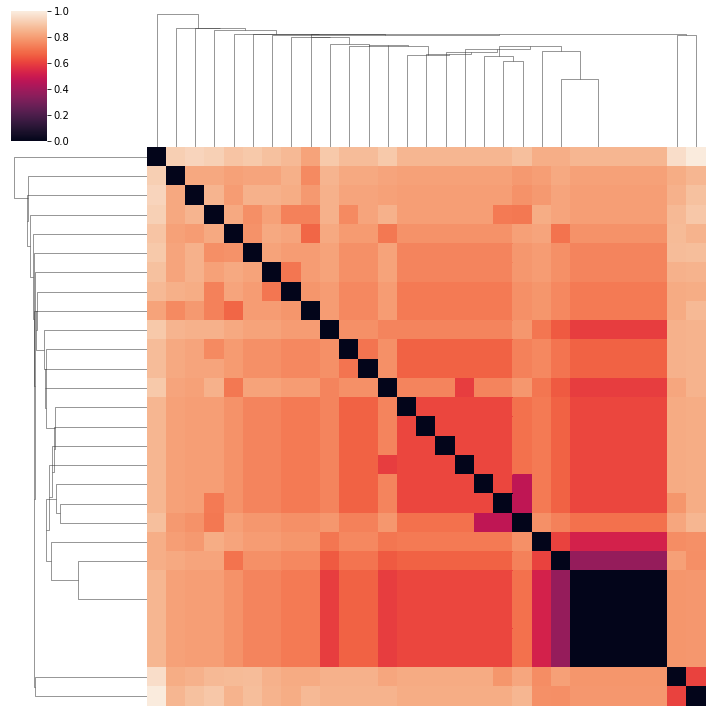

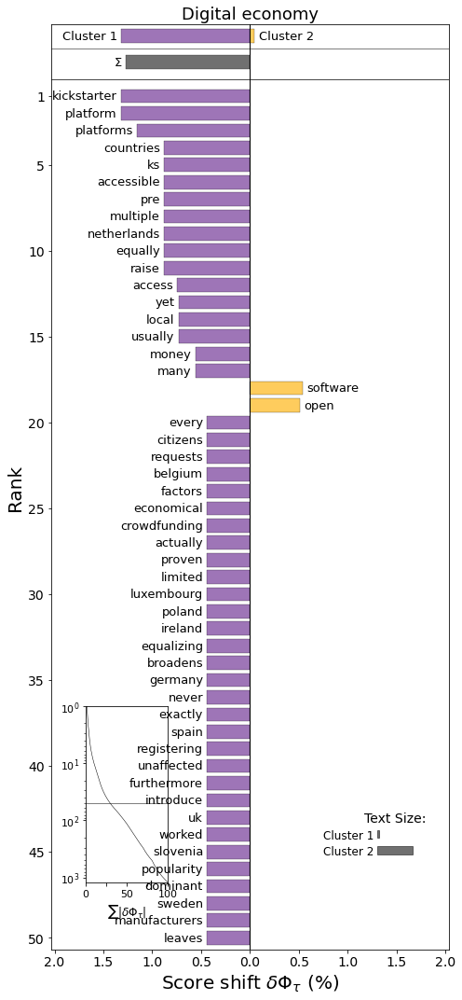

Plot saved to ../plots/CFE/CFE_Digital_economy_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 27/27...
Final polarisation is 0.31
Plot saved to ../plots/CFE/CFE_Digital_economy_TreePoldist.png!


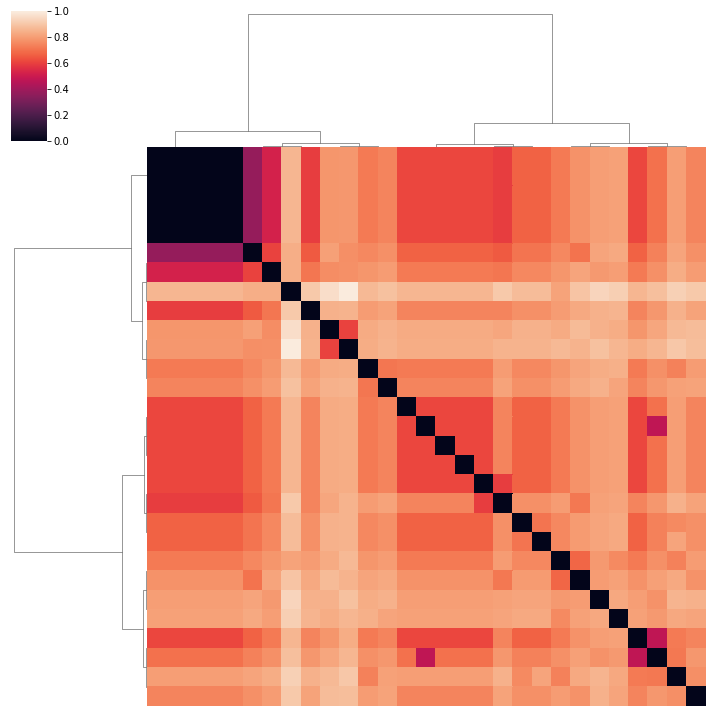

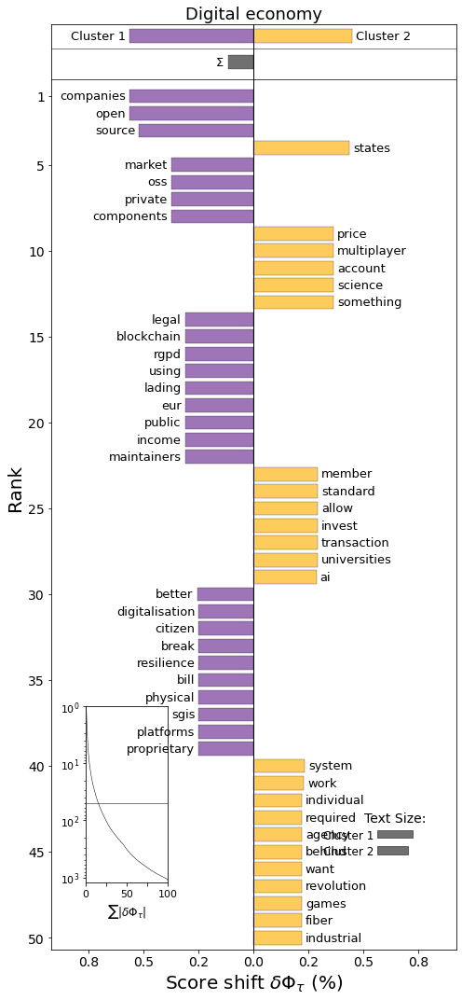

Plot saved to ../plots/CFE/CFE_Digital_economy_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
Plot saved to ../plots/CFE/CFE_Digital_economy_PolarisationPoldist.png!


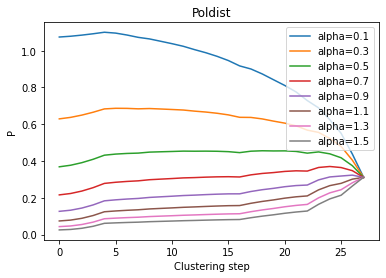

Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
Plot saved to ../plots/CFE/CFE_Digital_economy_PolarisationCentroid.png!


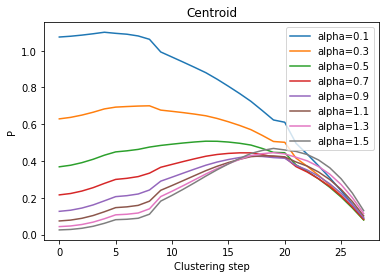

Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
Plot saved to ../plots/CFE/CFE_Digital_economy_PolarisationWard.png!


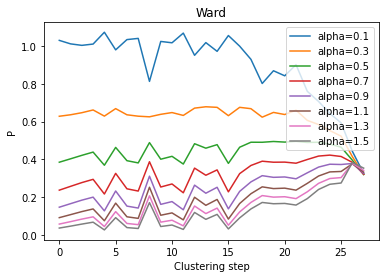

Iteration 27/27...
***** alpha=0.1 *****
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
***** alpha=0.13 *****
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
***** alpha=0.16 *****
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
***** alpha=0.21 *****
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
***** alpha=0.26 *****
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
***** alpha=0.34 *****
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
***** alpha=0.43 *****
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
***** alpha=0.55 *****
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
***** alpha=0.7 *****
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
***** alpha=0.89 *****
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
***** alpha=1.13 *****
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
***** alpha=1.44 *****
Iteration 27/27...
Iteration 27/27...
Iteration 27/27...
***** alpha=1.83 *****


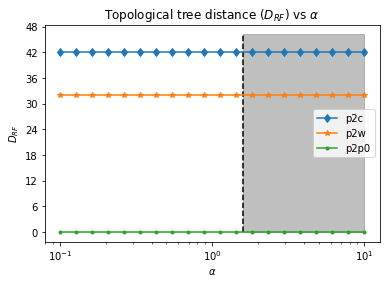

====== A sustainable digital society ======
Total number of endorsers: 179
Number of unique endorsers: 149
Number of proposals: 27
Plot saved to ../plots/CFE/CFE_A_sustainable_digital_society_Net.png!


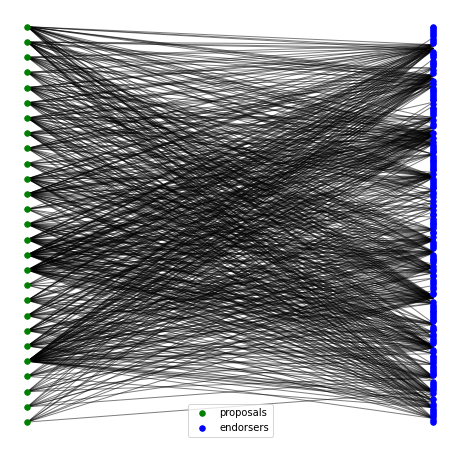

****** WARD ******
Iteration 25/25...
Final polarisation is 0.33
Plot saved to ../plots/CFE/CFE_A_sustainable_digital_society_TreeWard.png!


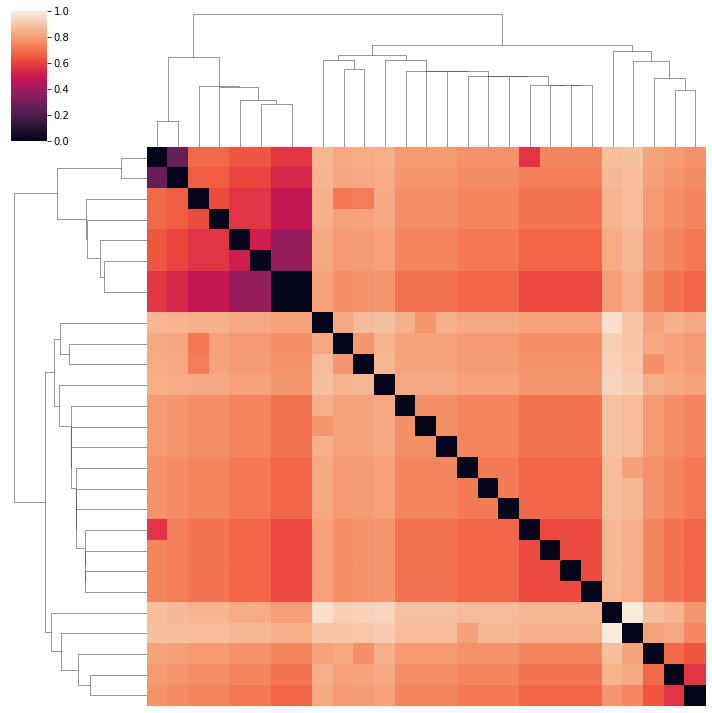

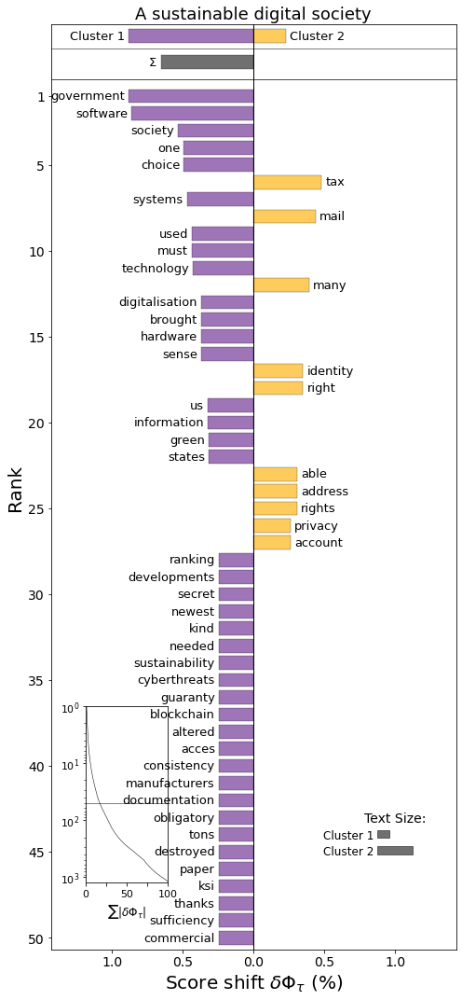

Plot saved to ../plots/CFE/CFE_A_sustainable_digital_society_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 25/25...
Final polarisation is 0.1
Plot saved to ../plots/CFE/CFE_A_sustainable_digital_society_TreeCentroid.png!


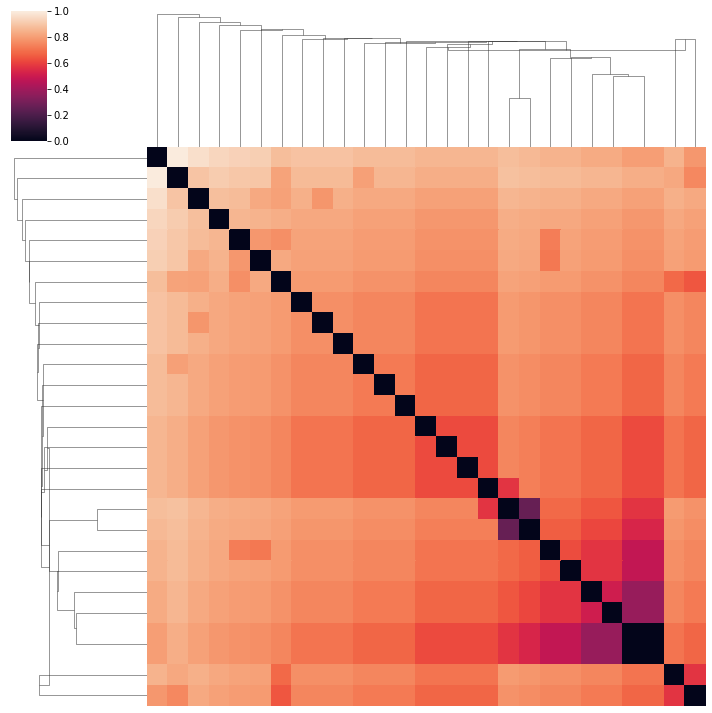

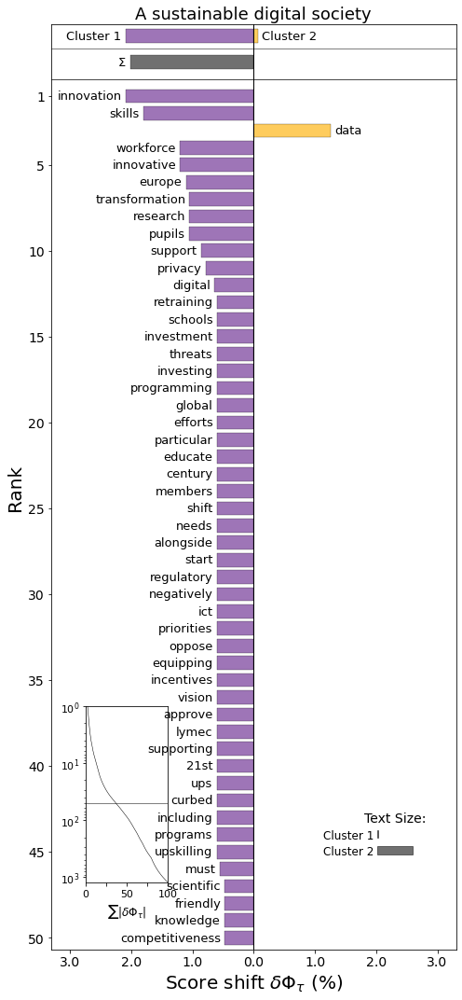

Plot saved to ../plots/CFE/CFE_A_sustainable_digital_society_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 25/25...
Final polarisation is 0.3
Plot saved to ../plots/CFE/CFE_A_sustainable_digital_society_TreePoldist.png!


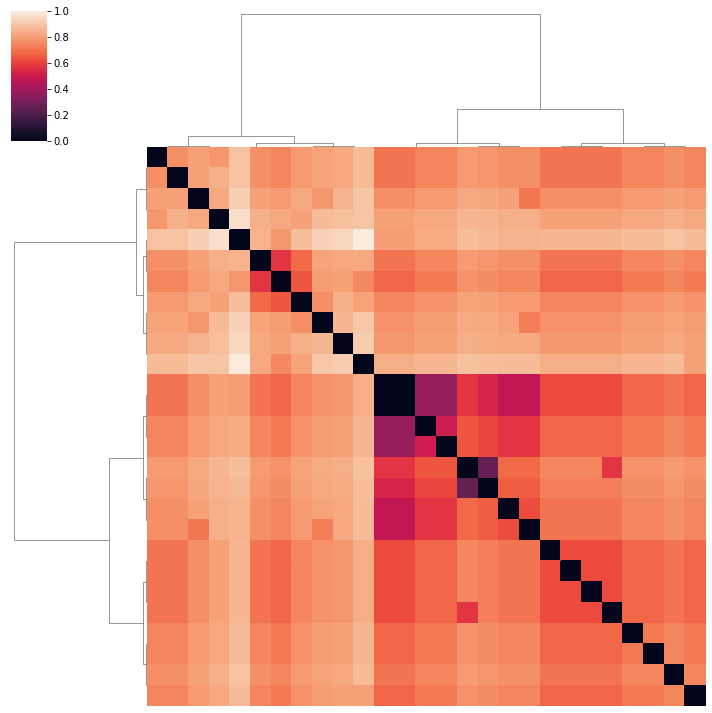

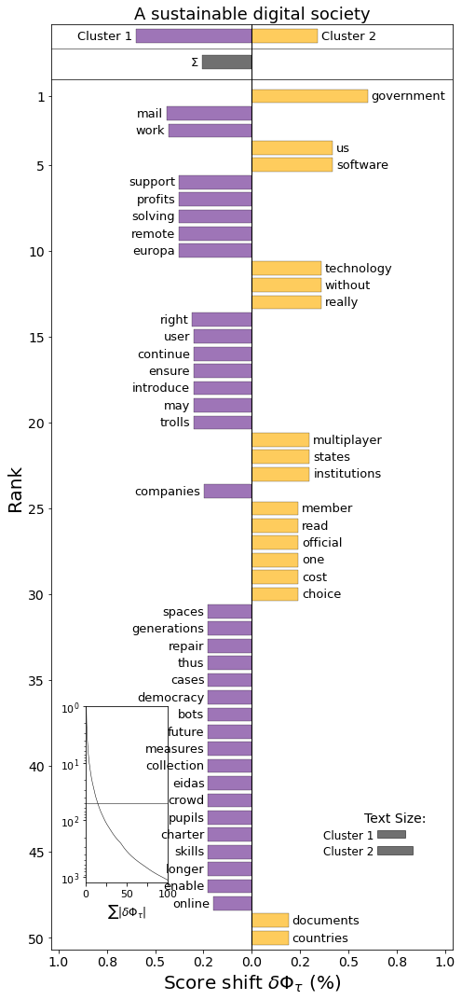

Plot saved to ../plots/CFE/CFE_A_sustainable_digital_society_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Plot saved to ../plots/CFE/CFE_A_sustainable_digital_society_PolarisationPoldist.png!


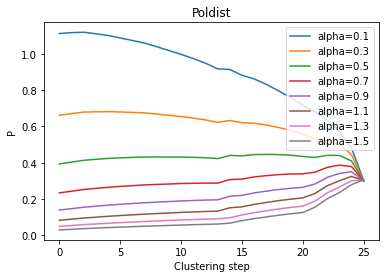

Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Plot saved to ../plots/CFE/CFE_A_sustainable_digital_society_PolarisationCentroid.png!


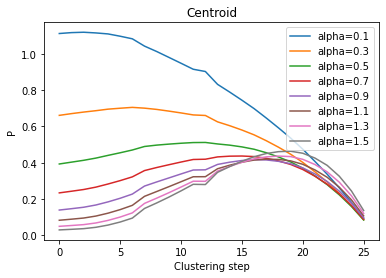

Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Plot saved to ../plots/CFE/CFE_A_sustainable_digital_society_PolarisationWard.png!


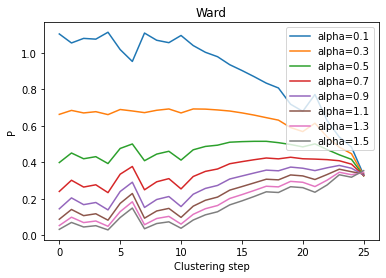

Iteration 25/25...
***** alpha=0.1 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=0.13 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=0.16 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=0.21 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=0.26 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=0.34 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=0.43 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=0.55 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=0.7 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=0.89 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=1.13 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=1.44 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=1.83 *****


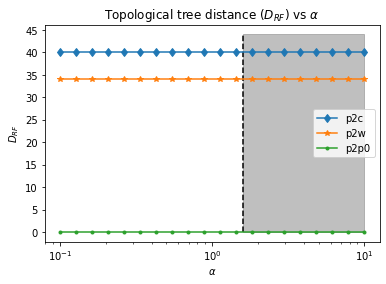

====== Security and defence ======
Total number of endorsers: 683
Number of unique endorsers: 504
Number of proposals: 35
Plot saved to ../plots/CFE/CFE_Security_and_defence_Net.png!


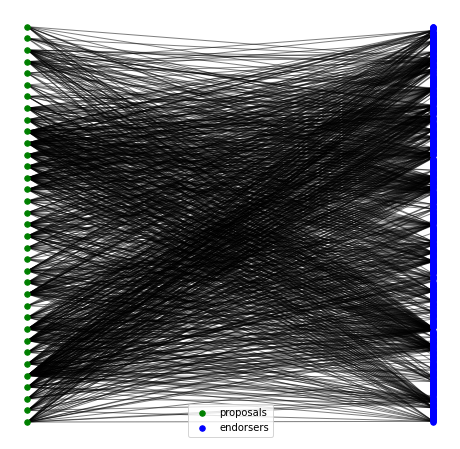

****** WARD ******
Iteration 33/33...
Final polarisation is 0.23
Plot saved to ../plots/CFE/CFE_Security_and_defence_TreeWard.png!


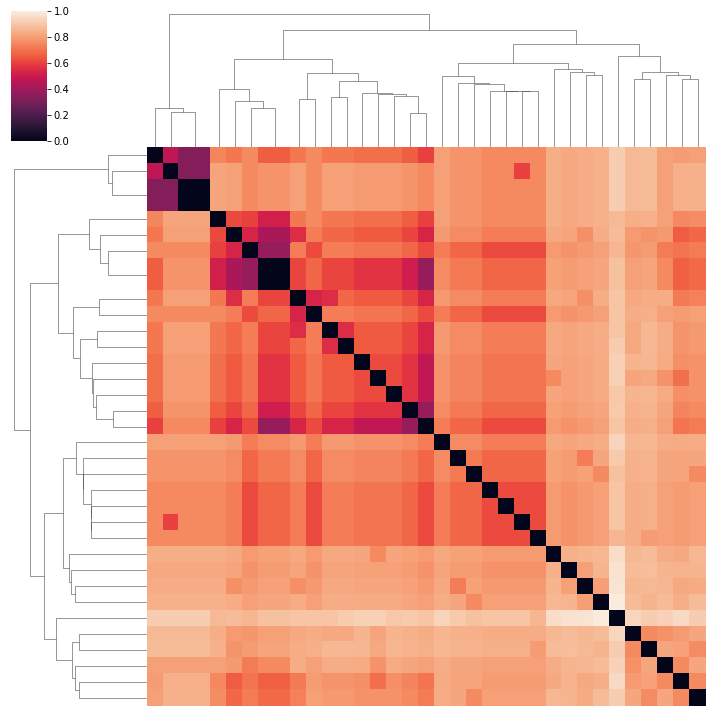

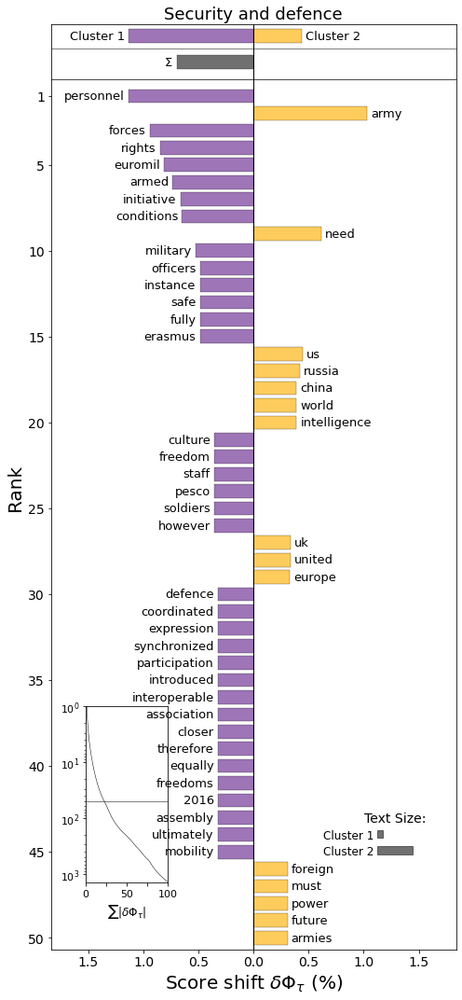

Plot saved to ../plots/CFE/CFE_Security_and_defence_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 33/33...
Final polarisation is 0.08
Plot saved to ../plots/CFE/CFE_Security_and_defence_TreeCentroid.png!


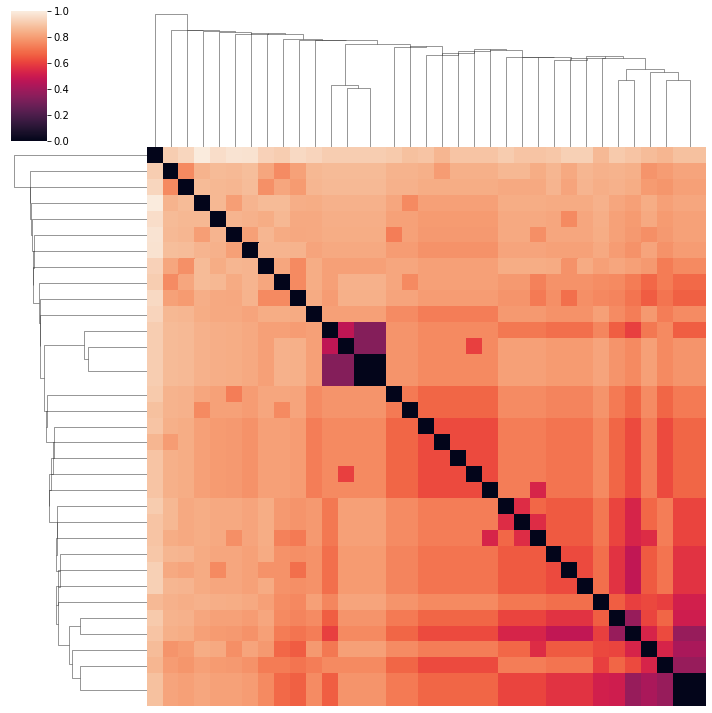

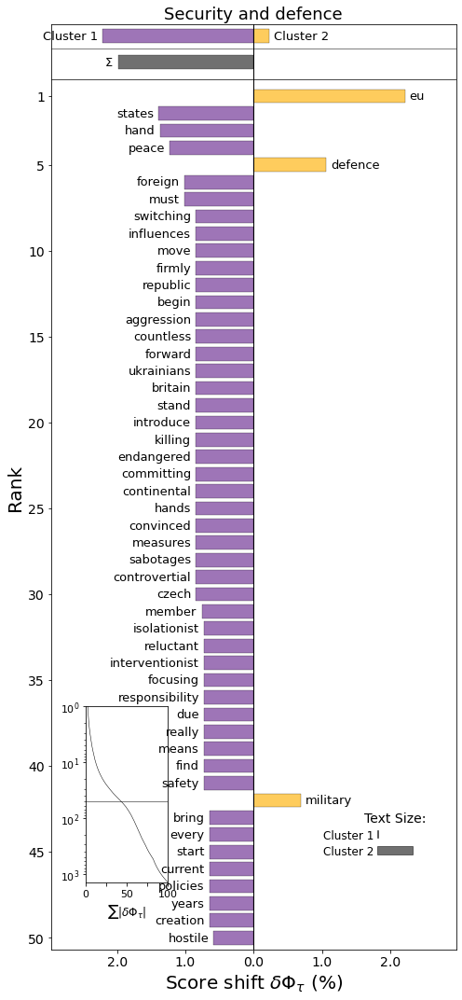

Plot saved to ../plots/CFE/CFE_Security_and_defence_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 33/33...
Final polarisation is 0.26
Plot saved to ../plots/CFE/CFE_Security_and_defence_TreePoldist.png!


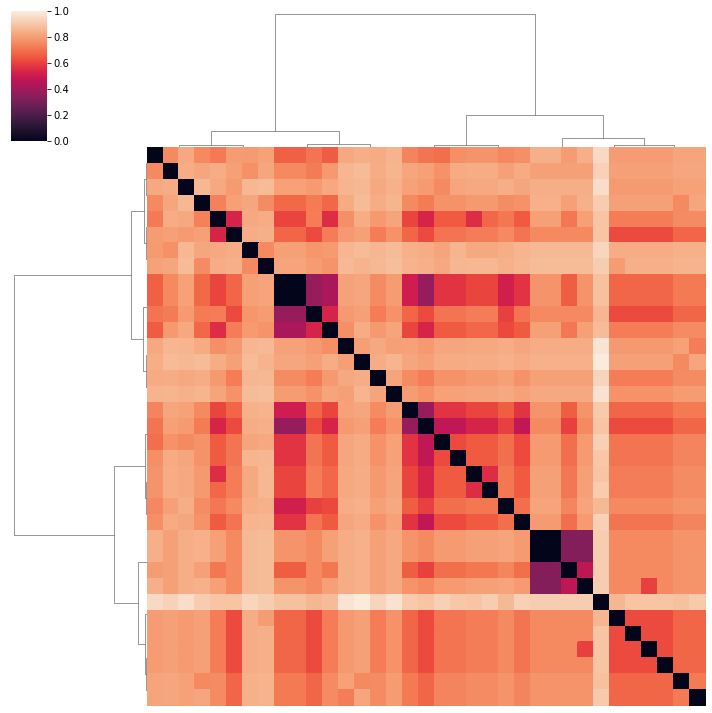

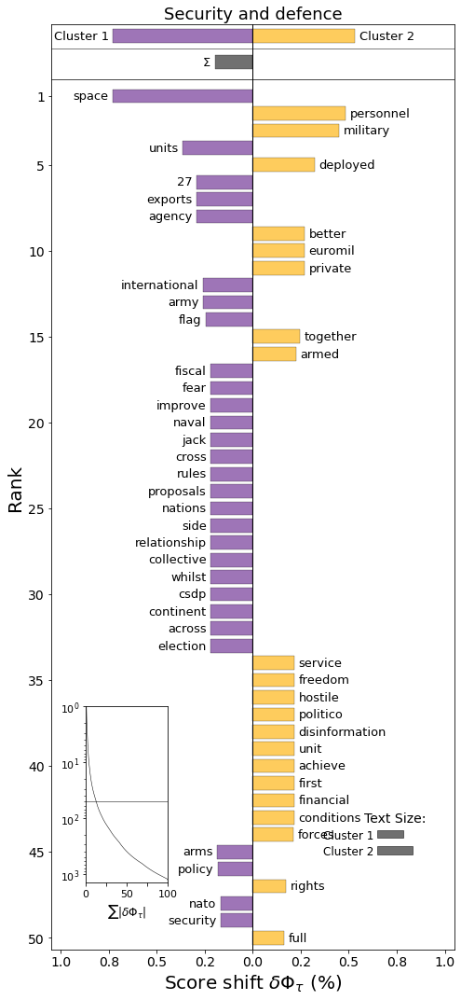

Plot saved to ../plots/CFE/CFE_Security_and_defence_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
Plot saved to ../plots/CFE/CFE_Security_and_defence_PolarisationPoldist.png!


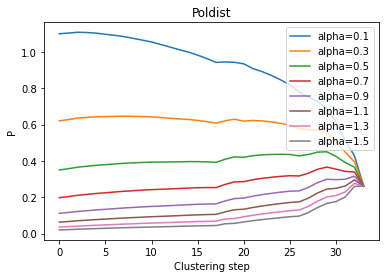

Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
Plot saved to ../plots/CFE/CFE_Security_and_defence_PolarisationCentroid.png!


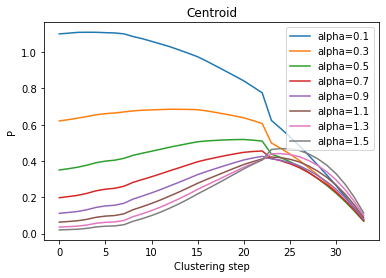

Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
Plot saved to ../plots/CFE/CFE_Security_and_defence_PolarisationWard.png!


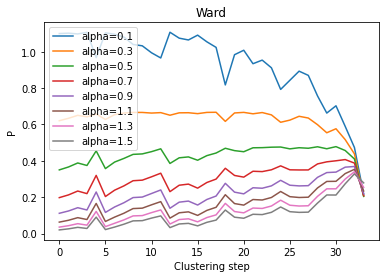

Iteration 33/33...
***** alpha=0.1 *****
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
***** alpha=0.13 *****
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
***** alpha=0.16 *****
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
***** alpha=0.21 *****
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
***** alpha=0.26 *****
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
***** alpha=0.34 *****
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
***** alpha=0.43 *****
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
***** alpha=0.55 *****
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
***** alpha=0.7 *****
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
***** alpha=0.89 *****
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
***** alpha=1.13 *****
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
***** alpha=1.44 *****
Iteration 33/33...
Iteration 33/33...
Iteration 33/33...
***** alpha=1.83 *****


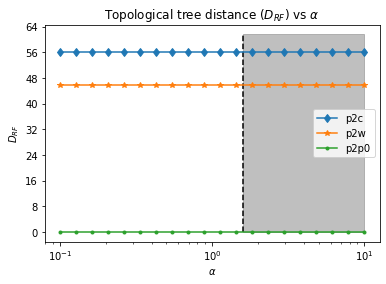

====== Development cooperation ======
Total number of endorsers: 63
Number of unique endorsers: 44
Number of proposals: 18
Plot saved to ../plots/CFE/CFE_Development_cooperation_Net.png!


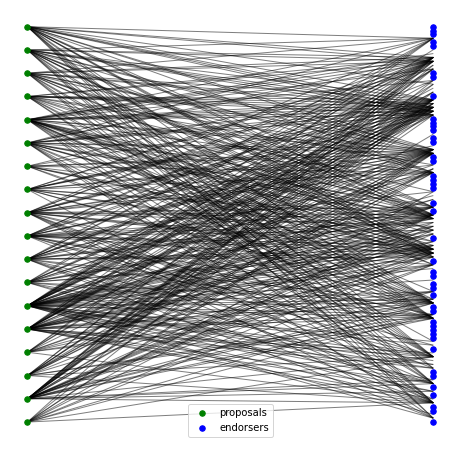

****** WARD ******
Iteration 16/16...
Final polarisation is 0.47
Plot saved to ../plots/CFE/CFE_Development_cooperation_TreeWard.png!


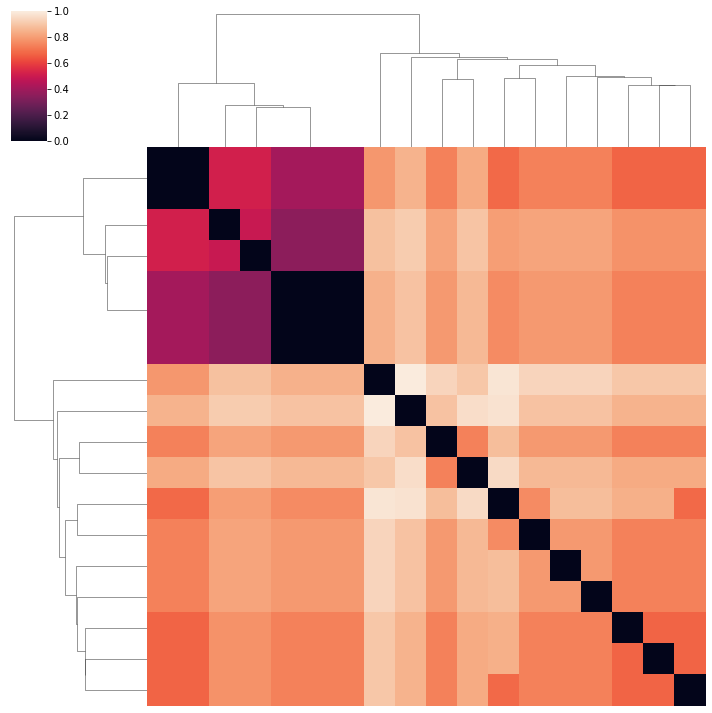

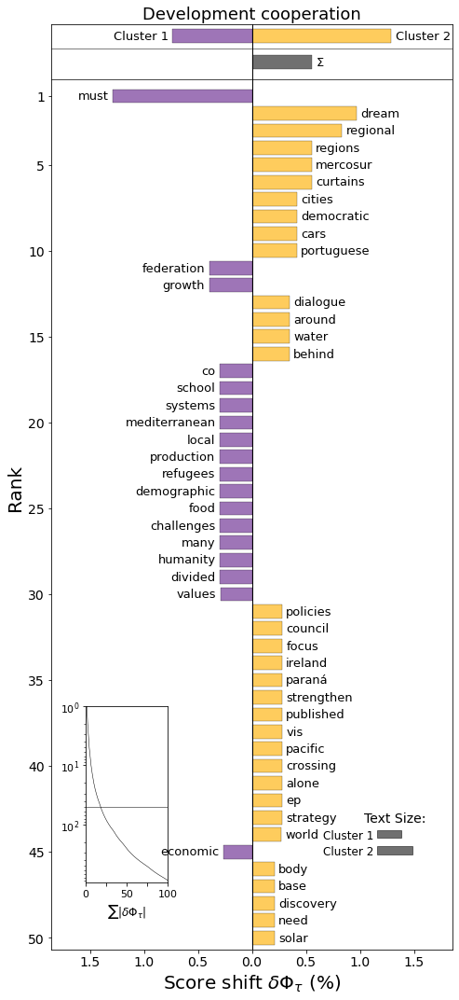

Plot saved to ../plots/CFE/CFE_Development_cooperation_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 16/16...
Final polarisation is 0.16
Plot saved to ../plots/CFE/CFE_Development_cooperation_TreeCentroid.png!


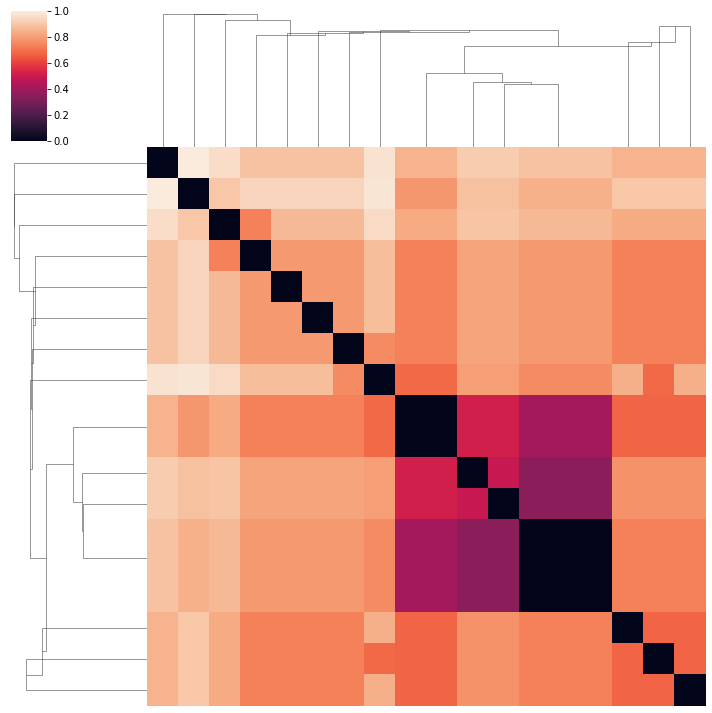

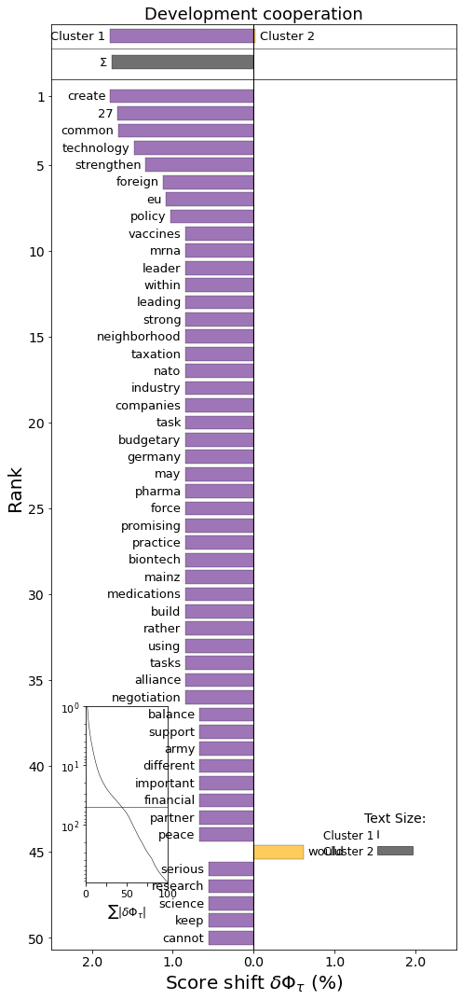

Plot saved to ../plots/CFE/CFE_Development_cooperation_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 16/16...
Final polarisation is 0.44
Plot saved to ../plots/CFE/CFE_Development_cooperation_TreePoldist.png!


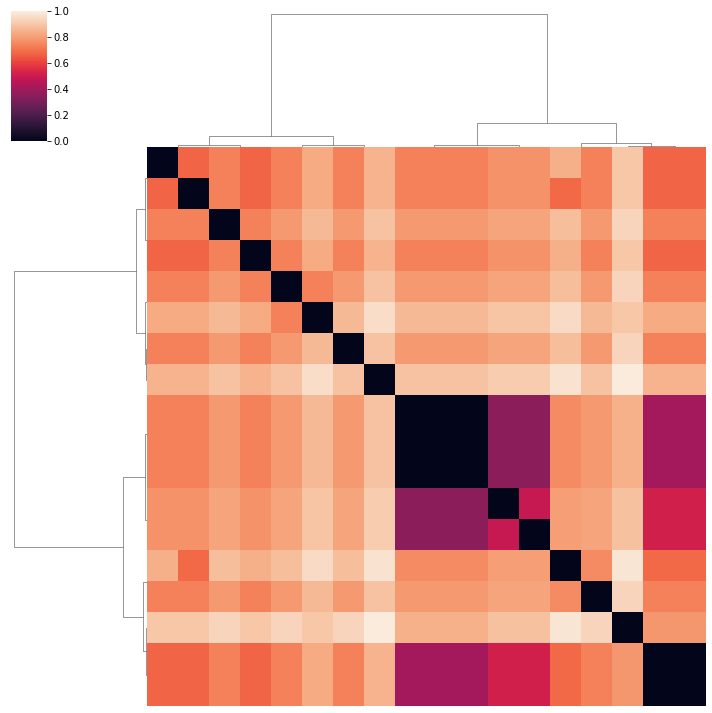

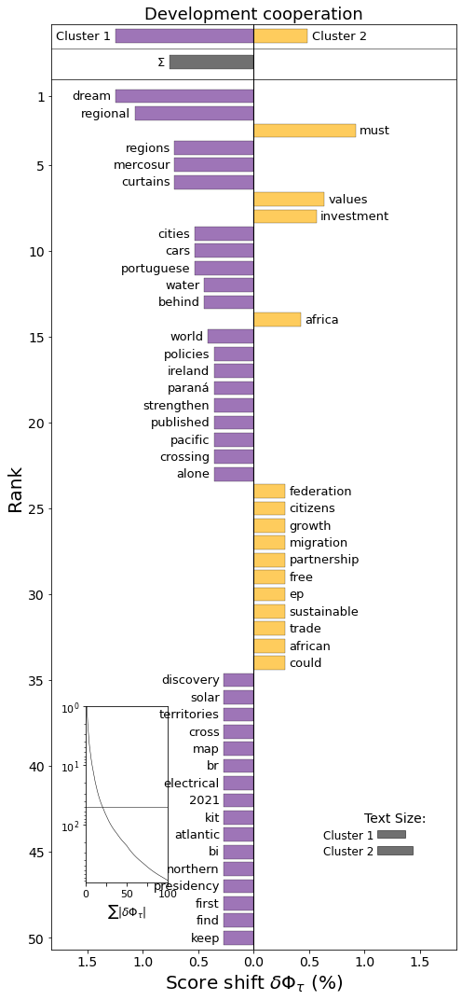

Plot saved to ../plots/CFE/CFE_Development_cooperation_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
Plot saved to ../plots/CFE/CFE_Development_cooperation_PolarisationPoldist.png!


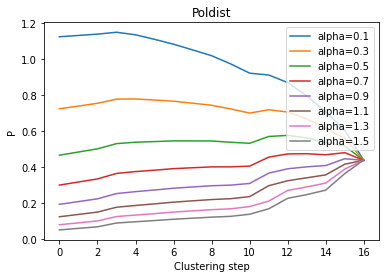

Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
Plot saved to ../plots/CFE/CFE_Development_cooperation_PolarisationCentroid.png!


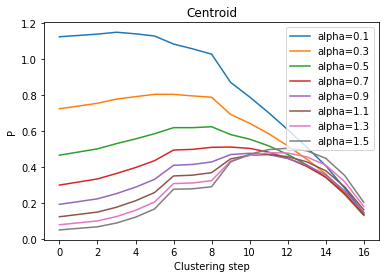

Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
Plot saved to ../plots/CFE/CFE_Development_cooperation_PolarisationWard.png!


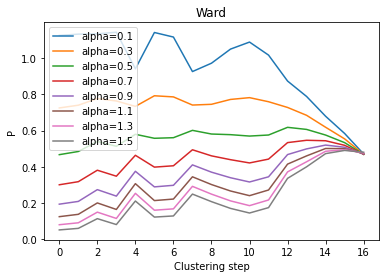

Iteration 16/16...
***** alpha=0.1 *****
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
***** alpha=0.13 *****
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
***** alpha=0.16 *****
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
***** alpha=0.21 *****
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
***** alpha=0.26 *****
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
***** alpha=0.34 *****
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
***** alpha=0.43 *****
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
***** alpha=0.55 *****
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
***** alpha=0.7 *****
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
***** alpha=0.89 *****
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
***** alpha=1.13 *****
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
***** alpha=1.44 *****
Iteration 16/16...
Iteration 16/16...
Iteration 16/16...
***** alpha=1.83 *****


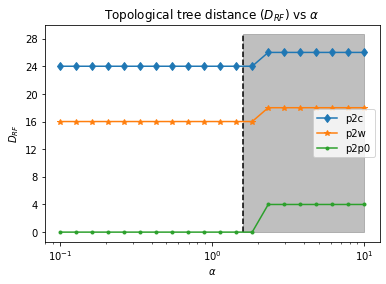

====== Foreign policy ======
Total number of endorsers: 907
Number of unique endorsers: 532
Number of proposals: 60
Plot saved to ../plots/CFE/CFE_Foreign_policy_Net.png!


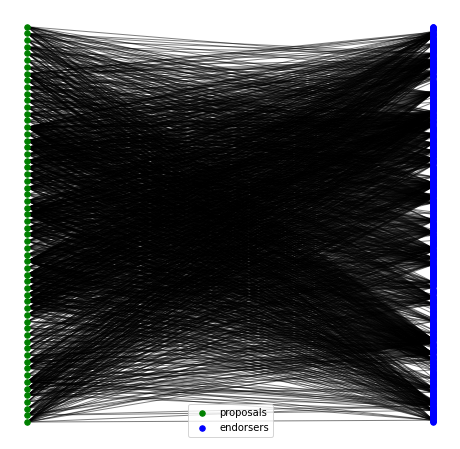

****** WARD ******
Iteration 58/58...
Final polarisation is 0.24
Plot saved to ../plots/CFE/CFE_Foreign_policy_TreeWard.png!


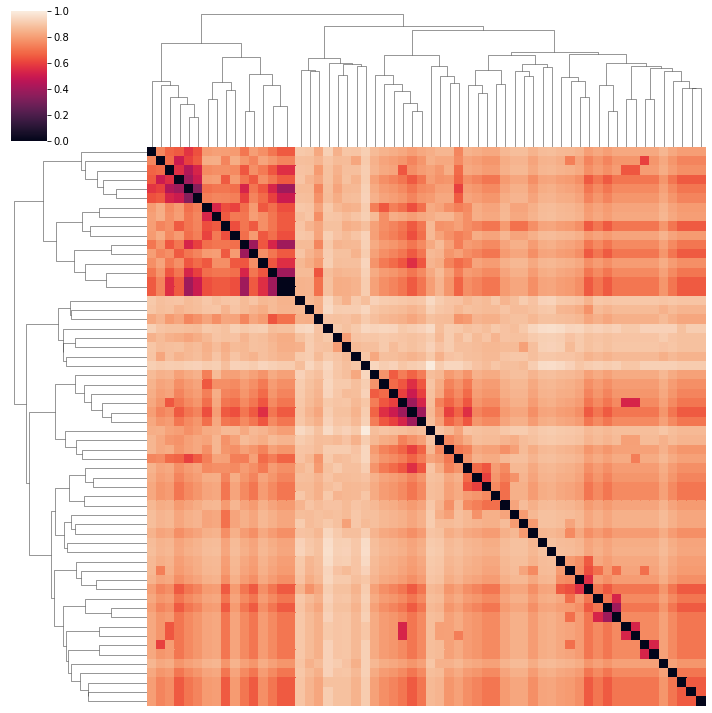

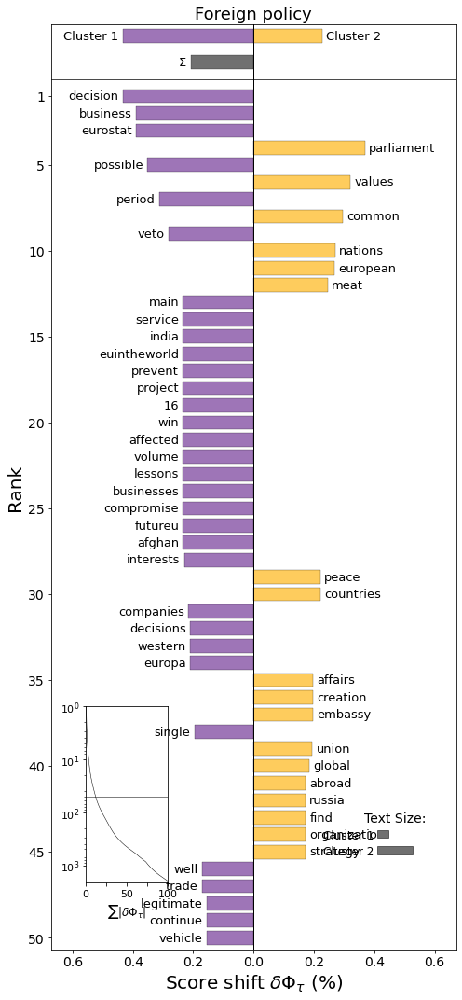

Plot saved to ../plots/CFE/CFE_Foreign_policy_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 58/58...
Final polarisation is 0.05
Plot saved to ../plots/CFE/CFE_Foreign_policy_TreeCentroid.png!


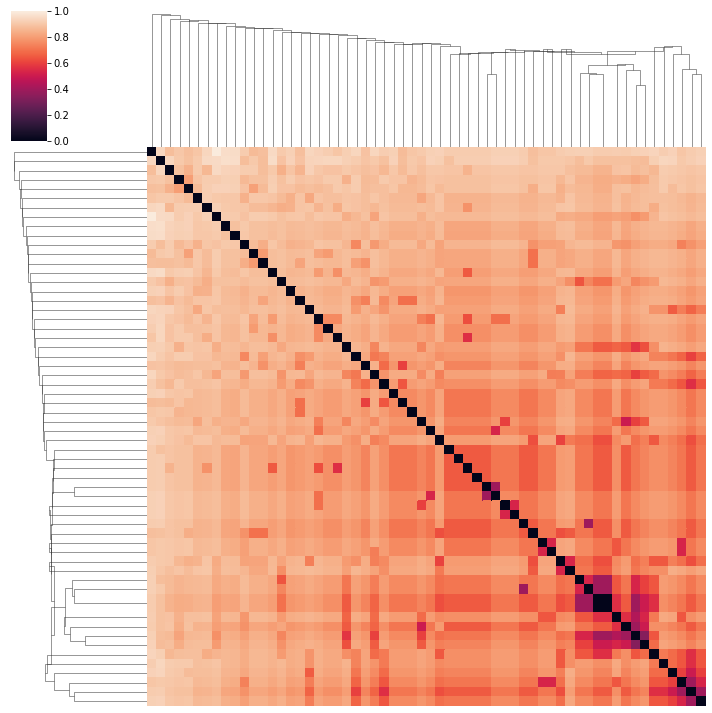

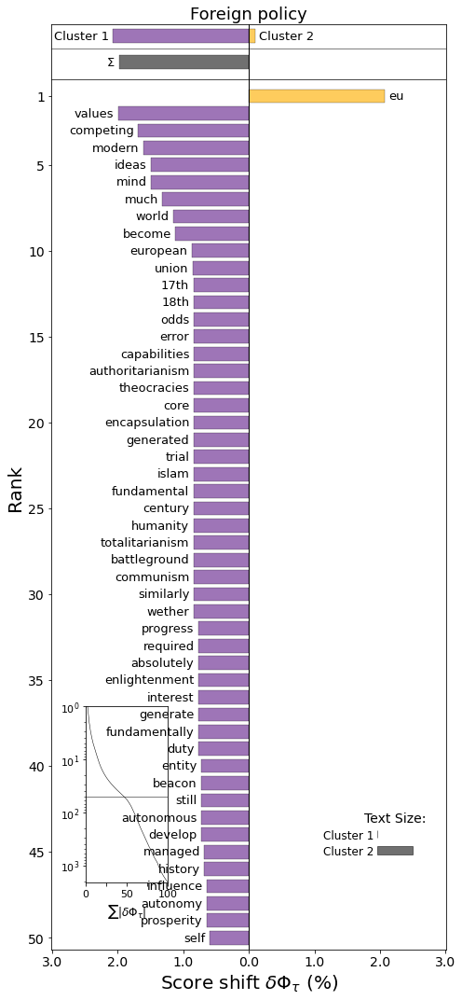

Plot saved to ../plots/CFE/CFE_Foreign_policy_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 58/58...
Final polarisation is 0.26
Plot saved to ../plots/CFE/CFE_Foreign_policy_TreePoldist.png!


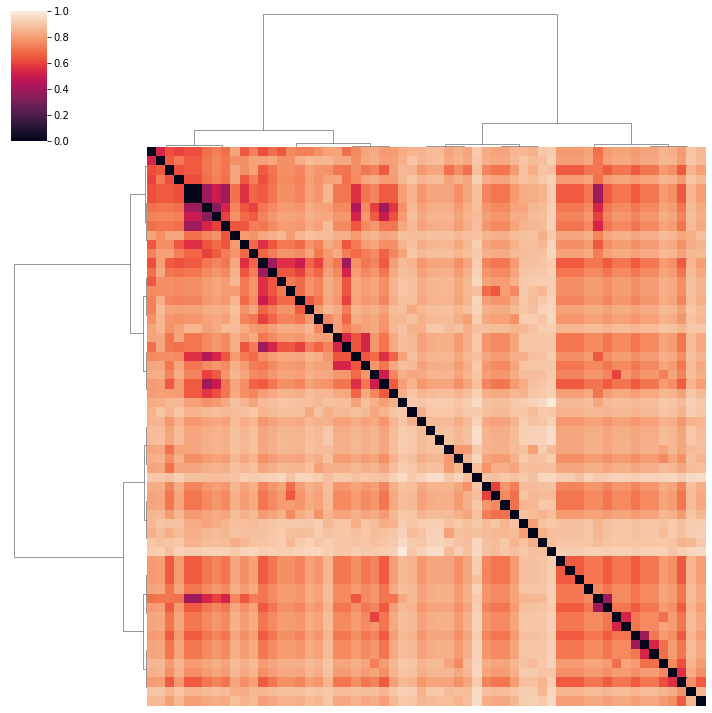

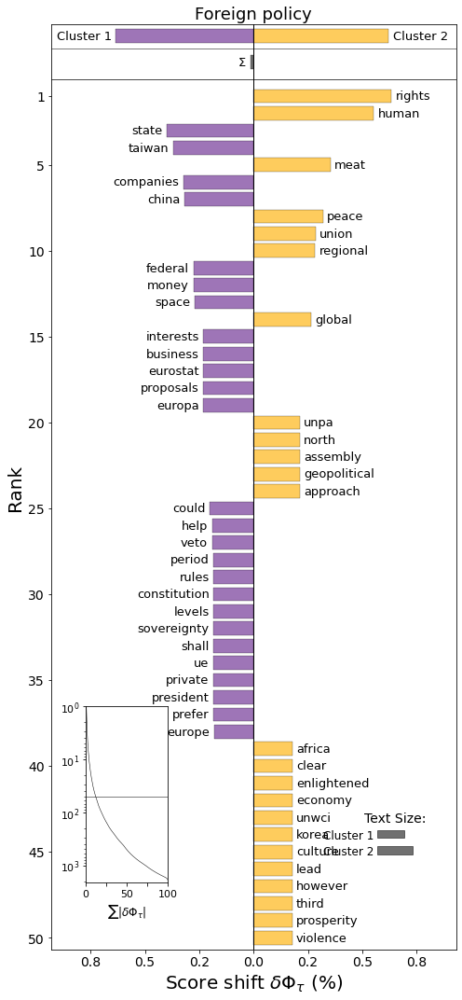

Plot saved to ../plots/CFE/CFE_Foreign_policy_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Plot saved to ../plots/CFE/CFE_Foreign_policy_PolarisationPoldist.png!


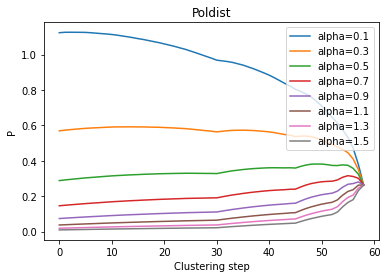

Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Plot saved to ../plots/CFE/CFE_Foreign_policy_PolarisationCentroid.png!


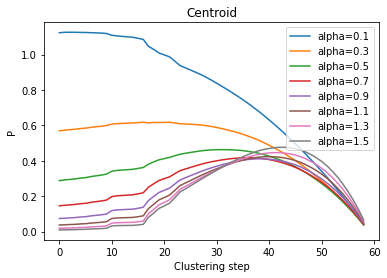

Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
Plot saved to ../plots/CFE/CFE_Foreign_policy_PolarisationWard.png!


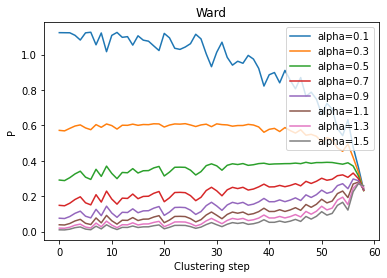

Iteration 58/58...
***** alpha=0.1 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=0.13 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=0.16 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=0.21 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=0.26 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=0.34 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=0.43 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=0.55 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=0.7 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=0.89 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=1.13 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=1.44 *****
Iteration 58/58...
Iteration 58/58...
Iteration 58/58...
***** alpha=1.83 *****


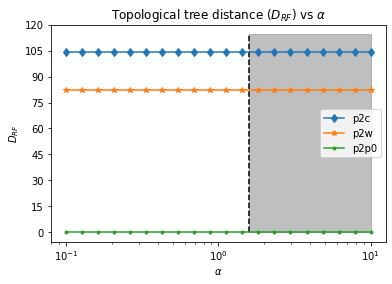

====== Neighbourhood policy and enlarging the European Union ======
Total number of endorsers: 308
Number of unique endorsers: 235
Number of proposals: 28
Plot saved to ../plots/CFE/CFE_Neighbourhood_policy_and_enlarging_the_European_Union_Net.png!


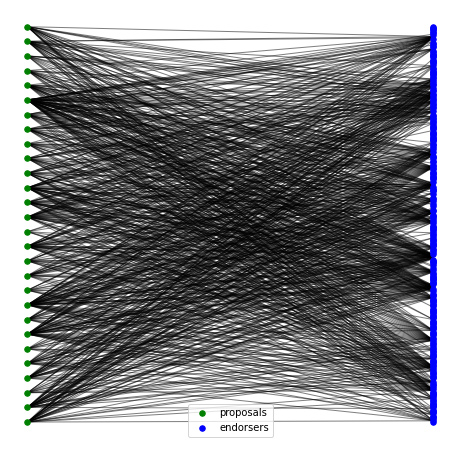

****** WARD ******
Iteration 26/26...
Final polarisation is 0.32
Plot saved to ../plots/CFE/CFE_Neighbourhood_policy_and_enlarging_the_European_Union_TreeWard.png!


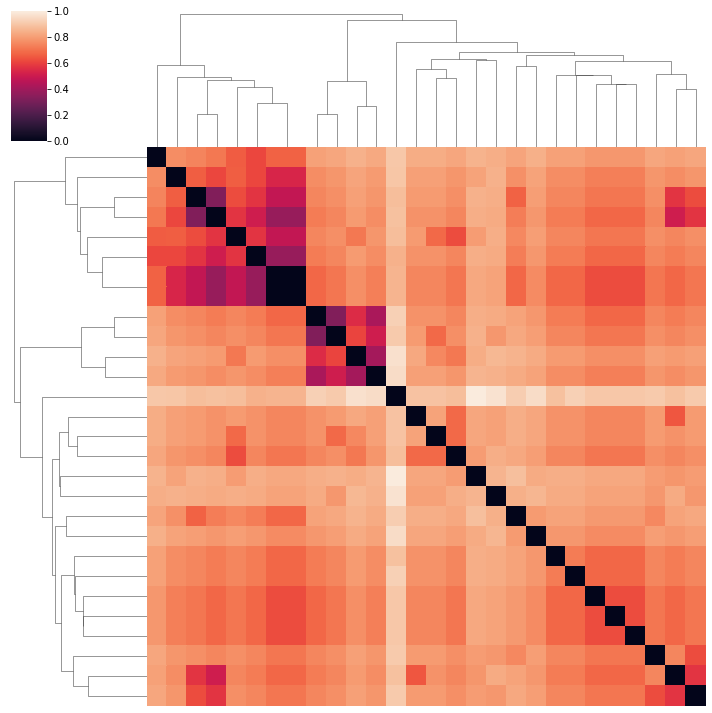

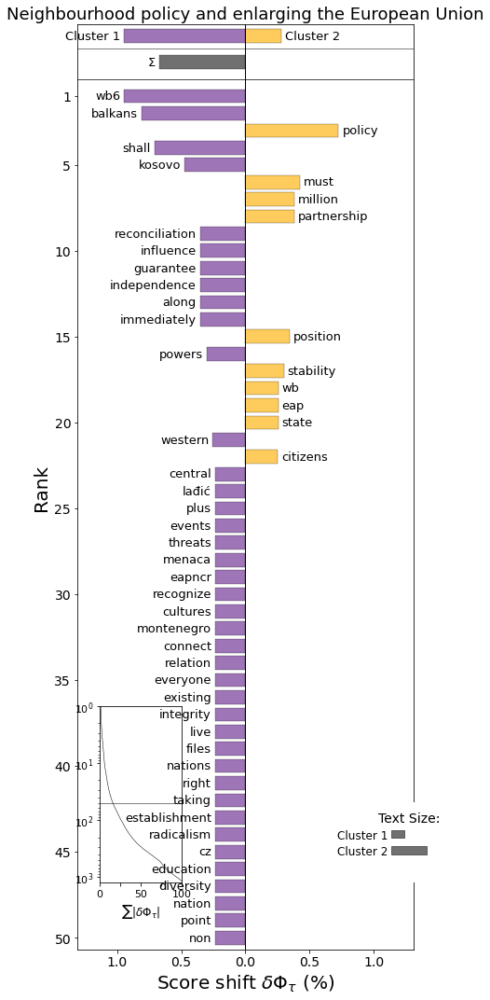

Plot saved to ../plots/CFE/CFE_Neighbourhood_policy_and_enlarging_the_European_Union_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 26/26...
Final polarisation is 0.1
Plot saved to ../plots/CFE/CFE_Neighbourhood_policy_and_enlarging_the_European_Union_TreeCentroid.png!


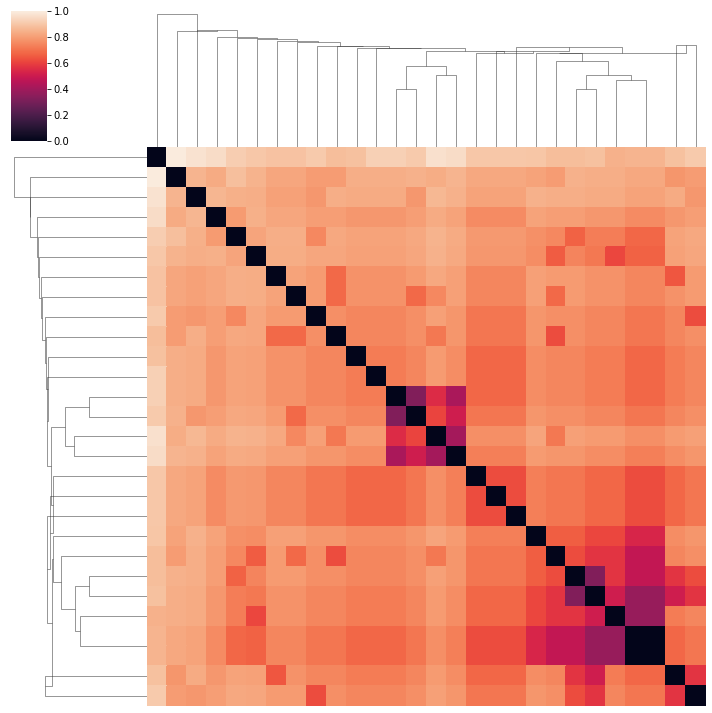

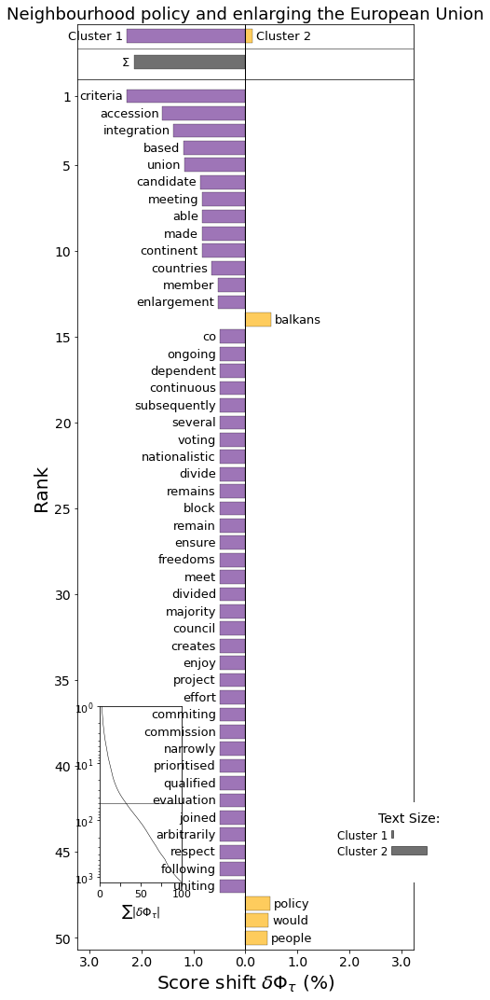

Plot saved to ../plots/CFE/CFE_Neighbourhood_policy_and_enlarging_the_European_Union_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 26/26...
Final polarisation is 0.3
Plot saved to ../plots/CFE/CFE_Neighbourhood_policy_and_enlarging_the_European_Union_TreePoldist.png!


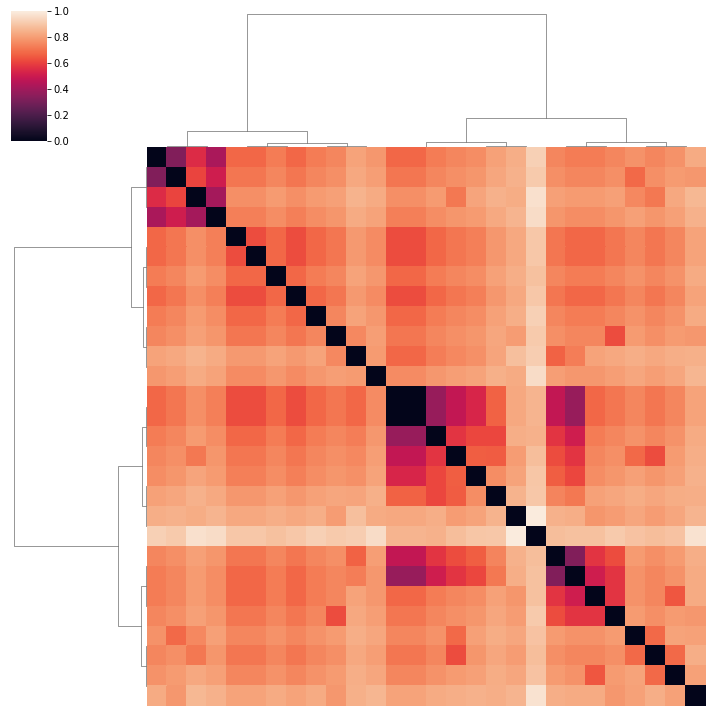

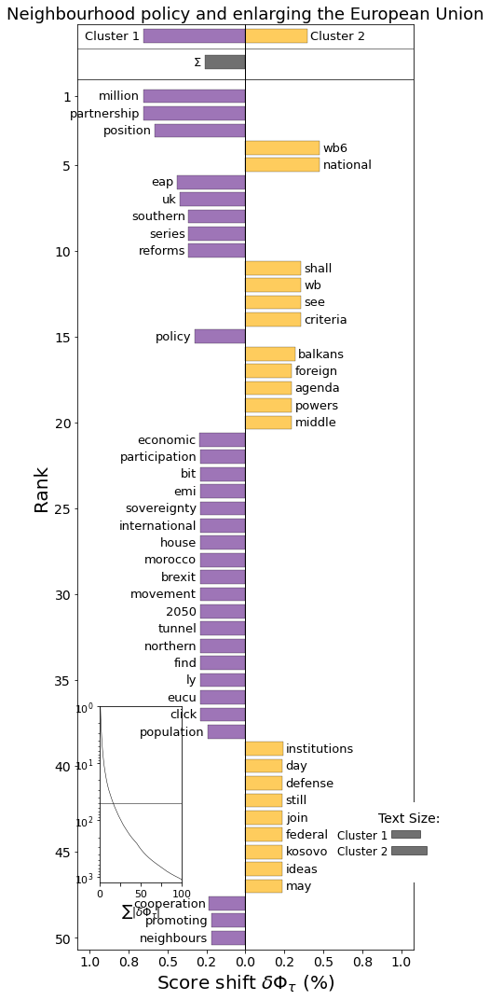

Plot saved to ../plots/CFE/CFE_Neighbourhood_policy_and_enlarging_the_European_Union_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
Plot saved to ../plots/CFE/CFE_Neighbourhood_policy_and_enlarging_the_European_Union_PolarisationPoldist.png!


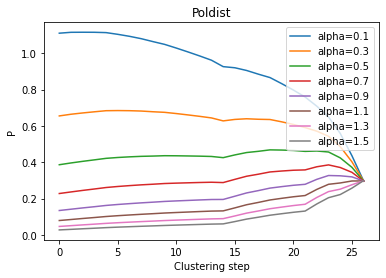

Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
Plot saved to ../plots/CFE/CFE_Neighbourhood_policy_and_enlarging_the_European_Union_PolarisationCentroid.png!


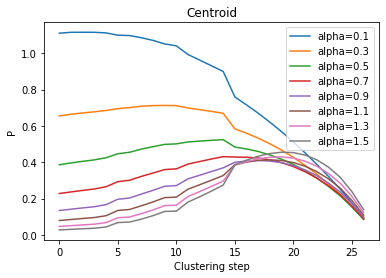

Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
Plot saved to ../plots/CFE/CFE_Neighbourhood_policy_and_enlarging_the_European_Union_PolarisationWard.png!


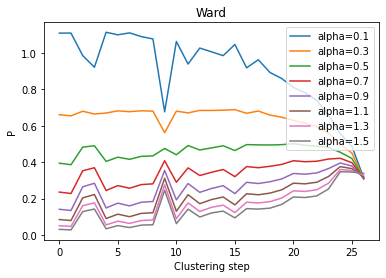

Iteration 26/26...
***** alpha=0.1 *****
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
***** alpha=0.13 *****
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
***** alpha=0.16 *****
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
***** alpha=0.21 *****
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
***** alpha=0.26 *****
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
***** alpha=0.34 *****
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
***** alpha=0.43 *****
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
***** alpha=0.55 *****
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
***** alpha=0.7 *****
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
***** alpha=0.89 *****
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
***** alpha=1.13 *****
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
***** alpha=1.44 *****
Iteration 26/26...
Iteration 26/26...
Iteration 26/26...
***** alpha=1.83 *****


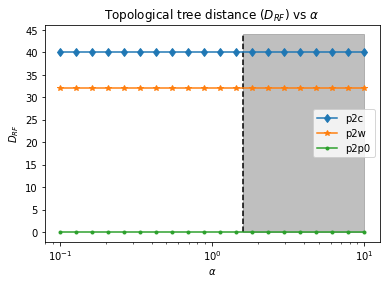

====== Trade policy ======
Total number of endorsers: 68
Number of unique endorsers: 65
Number of proposals: 10
Plot saved to ../plots/CFE/CFE_Trade_policy_Net.png!


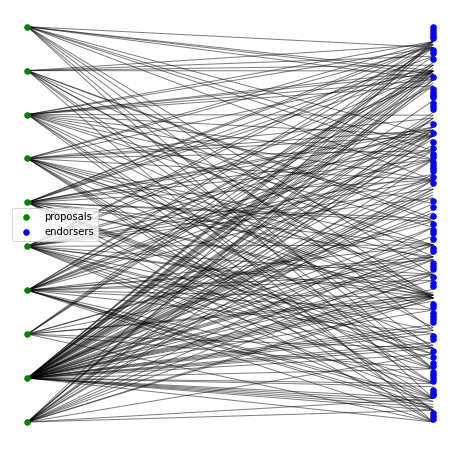

****** WARD ******
Iteration 8/8...
Final polarisation is 0.51
Plot saved to ../plots/CFE/CFE_Trade_policy_TreeWard.png!


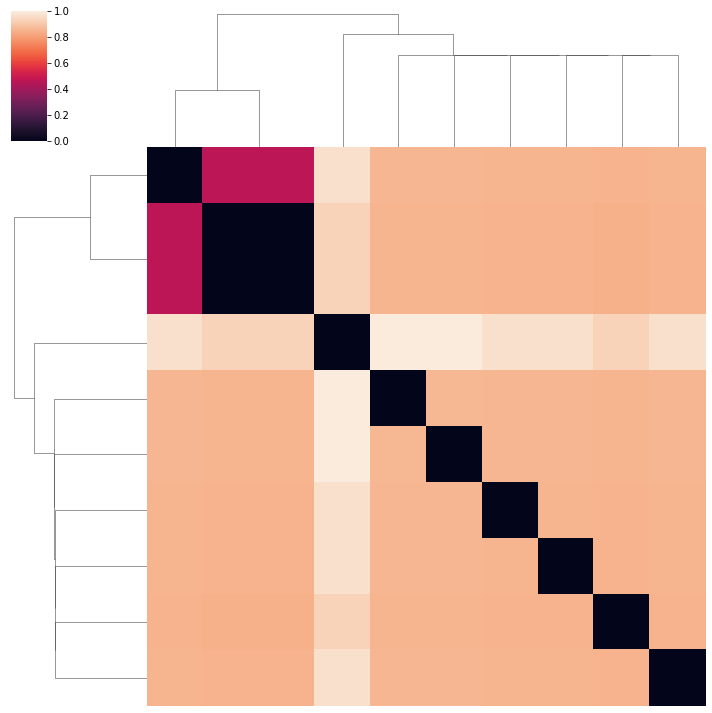

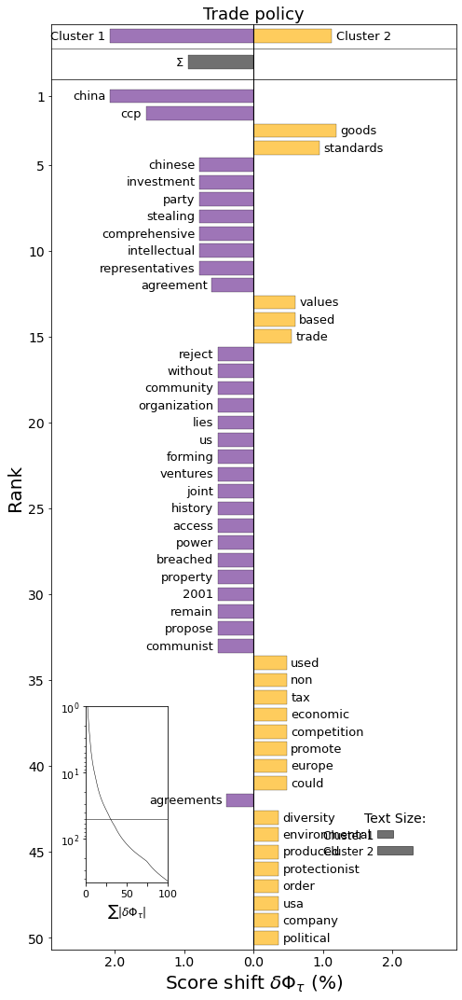

Plot saved to ../plots/CFE/CFE_Trade_policy_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 8/8...
Final polarisation is 0.29
Plot saved to ../plots/CFE/CFE_Trade_policy_TreeCentroid.png!


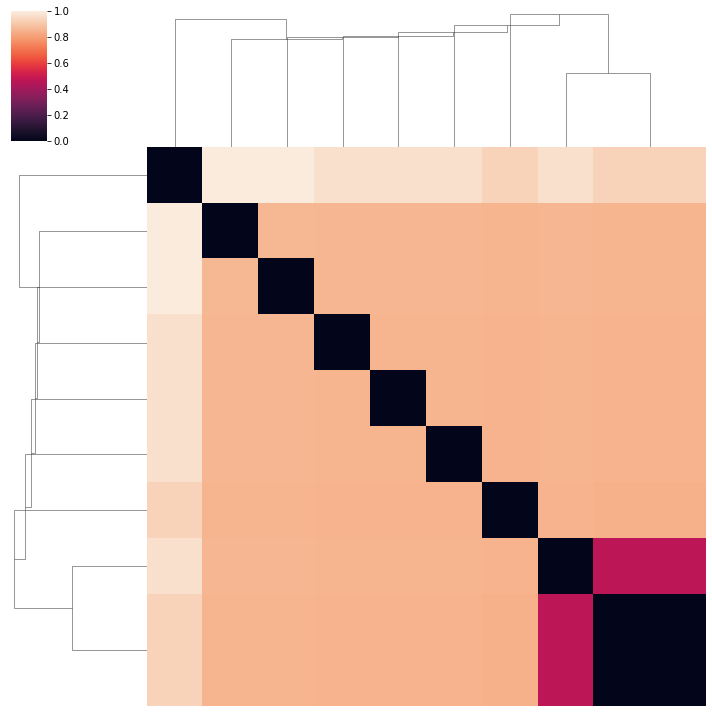

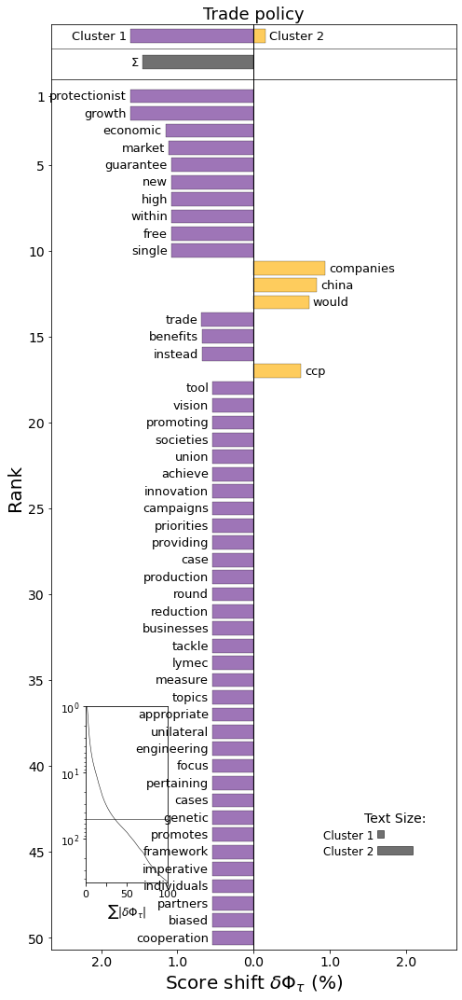

Plot saved to ../plots/CFE/CFE_Trade_policy_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 8/8...
Final polarisation is 0.49
Plot saved to ../plots/CFE/CFE_Trade_policy_TreePoldist.png!


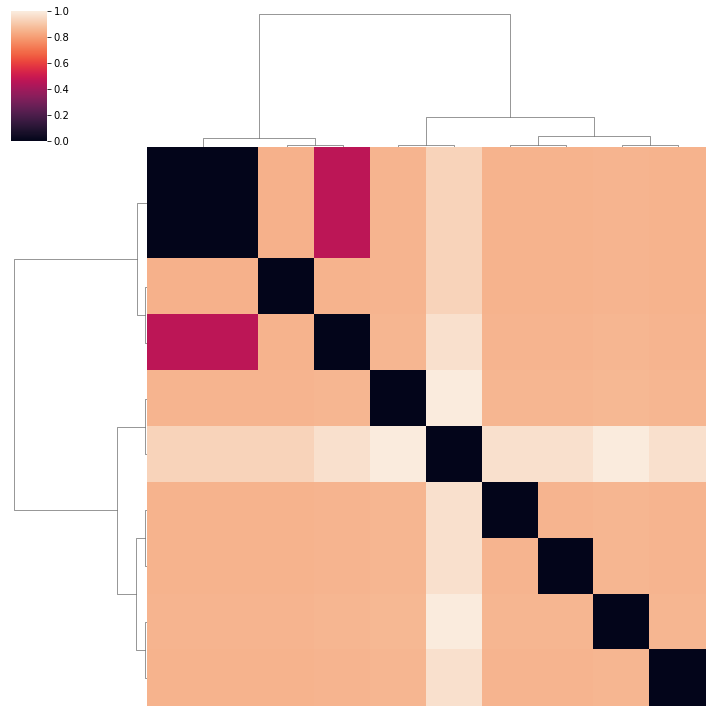

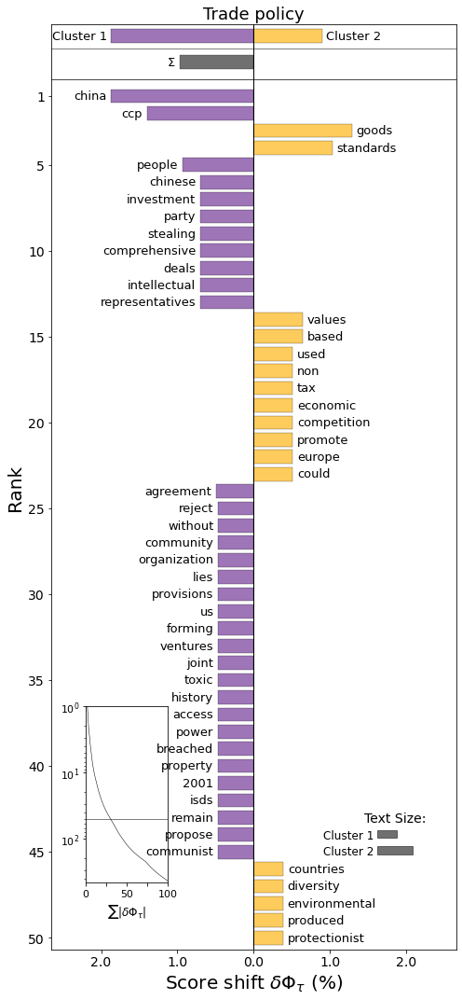

Plot saved to ../plots/CFE/CFE_Trade_policy_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Plot saved to ../plots/CFE/CFE_Trade_policy_PolarisationPoldist.png!


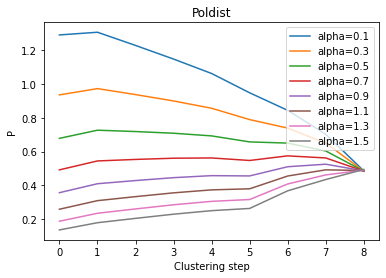

Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Plot saved to ../plots/CFE/CFE_Trade_policy_PolarisationCentroid.png!


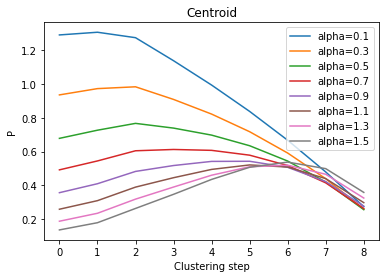

Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Plot saved to ../plots/CFE/CFE_Trade_policy_PolarisationWard.png!


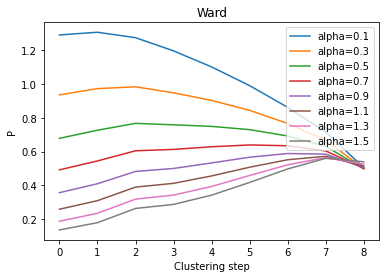

Iteration 8/8...
***** alpha=0.1 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=0.13 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=0.16 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=0.21 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=0.26 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=0.34 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=0.43 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=0.55 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=0.7 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=0.89 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=1.13 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=1.44 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=1.83 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=2.34 *****


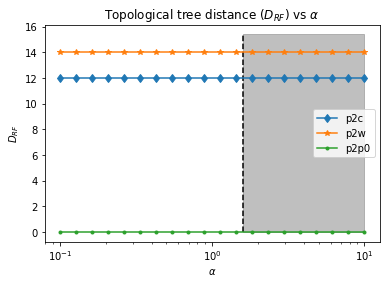

====== Humanitarian aid and civil protection ======
Total number of endorsers: 14
Number of unique endorsers: 11
Number of proposals: 4
Plot saved to ../plots/CFE/CFE_Humanitarian_aid_and_civil_protection_Net.png!


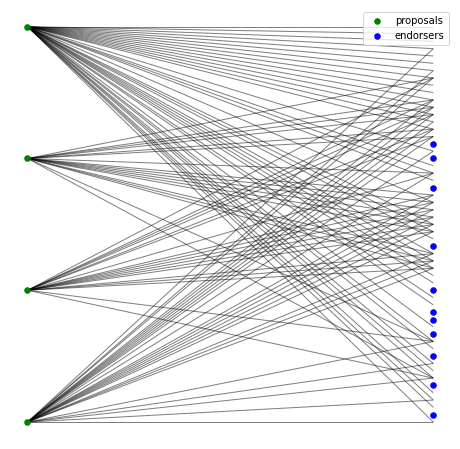

****** WARD ******
Iteration 2/2...
Final polarisation is 0.71
Plot saved to ../plots/CFE/CFE_Humanitarian_aid_and_civil_protection_TreeWard.png!


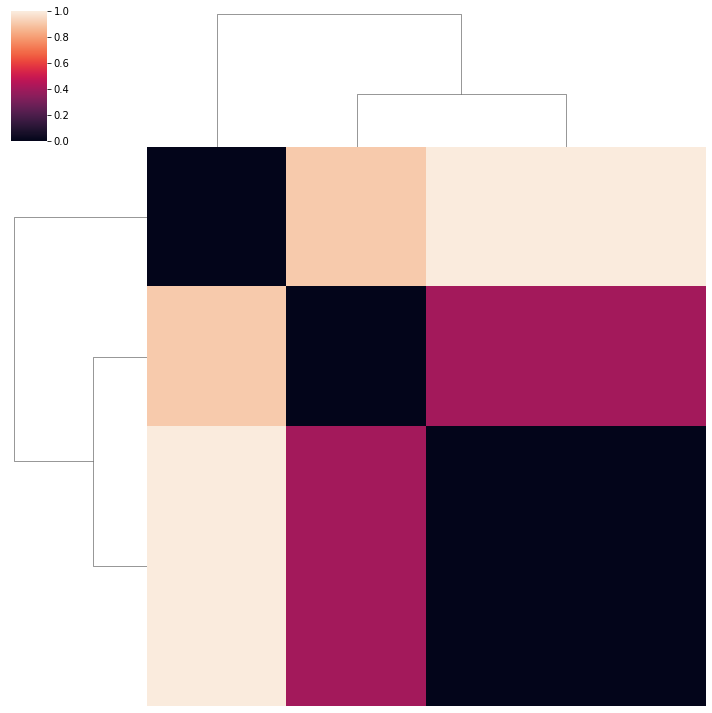

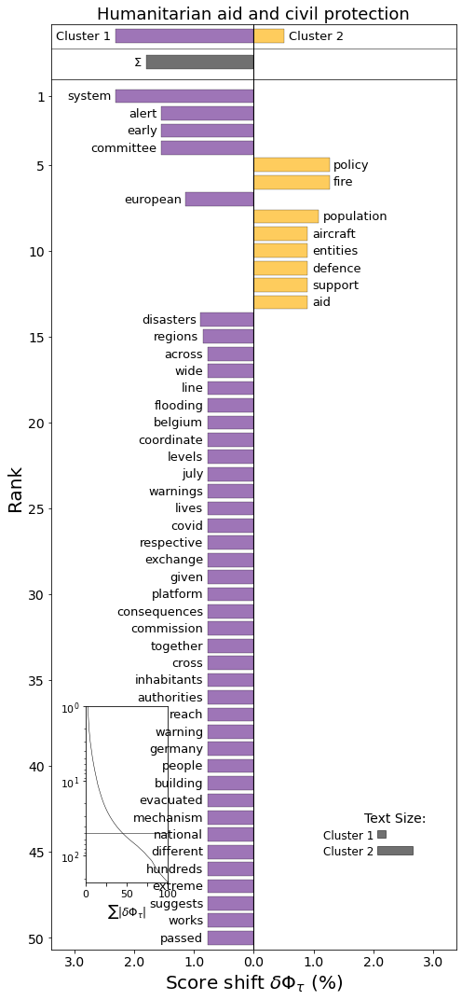

Plot saved to ../plots/CFE/CFE_Humanitarian_aid_and_civil_protection_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 2/2...
Final polarisation is 0.71
Plot saved to ../plots/CFE/CFE_Humanitarian_aid_and_civil_protection_TreeCentroid.png!


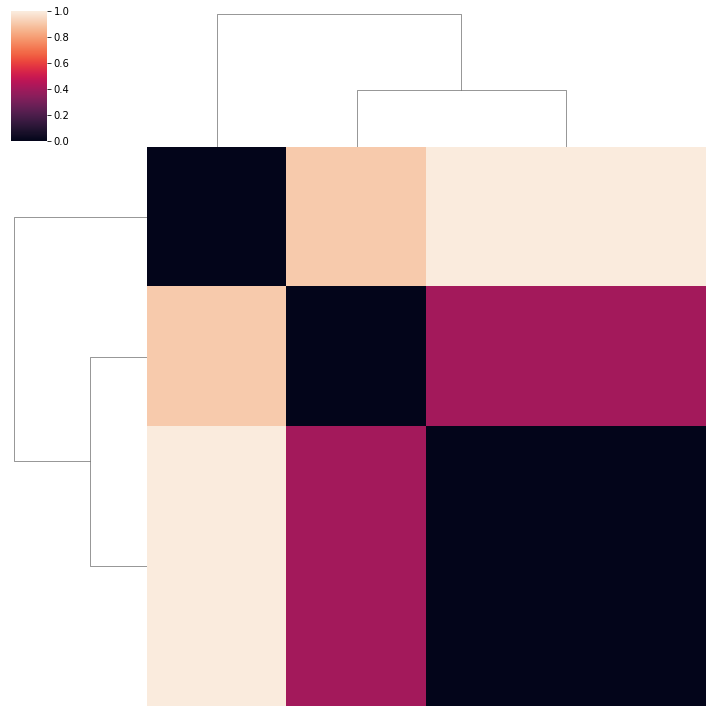

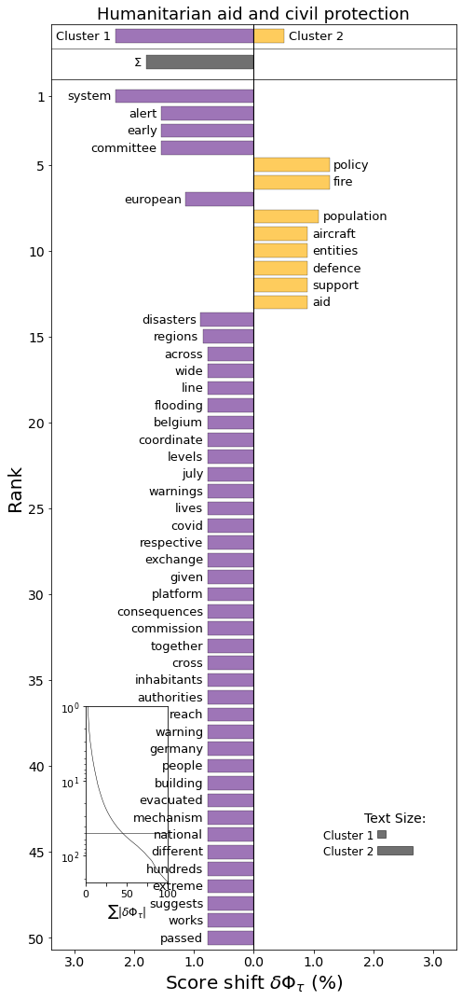

Plot saved to ../plots/CFE/CFE_Humanitarian_aid_and_civil_protection_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 2/2...
Final polarisation is 0.61
Plot saved to ../plots/CFE/CFE_Humanitarian_aid_and_civil_protection_TreePoldist.png!


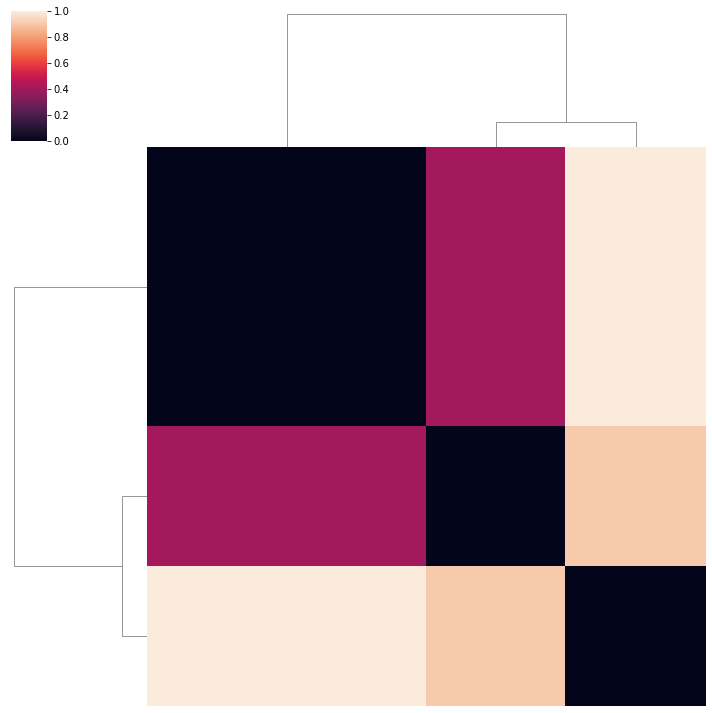

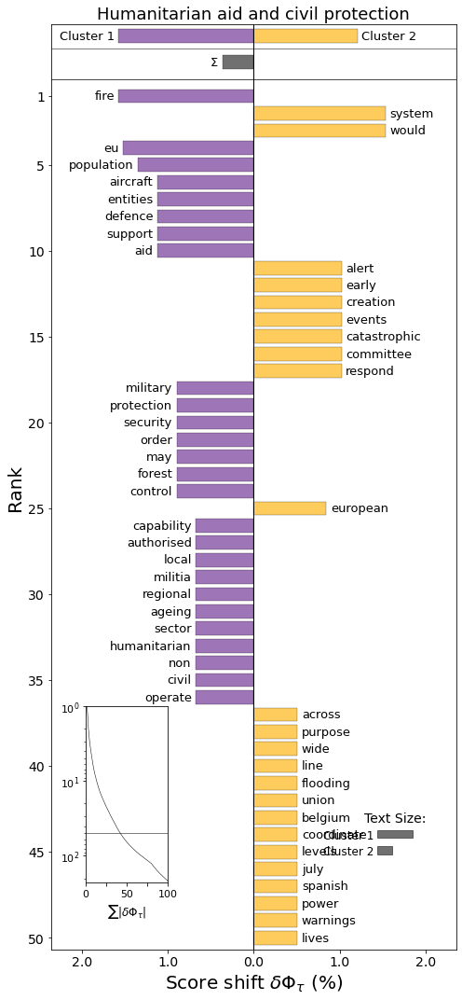

Plot saved to ../plots/CFE/CFE_Humanitarian_aid_and_civil_protection_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
Plot saved to ../plots/CFE/CFE_Humanitarian_aid_and_civil_protection_PolarisationPoldist.png!


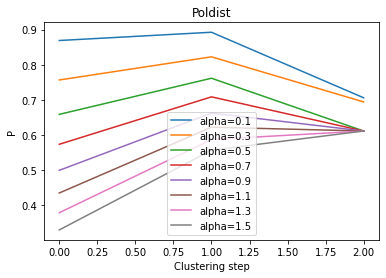

Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
Plot saved to ../plots/CFE/CFE_Humanitarian_aid_and_civil_protection_PolarisationCentroid.png!


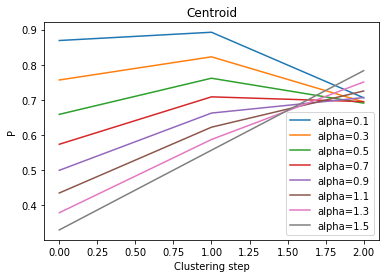

Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
Plot saved to ../plots/CFE/CFE_Humanitarian_aid_and_civil_protection_PolarisationWard.png!


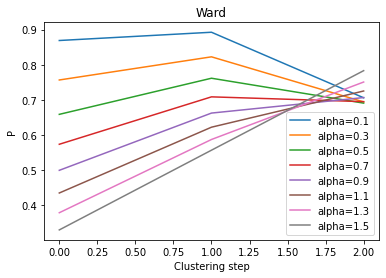

Iteration 2/2...
***** alpha=0.1 *****
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
***** alpha=0.13 *****
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
***** alpha=0.16 *****
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
***** alpha=0.21 *****
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
***** alpha=0.26 *****
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
***** alpha=0.34 *****
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
***** alpha=0.43 *****
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
***** alpha=0.55 *****
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
***** alpha=0.7 *****
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
***** alpha=0.89 *****
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
***** alpha=1.13 *****
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
***** alpha=1.44 *****
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
***** alpha=1.83 *****
Iteration 2/2...
Iteration 2/2...
Iteration 2/2...
***** alpha=2.34 *****


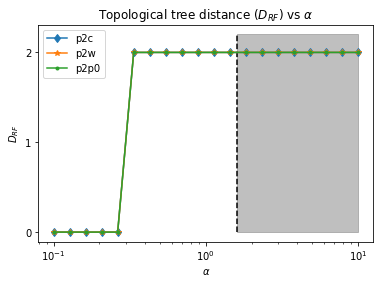

====== Legal migration and integration ======
Total number of endorsers: 138
Number of unique endorsers: 90
Number of proposals: 25
Plot saved to ../plots/CFE/CFE_Legal_migration_and_integration_Net.png!


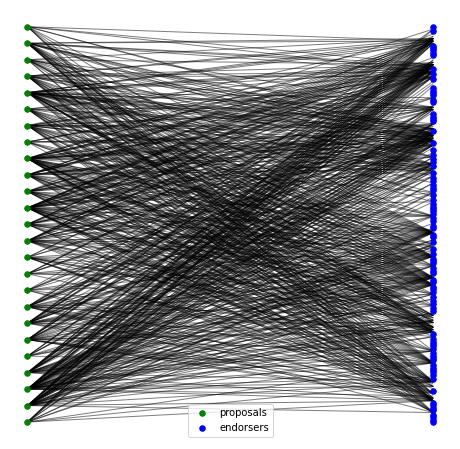

****** WARD ******
Iteration 23/23...
Final polarisation is 0.32
Plot saved to ../plots/CFE/CFE_Legal_migration_and_integration_TreeWard.png!


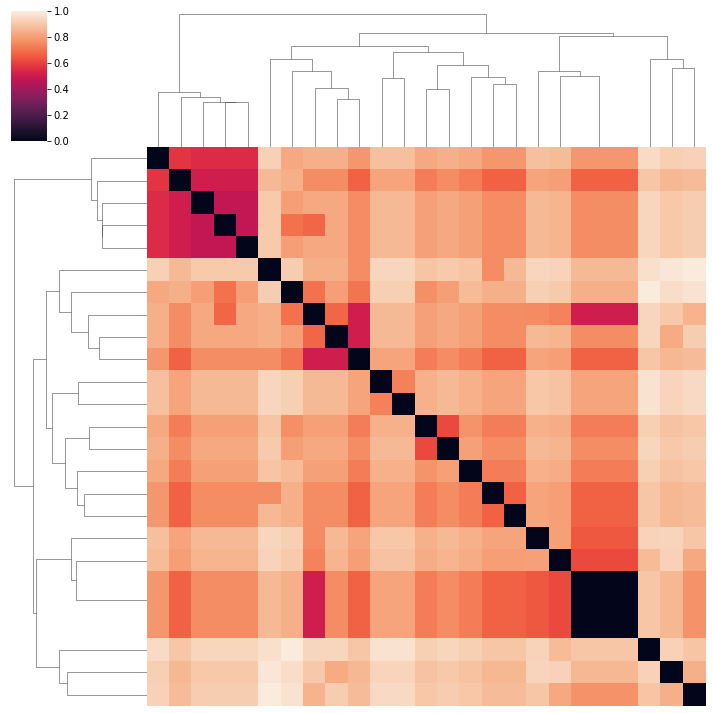

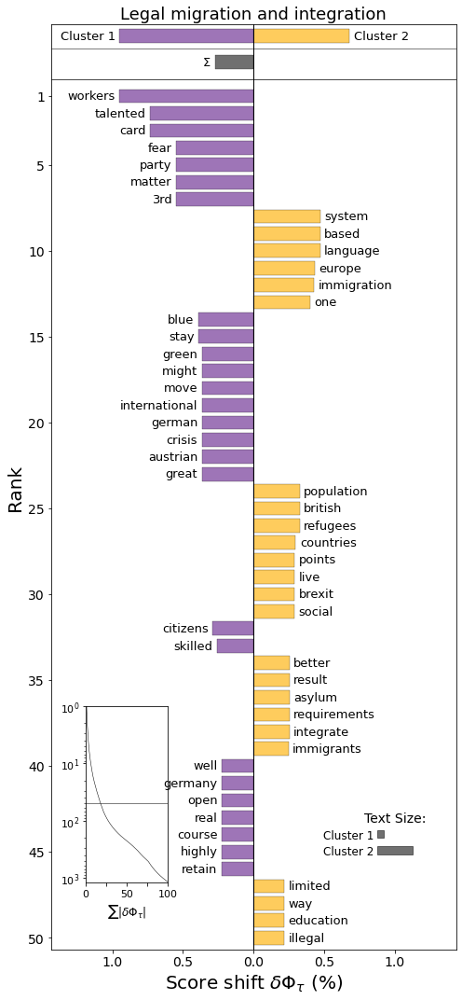

Plot saved to ../plots/CFE/CFE_Legal_migration_and_integration_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 23/23...
Final polarisation is 0.11
Plot saved to ../plots/CFE/CFE_Legal_migration_and_integration_TreeCentroid.png!


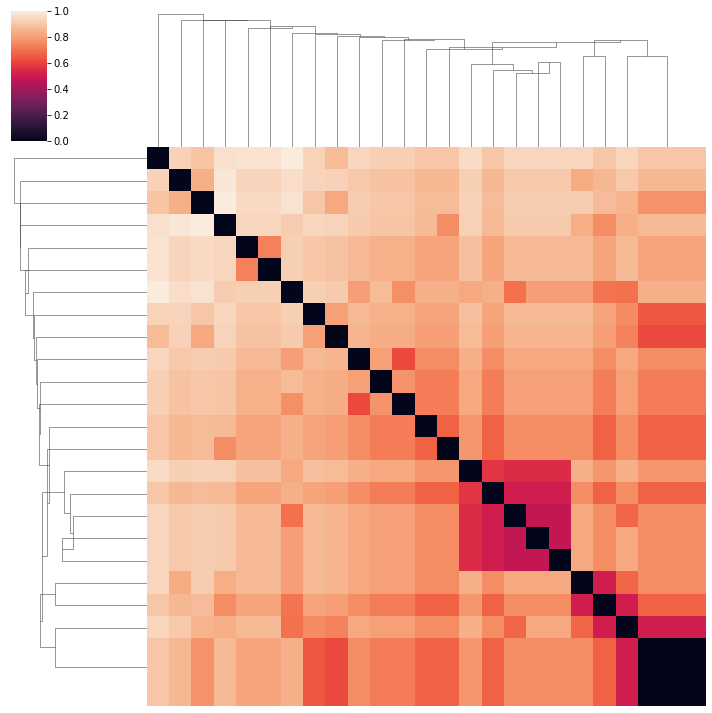

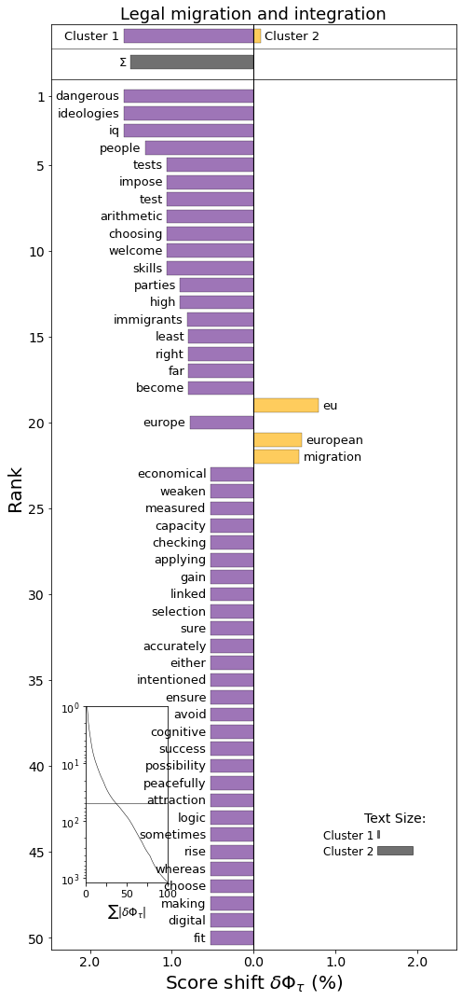

Plot saved to ../plots/CFE/CFE_Legal_migration_and_integration_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 23/23...
Final polarisation is 0.3
Plot saved to ../plots/CFE/CFE_Legal_migration_and_integration_TreePoldist.png!


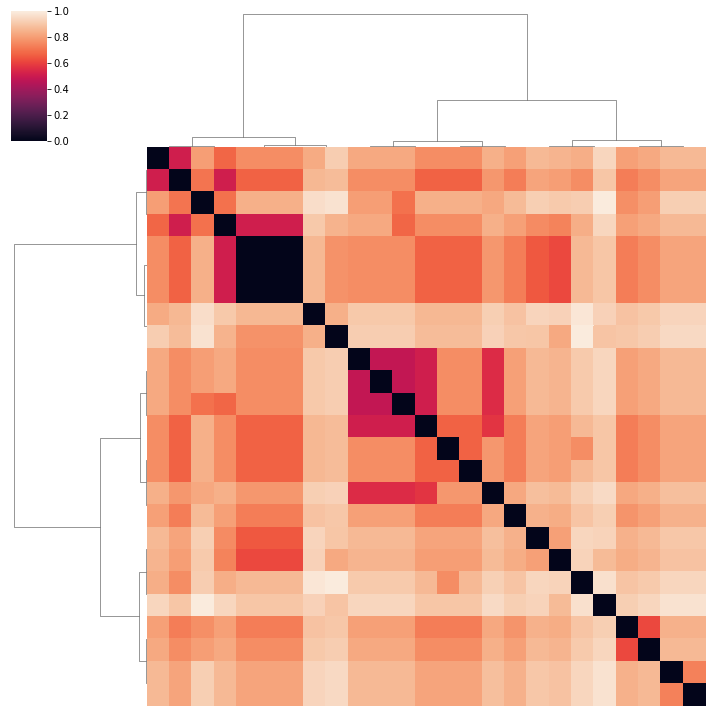

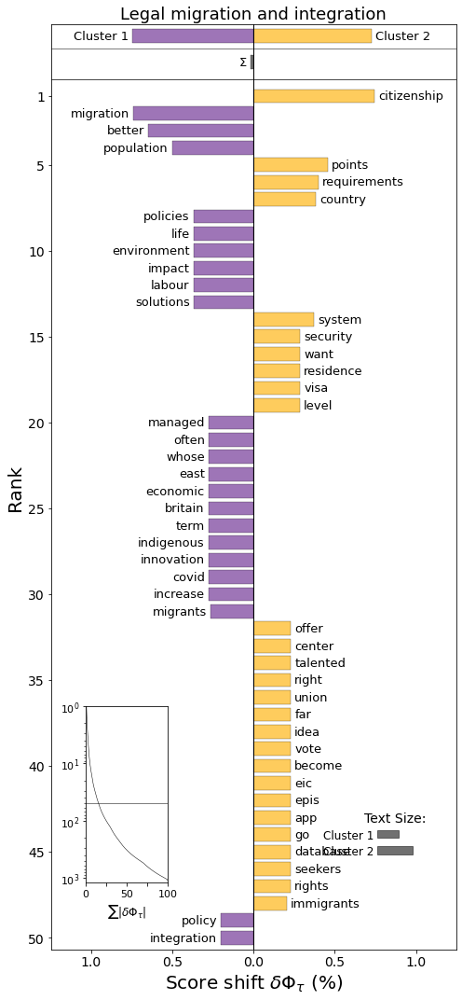

Plot saved to ../plots/CFE/CFE_Legal_migration_and_integration_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
Plot saved to ../plots/CFE/CFE_Legal_migration_and_integration_PolarisationPoldist.png!


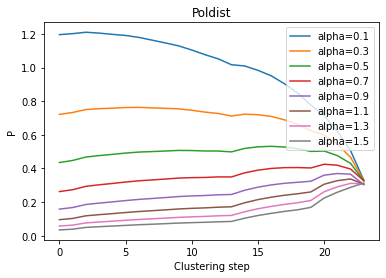

Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
Plot saved to ../plots/CFE/CFE_Legal_migration_and_integration_PolarisationCentroid.png!


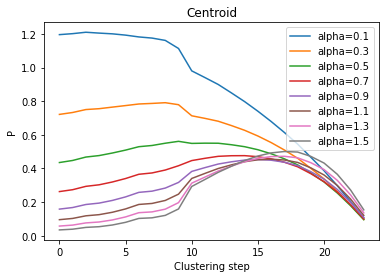

Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
Plot saved to ../plots/CFE/CFE_Legal_migration_and_integration_PolarisationWard.png!


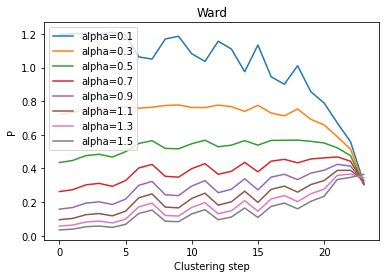

Iteration 23/23...
***** alpha=0.1 *****
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
***** alpha=0.13 *****
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
***** alpha=0.16 *****
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
***** alpha=0.21 *****
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
***** alpha=0.26 *****
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
***** alpha=0.34 *****
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
***** alpha=0.43 *****
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
***** alpha=0.55 *****
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
***** alpha=0.7 *****
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
***** alpha=0.89 *****
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
***** alpha=1.13 *****
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
***** alpha=1.44 *****
Iteration 23/23...
Iteration 23/23...
Iteration 23/23...
***** alpha=1.83 *****


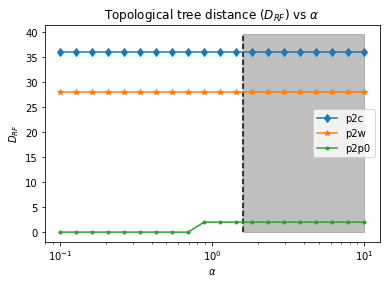

====== Integrated Border Management ======
Total number of endorsers: 26
Number of unique endorsers: 26
Number of proposals: 3
Plot saved to ../plots/CFE/CFE_Integrated_Border_Management_Net.png!


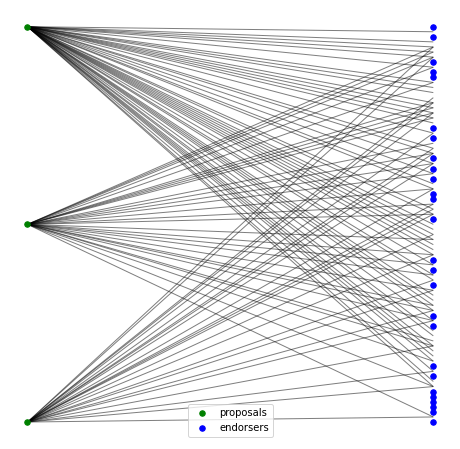

****** WARD ******
Iteration 1/1...
Final polarisation is 0.77
Plot saved to ../plots/CFE/CFE_Integrated_Border_Management_TreeWard.png!


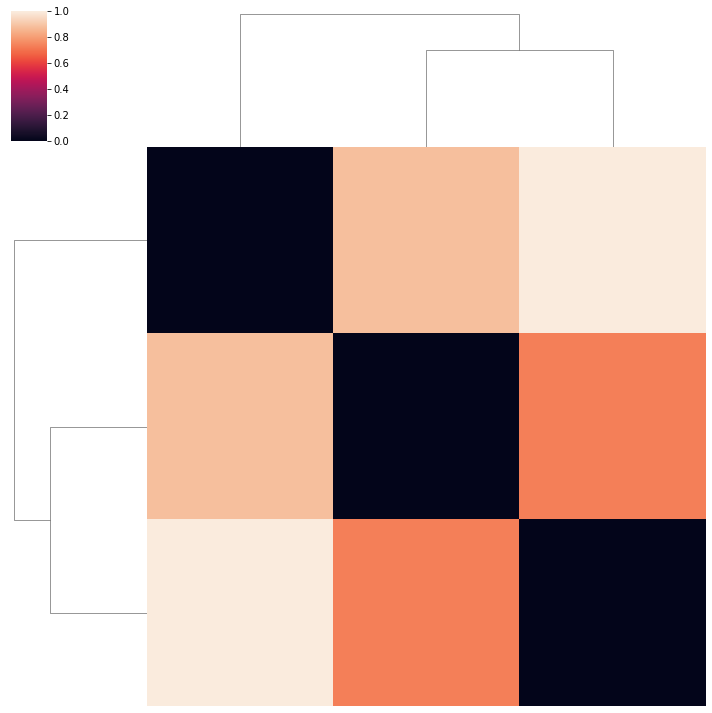

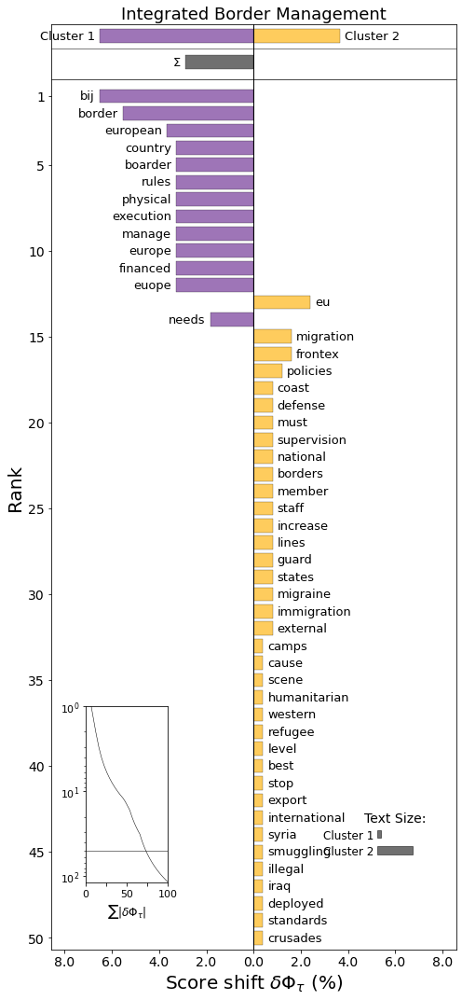

Plot saved to ../plots/CFE/CFE_Integrated_Border_Management_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 1/1...
Final polarisation is 0.77
Plot saved to ../plots/CFE/CFE_Integrated_Border_Management_TreeCentroid.png!


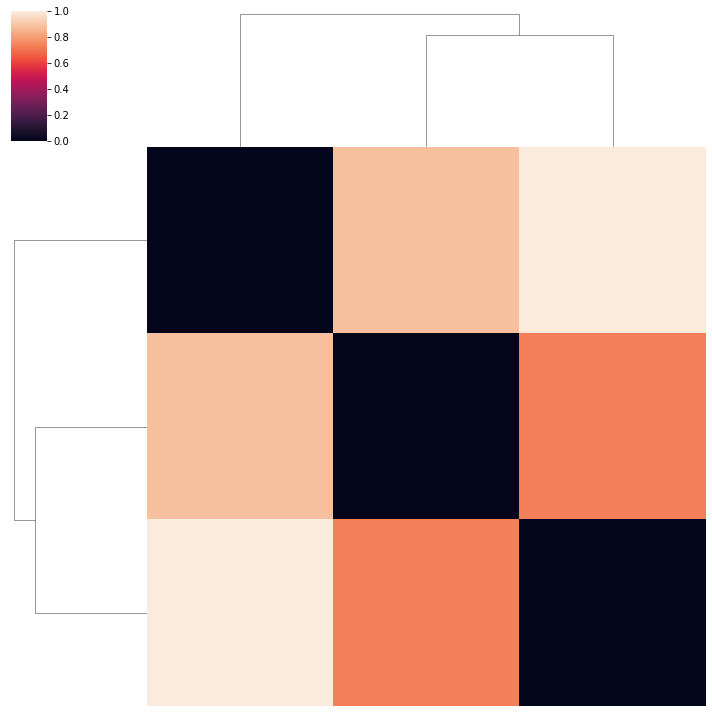

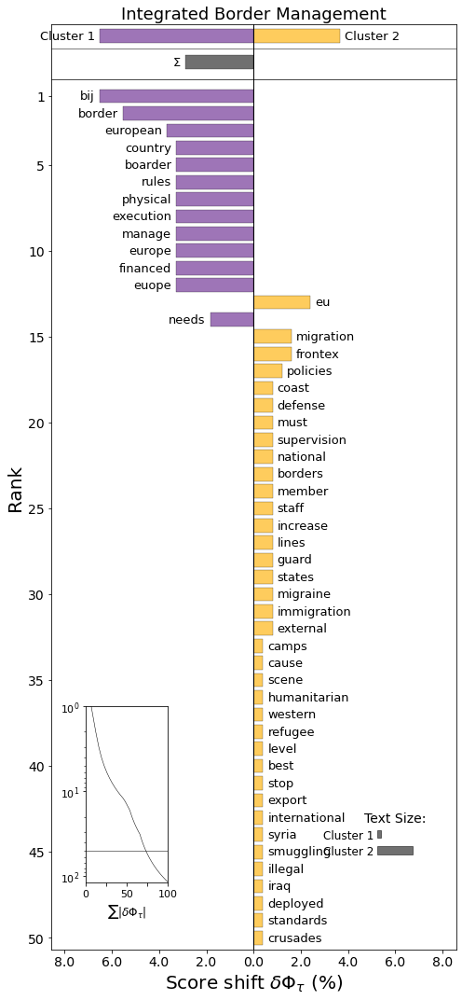

Plot saved to ../plots/CFE/CFE_Integrated_Border_Management_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 1/1...
Final polarisation is 0.77
Plot saved to ../plots/CFE/CFE_Integrated_Border_Management_TreePoldist.png!


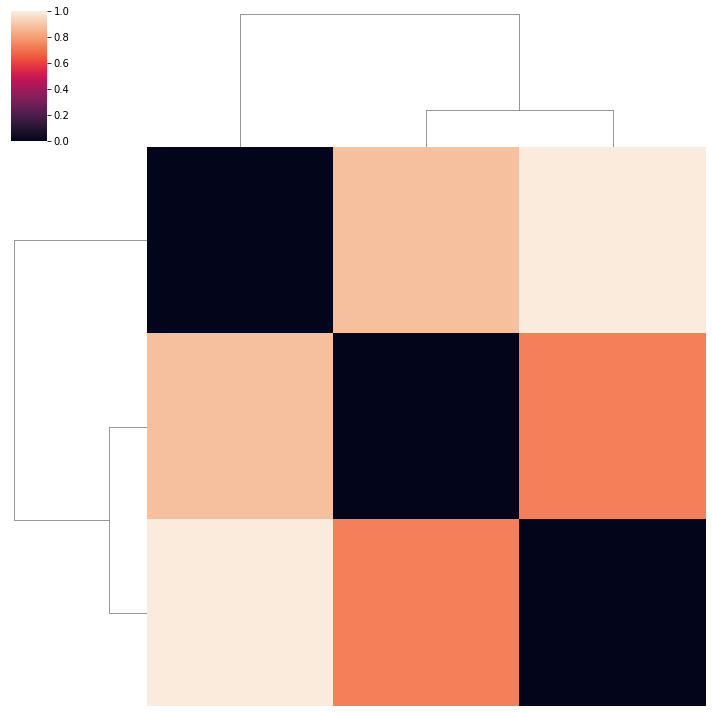

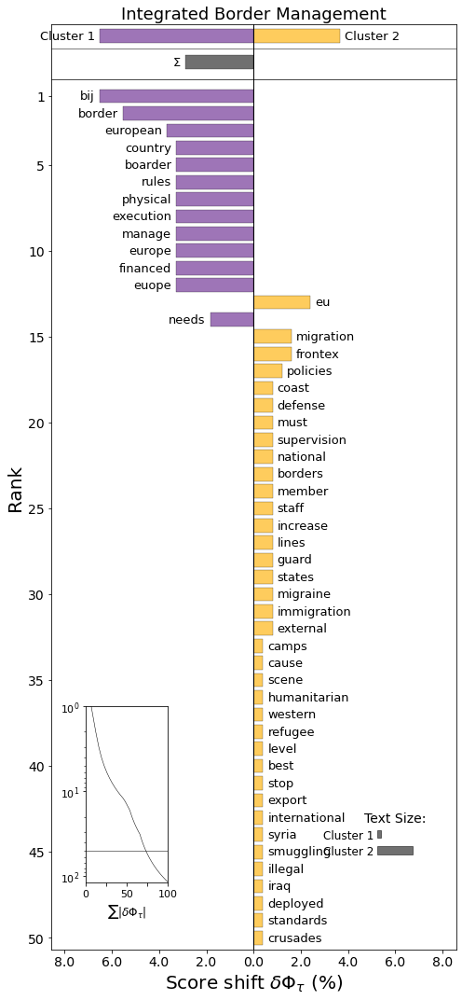

Plot saved to ../plots/CFE/CFE_Integrated_Border_Management_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
Plot saved to ../plots/CFE/CFE_Integrated_Border_Management_PolarisationPoldist.png!


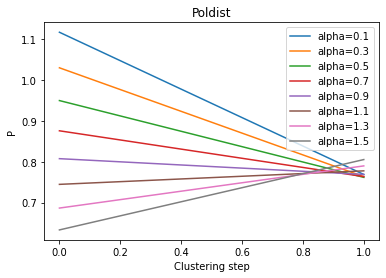

Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
Plot saved to ../plots/CFE/CFE_Integrated_Border_Management_PolarisationCentroid.png!


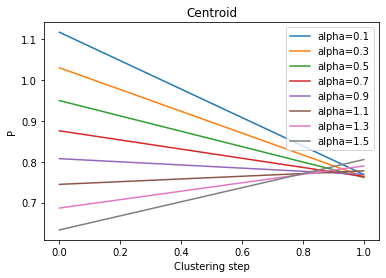

Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
Plot saved to ../plots/CFE/CFE_Integrated_Border_Management_PolarisationWard.png!


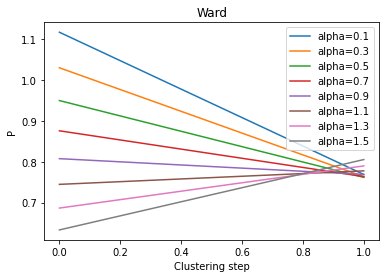

Iteration 1/1...
***** alpha=0.1 *****
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
***** alpha=0.13 *****
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
***** alpha=0.16 *****
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
***** alpha=0.21 *****
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
***** alpha=0.26 *****
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
***** alpha=0.34 *****
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
***** alpha=0.43 *****
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
***** alpha=0.55 *****
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
***** alpha=0.7 *****
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
***** alpha=0.89 *****
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
***** alpha=1.13 *****
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
***** alpha=1.44 *****
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
***** alpha=1.83 *****
Iteration 1/1...
Iteration 1/1...
Iteration 1/1...
***** alpha=2.34 *****


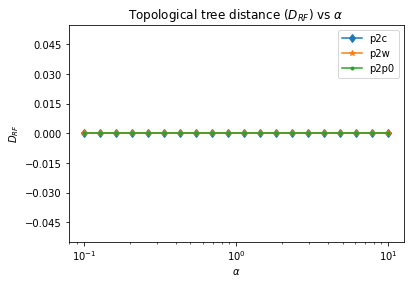

====== Asylum and Migration ======
Total number of endorsers: 418
Number of unique endorsers: 265
Number of proposals: 49
Plot saved to ../plots/CFE/CFE_Asylum_and_Migration_Net.png!


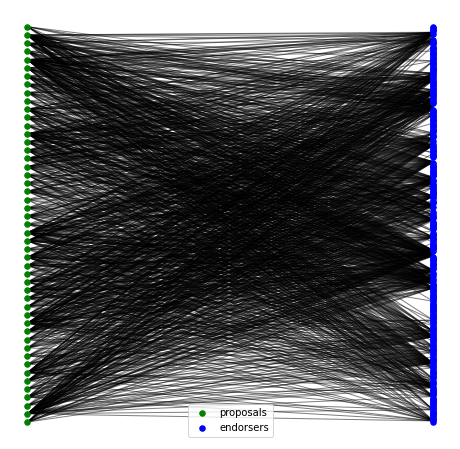

****** WARD ******
Iteration 47/47...
Final polarisation is 0.29
Plot saved to ../plots/CFE/CFE_Asylum_and_Migration_TreeWard.png!


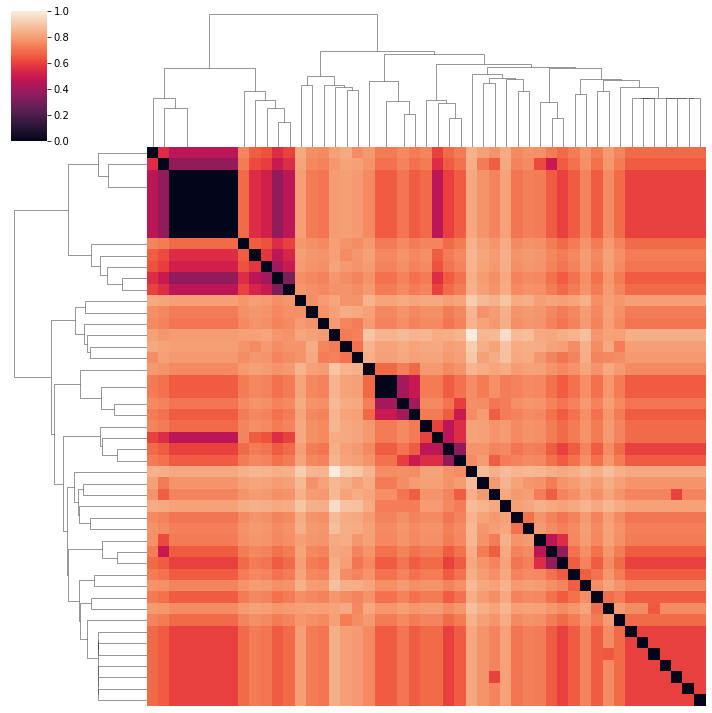

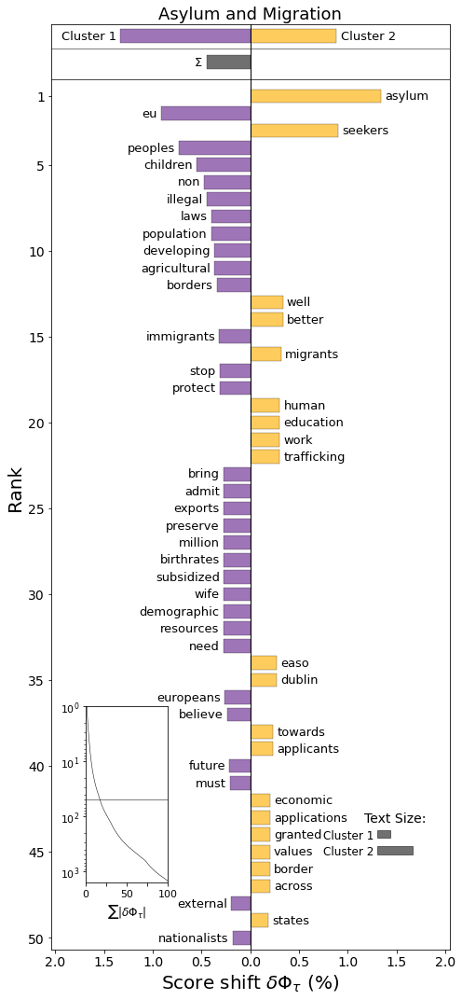

Plot saved to ../plots/CFE/CFE_Asylum_and_Migration_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 47/47...
Final polarisation is 0.05
Plot saved to ../plots/CFE/CFE_Asylum_and_Migration_TreeCentroid.png!


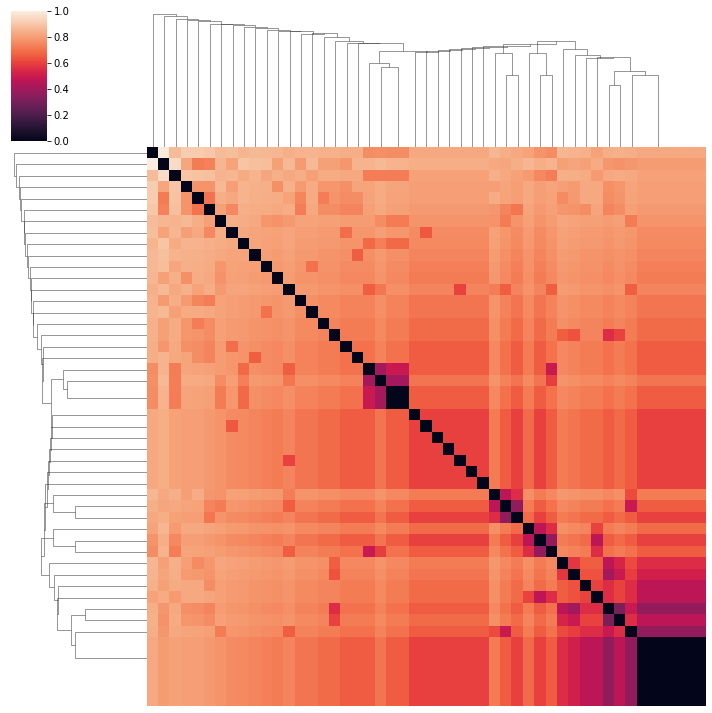

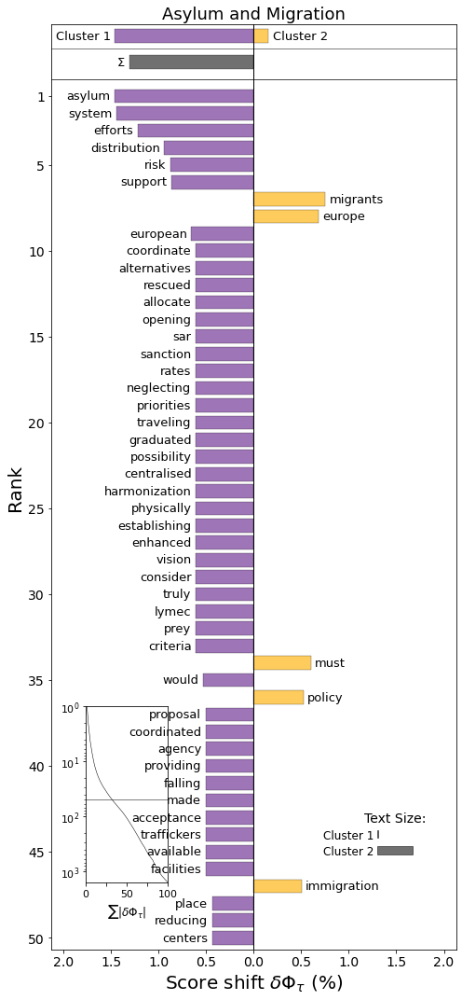

Plot saved to ../plots/CFE/CFE_Asylum_and_Migration_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 47/47...
Final polarisation is 0.3
Plot saved to ../plots/CFE/CFE_Asylum_and_Migration_TreePoldist.png!


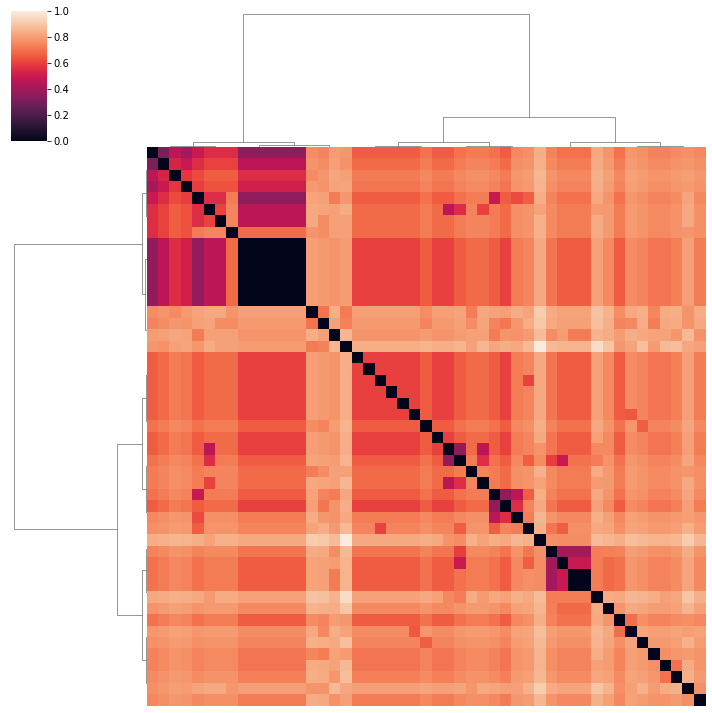

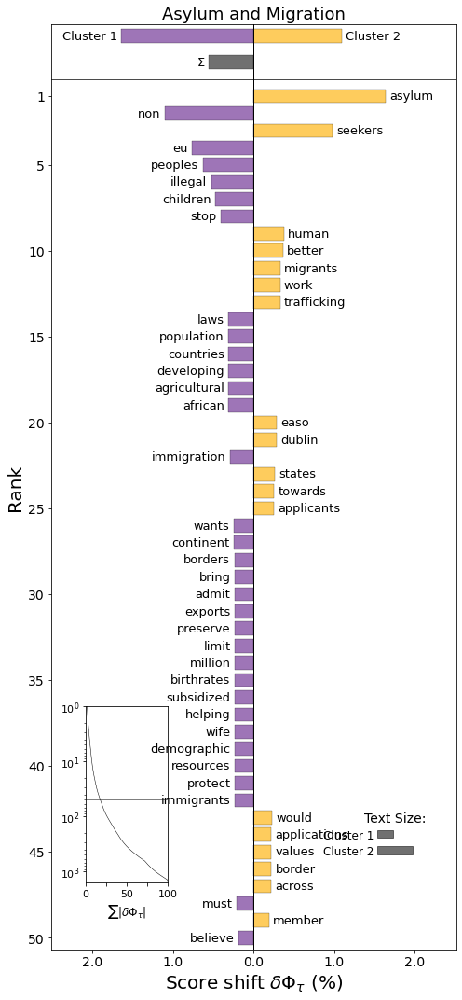

Plot saved to ../plots/CFE/CFE_Asylum_and_Migration_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
Plot saved to ../plots/CFE/CFE_Asylum_and_Migration_PolarisationPoldist.png!


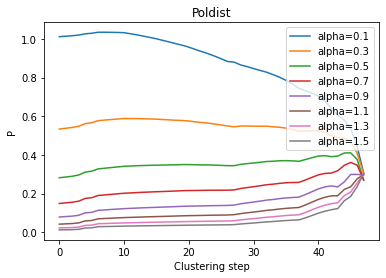

Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
Plot saved to ../plots/CFE/CFE_Asylum_and_Migration_PolarisationCentroid.png!


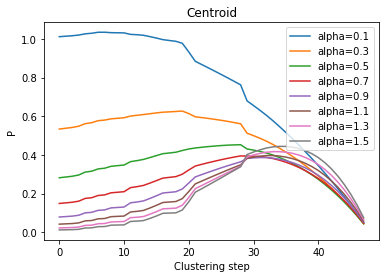

Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
Plot saved to ../plots/CFE/CFE_Asylum_and_Migration_PolarisationWard.png!


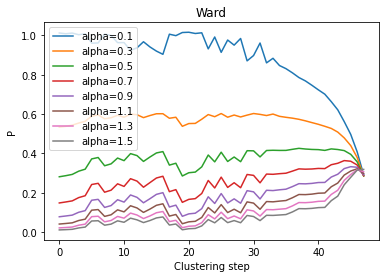

Iteration 47/47...
***** alpha=0.1 *****
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
***** alpha=0.13 *****
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
***** alpha=0.16 *****
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
***** alpha=0.21 *****
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
***** alpha=0.26 *****
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
***** alpha=0.34 *****
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
***** alpha=0.43 *****
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
***** alpha=0.55 *****
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
***** alpha=0.7 *****
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
***** alpha=0.89 *****
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
***** alpha=1.13 *****
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
***** alpha=1.44 *****
Iteration 47/47...
Iteration 47/47...
Iteration 47/47...
***** alpha=1.83 *****


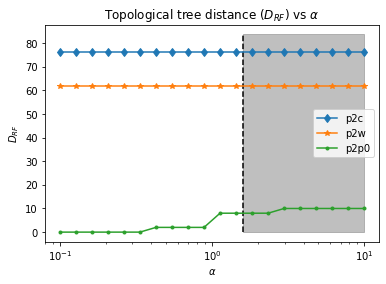

====== Deepening international cooperation ======
Total number of endorsers: 21
Number of unique endorsers: 19
Number of proposals: 7
Plot saved to ../plots/CFE/CFE_Deepening_international_cooperation_Net.png!


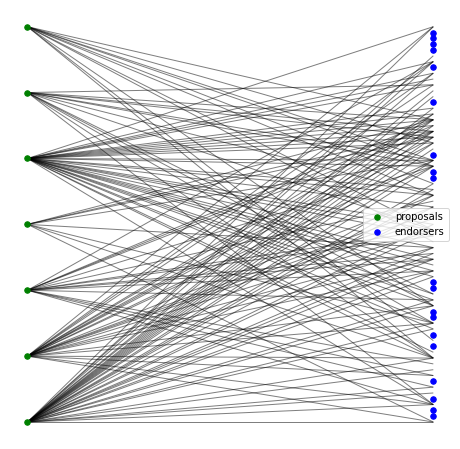

****** WARD ******
Iteration 5/5...
Final polarisation is 0.49
Plot saved to ../plots/CFE/CFE_Deepening_international_cooperation_TreeWard.png!


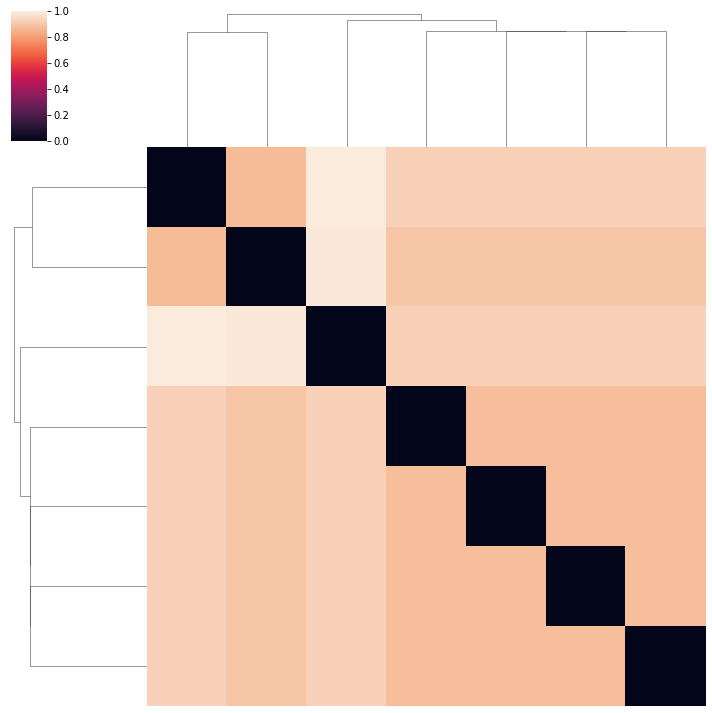

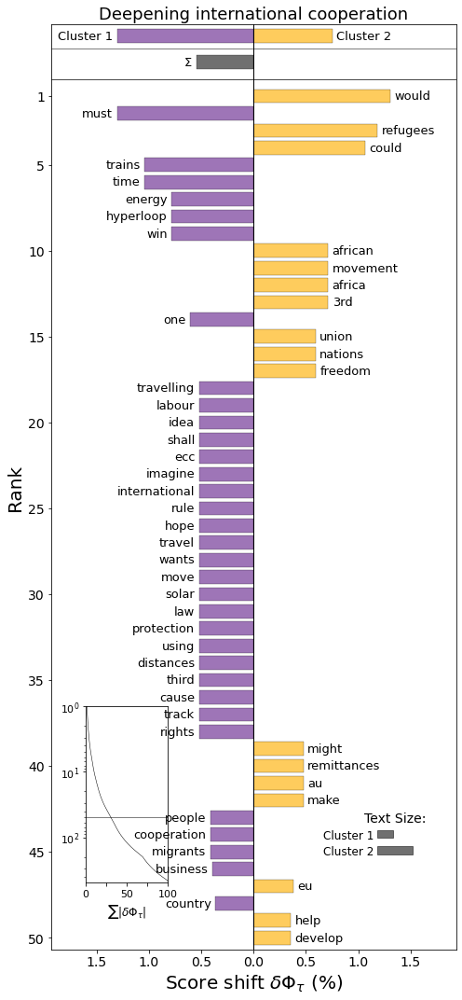

Plot saved to ../plots/CFE/CFE_Deepening_international_cooperation_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 5/5...
Final polarisation is 0.37
Plot saved to ../plots/CFE/CFE_Deepening_international_cooperation_TreeCentroid.png!


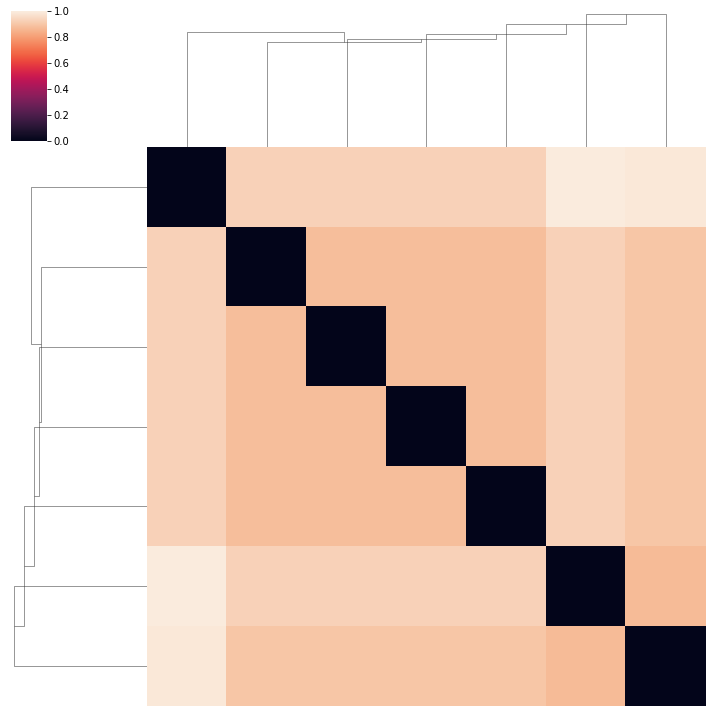

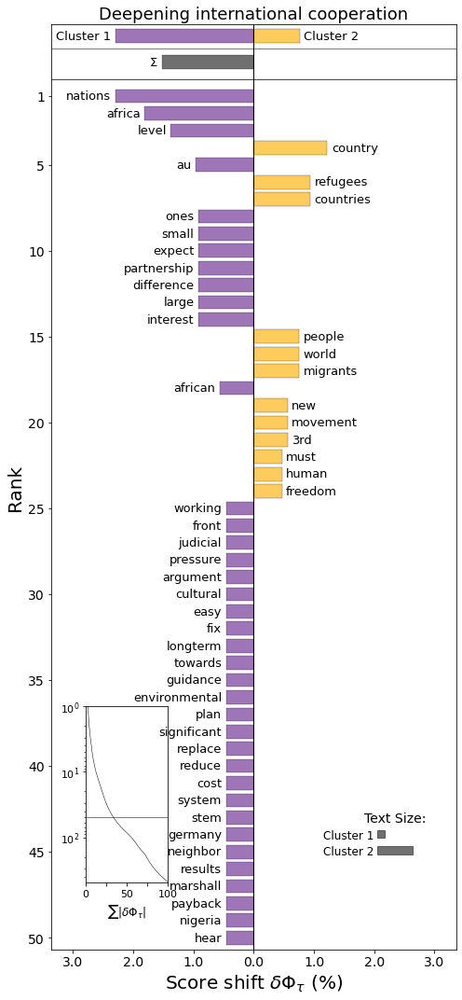

Plot saved to ../plots/CFE/CFE_Deepening_international_cooperation_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 5/5...
Final polarisation is 0.5
Plot saved to ../plots/CFE/CFE_Deepening_international_cooperation_TreePoldist.png!


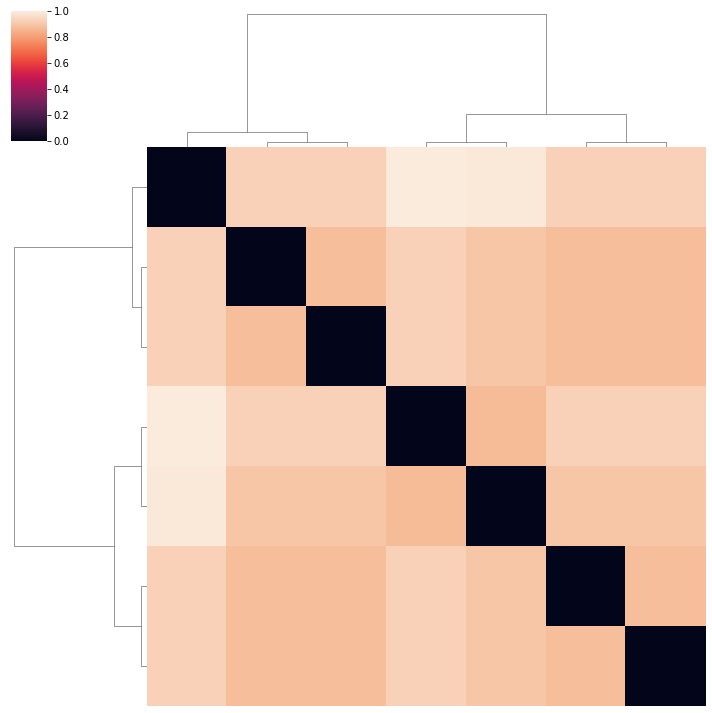

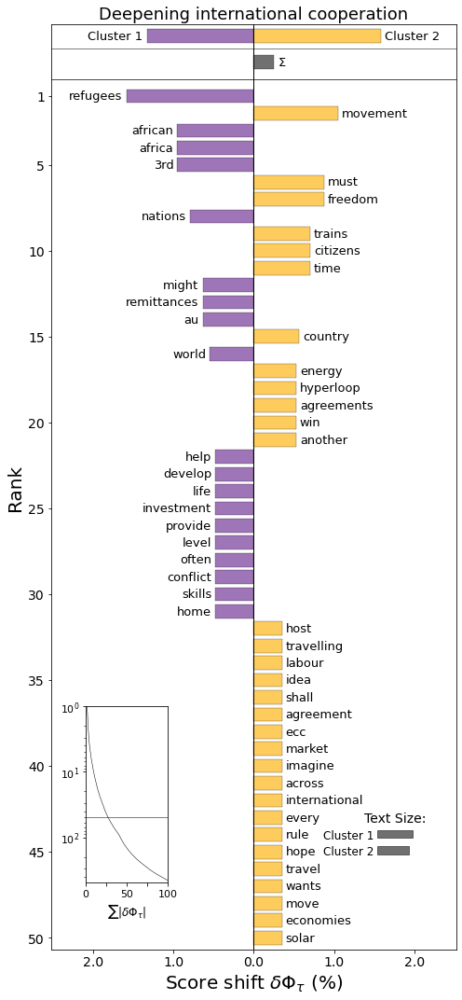

Plot saved to ../plots/CFE/CFE_Deepening_international_cooperation_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
Plot saved to ../plots/CFE/CFE_Deepening_international_cooperation_PolarisationPoldist.png!


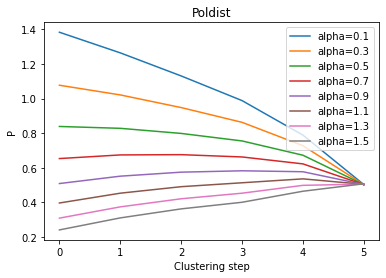

Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
Plot saved to ../plots/CFE/CFE_Deepening_international_cooperation_PolarisationCentroid.png!


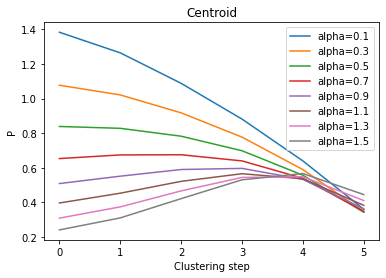

Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
Plot saved to ../plots/CFE/CFE_Deepening_international_cooperation_PolarisationWard.png!


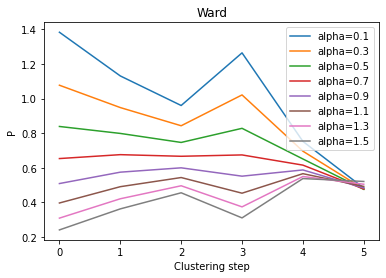

Iteration 5/5...
***** alpha=0.1 *****
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
***** alpha=0.13 *****
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
***** alpha=0.16 *****
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
***** alpha=0.21 *****
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
***** alpha=0.26 *****
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
***** alpha=0.34 *****
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
***** alpha=0.43 *****
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
***** alpha=0.55 *****
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
***** alpha=0.7 *****
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
***** alpha=0.89 *****
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
***** alpha=1.13 *****
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
***** alpha=1.44 *****
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
***** alpha=1.83 *****
Iteration 5/5...
Iteration 5/5...
Iteration 5/5...
***** alpha=2.34 *****


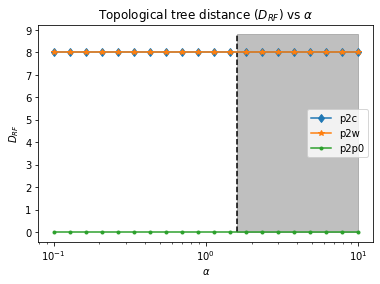

====== Culture ======
Total number of endorsers: 259
Number of unique endorsers: 173
Number of proposals: 27
Plot saved to ../plots/CFE/CFE_Culture_Net.png!


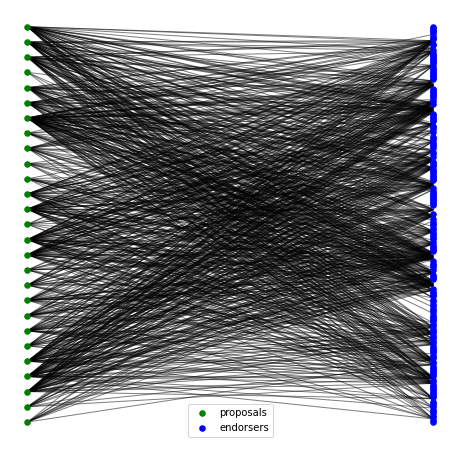

****** WARD ******
Iteration 25/25...
Final polarisation is 0.44
Plot saved to ../plots/CFE/CFE_Culture_TreeWard.png!


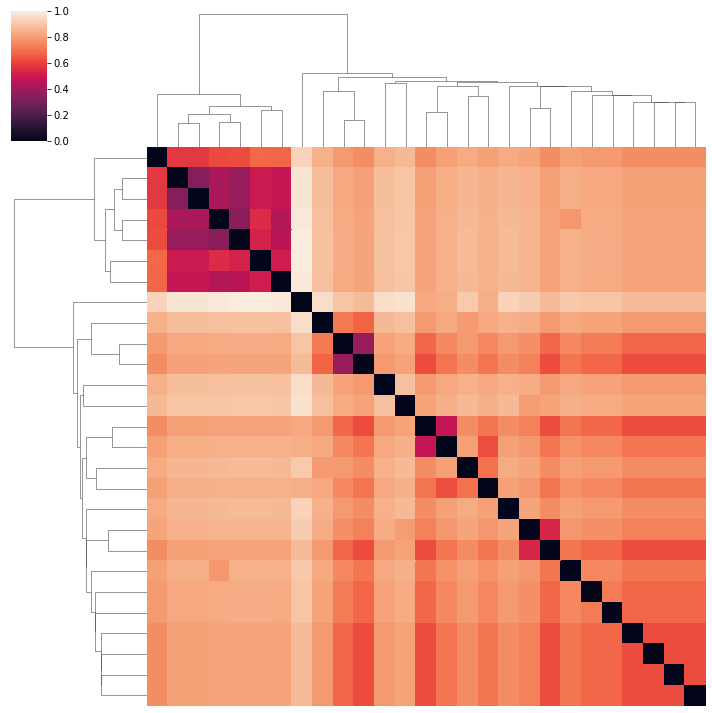

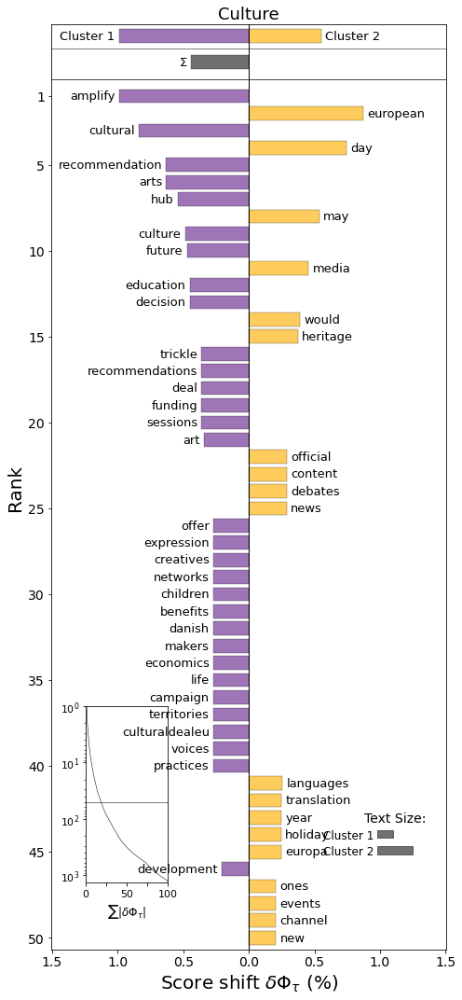

Plot saved to ../plots/CFE/CFE_Culture_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 25/25...
Final polarisation is 0.11
Plot saved to ../plots/CFE/CFE_Culture_TreeCentroid.png!


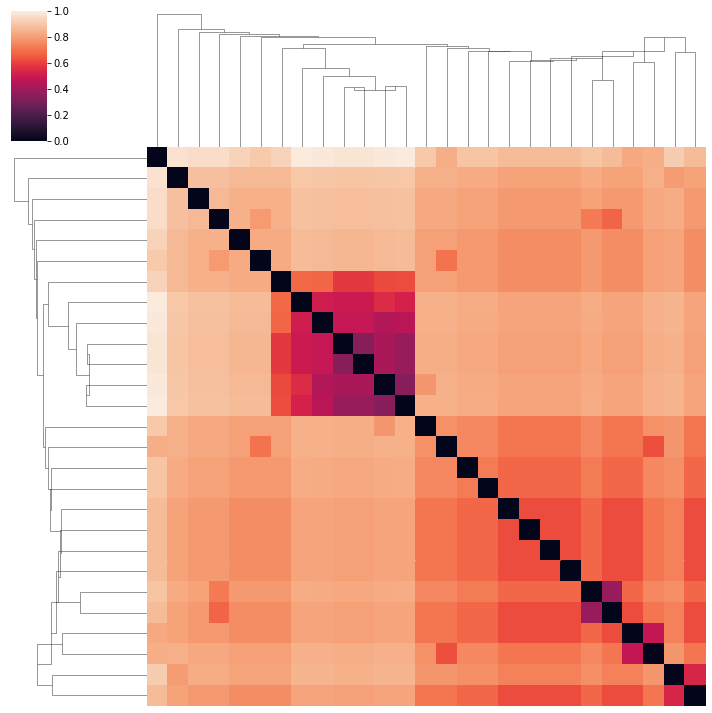

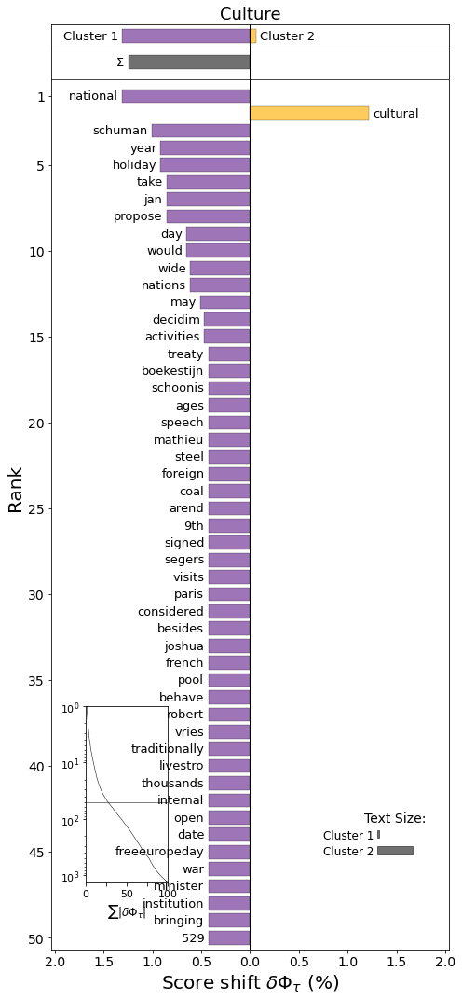

Plot saved to ../plots/CFE/CFE_Culture_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 25/25...
Final polarisation is 0.43
Plot saved to ../plots/CFE/CFE_Culture_TreePoldist.png!


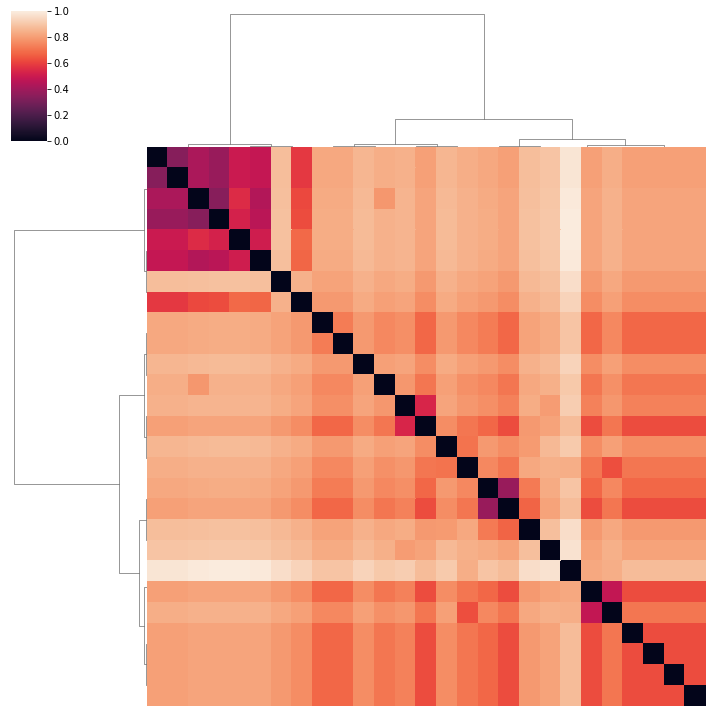

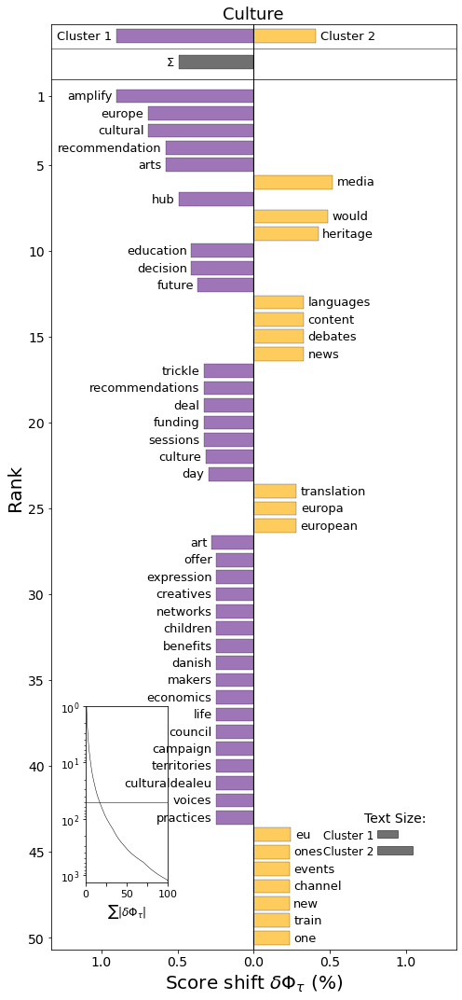

Plot saved to ../plots/CFE/CFE_Culture_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Plot saved to ../plots/CFE/CFE_Culture_PolarisationPoldist.png!


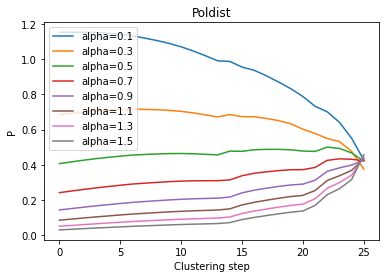

Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Plot saved to ../plots/CFE/CFE_Culture_PolarisationCentroid.png!


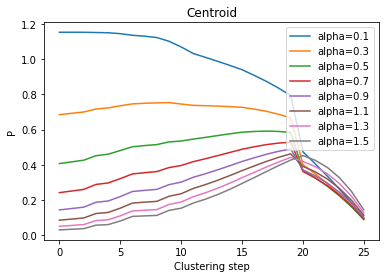

Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
Plot saved to ../plots/CFE/CFE_Culture_PolarisationWard.png!


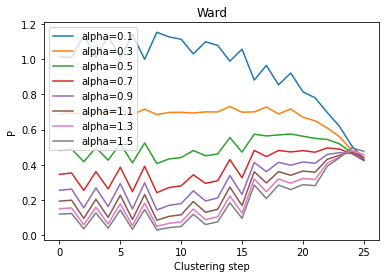

Iteration 25/25...
***** alpha=0.1 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=0.13 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=0.16 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=0.21 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=0.26 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=0.34 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=0.43 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=0.55 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=0.7 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=0.89 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=1.13 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=1.44 *****
Iteration 25/25...
Iteration 25/25...
Iteration 25/25...
***** alpha=1.83 *****


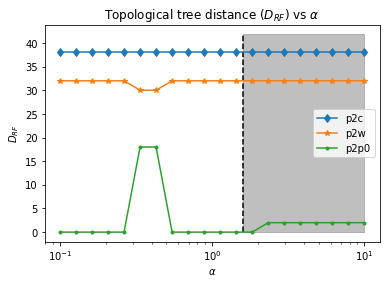

====== Education ======
Total number of endorsers: 1400
Number of unique endorsers: 994
Number of proposals: 72
Plot saved to ../plots/CFE/CFE_Education_Net.png!


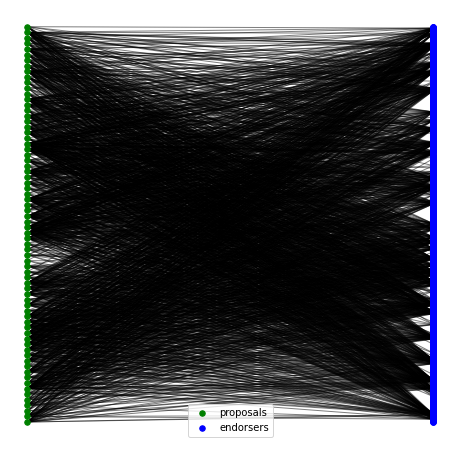

****** WARD ******
Iteration 70/70...
Final polarisation is 0.26
Plot saved to ../plots/CFE/CFE_Education_TreeWard.png!


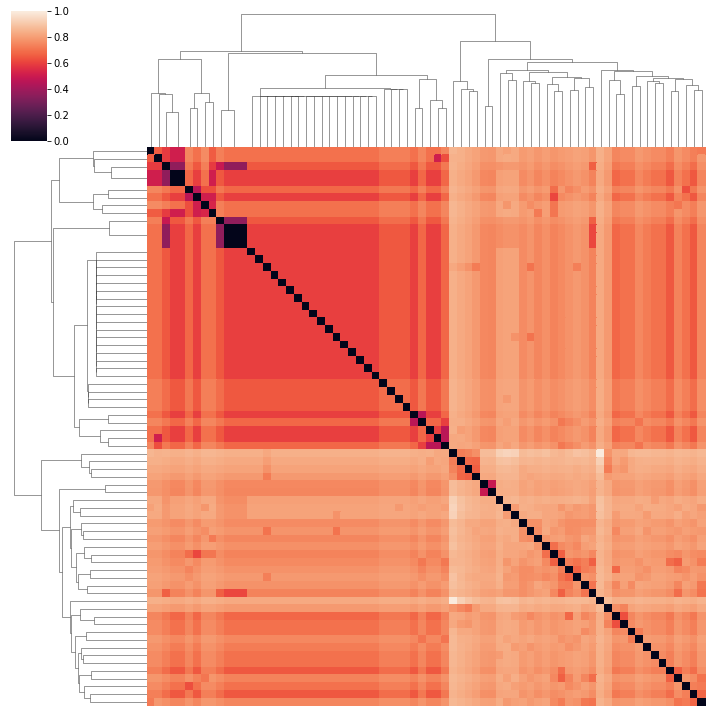

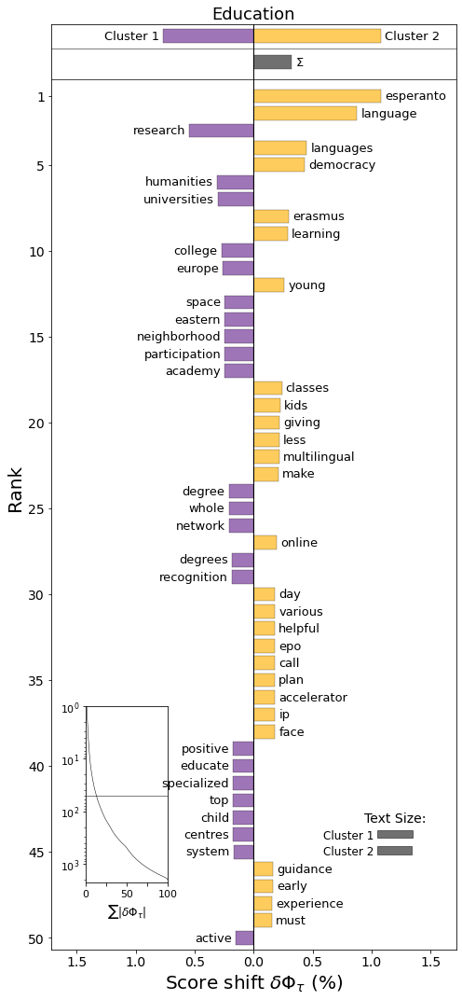

Plot saved to ../plots/CFE/CFE_Education_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 70/70...
Final polarisation is 0.04
Plot saved to ../plots/CFE/CFE_Education_TreeCentroid.png!


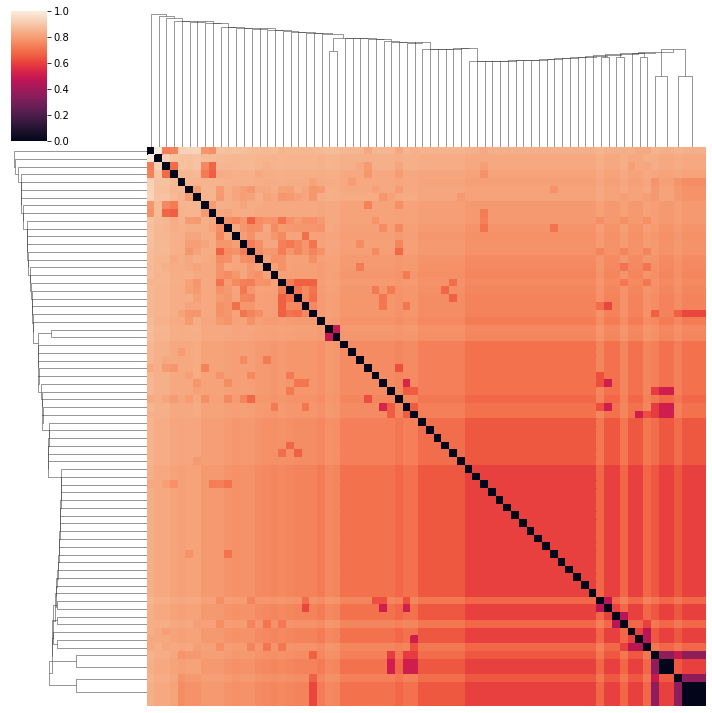

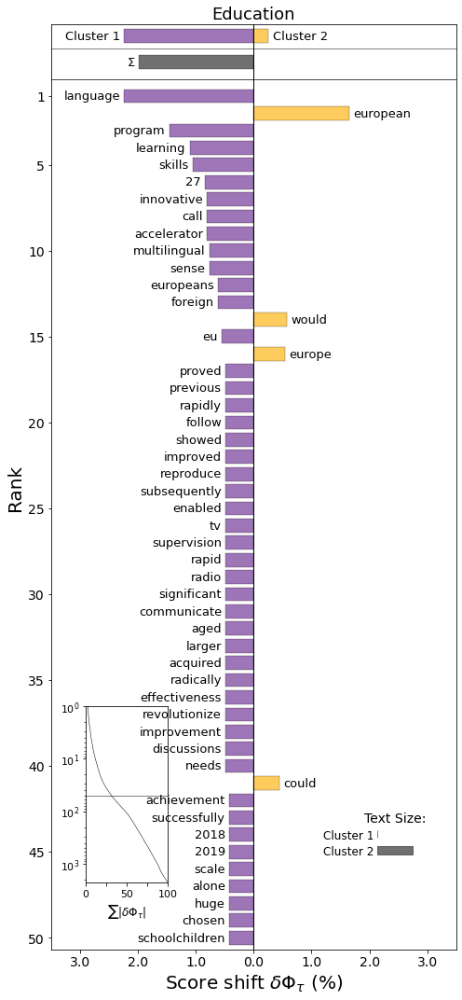

Plot saved to ../plots/CFE/CFE_Education_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 70/70...
Final polarisation is 0.2
Plot saved to ../plots/CFE/CFE_Education_TreePoldist.png!


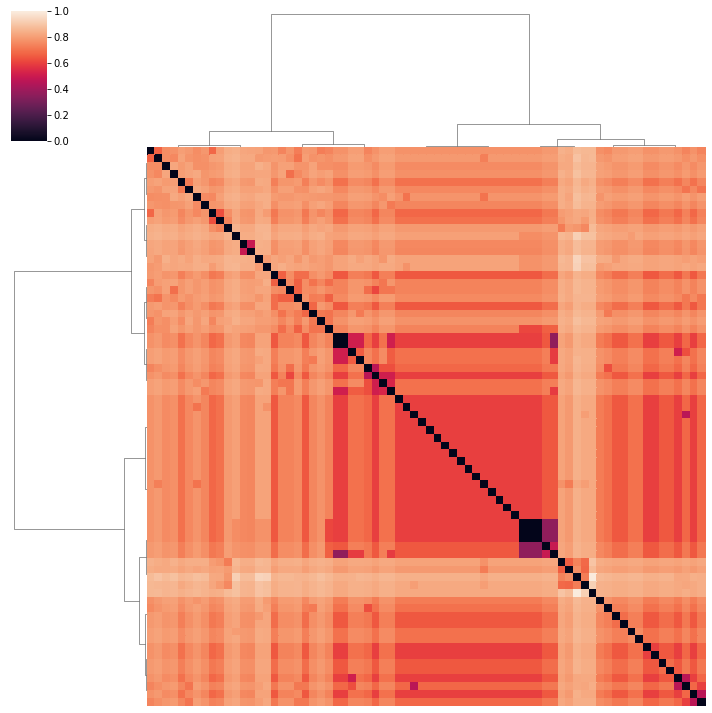

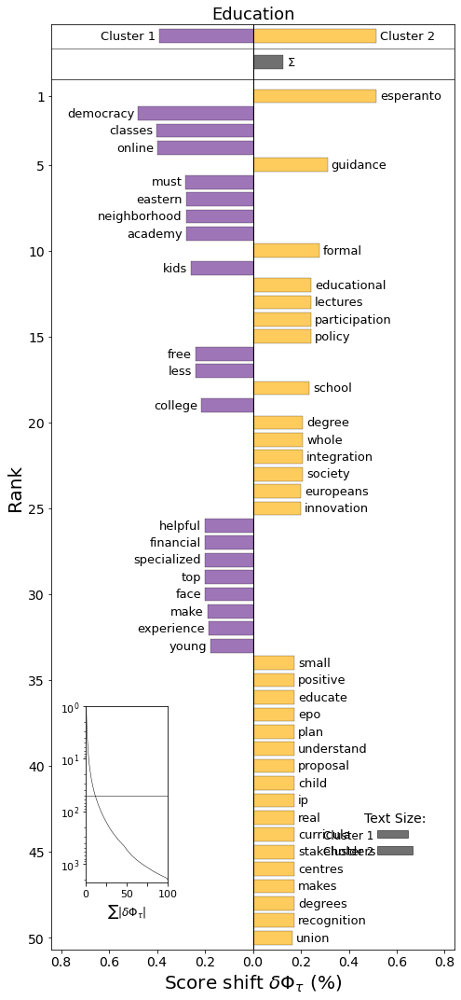

Plot saved to ../plots/CFE/CFE_Education_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
Plot saved to ../plots/CFE/CFE_Education_PolarisationPoldist.png!


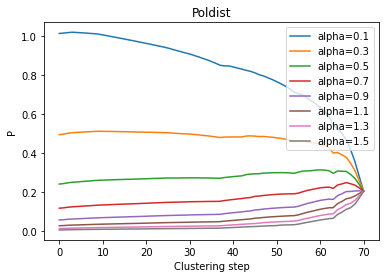

Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
Plot saved to ../plots/CFE/CFE_Education_PolarisationCentroid.png!


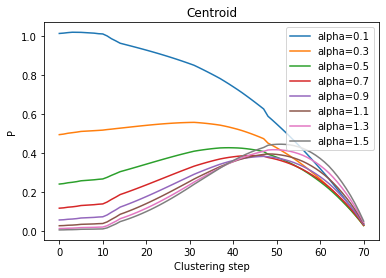

Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
Plot saved to ../plots/CFE/CFE_Education_PolarisationWard.png!


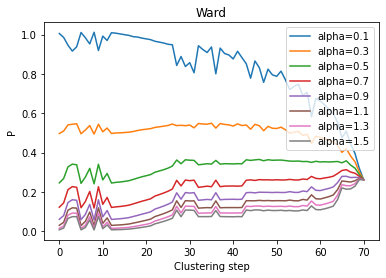

Iteration 70/70...
***** alpha=0.1 *****
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
***** alpha=0.13 *****
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
***** alpha=0.16 *****
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
***** alpha=0.21 *****
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
***** alpha=0.26 *****
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
***** alpha=0.34 *****
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
***** alpha=0.43 *****
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
***** alpha=0.55 *****
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
***** alpha=0.7 *****
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
***** alpha=0.89 *****
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
***** alpha=1.13 *****
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
***** alpha=1.44 *****
Iteration 70/70...
Iteration 70/70...
Iteration 70/70...
***** alpha=1.83 *****


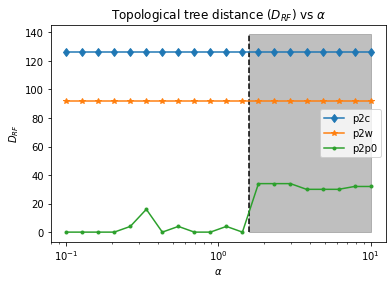

====== Sport ======
Total number of endorsers: 2
Number of unique endorsers: 2
Number of proposals: 1
====== Youth  ======
Total number of endorsers: 26
Number of unique endorsers: 25
Number of proposals: 10
Plot saved to ../plots/CFE/CFE_Youth_Net.png!


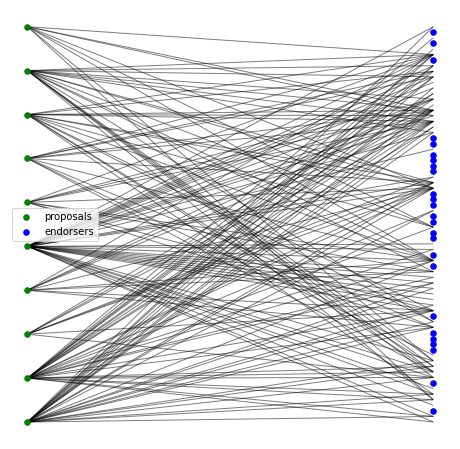

****** WARD ******
Iteration 8/8...
Final polarisation is 0.42
Plot saved to ../plots/CFE/CFE_Youth_TreeWard.png!


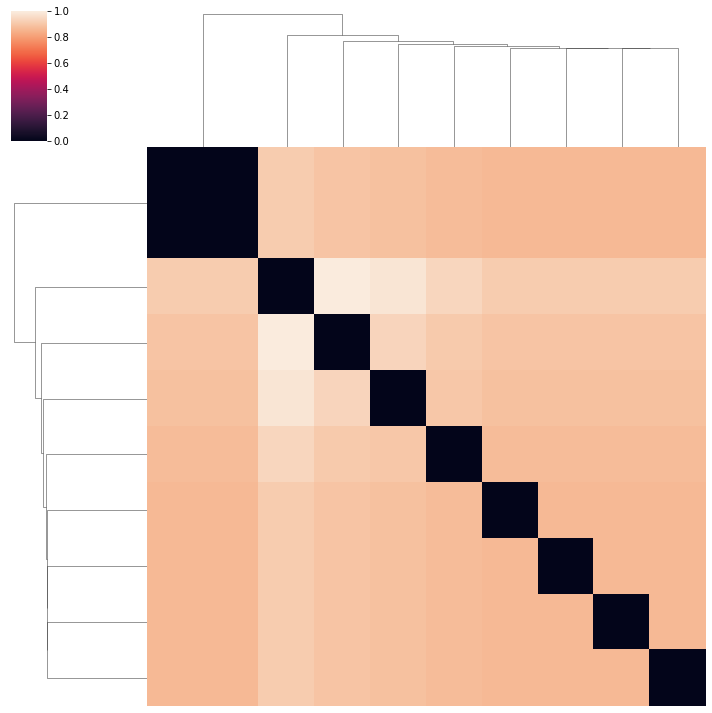

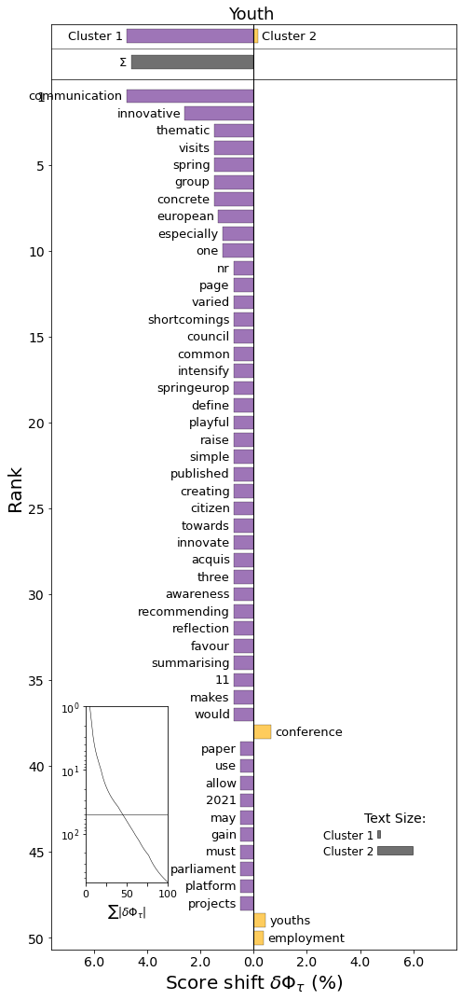

Plot saved to ../plots/CFE/CFE_Youth_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

****** CENTROID ******
Iteration 8/8...
Final polarisation is 0.26
Plot saved to ../plots/CFE/CFE_Youth_TreeCentroid.png!


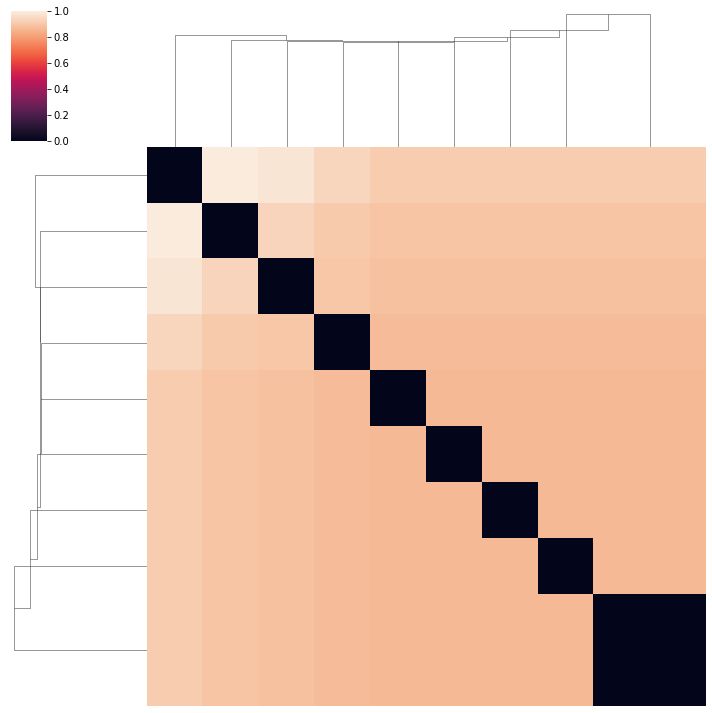

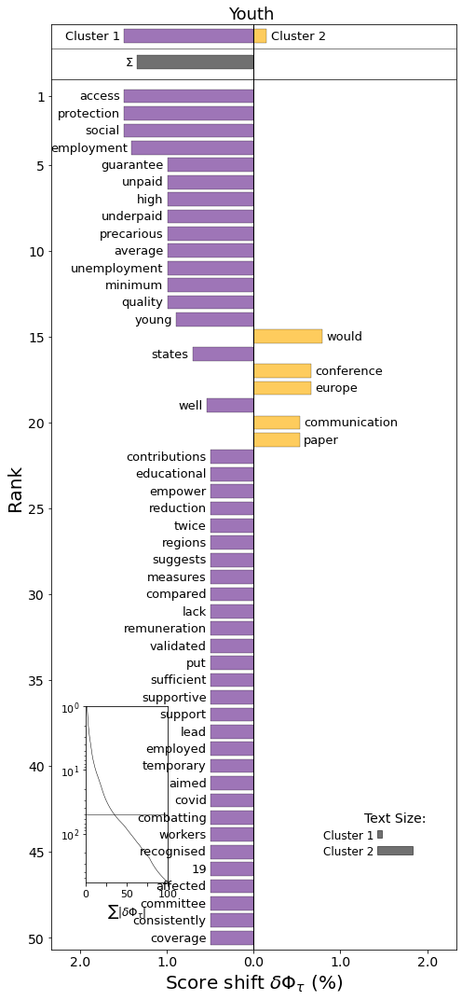

Plot saved to ../plots/CFE/CFE_Youth_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

****** POLDIST ******
Iteration 8/8...
Final polarisation is 0.4
Plot saved to ../plots/CFE/CFE_Youth_TreePoldist.png!


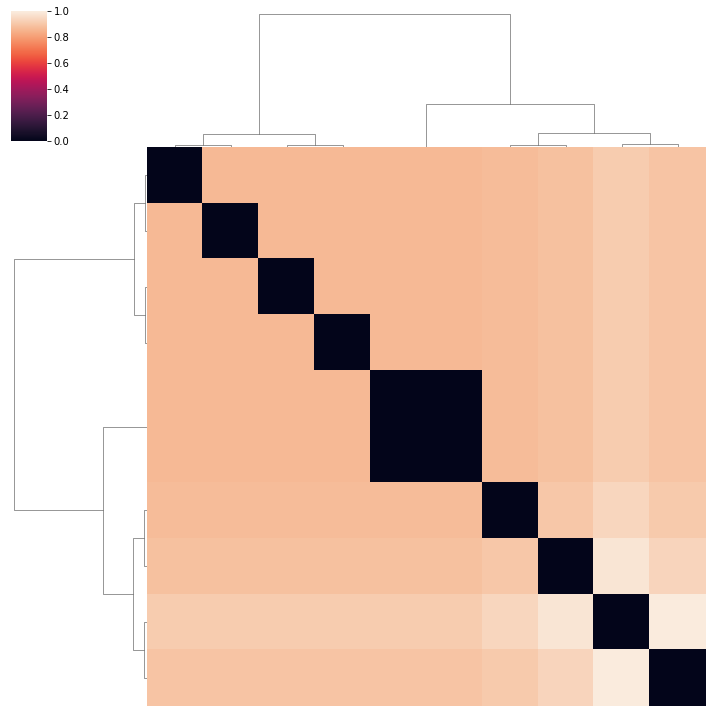

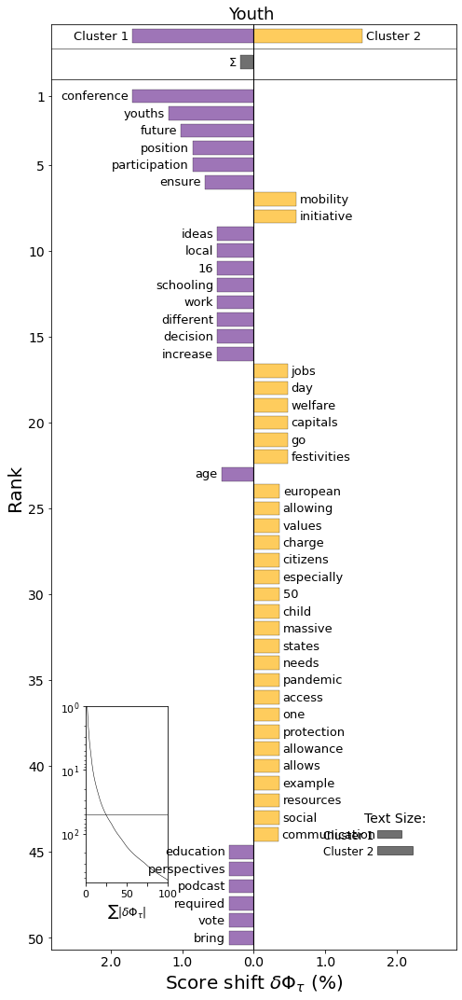

Plot saved to ../plots/CFE/CFE_Youth_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Plot saved to ../plots/CFE/CFE_Youth_PolarisationPoldist.png!


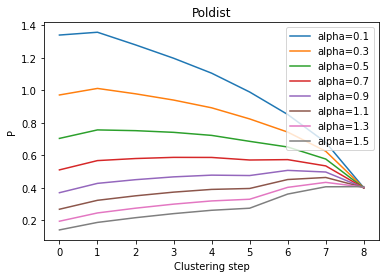

Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Plot saved to ../plots/CFE/CFE_Youth_PolarisationCentroid.png!


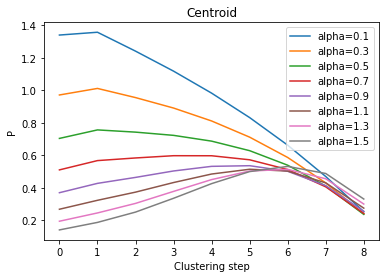

Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
Plot saved to ../plots/CFE/CFE_Youth_PolarisationWard.png!


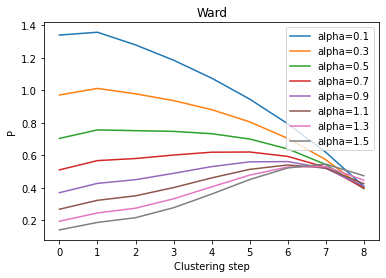

Iteration 8/8...
***** alpha=0.1 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=0.13 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=0.16 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=0.21 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=0.26 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=0.34 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=0.43 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=0.55 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=0.7 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=0.89 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=1.13 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=1.44 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=1.83 *****
Iteration 8/8...
Iteration 8/8...
Iteration 8/8...
***** alpha=2.34 *****


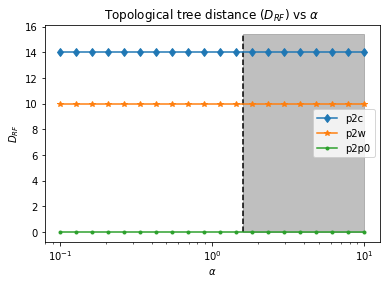

Execution time: 4198 s


In [30]:
import time

start = time.time()
for t in topics:
    t_name = "_".join(t.strip().split(" "))
    print(f"====== {t} ======")
    subdf = df_by_topic(t, cols_to_keep)
    props, ends, prop2vect, prop2end = get_nodes(subdf)
    if len(props) > 1:
        #bimodal net
        bimodal_net(props, ends, prop2end, fname2save="../plots/CFE/CFE_"+t_name+"_Net.png"
                   , labelx="proposals", labely="endorsers")
        d = cond_dist_matrix(props, prop2vect)
        d_sq = squareform(d)
        d_df = pd.DataFrame(d_sq, index=props, columns=props)
        #trees
        for method in ["ward", "centroid", "poldist"]:
            m_name = method[0].upper() + method[1:]
            print(f"****** {method.upper()} ******")
            fname2save = "../plots/CFE/CFE_" + t_name + "_Tree" + m_name + ".png"
            z, p = tree_and_plot(d, d_df, method=method, fname2save=fname2save)
            fname2save = "../plots/CFE/CFE_" + t_name + "_Wordshift" + m_name + ".png"
            title = t#f"JSD shift for {m_name} in {t}"
            wordshift_graph(z, props, title=title, fname2save=fname2save)
        #polarisation vs alpha
        pol_vs_alpha(d, t_name)
        #tree distance vs alpha
        #alphas = np.logspace(-1, 3, 20)
        fname2save = "../plots/CFE/CFE_" + t_name + "_RFdistVsAlpha.png"
        tree_dists(d, props#, alphas=alphas
               , fname2save=fname2save)
end = time.time()
print(f"Execution time: {round(end - start)} s")

In general, the heatmaps do not look very encouraging: it seems the clustering rarely reveals any clear dipole structure (at least around the main diagonal, which is arguably its goal). There are, however, some exceptions, namely that of "Culture", but they are not prominent in any case. 

The overall negative results may mean one of two things: either the systems are not significantly polarised, or our pipeline fails to capture such a polarisation. Given that the pipeline worked rather well in identifying the polarisation in the Southern Women dataset (at least the Ward and centroid methods), I lean towards the first interpretation.

In the cases where some interesting structure is revealed by the clustering, it seems the Ward method performs better than the other two: centroid tends to add up points to form one super-cluster, yielding a very low final polarisation (which is, on the other hand, a sign that our polarisation measure is working as it should); and poldist often features a heatmap showing the most off-diagonal structure, which a proper clustering should avoid. This appears to confirm the result of *SouthernWomen.ipynb* that our distance update candidate features too strong a tendency to avoid merging large clusters to be functional.

Another feature we observe above is that a lower number of proposals tends to yield a higher final polarisation: indeed, the greater the population, the greater the number of possible configurations of the system, which means that a lesser population is in general more likely to end up with a configuration closer to the one that maximises polarisation that a greater one. This must be taken into account when comparing populations of different sizes. 

The word shift graphs are overall not very relevant due to the general lack of bimodality of the clustering, but we can at least note that they show mostly meaningful words thanks to our extracting stop words beforehand. In addition, plotted words are in general ostensibly related to the corresponding topic (contrary to what would happen with spam or otherwise ill-intentioned content), which is good news regarding the participatory intent of the platform.

Regardless of the overall lack of  polarisation, in the particular case of the Ward clustering of proposals on "Culture" one could argue we do see a distinction in the word shift graph, showing a more left-wing touch in the left cluster, which invokes words like "art", "education", "network" or "children" (although "economics" is also prominent); while the right one looks rather formal, perhaps more right-wing, featuring words like "Schuman" (probably referring to the Schuman Declaration), "debate" or "official".

Regarding the evolution of polarisation and tree distance for diferent $\alpha$, we observe the same overall qualitative behaviour we saw with the Southern Women dataset. 

For polarisation, we observe a general convergence at the end of the clustering, with the Ward lines being more wobbly thoughout the clustering; and $\alpha \approx 0$ gives initially high and decreasing polarisation, while higher values of $\alpha$ yield initially low and increasing polarisation (except in the cases where the clustering happens about one super-cluster, as happens frequently with the centroid distance update; there, the increase is followed by a sharp decrease). 

For the tree distance, the different values of $\alpha \in (0, 1.6]$ rarely represent topological changes in the resulting tree with respect to that for $\alpha = 0$. 

### 3.2. Global analysis

The global perspective allows one to see whether users participate more or less homogeneously across topics (arguably the ideal case from a participatory point of view) or, as we might expect, they stick to proposals on one or a few given topics (for instance, an organisation like Greenpeace will likely care mostly about climate change mitigation policies). 

Let us now perform the clustering on the proposals of all the topics at once, then. Given that $\alpha$ has shown practically no influence on the final polarisation nor the topology of the poldist tree, and that the size of the data in this section makes the clustering rather slow, we will only consider $\alpha = 1$.

First, we get all proposals of interest:

In [31]:
subdf = df[(df["endorsements/user_endorsements"].notna()) 
              & (df["reference"].notna())
              & (df["title/en"].notna())
               & (df["category/name/en"].notna())
              ].copy()
subdf = subdf[cols_to_keep]
props, ends, prop2vect, prop2end = get_nodes(subdf)

Total number of endorsers: 15896
Number of unique endorsers: 5760
Number of proposals: 1252


And we define the distance matrix. Since it takes a while (see below), we save it to a file for easier use:

In [32]:
import time

start = time.time()
d = cond_dist_matrix(props, prop2vect)
end = time.time()
print(f"Execution time is : {round(end-start)} s")

d_file = "../data/CFE/CFE_Global_d.npy"
np.save(d_file, d)

Execution time is : 879


Now we can apply the clustering, which also takes a while for so many proposals. We will thus also save the linkage matrix and the polarisation vector.

For Ward clustering, we get:

Iteration 1250/1250...
Final polarisation is 0.2
Plot saved to ../plots/CFE/CFE_Global_TreeWard.png!


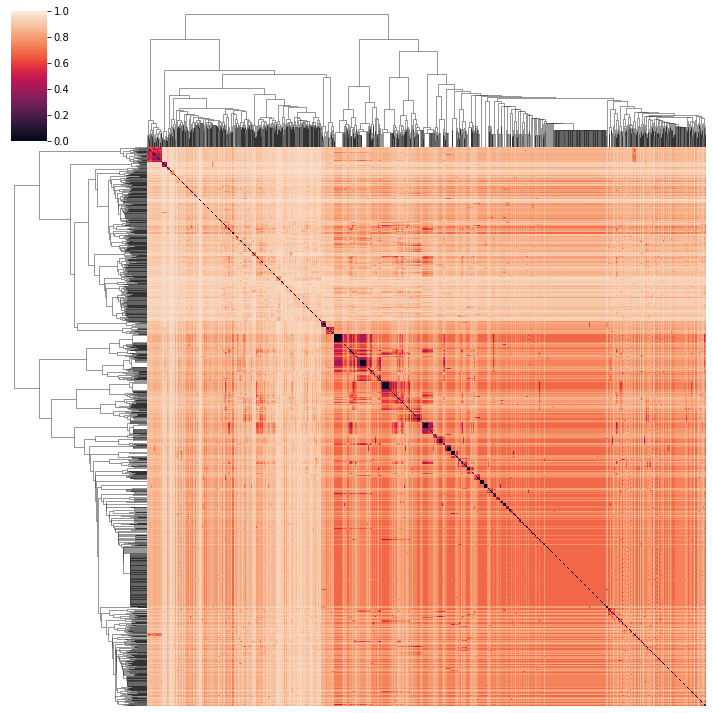

Execution time is : 13995


In [33]:
import time
 
d_file = "../data/CFE/CFE_Global_d.npy"
d = np.load(d_file)

d_sq = squareform(d)
d_df = pd.DataFrame(d_sq, index=props, columns=props)
#trees
start = time.time()
fname2save = "../plots/CFE/CFE_Global_TreeWard.png"
z, p = tree_and_plot(d, d_df, method="ward", fname2save=fname2save)
z_file = "../data/CFE/CFE_Global_Ward_Z.npy"
p_file = "../data/CFE/CFE_Global_Ward_Polarisation.npy"
np.save(z_file, z)
np.save(p_file, p)

end = time.time()
print(f"Execution time is : {round(end-start)} s")

In [34]:
z_file = "../data/CFE/CFE_Global_Ward_Z.npy"
p_file = "../data/CFE/CFE_Global_Ward_Polarisation.npy"
z_wrd = np.load(z_file)
p_wrd = np.load(p_file)

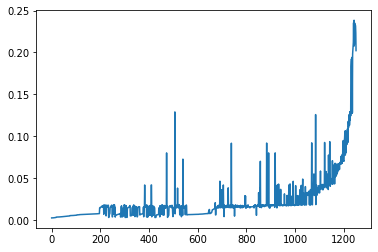

In [35]:
plt.plot(p_wrd)
plt.show()

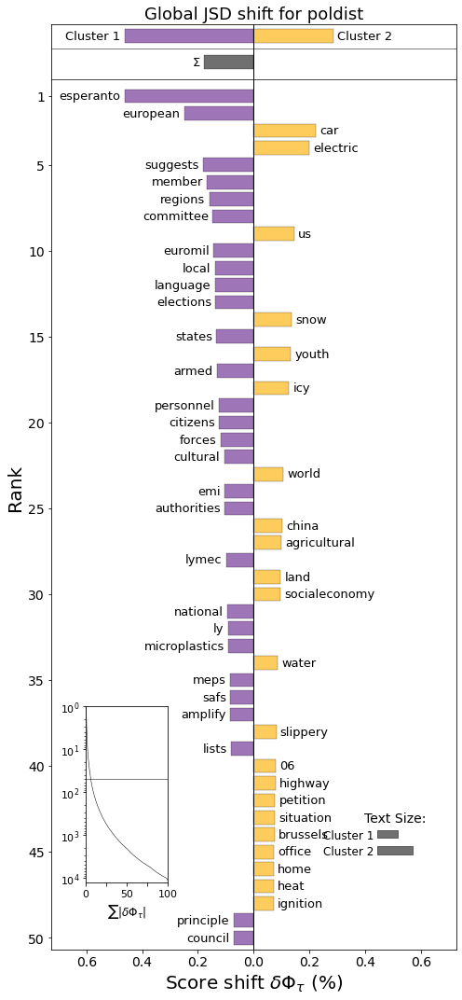

Plot saved to ../plots/CFE/CFE_Global_WordshiftWard.png!


<Figure size 432x288 with 0 Axes>

In [36]:
fname2save = "../plots/CFE/CFE_Global_WordshiftWard.png"
title = "Global JSD shift for poldist"
wordshift_graph(z_wrd, props, title, fname2save=fname2save)

For centroid clustering, we have:

Iteration 1250/1250...
Final polarisation is 0.0
Plot saved to ../plots/CFE/CFE_Global_TreeCentroid.png!


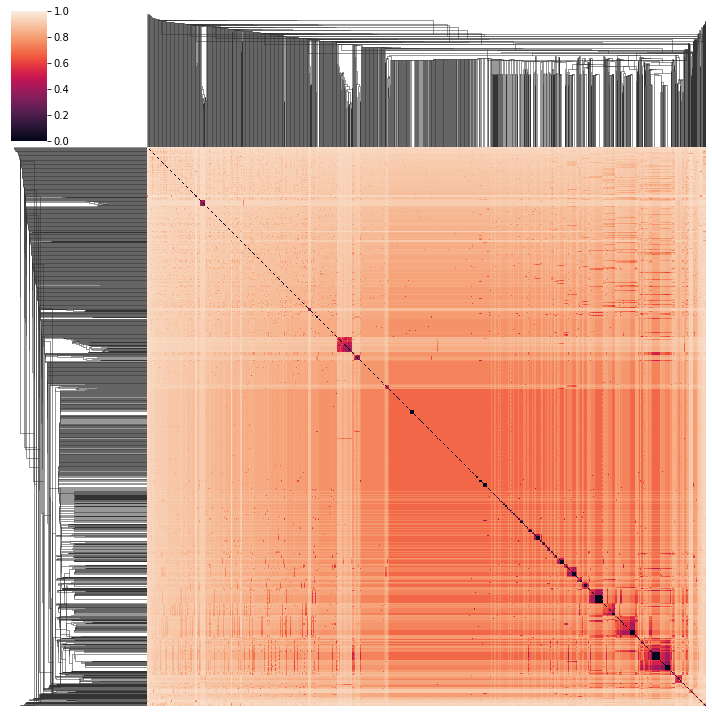

Execution time is : 9286


In [37]:
import time
 
d_file = "../data/CFE/CFE_Global_d.npy"
d = np.load(d_file)

d_sq = squareform(d)
d_df = pd.DataFrame(d_sq, index=props, columns=props)
#trees
start = time.time()
fname2save = "../plots/CFE/CFE_Global_TreeCentroid.png"
z, p = tree_and_plot(d, d_df, method="centroid", fname2save=fname2save)
z_file = "../data/CFE/CFE_Global_Centroid_Z.npy"
p_file = "../data/CFE/CFE_Global_Centroid_Polarisation.npy"
np.save(z_file, z)
np.save(p_file, p)

end = time.time()
print(f"Execution time is : {round(end-start)} s")

In [38]:
z_file = "../data/CFE/CFE_Global_Centroid_Z.npy"
p_file = "../data/CFE/CFE_Global_Centroid_Polarisation.npy"
z_ctr = np.load(z_file)
p_ctr = np.load(p_file)

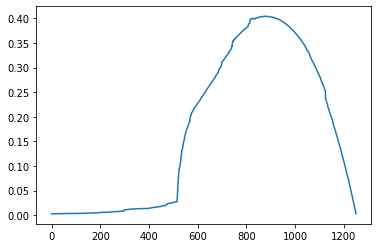

In [39]:
plt.plot(p_ctr)
plt.show()

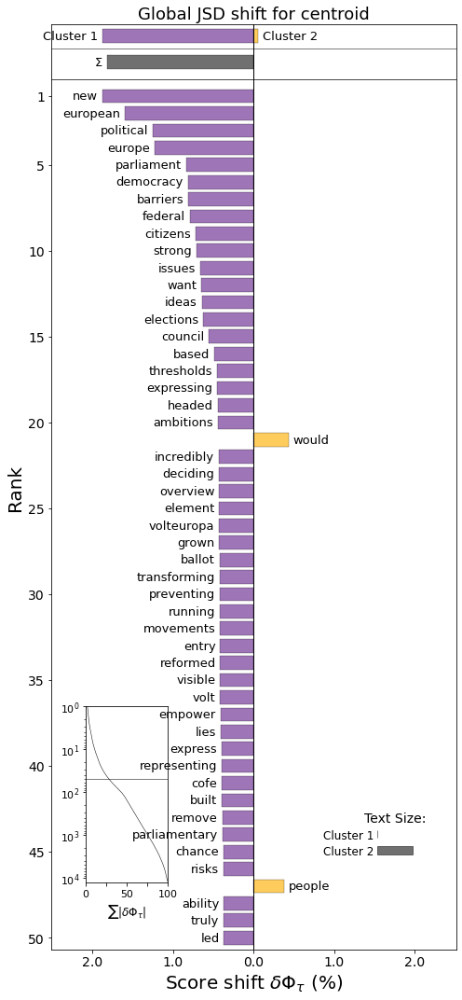

Plot saved to ../plots/CFE/CFE_Global_WordshiftCentroid.png!


<Figure size 432x288 with 0 Axes>

In [40]:
fname2save = "../plots/CFE/CFE_Global_WordshiftCentroid.png"
title = "Global JSD shift for centroid"
wordshift_graph(z_ctr, props, title, fname2save=fname2save)

And, finally, for the poldist method:

Iteration 1250/1250...
Final polarisation is 0.16
Plot saved to ../plots/CFE/CFE_Global_TreePoldist.png!


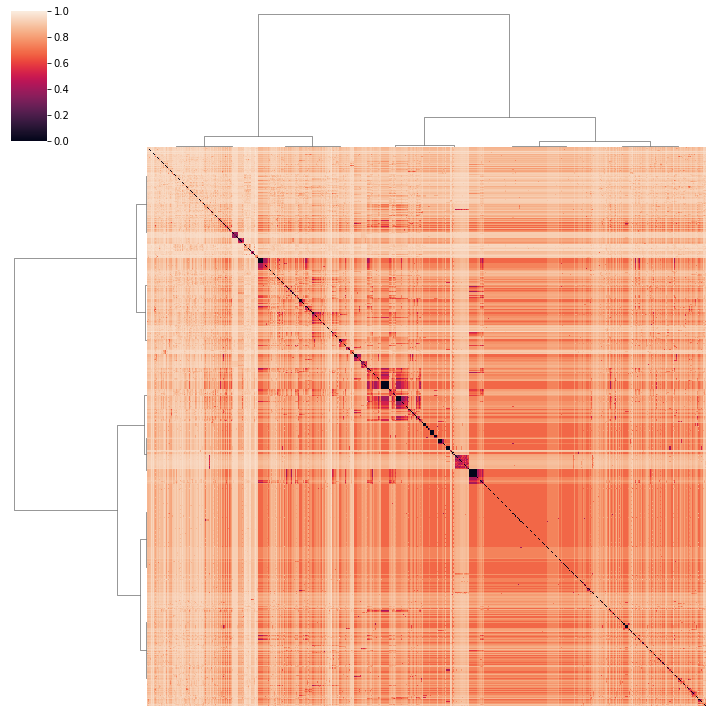

Execution time is : 3138


In [41]:
import time
 
d_file = "../data/CFE/CFE_Global_d.npy"
d = np.load(d_file)

d_sq = squareform(d)
d_df = pd.DataFrame(d_sq, index=props, columns=props)
#trees
start = time.time()
fname2save = "../plots/CFE/CFE_Global_TreePoldist.png"
z, p = tree_and_plot(d, d_df, method="poldist", fname2save=fname2save)
z_file = "../data/CFE/CFE_Global_Poldist_Z.npy"
p_file = "../data/CFE/CFE_Global_Poldist_Polarisation.npy"
np.save(z_file, z)
np.save(p_file, p)

end = time.time()
print(f"Execution time is : {round(end-start)} s")

In [42]:
z_file = "../data/CFE/CFE_Global_Poldist_Z.npy"
p_file = "../data/CFE/CFE_Global_Poldist_Polarisation.npy"
z_pld = np.load(z_file)
p_pld = np.load(p_file)

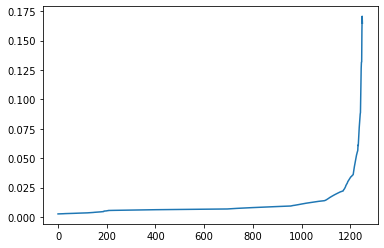

In [43]:
plt.plot(p_pld)
plt.show()

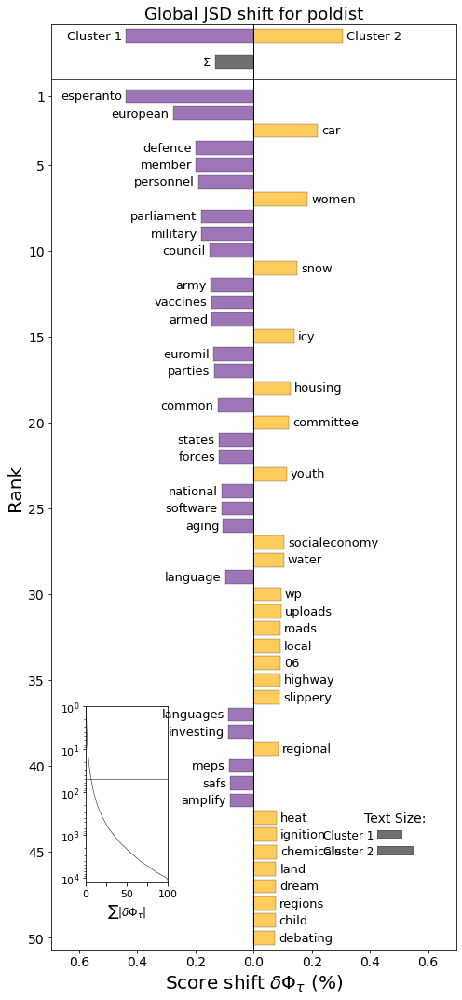

Plot saved to ../plots/CFE/CFE_Global_WordshiftPoldist.png!


<Figure size 432x288 with 0 Axes>

In [44]:
fname2save = "../plots/CFE/CFE_Global_WordshiftPoldist.png"
title = "Global JSD shift for poldist"
wordshift_graph(z_pld, props, title, fname2save=fname2save)

The tree distances between each pair of the above trees are:

In [45]:
tp_str = z_to_tree_str_newick(z_pld, props)
tc_str = z_to_tree_str_newick(z_ctr, props)
tw_str = z_to_tree_str_newick(z_wrd, props)

p2c = RF_dist(tp_str, tc_str)
p2w = RF_dist(tp_str, tw_str)
w2c = RF_dist(tw_str, tc_str)
print(f"Poldist-centroid tree distance: {p2c}"
      f"\nPoldst-Ward tree distance: {p2w}"
     f"\nWard-centroid tree distance: {w2c}")

Poldist-centroid tree distance: 1900
Poldst-Ward tree distance: 1656
Ward-centroid tree distance: 1900
